### CMPINF 2100 Final Project - Supplemental
### Purpose: Predicting a track's popularity using data about the songs.
The final project consists of six sections:
* Introduction
* Exploratory Data Analysis (EDA)
* Clustering
* Models: Fitting and Interpretation
* Models: Predictions
* Models: Performance and Validation

## Import Modules

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns

## Read data

In [4]:
songs_url = 'https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2020/2020-01-21/spotify_songs.csv'

In [5]:
df = pd.read_csv(songs_url)

In [6]:
spotify_df = df.copy()

## 2. EDA

### a) Basic Information:
**1 - How many rows and columns?**

In [7]:
spotify_df.shape

(32833, 23)

The spotify_df dataset has **32833 rows** and **23 columns**.

**2 - What are the variable names\
3 - What are the data types of the variables**

In [8]:
spotify_df.dtypes

track_id                     object
track_name                   object
track_artist                 object
track_popularity              int64
track_album_id               object
track_album_name             object
track_album_release_date     object
playlist_name                object
playlist_id                  object
playlist_genre               object
playlist_subgenre            object
danceability                float64
energy                      float64
key                           int64
loudness                    float64
mode                          int64
speechiness                 float64
acousticness                float64
instrumentalness            float64
liveness                    float64
valence                     float64
tempo                       float64
duration_ms                   int64
dtype: object

There are **13 numeric** variables (9 float, 4 integers) and **10 object** variables.

**4 - Number of missing values per variable**

In [9]:
spotify_df.isna().sum().loc[spotify_df.isna().sum() > 0]

track_name          5
track_artist        5
track_album_name    5
dtype: int64

The three variables, `track_name`, `track_artist`, `track_album_name` are all missing data.

**5 - The number of unique values per column**

In [10]:
spotify_df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

Since there are 32,833 total records and 28,356 unique `track_ids`, we assume that `track_id` is most likely represented in many playlists.

BUT...the same `track_name` and `track_artist` CAN HAVE MULTPLE `track_id`. 

In [11]:
def cesar(groups):
    return spotify_df.groupby(groups).\
    aggregate(num_track_pop_values = ('track_popularity', 'nunique'),
              num_valence_values = ('valence', 'nunique'),
                 num_danceability_values = ('danceability', 'nunique'),
                 num_energy_values = ('energy', 'nunique'),
                 num_key_values = ('key', 'nunique'),
                 num_loudness_values = ('loudness', 'nunique'),
                 num_mode_values = ('mode', 'nunique'),
                 num_speechiness_values = ('speechiness', 'nunique'),
                 num_acousticness_values = ('acousticness', 'nunique'),
                 num_instrumentalness_values = ('instrumentalness', 'nunique'),
                 num_liveness_values = ('liveness', 'nunique'),
                 num_tempo_values = ('tempo', 'nunique'),
                 num_duration_ms_values = ('duration_ms', 'nunique'),
              num_playlist_genre_values = ('playlist_genre', 'count'),
              num_playlist_subgenre_values = ('playlist_subgenre', 'count'),
             ).\
    reset_index().\
    nunique()

In [12]:
groupby = ['track_id', "playlist_subgenre"]

cesar(groupby)

track_id                        28356
playlist_subgenre                  24
num_track_pop_values                1
num_valence_values                  1
num_danceability_values             1
num_energy_values                   1
num_key_values                      1
num_loudness_values                 1
num_mode_values                     1
num_speechiness_values              1
num_acousticness_values             1
num_instrumentalness_values         1
num_liveness_values                 1
num_tempo_values                    1
num_duration_ms_values              1
num_playlist_genre_values           1
num_playlist_subgenre_values        1
dtype: int64

In [13]:
groupby = ['track_id']

cesar(groupby)

track_id                        28356
num_track_pop_values                1
num_valence_values                  1
num_danceability_values             1
num_energy_values                   1
num_key_values                      1
num_loudness_values                 1
num_mode_values                     1
num_speechiness_values              1
num_acousticness_values             1
num_instrumentalness_values         1
num_liveness_values                 1
num_tempo_values                    1
num_duration_ms_values              1
num_playlist_genre_values          10
num_playlist_subgenre_values       10
dtype: int64

In [14]:
spotify_df.groupby(['track_id', "track_album_id" , "playlist_id", "playlist_genre", 'playlist_subgenre']).size().reset_index(name='num_rows').num_rows.value_counts()

num_rows
1    32833
Name: count, dtype: int64

Soooooo....the `track_id` AND `playlist_subgenre` are UNIQUE pairing! This means that a song could have multiple rows in a playlist if there are multiple subgenres specified. 

Sooooo...one song could be in multiple playlists AND within each playlist have a row for each UNIQUE subgenre!

These are variable of interest.

I am going to convert the variables `key` and `mode` to categorical variables.

In [15]:
for var in ["key", "mode"]:
    spotify_df[var] = spotify_df[var].astype("category")

In [17]:
vars_of_interest = ["track_id", "playlist_genre", "key", "mode"] + [var for var in spotify_df.select_dtypes("number").columns.to_list()] + ["binary_outcome", "binary_outcome_60", "binary_outcome_70", "track_popularity_tf"]

Converting the binary outcome.

In [18]:
spotify_df['binary_outcome'] = np.where(spotify_df.track_popularity > 50, 1, 0)
spotify_df['binary_outcome_60'] = np.where(spotify_df.track_popularity > 60, 1, 0)
spotify_df['binary_outcome_70'] = np.where(spotify_df.track_popularity > 70, 1, 0)

In [19]:
vars_of_interest

['track_id',
 'playlist_genre',
 'key',
 'mode',
 'track_popularity',
 'danceability',
 'energy',
 'loudness',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'duration_ms',
 'binary_outcome',
 'binary_outcome_60',
 'binary_outcome_70',
 'track_popularity_tf']

In [20]:
y_cats = ["binary_outcome", "binary_outcome_60", "binary_outcome_70"]

In [21]:
x_cats = ["key", "mode", "playlist_genre"]

In [22]:
x_nums = [var for var in vars_of_interest if var not in 
          ["track_id", "key", "mode", "playlist_genre", "track_popularity", "track_popularity_tf", "binary_outcome", "binary_outcome_60", "binary_outcome_70"]]
x_nums.sort()

**SAMPLE SIZE:** Originally, I wanted to include ALL songs, but I decided to keep only songs (track_id) that had one row in the whole dataset (N=25190)

In [23]:
spotify_new = spotify_df.groupby('track_id').filter(lambda x: len(x) == 1).loc[:, vars_of_interest[:-1]]

In [24]:
spotify_new

,track_id,playlist_genre,key,mode,track_popularity,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,binary_outcome,binary_outcome_60,binary_outcome_70
3,75FpbthrwQmzHlBJLuGdC7,pop,7,1,60,0.718,0.930,-3.778,0.1020,0.028700,0.000009,0.2040,0.2770,121.956,169093,1,0,0
4,1e8PAfcKUYoKkxPhrHqw4x,pop,1,1,69,0.650,0.833,-4.672,0.0359,0.080300,0.000000,0.0833,0.7250,123.976,189052,1,1,0
6,2OAylPUDDfwRGfe0lYqlCQ,pop,5,0,62,0.449,0.856,-4.788,0.0623,0.187000,0.000000,0.1760,0.1520,112.648,187675,1,1,0
10,3eFJI470ALf1EYjywPRsJy,pop,6,1,58,0.679,0.923,-6.500,0.1810,0.146000,0.000005,0.1240,0.7520,121.984,207894,1,0,0
12,6e0CvGZf7CouOpYF8toXHC,pop,1,1,67,0.744,0.726,-4.675,0.0463,0.039900,0.000000,0.3740,0.6870,121.985,192507,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32828,7bxnKAamR3snQ1VGLuVfC1,edm,2,1,42,0.428,0.922,-1.814,0.0936,0.076600,0.000000,0.0668,0.2100,128.170,204375,0,0,0
32829,5Aevni09Em4575077nkWHz,edm,0,1,20,0.522,0.786,-4.462,0.0420,0.001710,0.004270,0.3750,0.4000,128.041,353120,0,0,0
32830,7ImMqPP3Q1yfUHvsdn7wEo,edm,6,0,14,0.529,0.821,-4.899,0.0481,0.108000,0.000001,0.1500,0.4360,127.989,210112,0,0,0
32831,2m69mhnfQ1Oq6lGtXuYhgX,edm,2,1,15,0.626,0.888,-3.361,0.1090,0.007920,0.127000,0.3430,0.3080,128.008,367432,0,0,0


**1 - Counts of categorical variables**

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


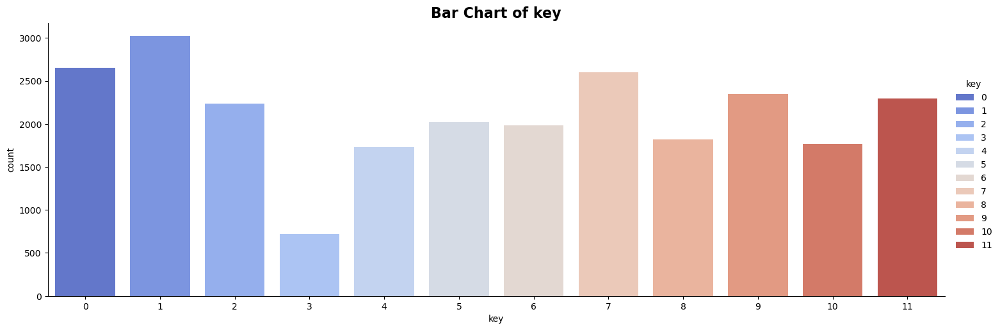

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


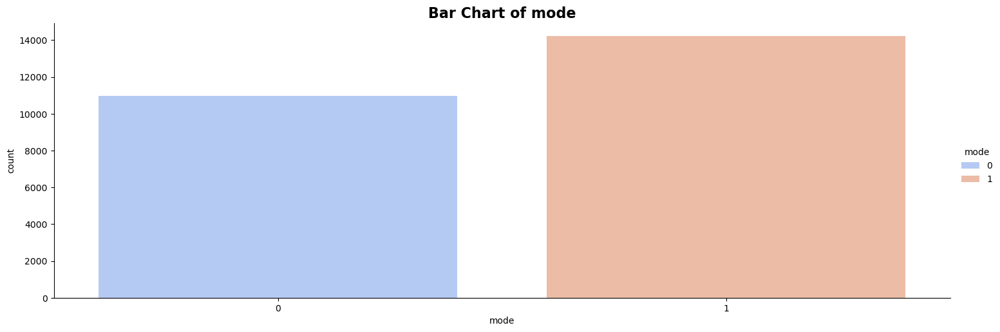

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


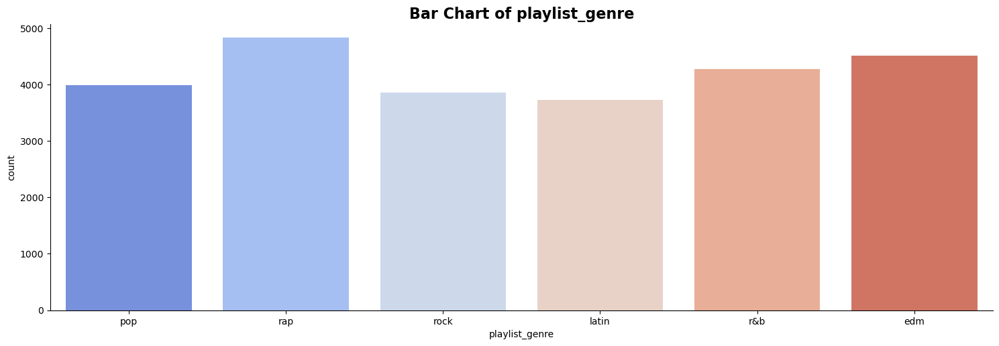

In [26]:
for var in x_cats:
    sns.catplot(data=spotify_new, x=var, hue=var, kind="count", aspect=3, palette="coolwarm")
    plt.title("Bar Chart of %s" % var, fontsize=16, fontweight="bold")
    if var == "playlist_subgenre":
        # Set x-axis labels to be horizontal
        plt.xticks(rotation=45)
    plt.show()

**2 - Distributions of continuous variables**

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


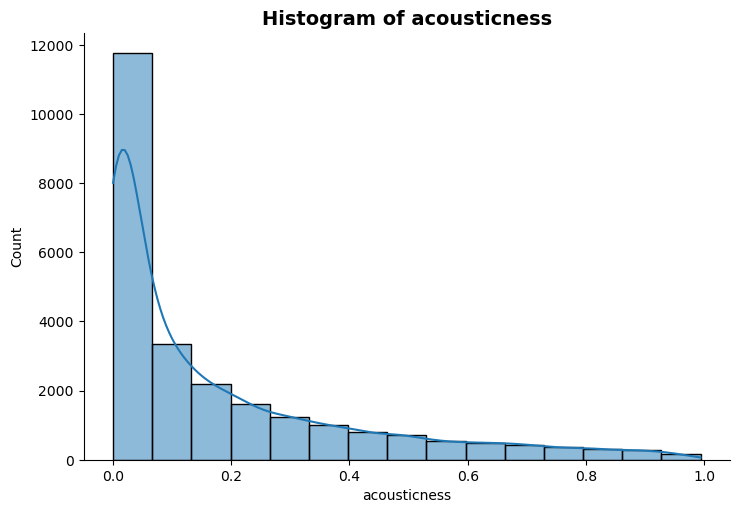

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


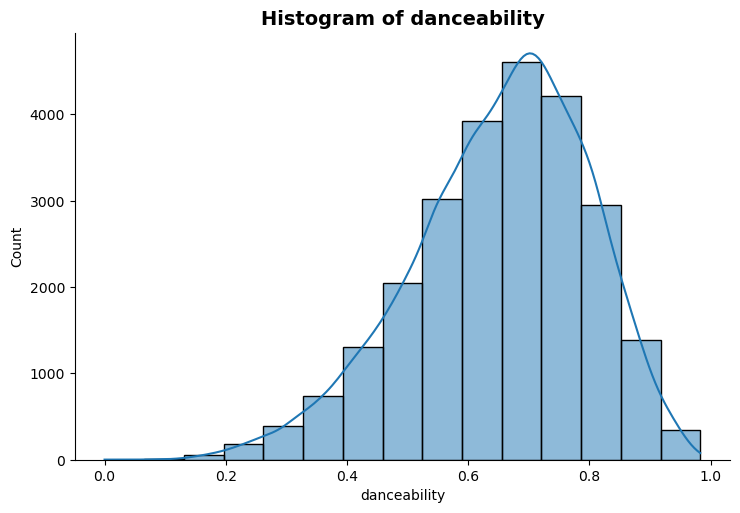

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


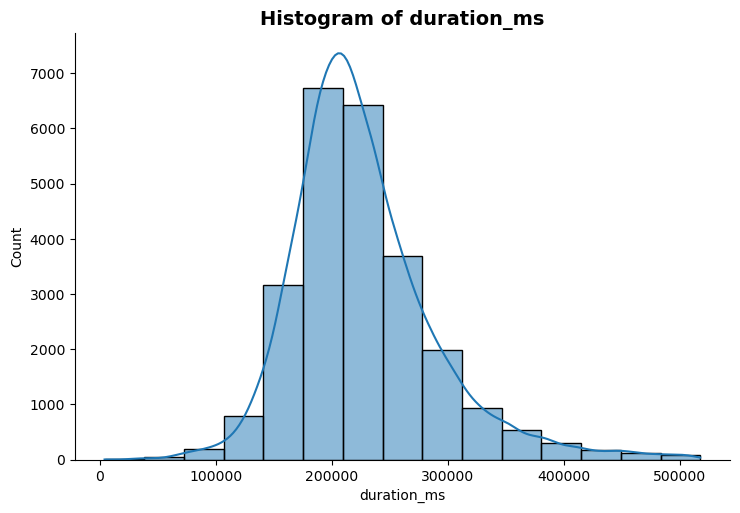

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


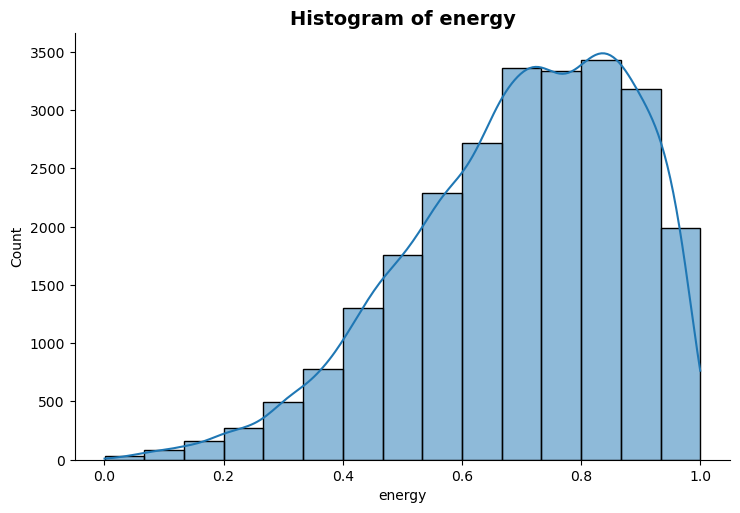

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


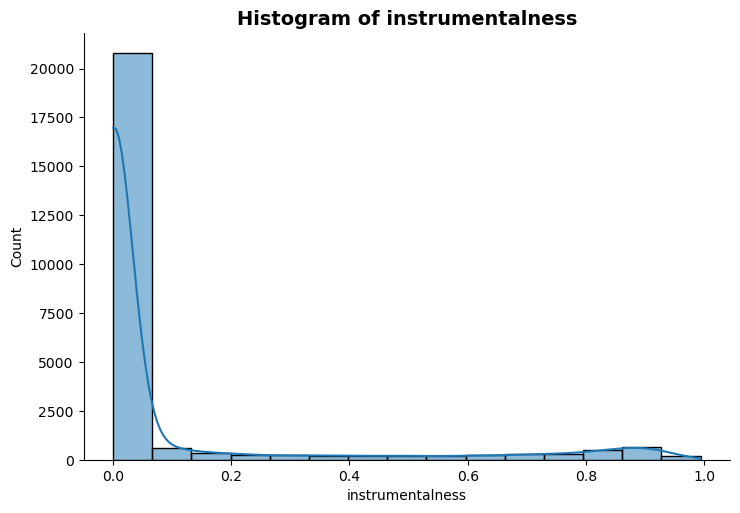

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


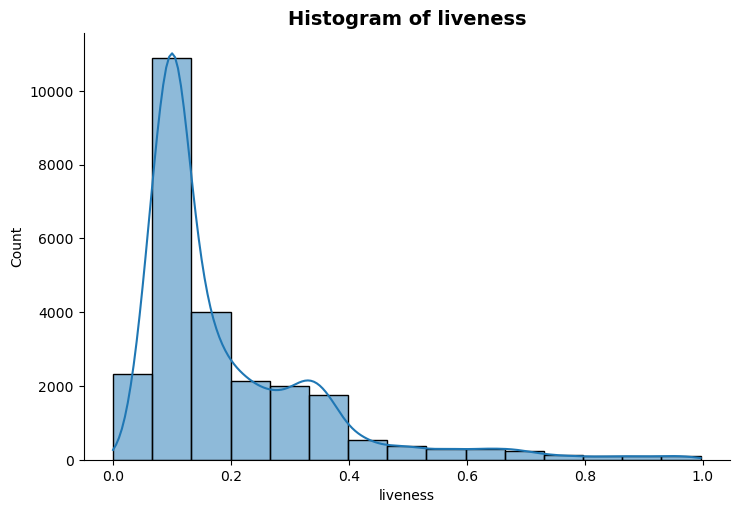

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


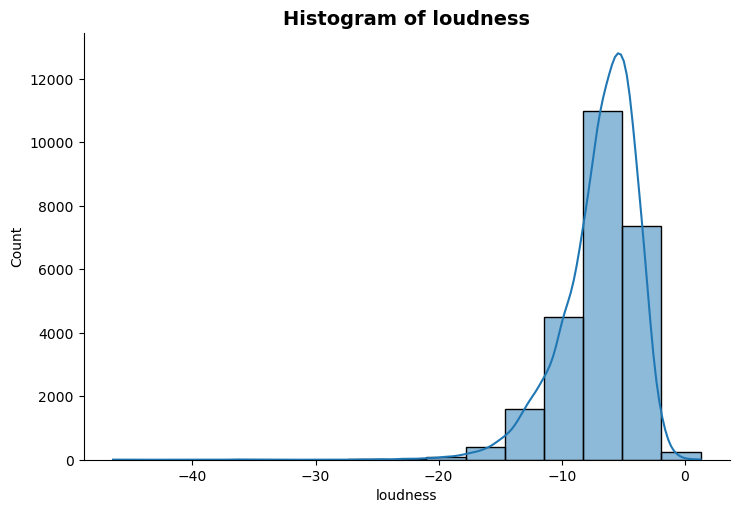

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


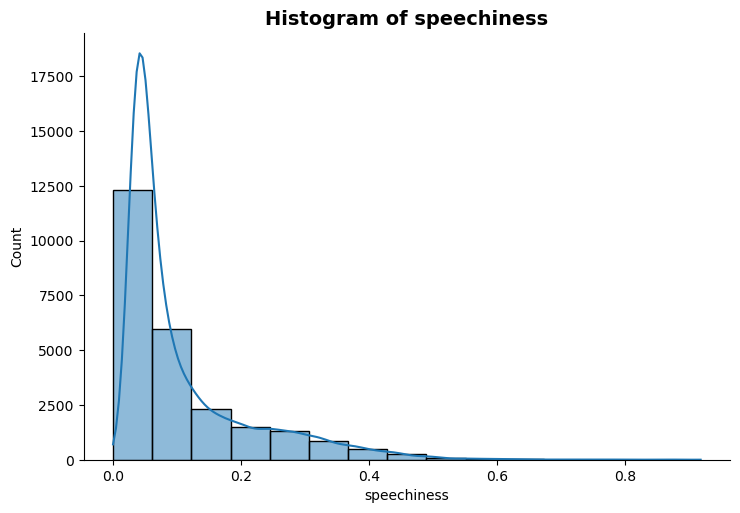

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


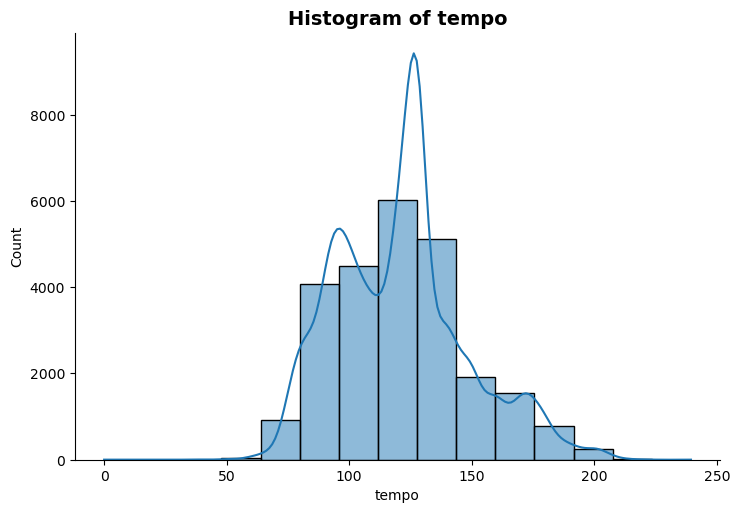

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


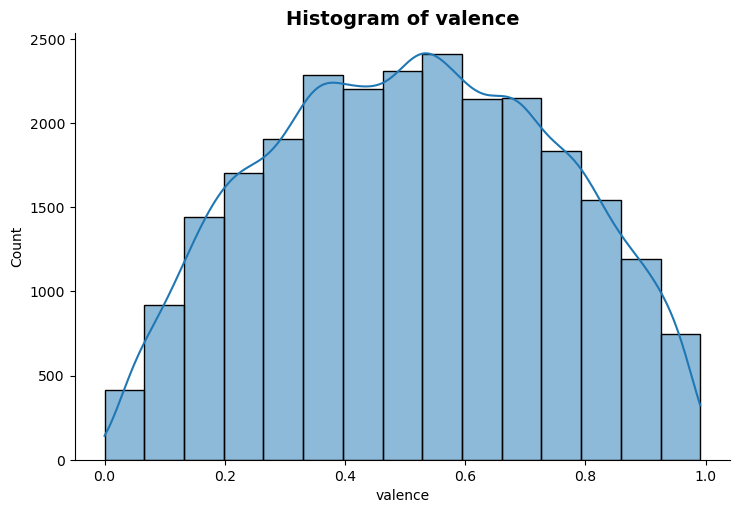

In [27]:
for var in x_nums:
    sns.displot(data=spotify_new, x=var, kind="hist", common_norm=False, bins=15, kde=True, aspect=1.5)
    plt.title("Histogram of %s" % var, fontsize=14, fontweight="bold")
    plt.show()

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


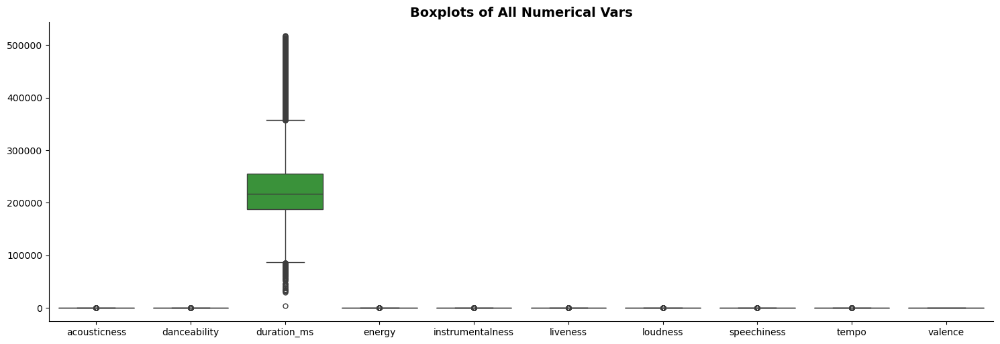

In [28]:
# for var in spotify_nums:
#     sns.catplot(data=spotify_new, y=var, kind="box", aspect=1.5)
#     plt.title("Boxplots of %s" % var, fontsize=14, fontweight="bold")
#     plt.show()
sns.catplot(data=spotify_new.loc[:, x_nums], kind="box", aspect=3)
plt.title("Boxplots of All Numerical Vars", fontsize=14, fontweight="bold")
plt.show()

### **Plotting Raw Data**

**3 - Relationships between continuous variables**

Heatmaps - Correlation Plots

In [29]:
corr_matrix_raw = spotify_new.loc[:,x_nums].corr(numeric_only=True)

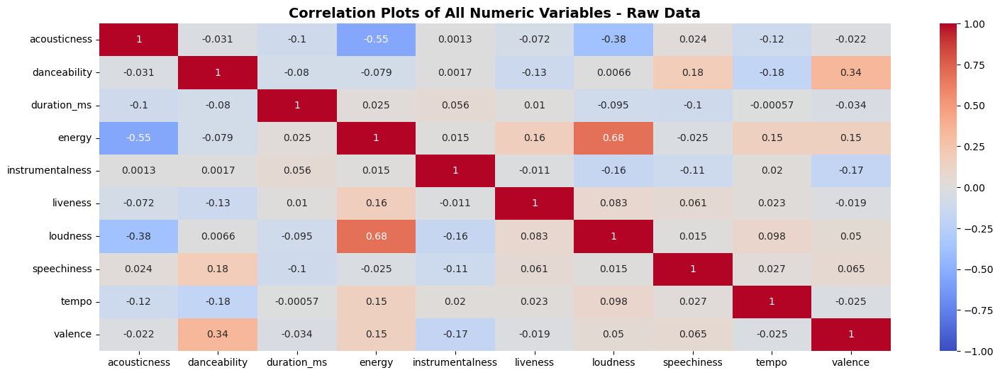

In [30]:
fig, ax = plt.subplots(figsize=(18,6))

sns.heatmap(data=corr_matrix_raw, 
            vmin=-1,
            vmax=1,
            center=0,
            annot=True,
            annot_kws={"fontsize": 10},
            cmap="coolwarm",
            ax=ax)

ax.set_title("Correlation Plots of All Numeric Variables - Raw Data", fontsize=14, fontweight="bold")
plt.show()

Correlations higher than abs(.30) are:
* Loudness with Energy (0.68)
* Valence with Danceability (0.34)
* Acousticness with Energy (-0.55)
* Acousticness with Loudness (-0.38)

Seeing if Correlation changes between numeric variables by categorical inputs

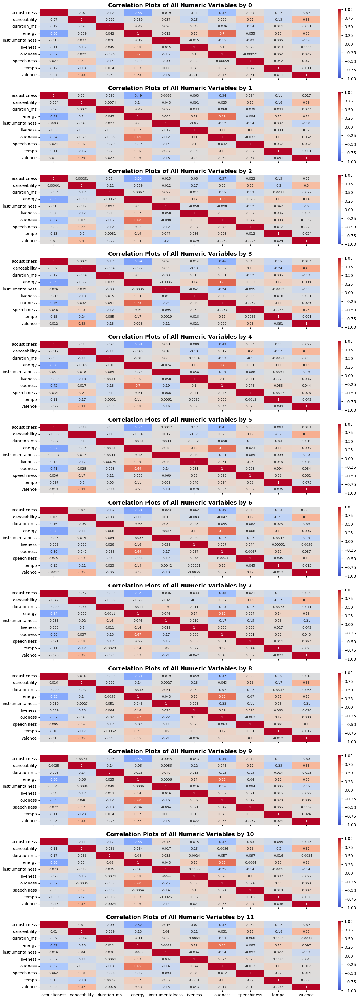

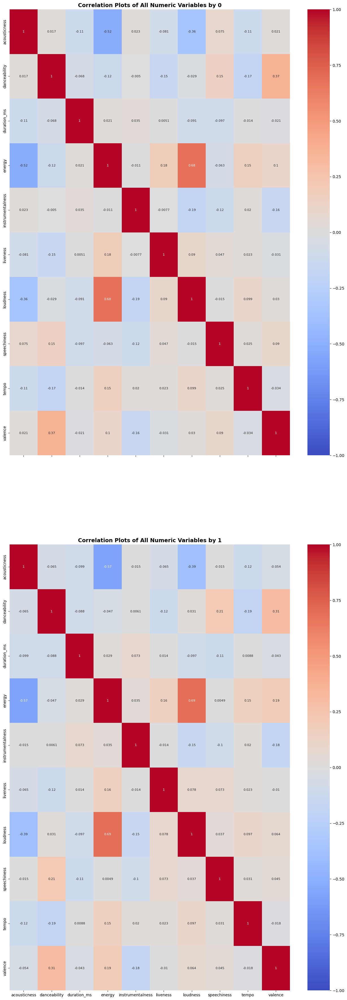

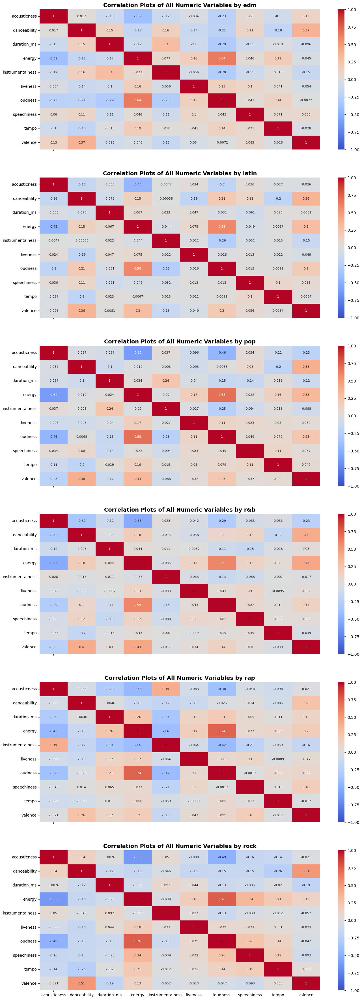

In [31]:
for var in x_cats:
    var_groups = np.sort(spotify_new[var].unique()).tolist()
    corr_groups = spotify_new.loc[:, [var]+x_nums].groupby(var).corr()
    
    fig, axs = plt.subplots(len(var_groups), 1, figsize=(16,45), sharex=True, sharey=True)
    for ix in range(len(var_groups)):
        sns.heatmap(data=(corr_groups.loc[var_groups[ix]]), 
                    vmin=-1,
                    vmax=1,
                    center=0,
                    annot=True,
                    annot_kws={"fontsize": 8},
                    cmap="coolwarm",
                    ax=axs[ix])
        
        axs[ix].set_title("Correlation Plots of All Numeric Variables by %s" % (var_groups[ix]), fontsize=14, fontweight="bold")
    plt.show()

The correlations seem very similar between groups of `key` and `mode`, but are different with `playlist_genre`.

Pairs Plot

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


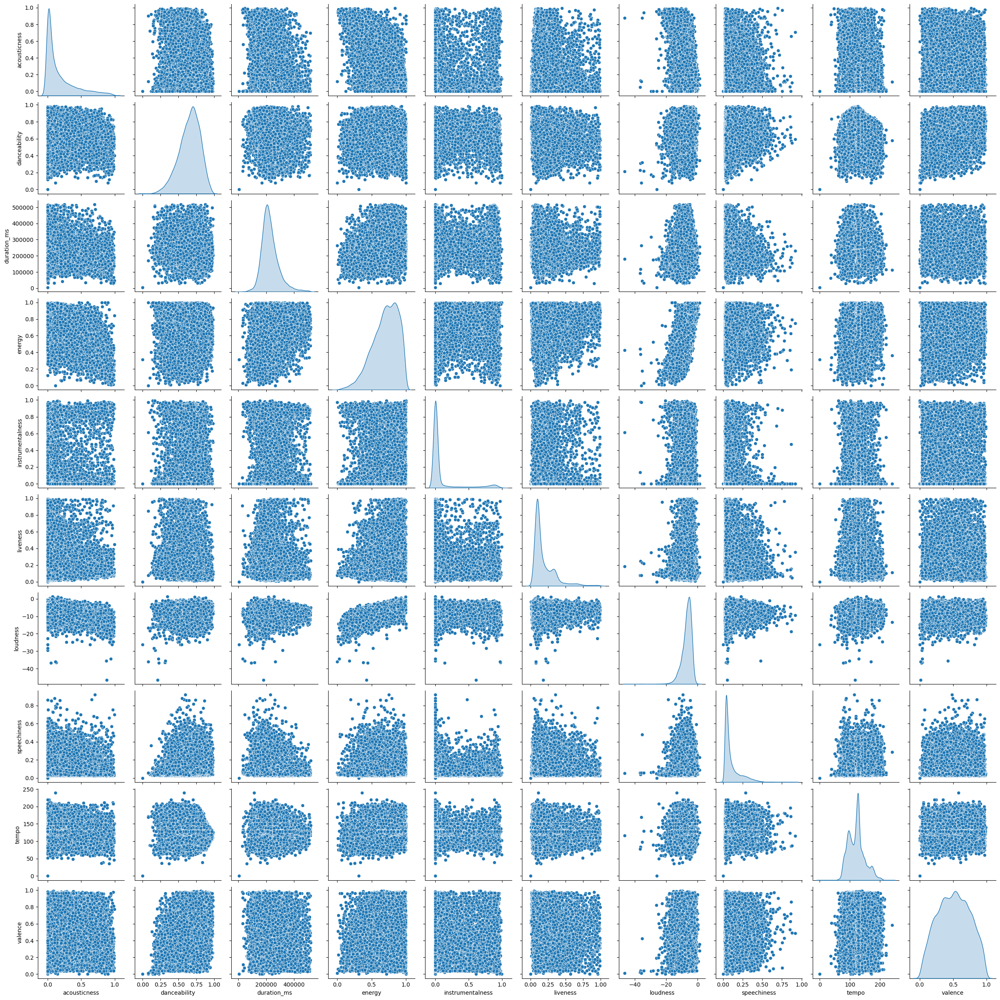

In [32]:
sns.pairplot(data=spotify_new.loc[:, x_nums],
            diag_kind="kde",
            diag_kws={"common_norm": False})
plt.show()

**4 - Summaries of the continuous variables grouped by categorical variables**

Point Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


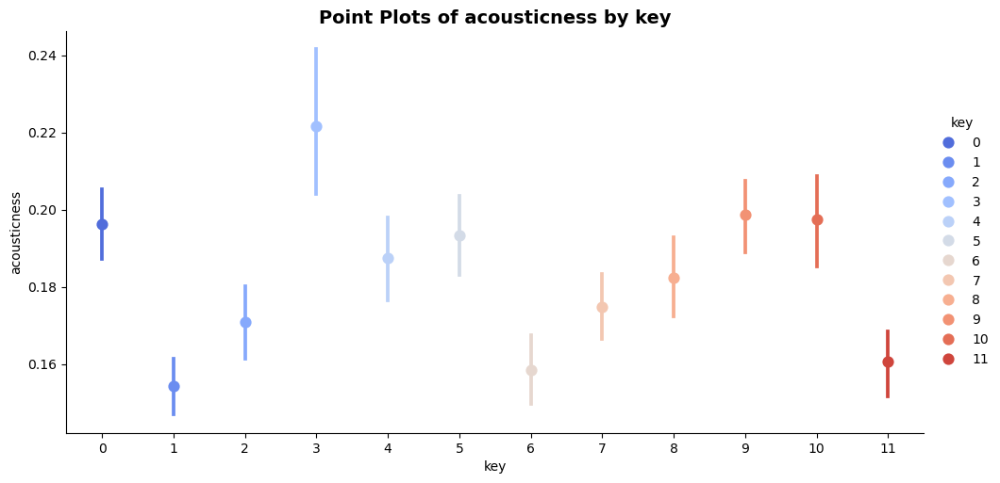

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


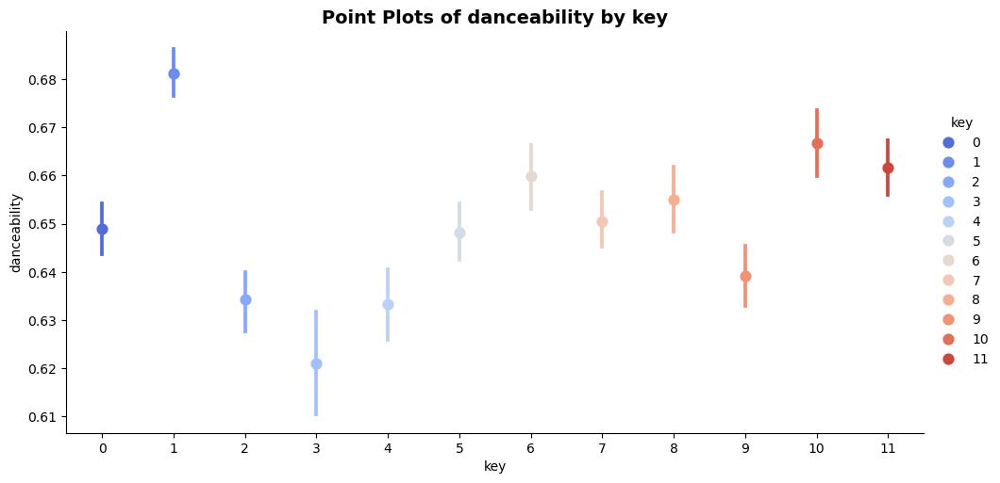

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


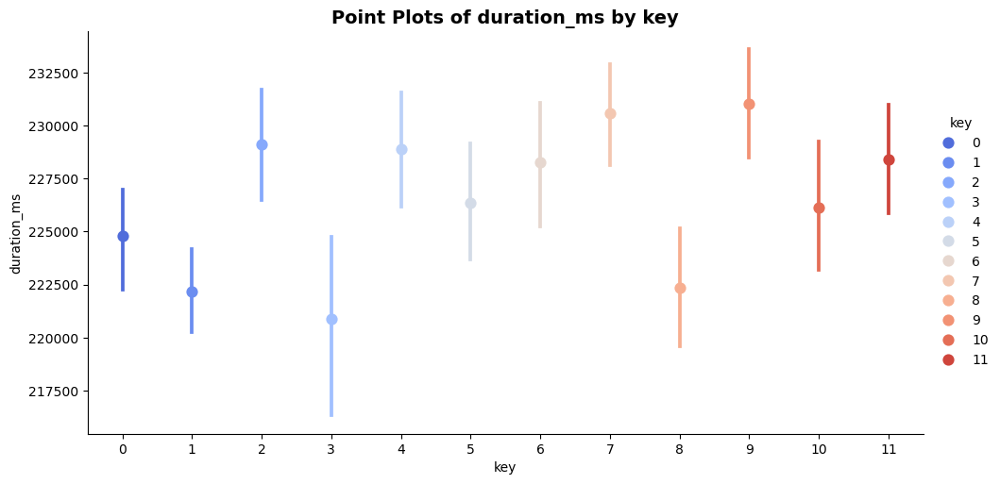

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


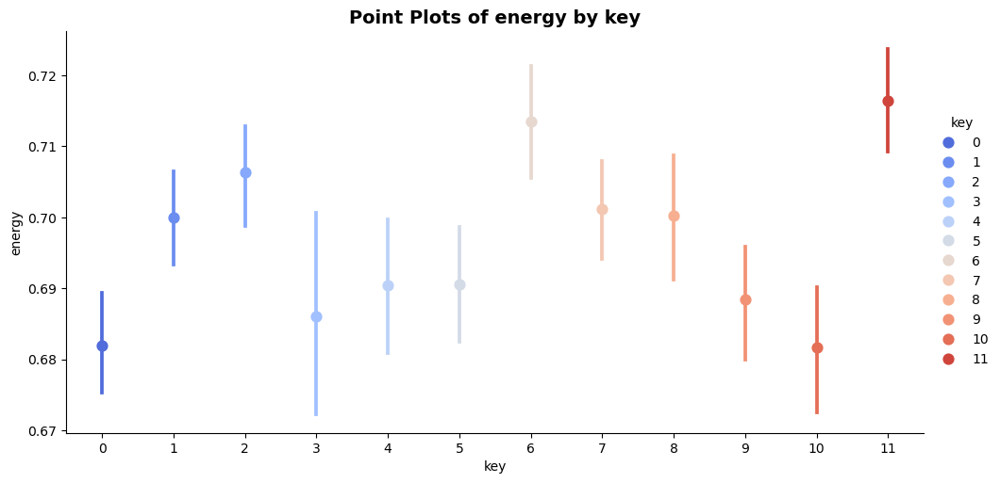

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


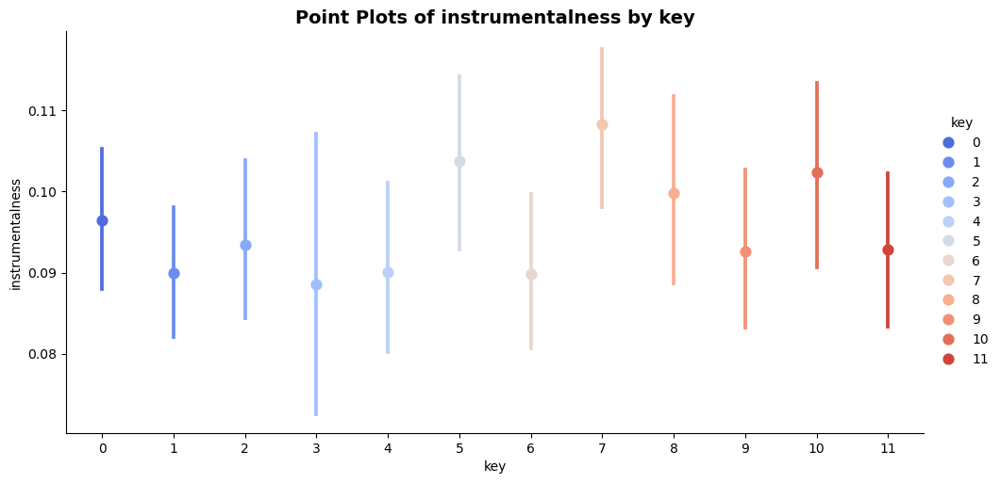

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


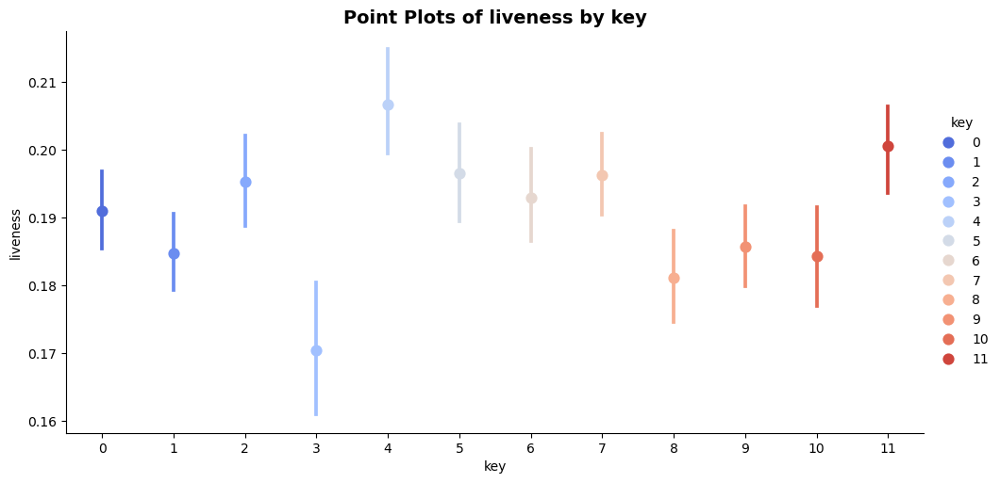

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


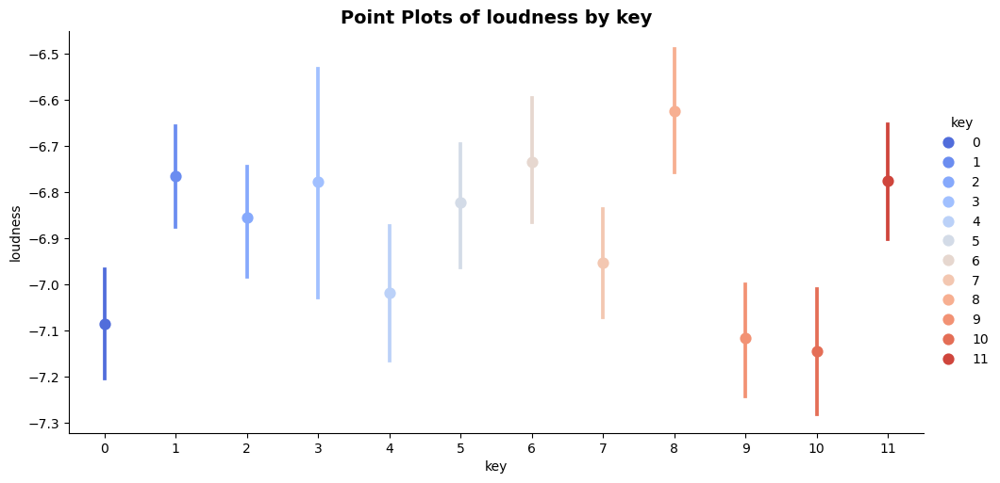

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


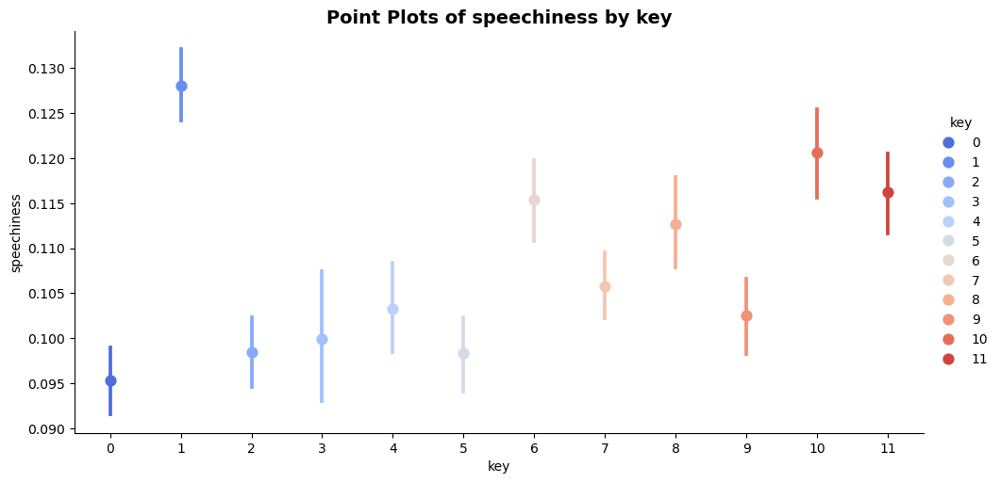

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


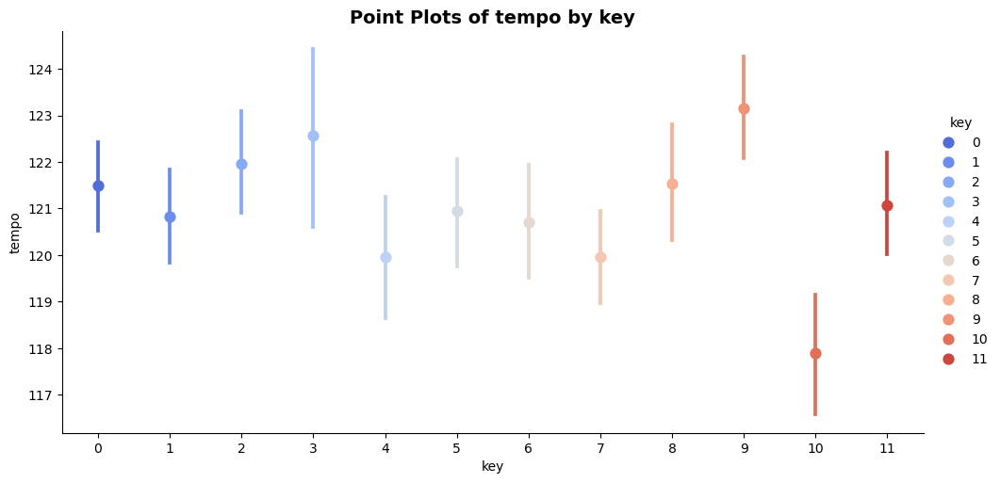

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


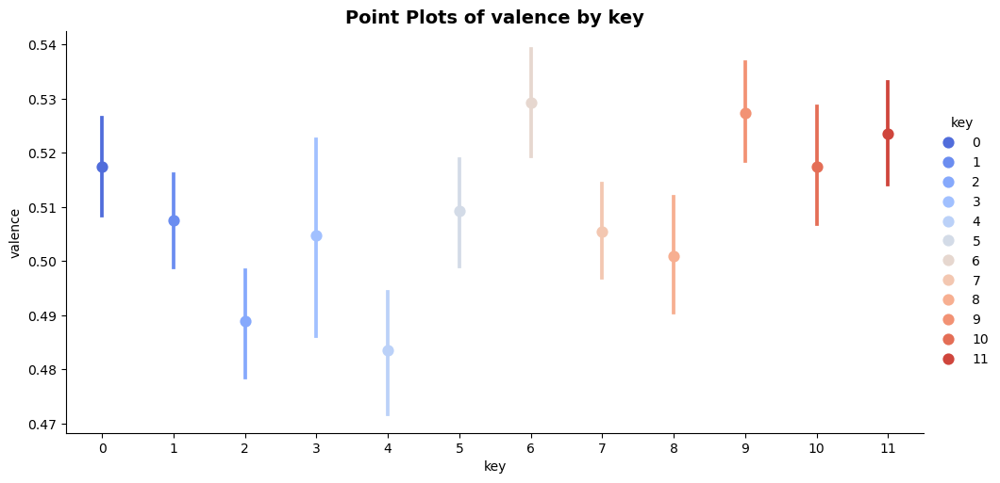

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


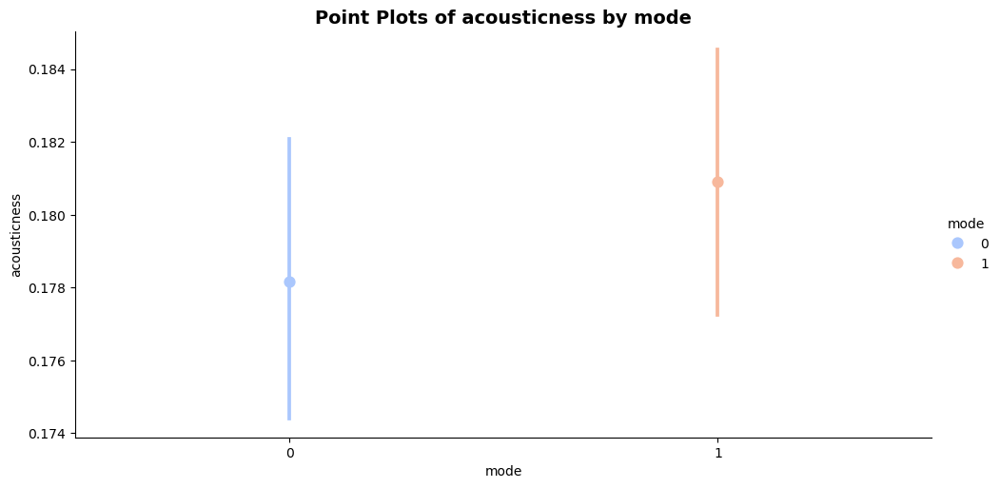

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


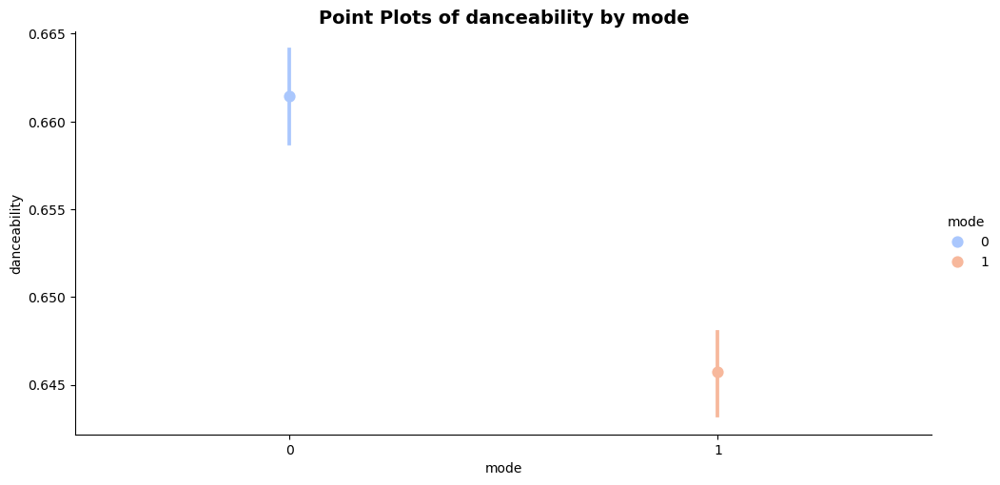

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


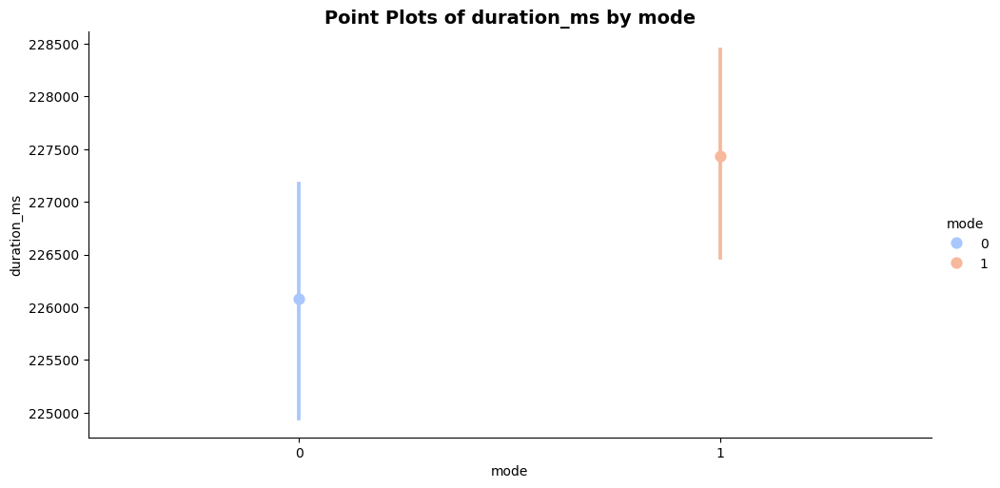

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


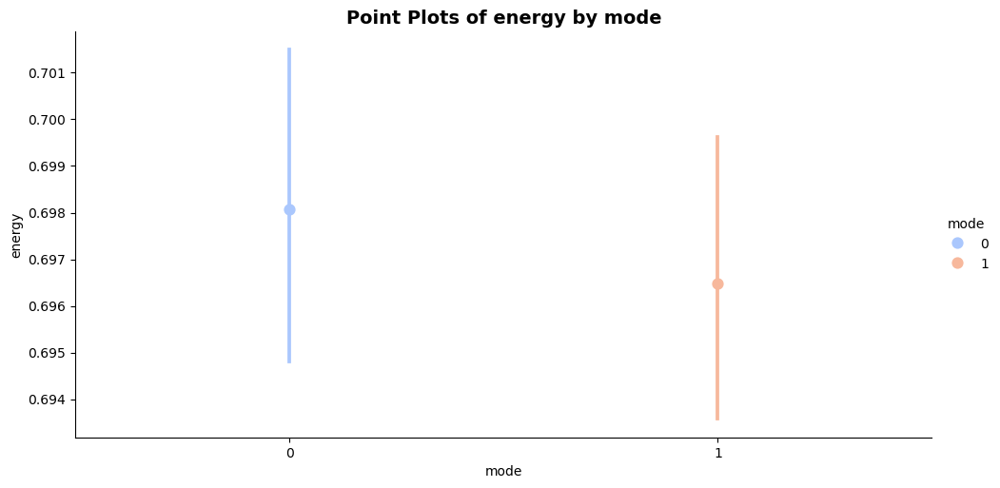

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


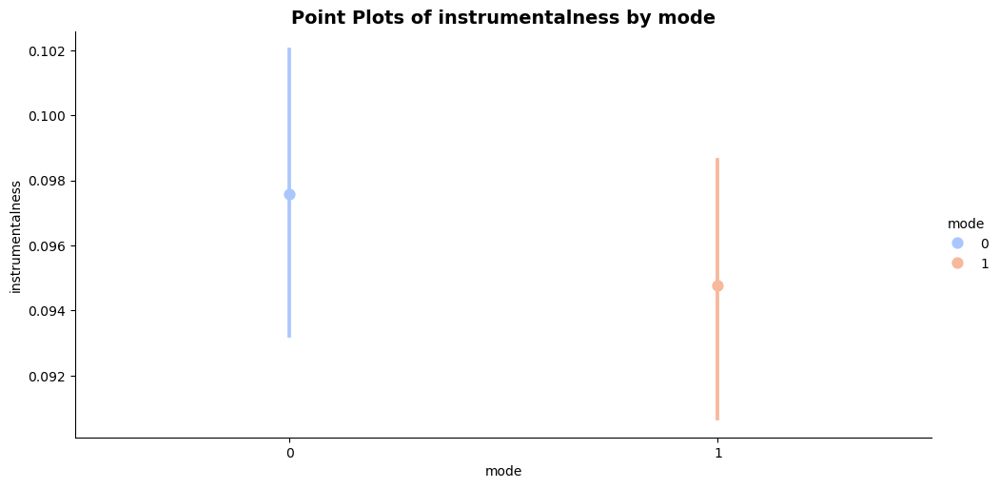

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


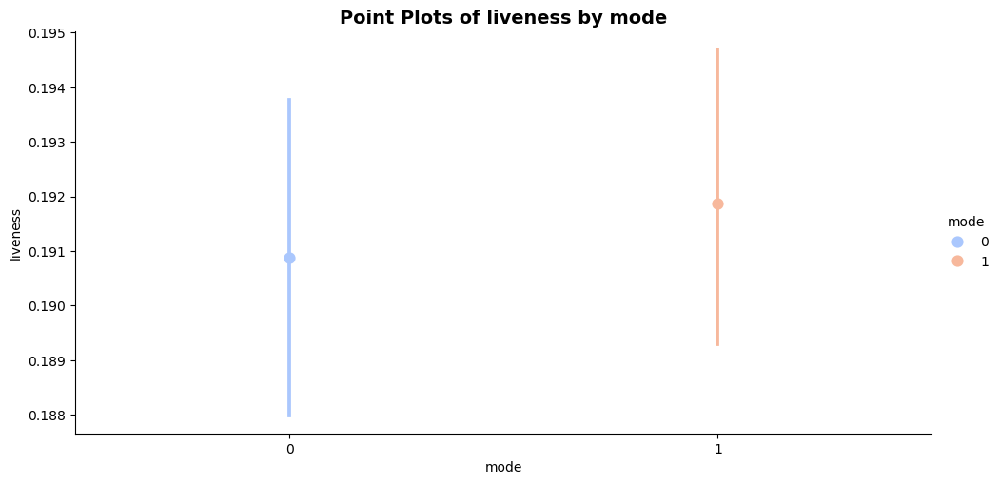

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


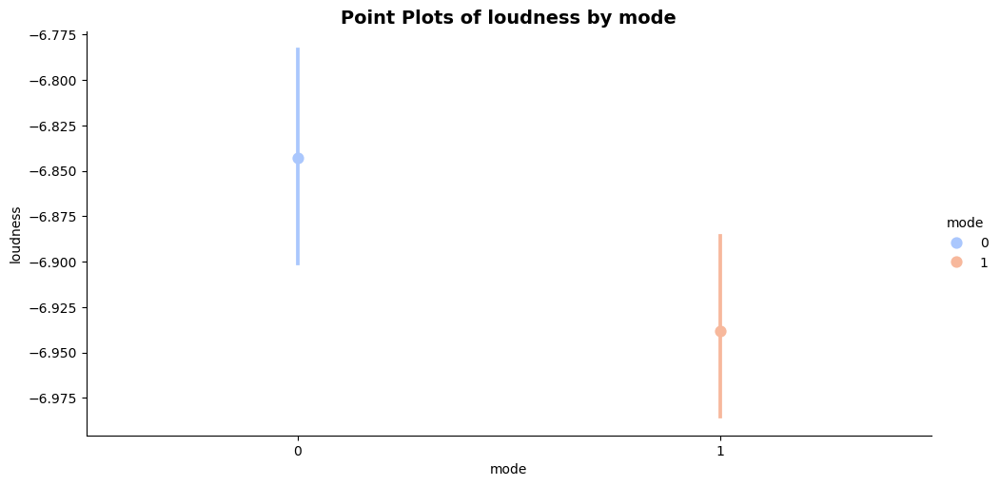

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


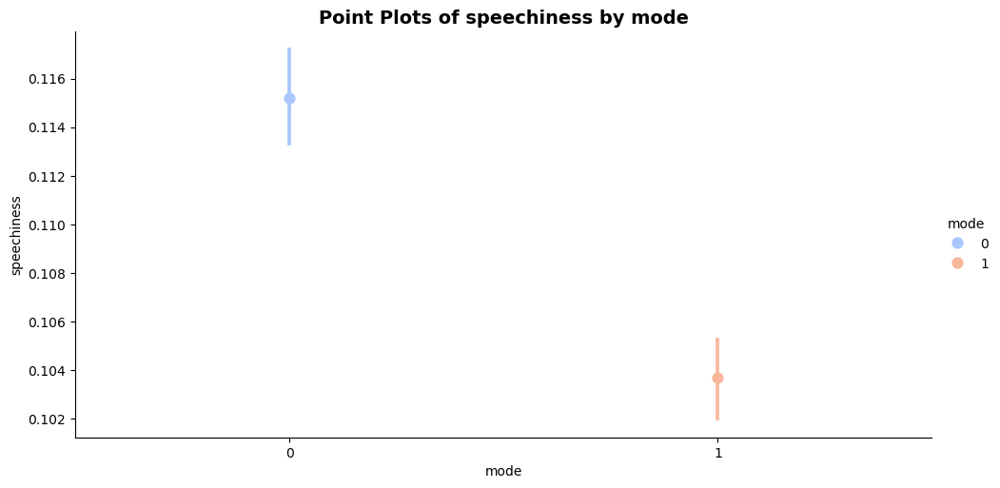

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


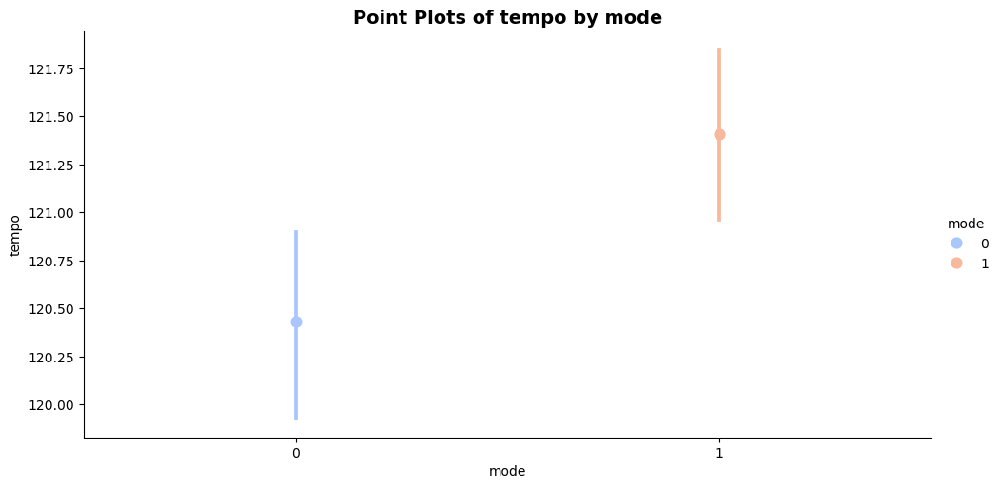

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


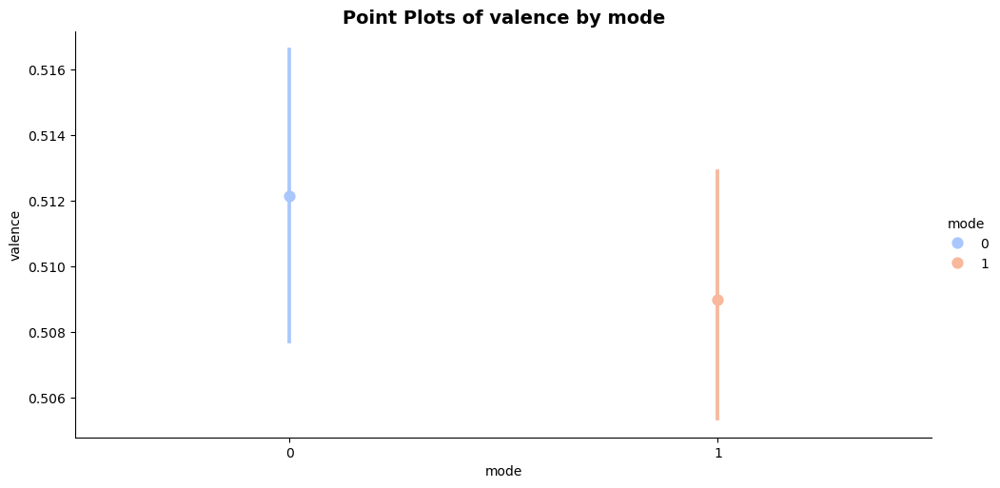

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


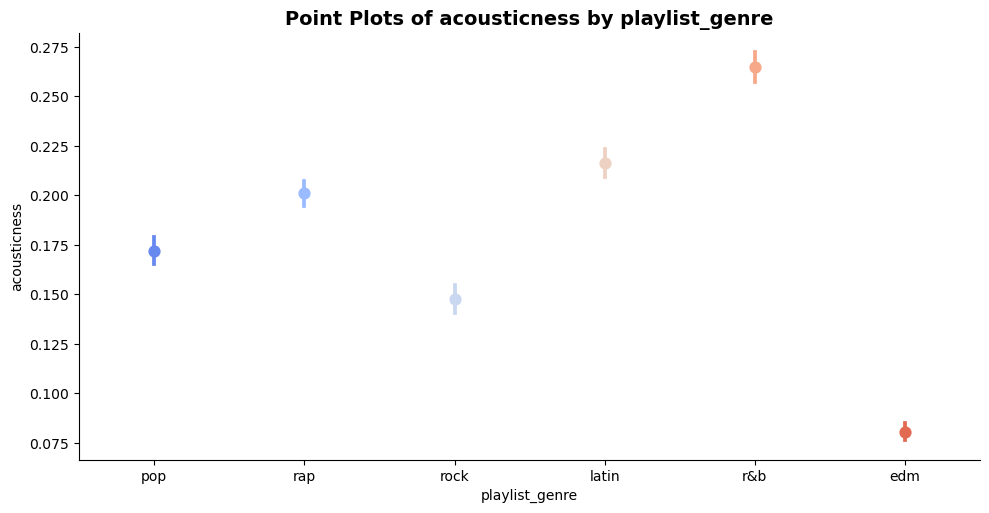

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


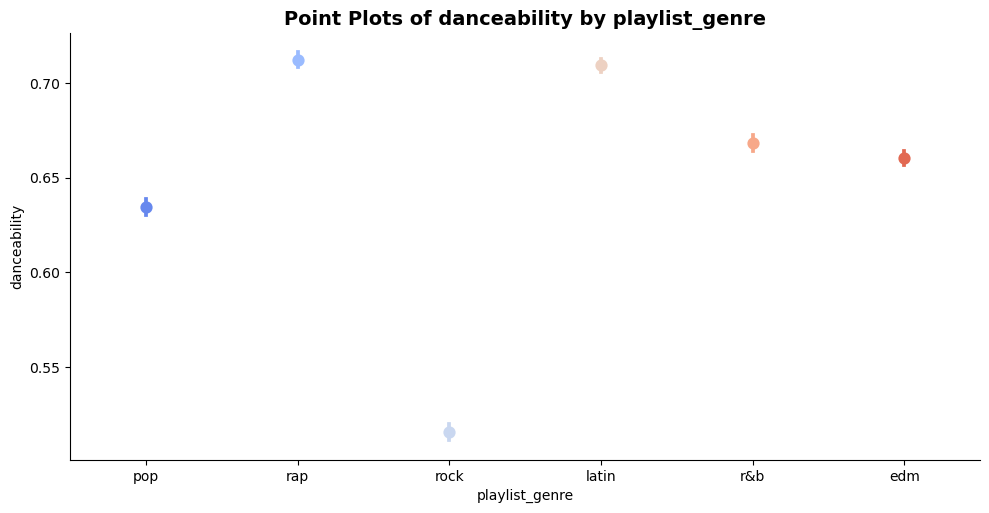

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


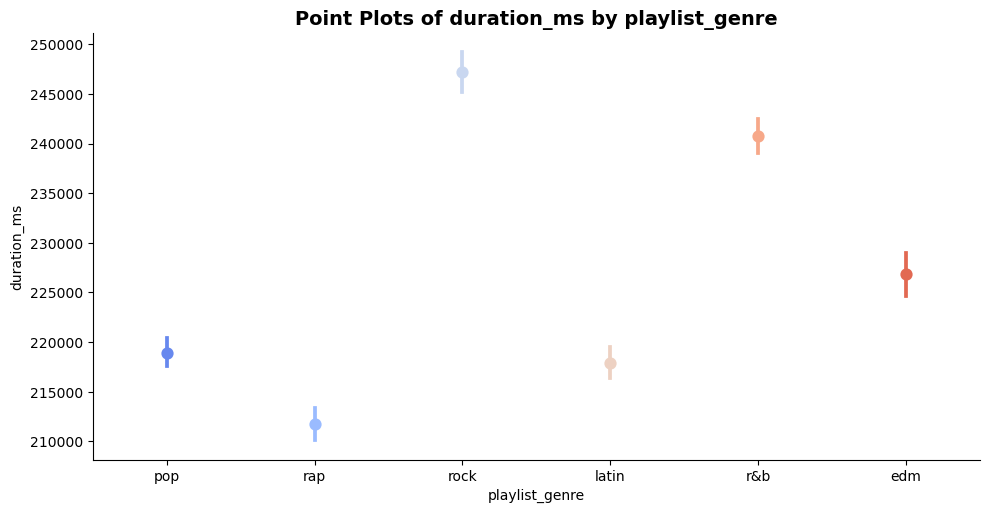

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


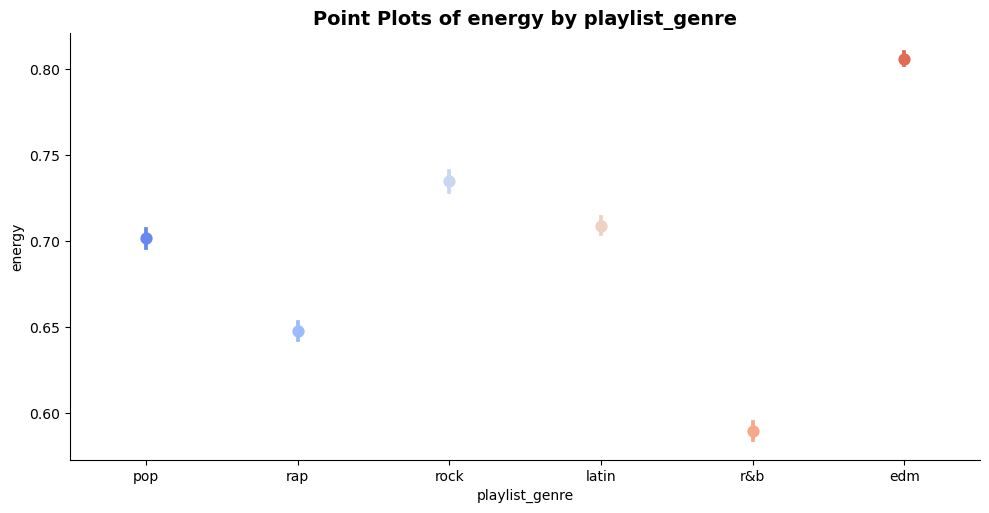

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


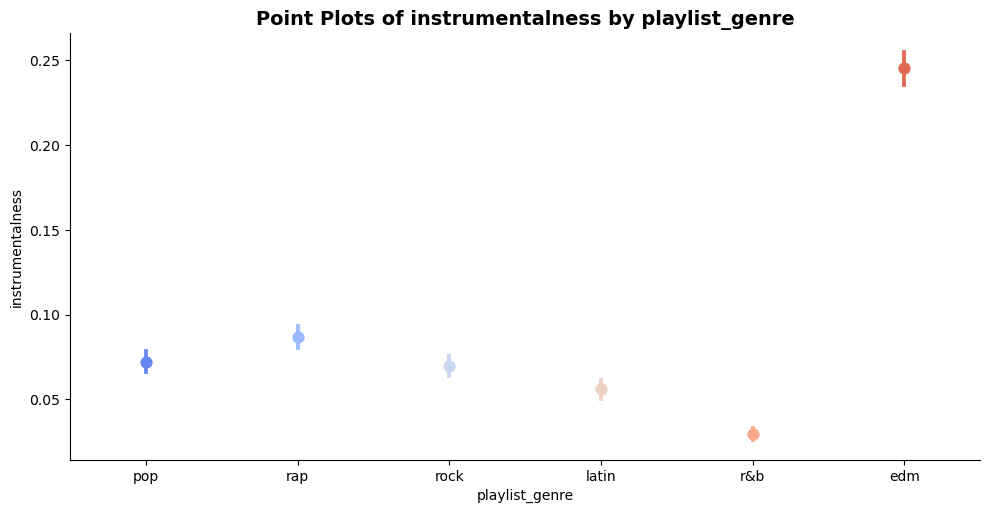

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


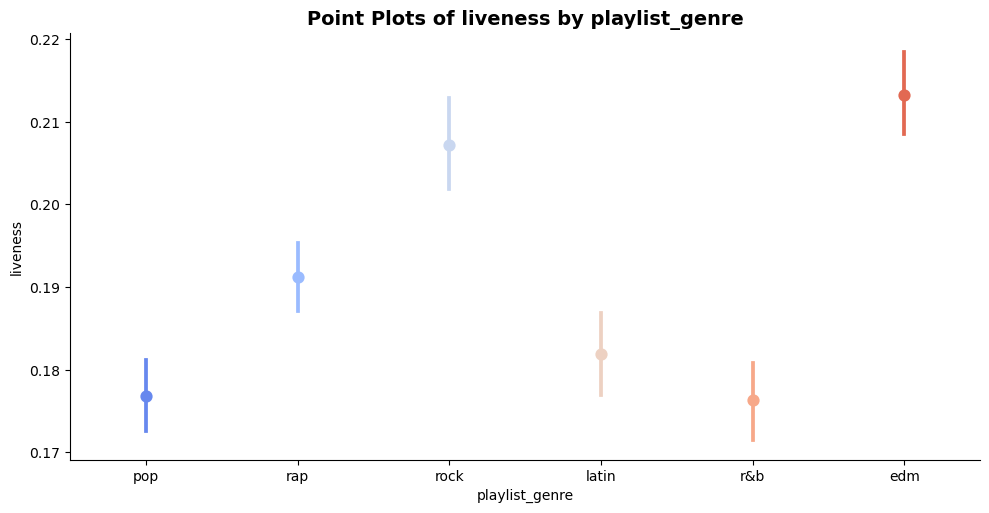

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


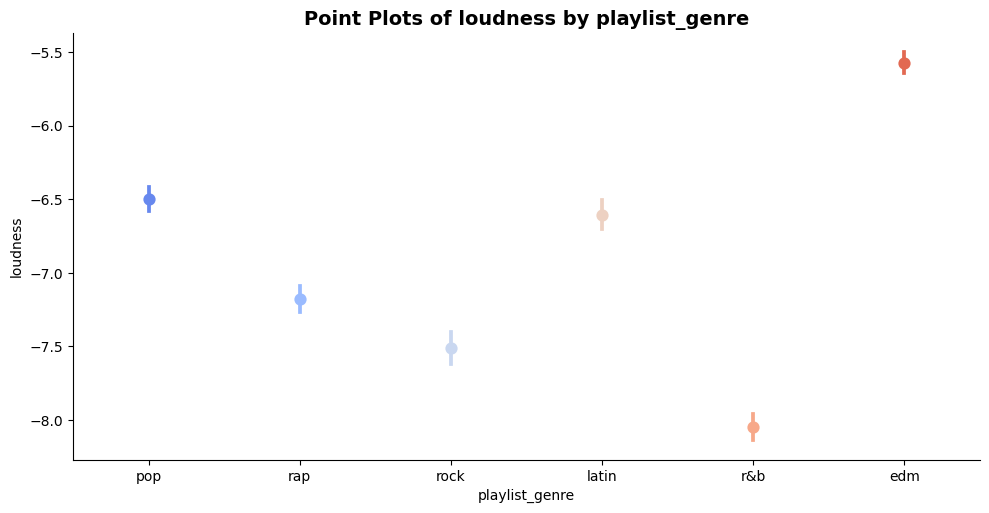

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


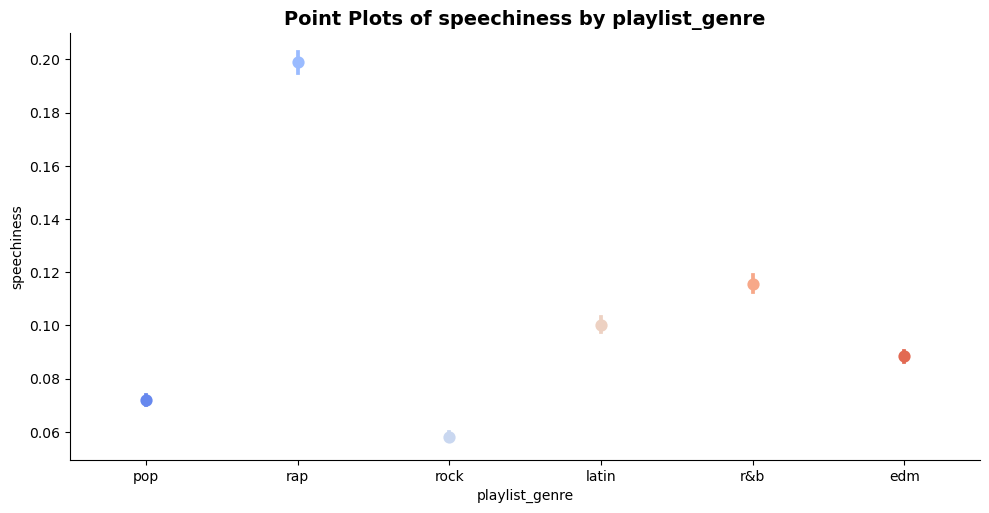

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


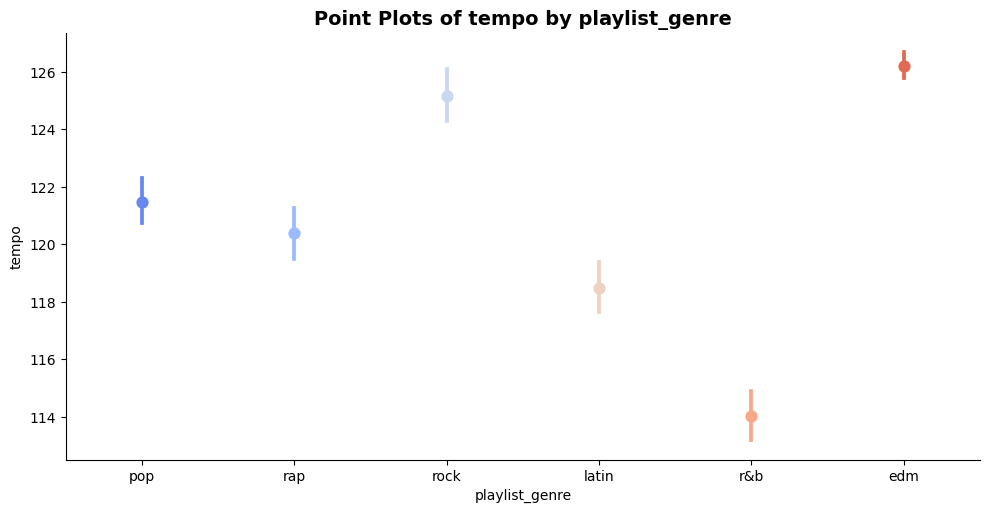

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


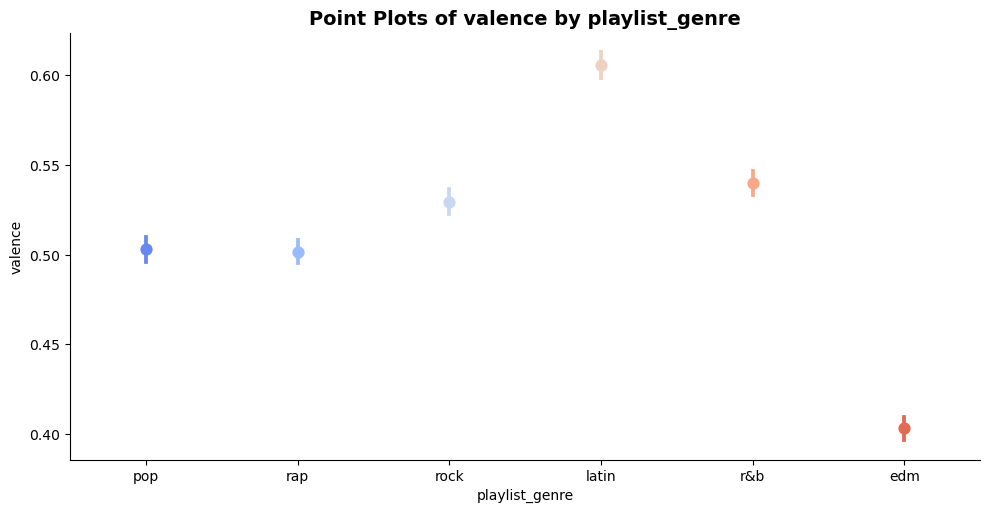

In [33]:
for var2 in x_cats:
    for var in x_nums:
        sns.catplot(data=spotify_new, x=var2, y=var, hue=var2, kind="point", palette="coolwarm", linestyle="none", aspect=2)
        if var2 == "mostcom_playlistsubgenre":
            # Set x-axis labels to be horizontal
            plt.xticks(rotation=45)
        plt.title("Point Plots of %s by %s" % (var, var2), fontsize=14, fontweight="bold")
        plt.show()

Violin Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


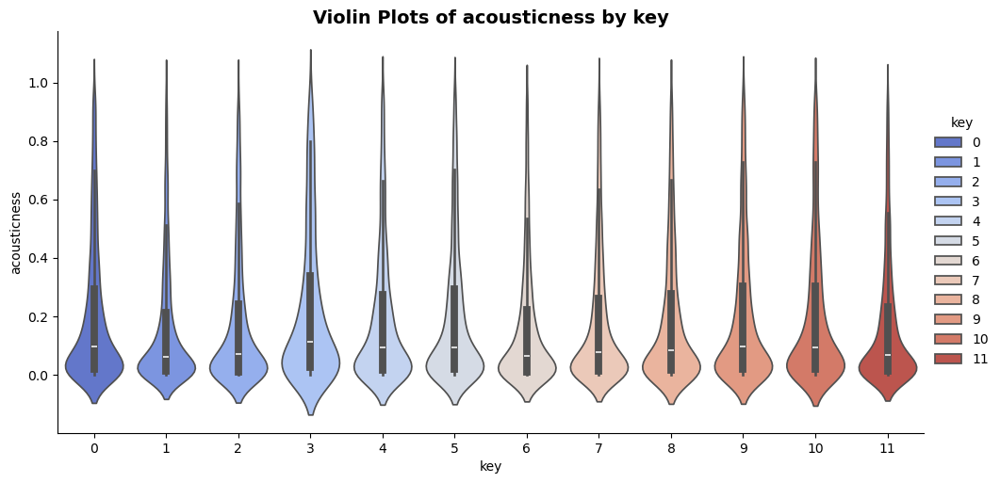

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


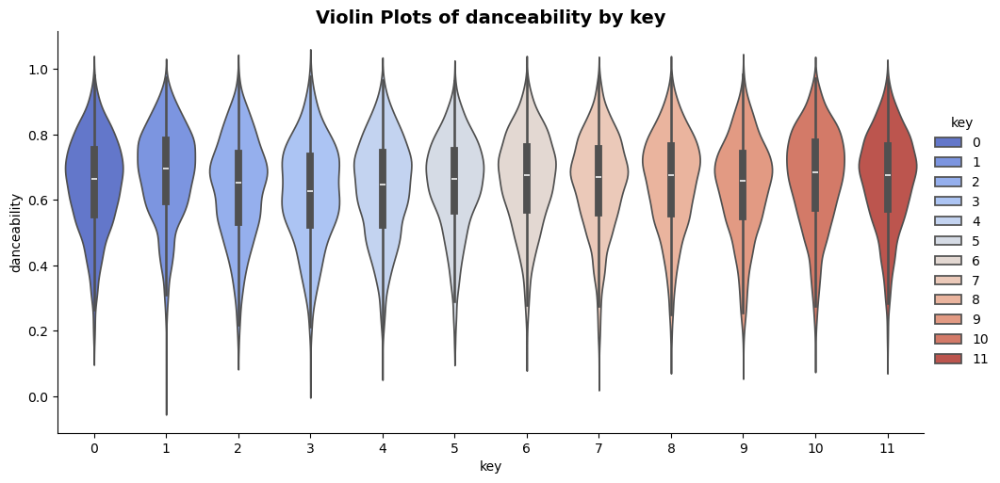

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


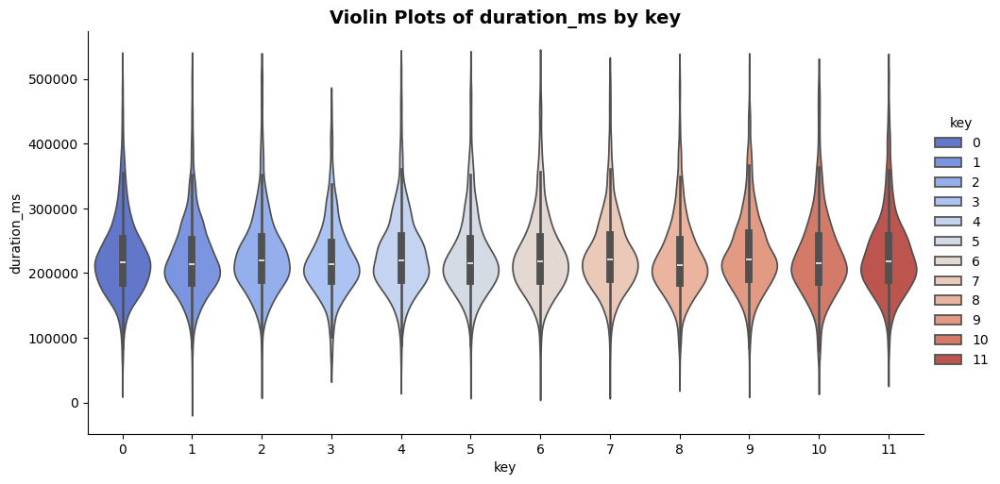

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


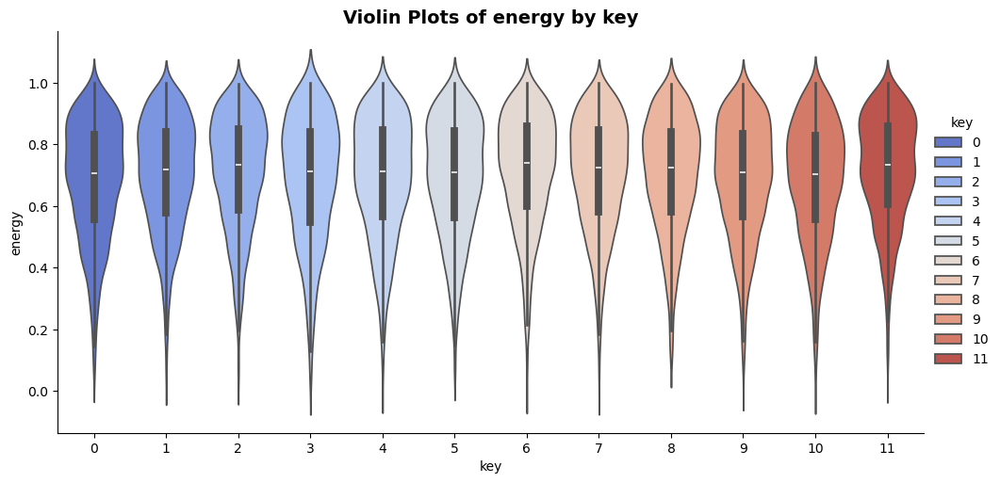

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


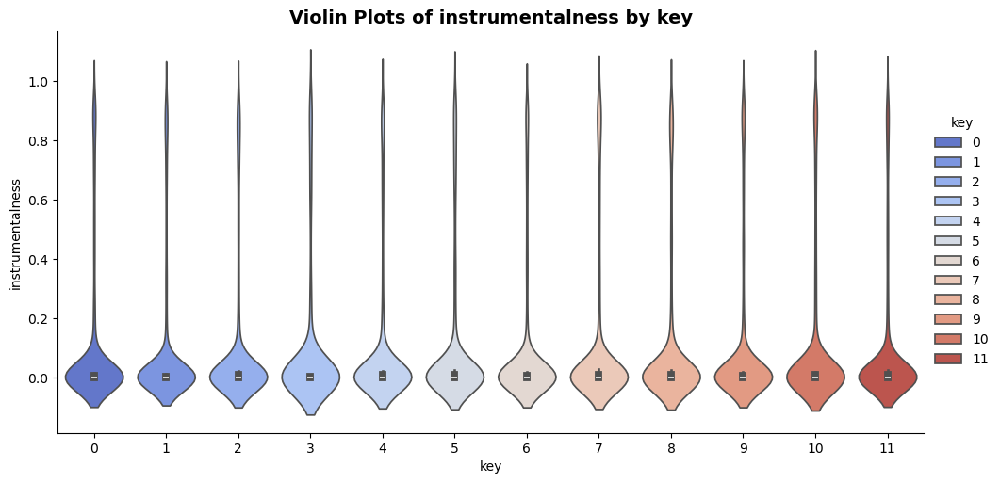

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


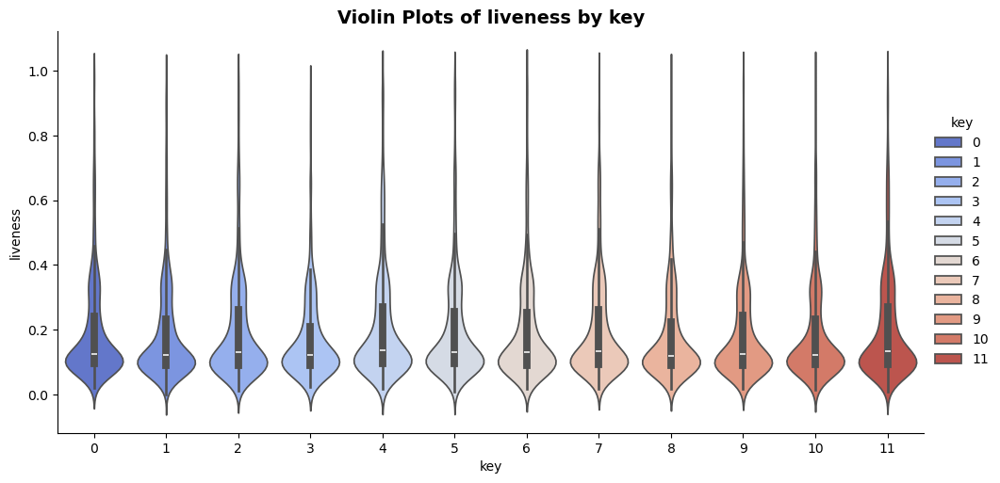

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


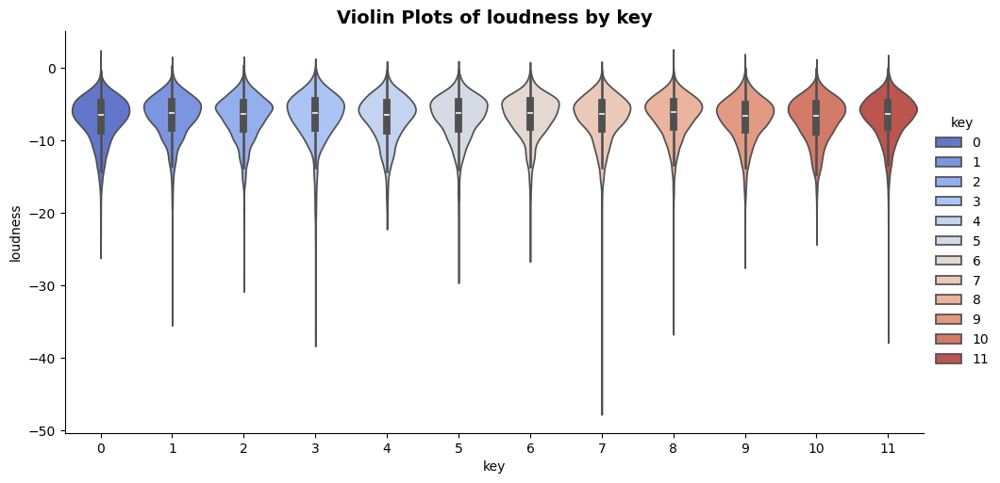

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


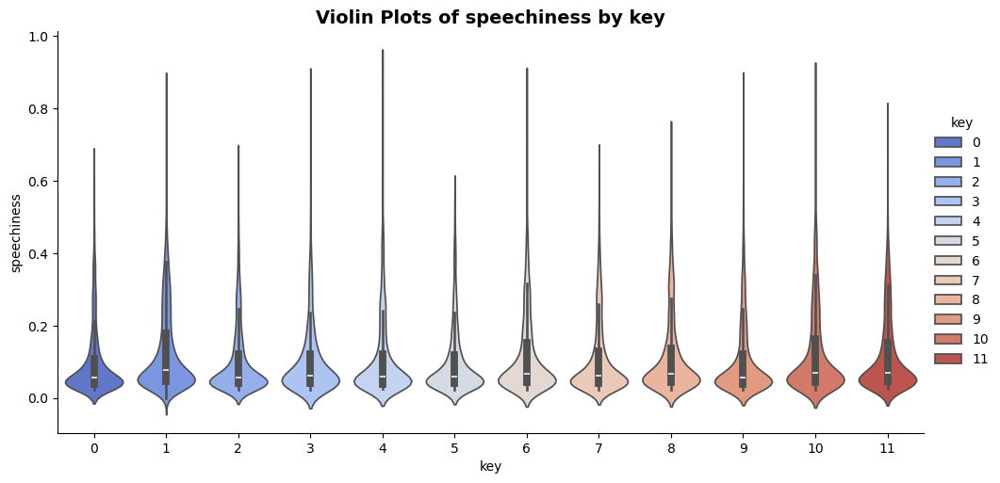

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


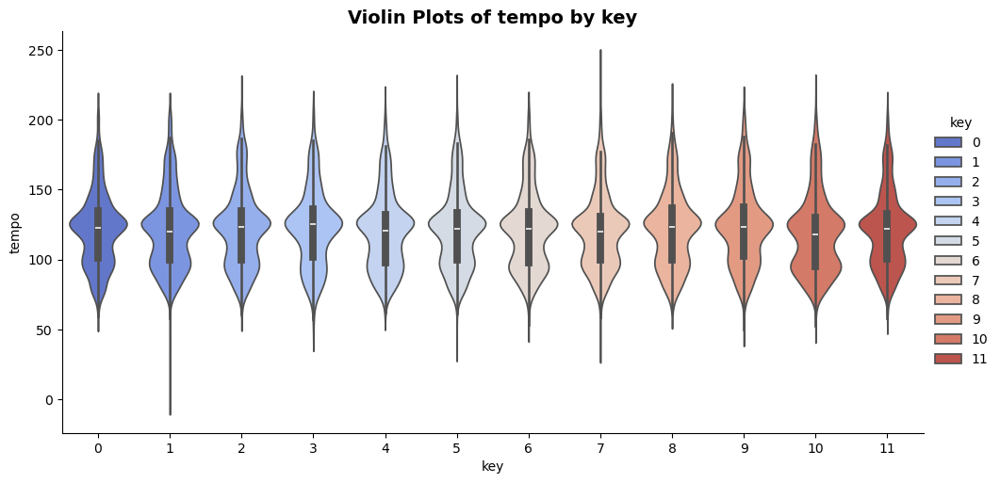

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


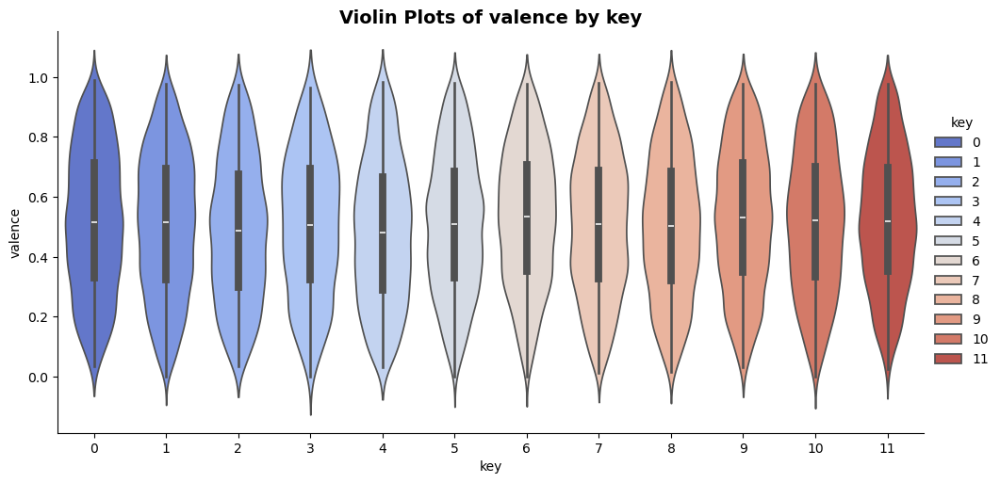

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


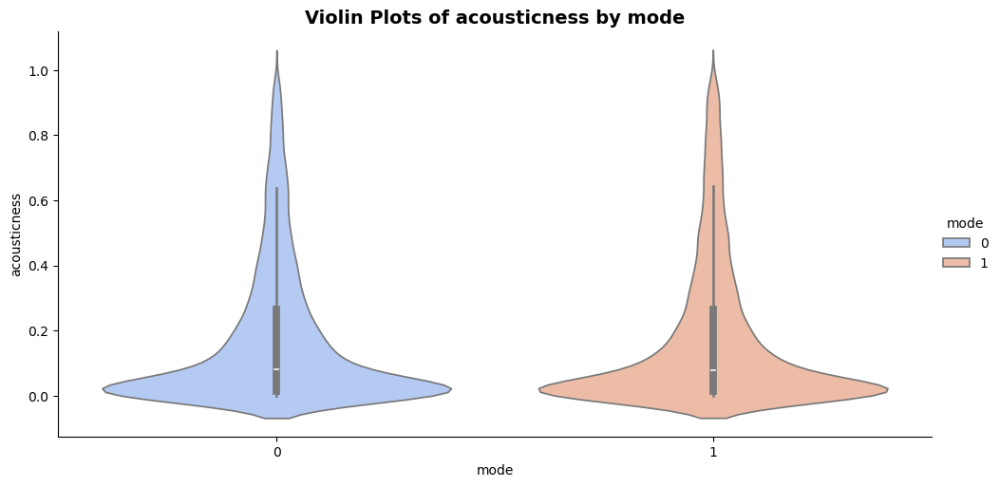

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


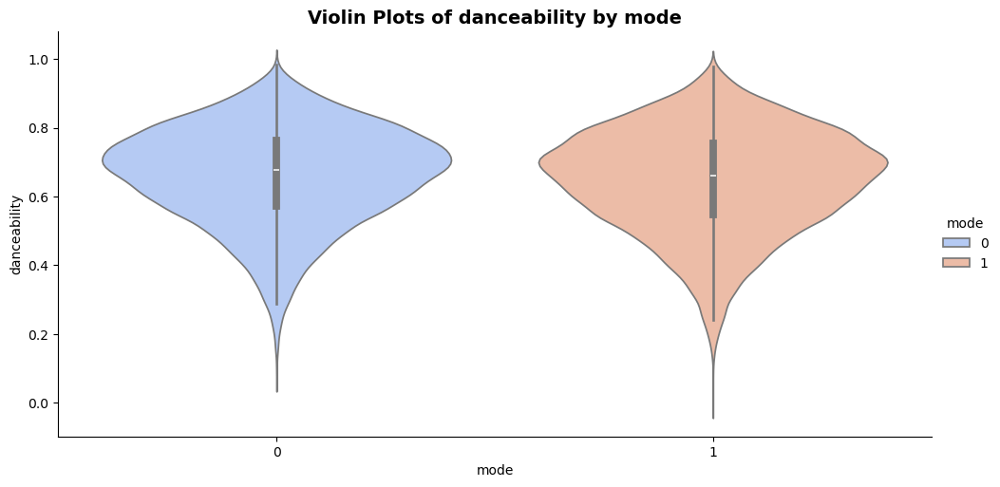

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


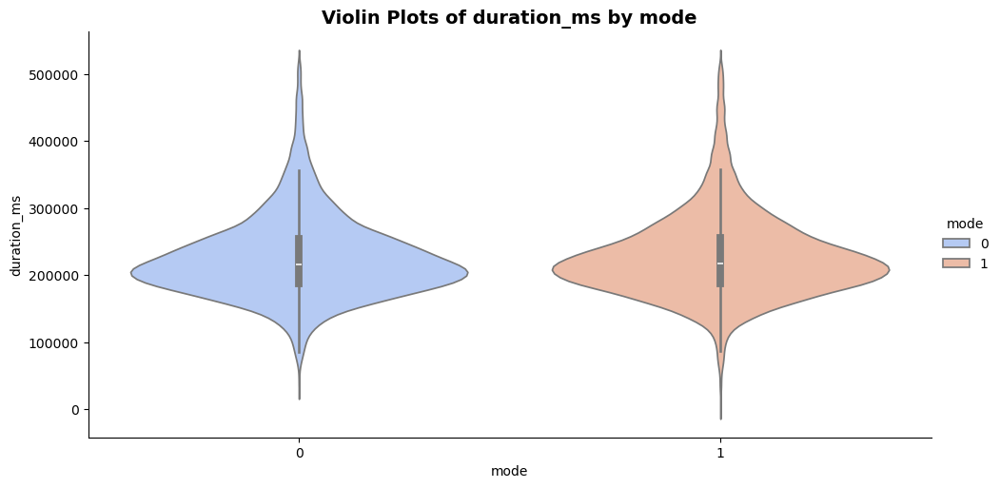

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


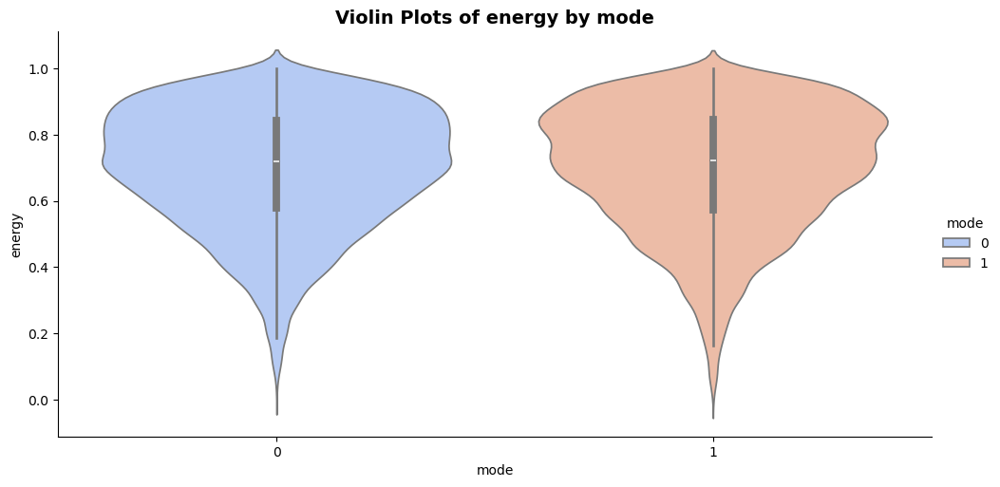

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


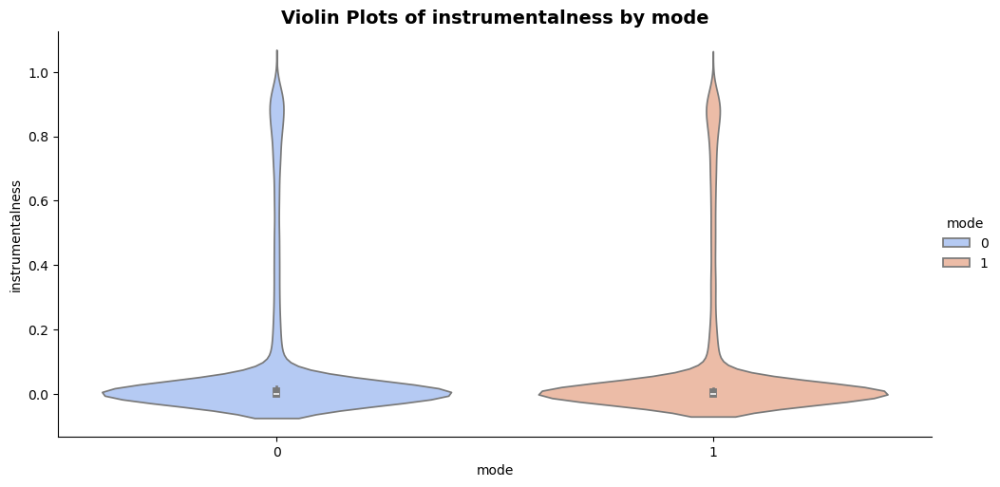

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


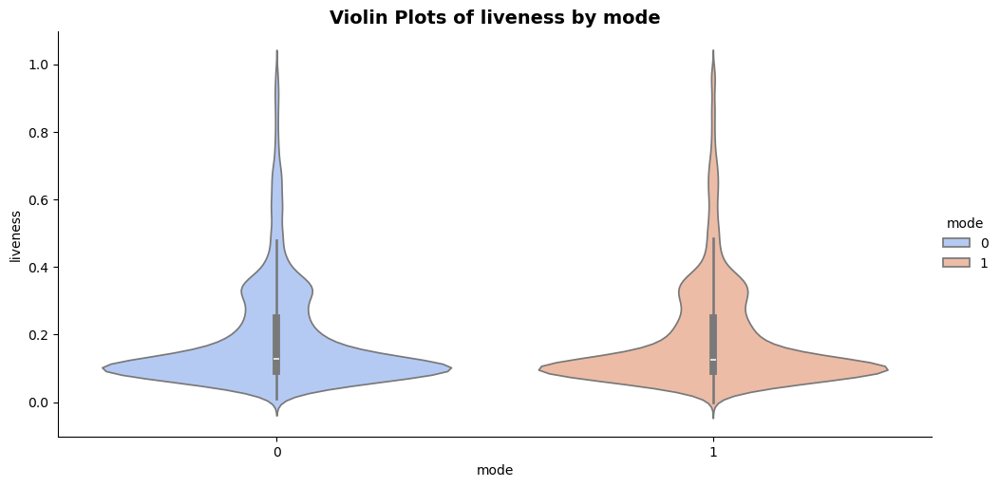

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


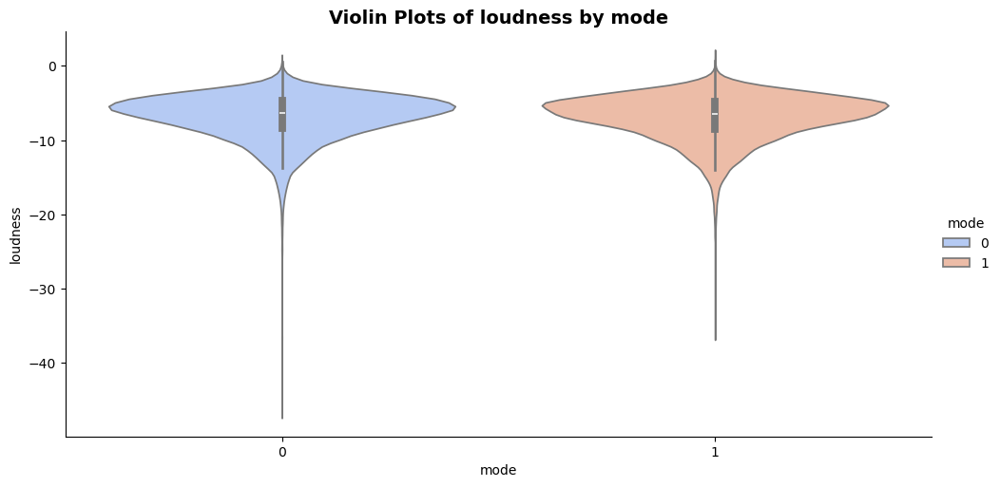

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


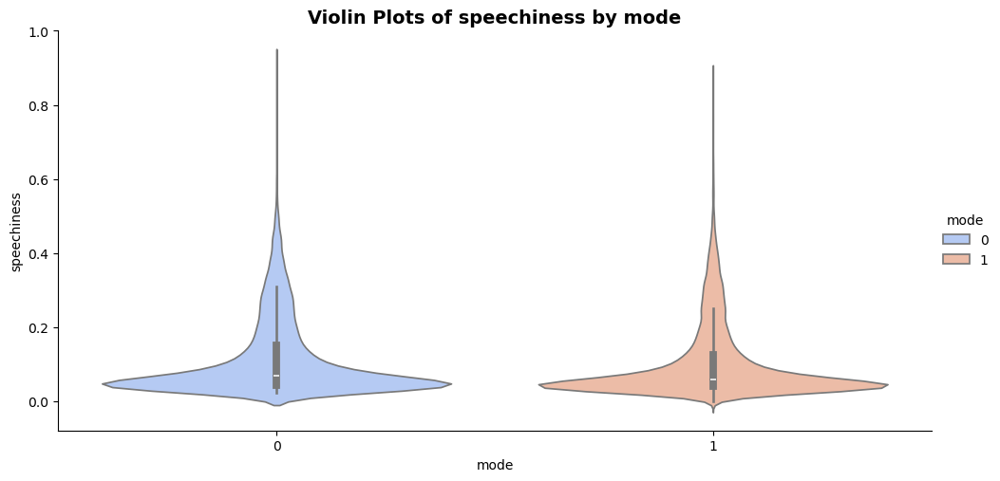

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


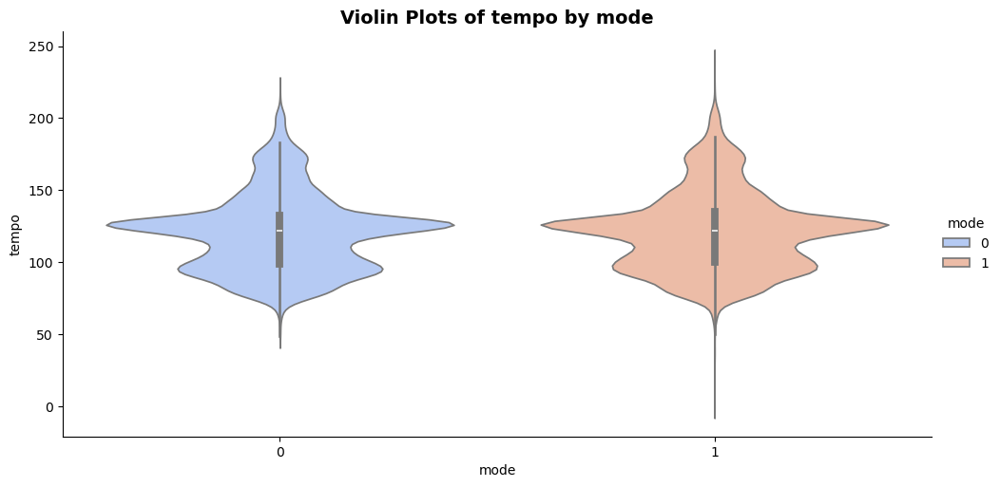

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


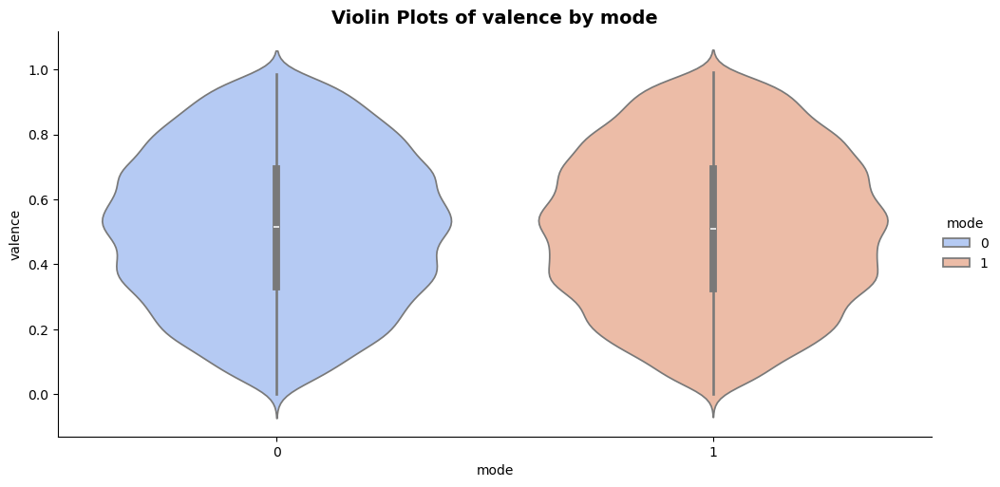

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


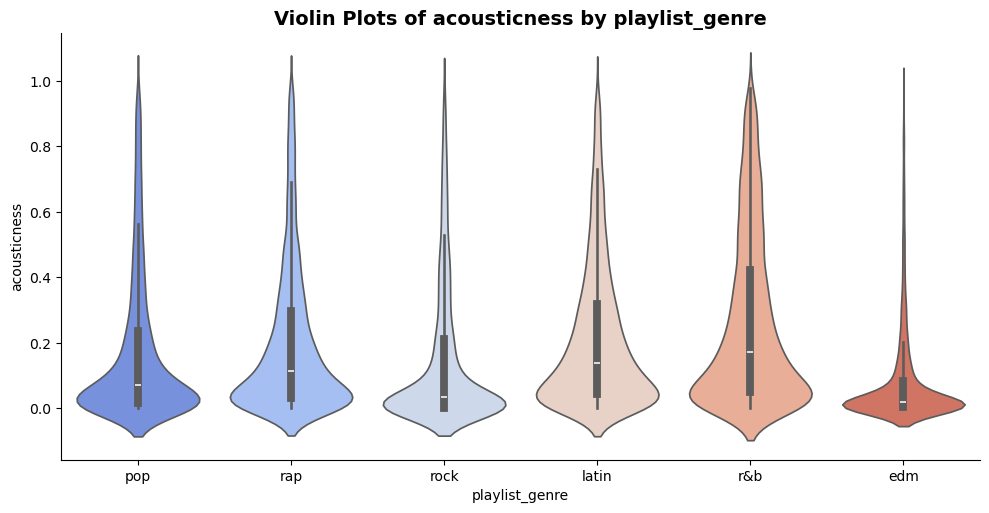

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


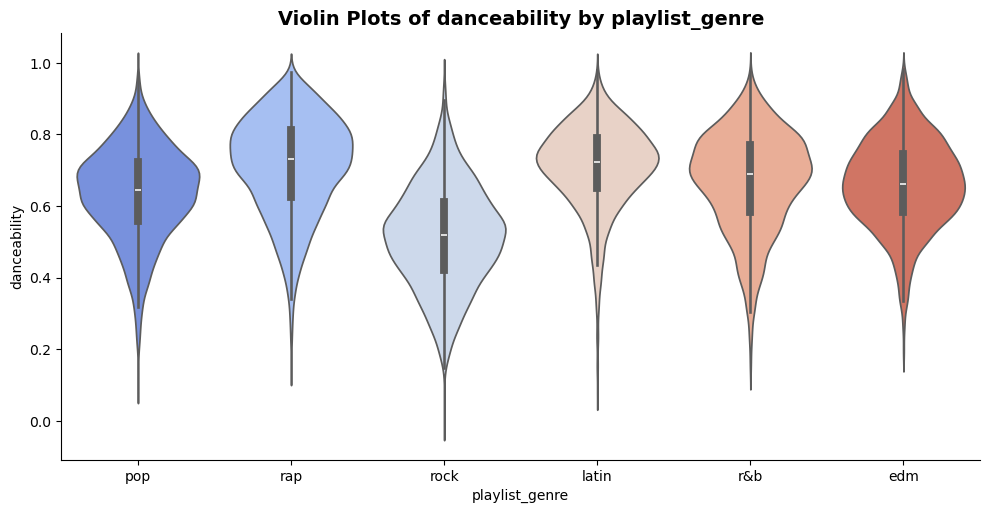

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


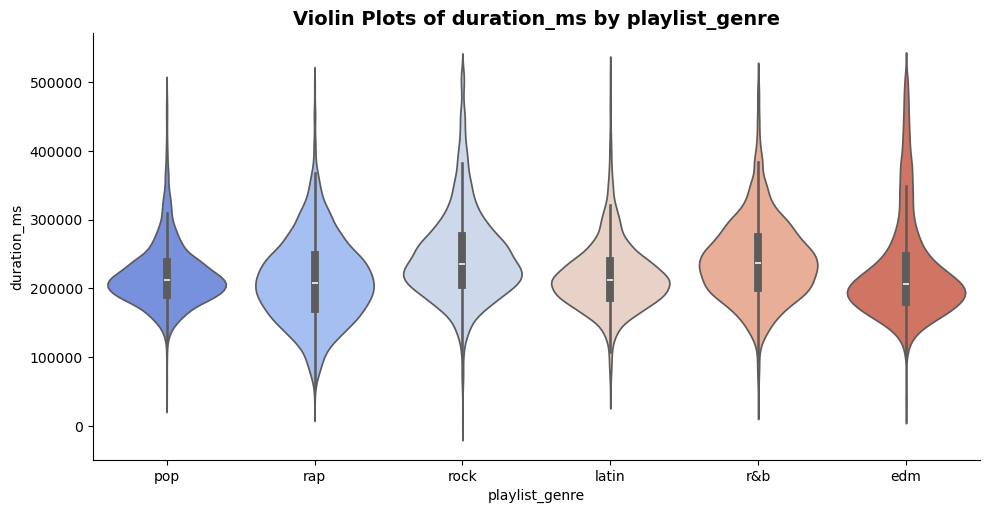

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


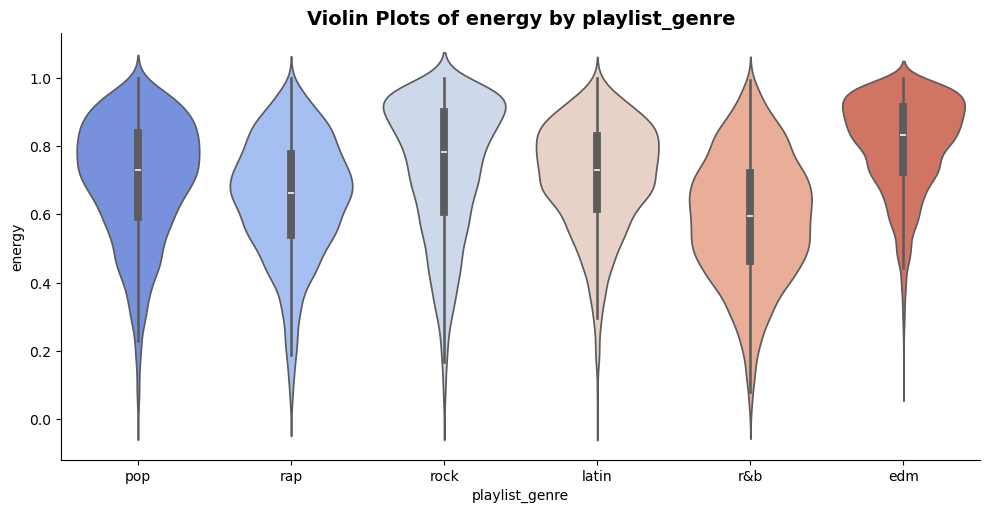

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


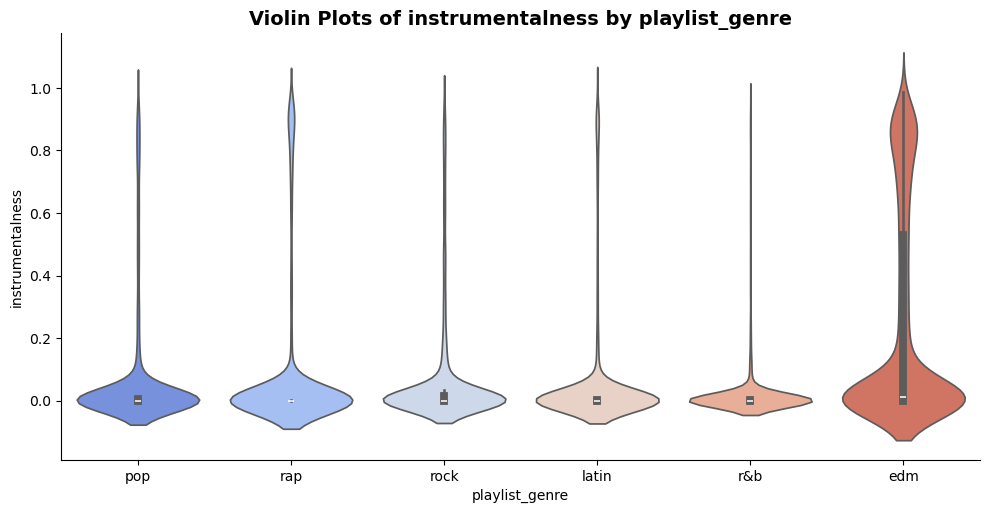

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


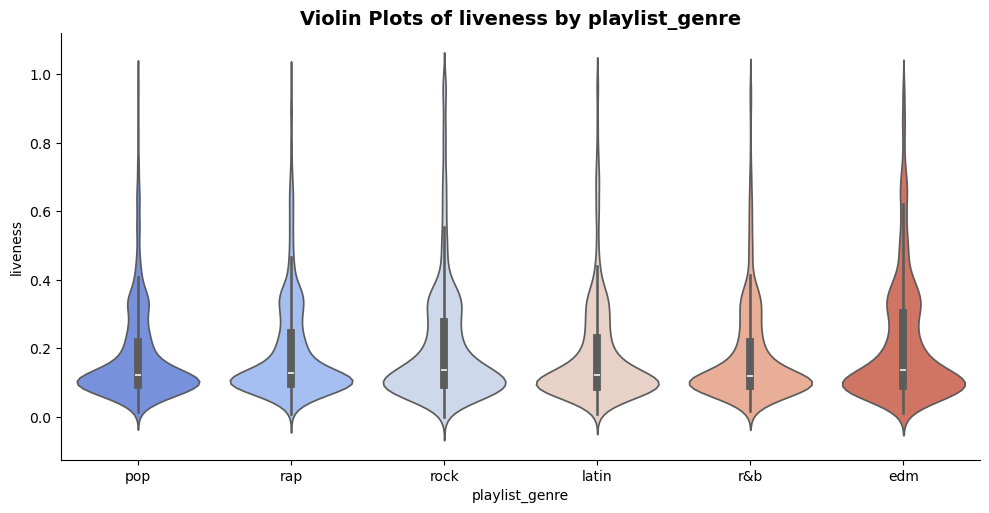

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


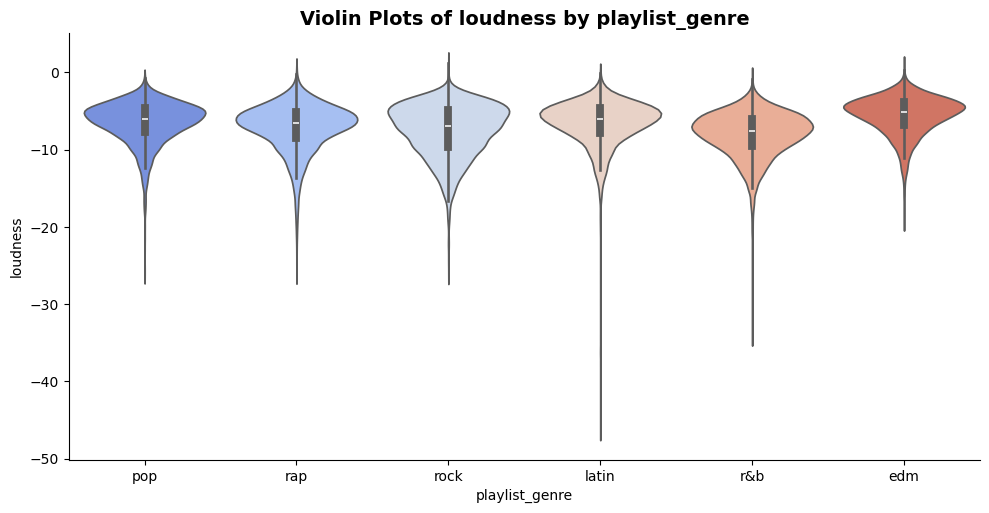

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


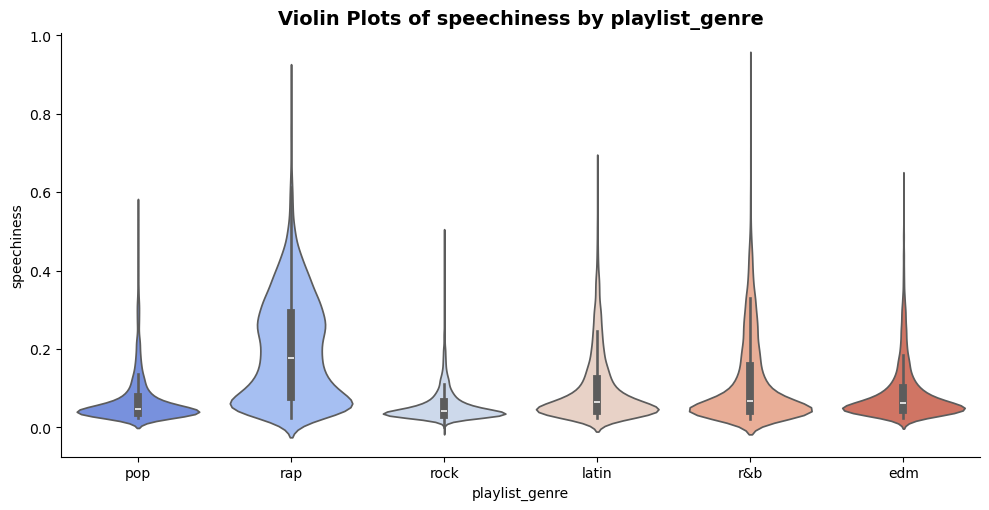

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


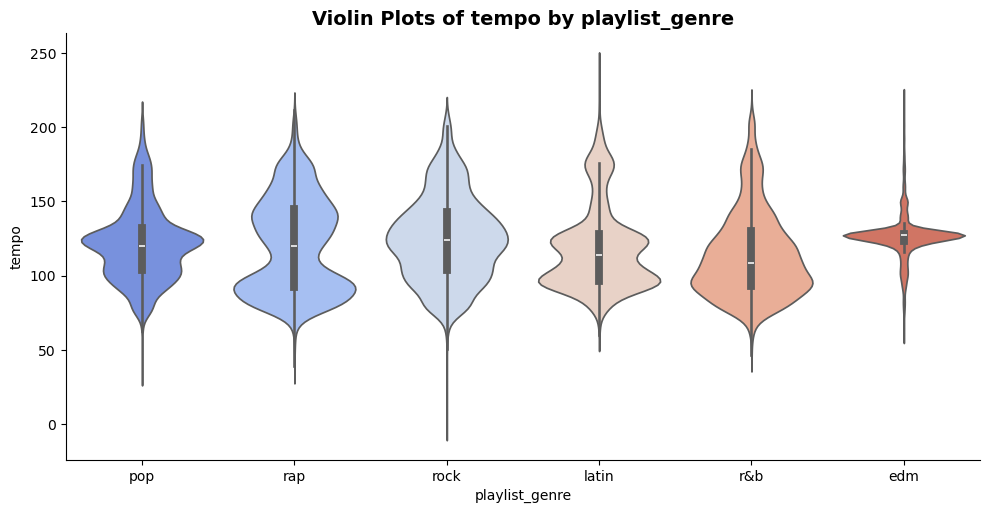

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


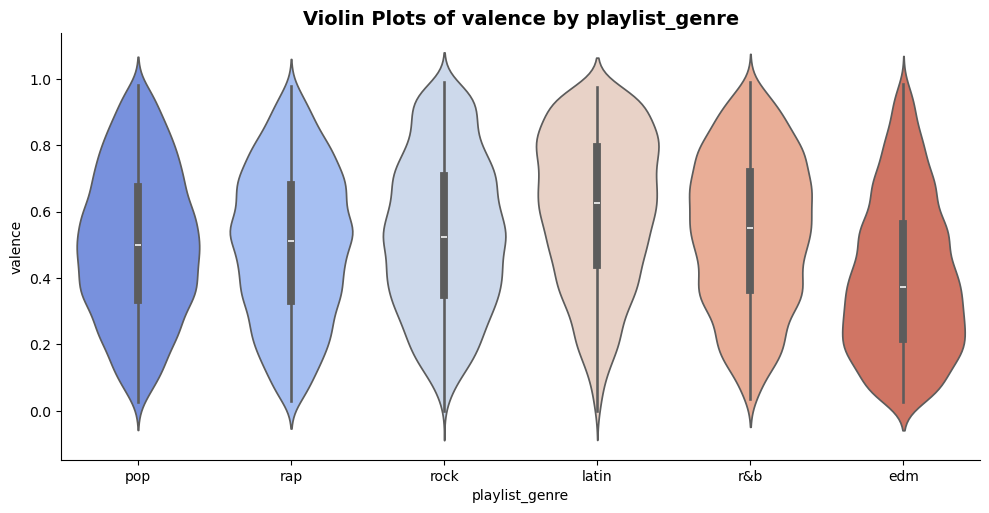

In [34]:
for var2 in x_cats:
    for var in x_nums:
        sns.catplot(data=spotify_new, x=var2, y=var, kind="violin", hue=var2, palette="coolwarm", aspect=2)
        if var2 == "mostcom_playlistsubgenre":
            # Set x-axis labels to be horizontal
            plt.xticks(rotation=45)
        plt.title("Violin Plots of %s by %s" % (var, var2), fontsize=14, fontweight="bold")
        plt.show()

**6 - Scatterplots looking at continuous outcome with continuous inputs.\
Summarize the response with boxplots for the unique values of the categorical inputs**

Trend Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


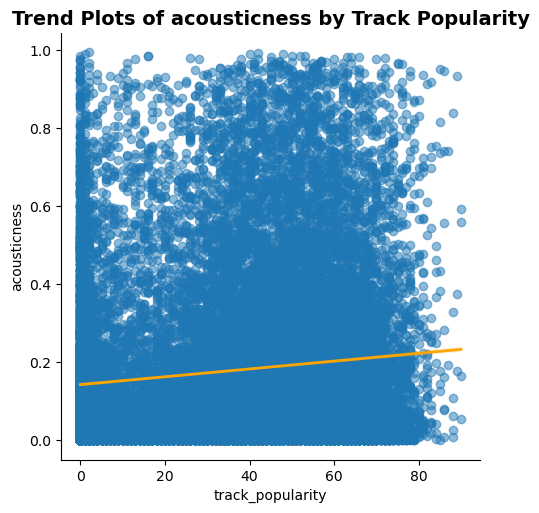

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


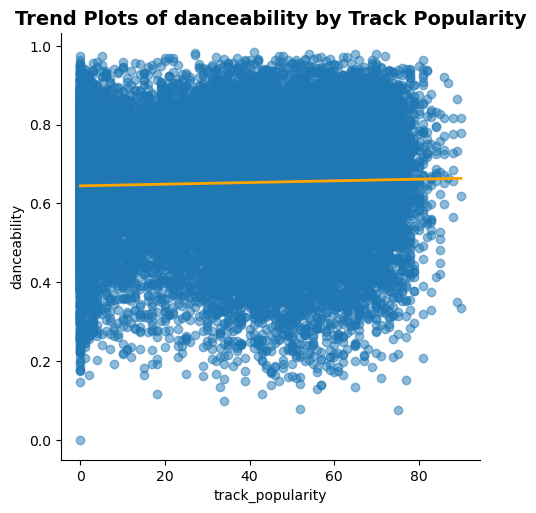

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


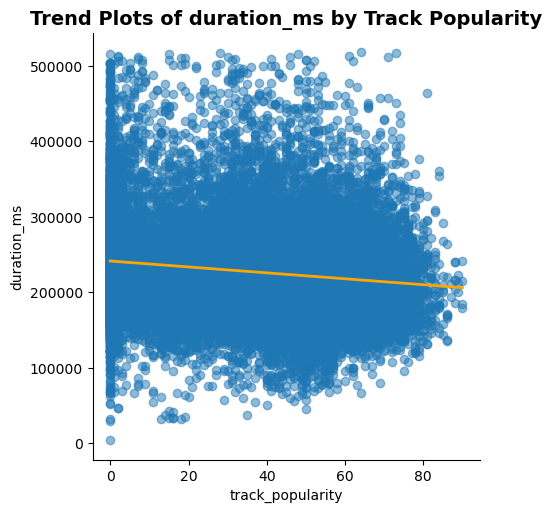

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


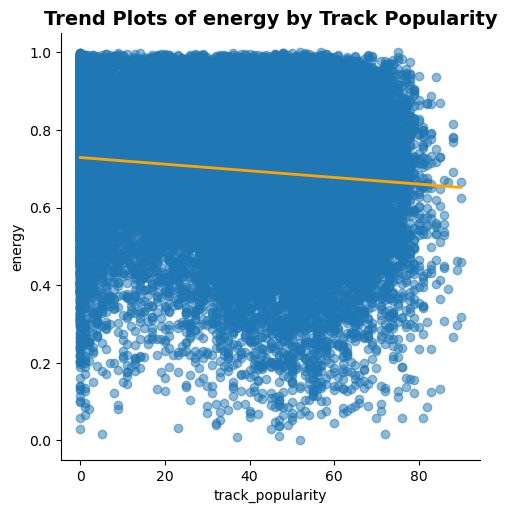

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


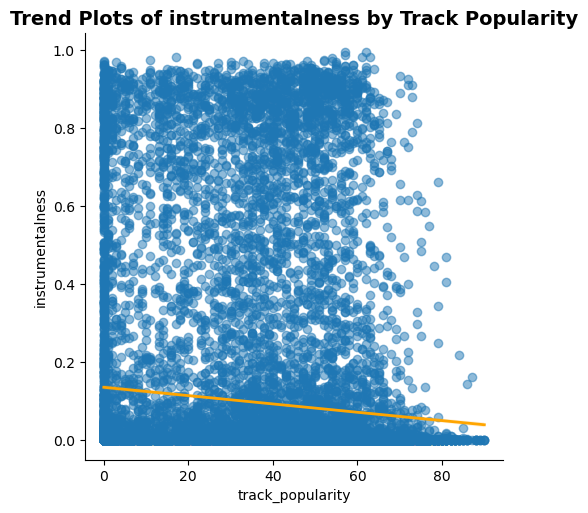

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


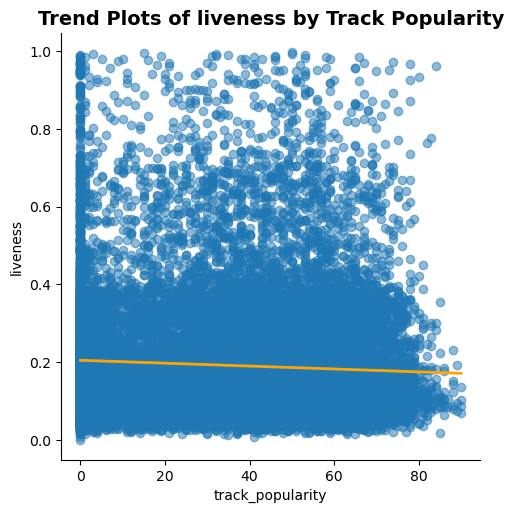

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


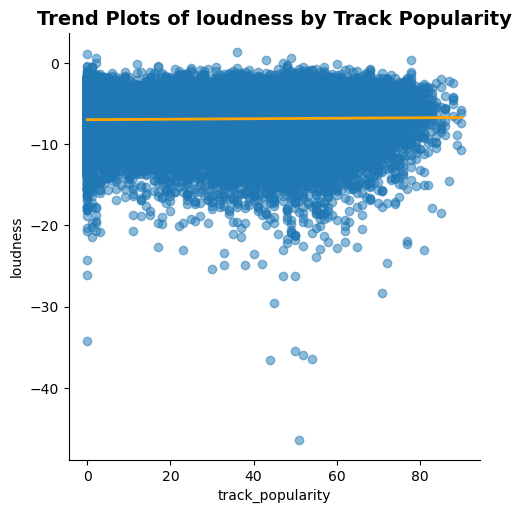

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


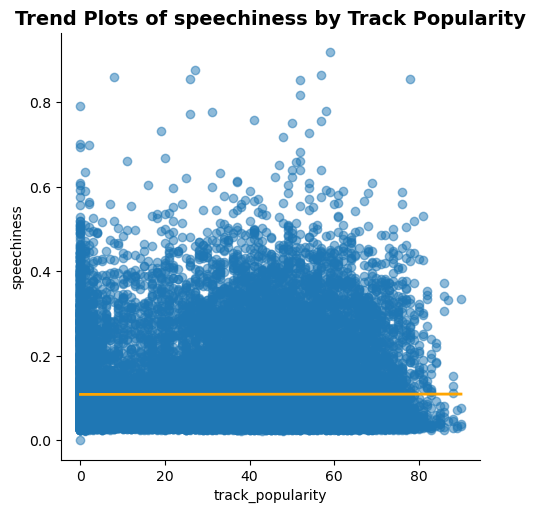

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


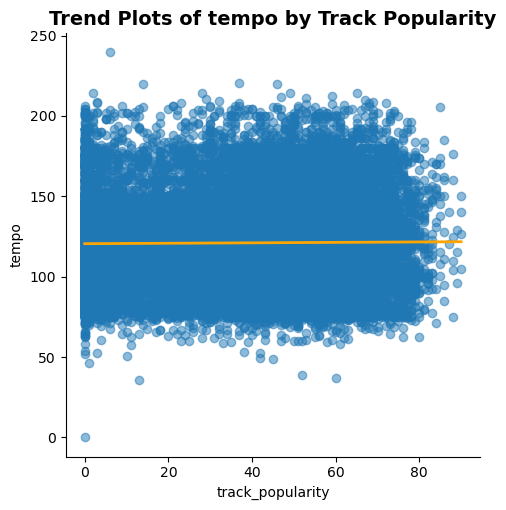

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


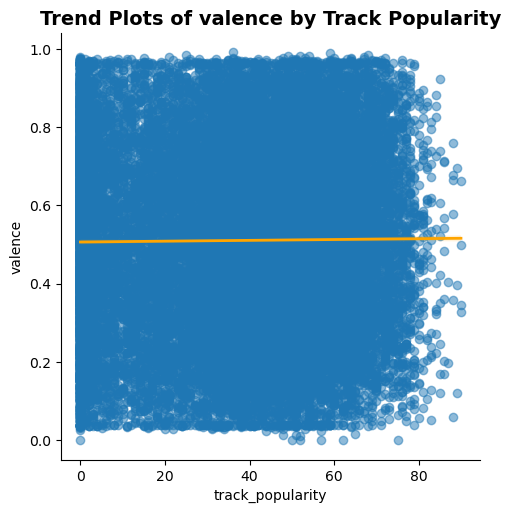

In [35]:
for var in x_nums:
    sns.lmplot(data=spotify_new, x="track_popularity", y=var, scatter_kws={'alpha': 0.5},
              line_kws={'color': 'orange', 'alpha': 1, 'linewidth': 2})
    plt.title("Trend Plots of %s by Track Popularity" % (var), fontsize=14, fontweight="bold")
    
    plt.show()

Boxplots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


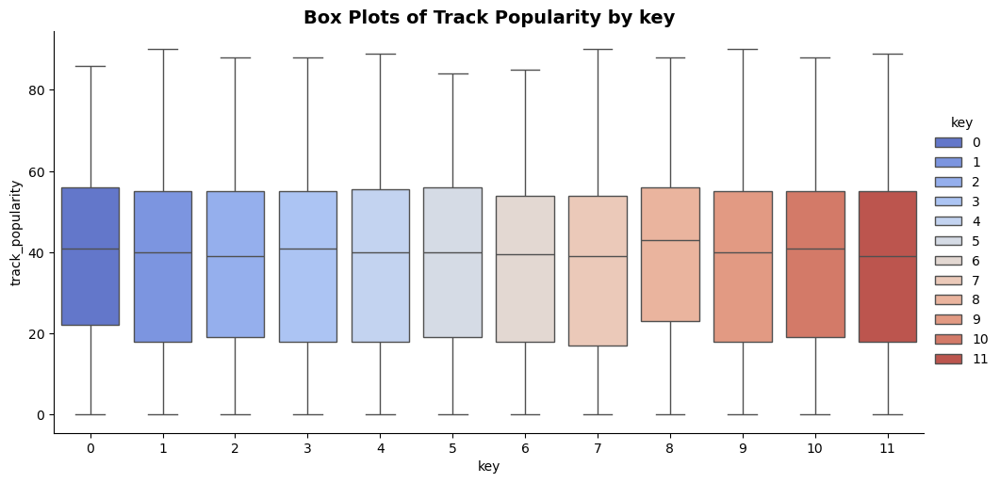

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


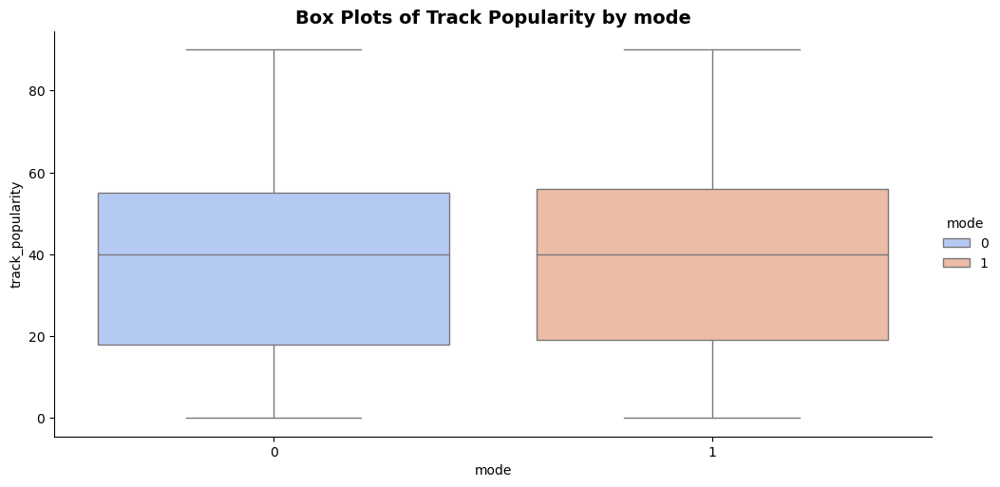

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


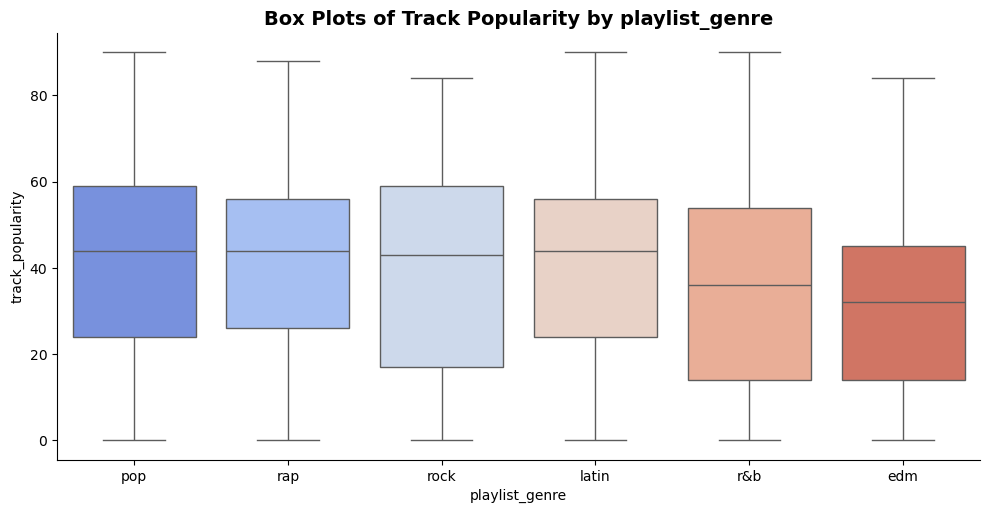

In [36]:
for var in x_cats:
    sns.catplot(data=spotify_new, y="track_popularity", x=var, hue=var, palette="coolwarm", kind="box", aspect=2)
    plt.title("Box Plots of Track Popularity by %s" % (var), fontsize=14, fontweight="bold")
    if var == "mostcom_playlistsubgenre":
        # Set x-axis labels to be horizontal
        plt.xticks(rotation=45)
    
    plt.show()

Point Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


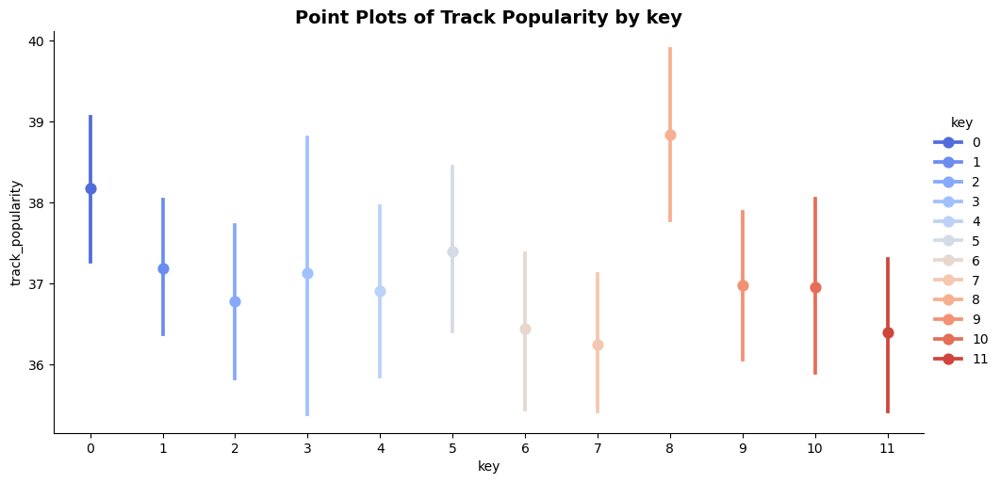

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


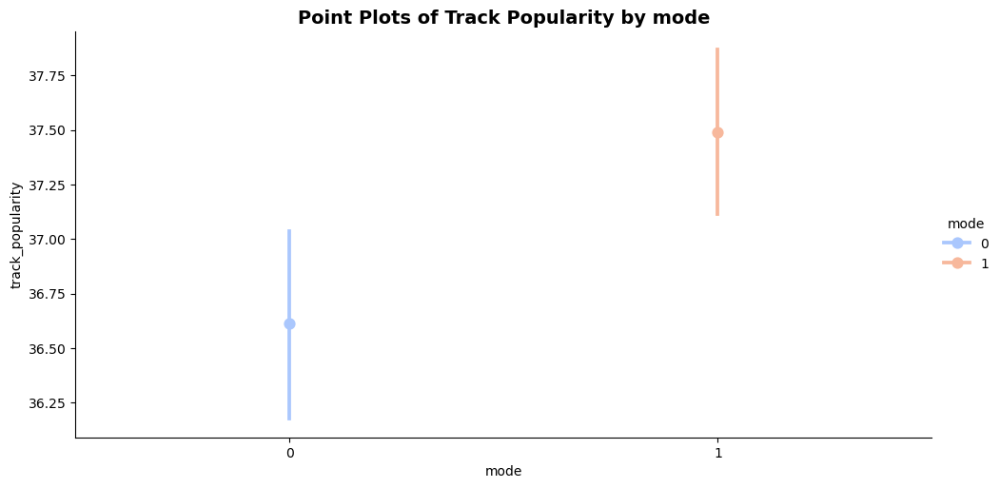

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


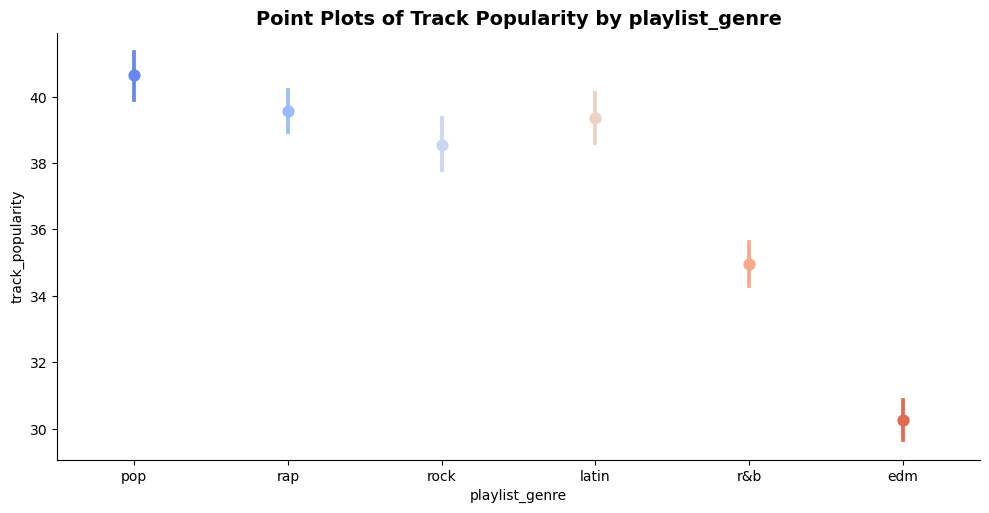

In [37]:
for var in x_cats:
    sns.catplot(data=spotify_new, y="track_popularity", x=var, kind="point", palette="coolwarm", hue=var, aspect=2)
    plt.title("Point Plots of Track Popularity by %s" % (var), fontsize=14, fontweight="bold")
    
    plt.show()

**7 - Visualize histograms and relationships between continuous inputs broken up by the outcome unique values.\
7 - Count the Number of Observations for Each Combination of Outcome and Categorical Variables**

KDE Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


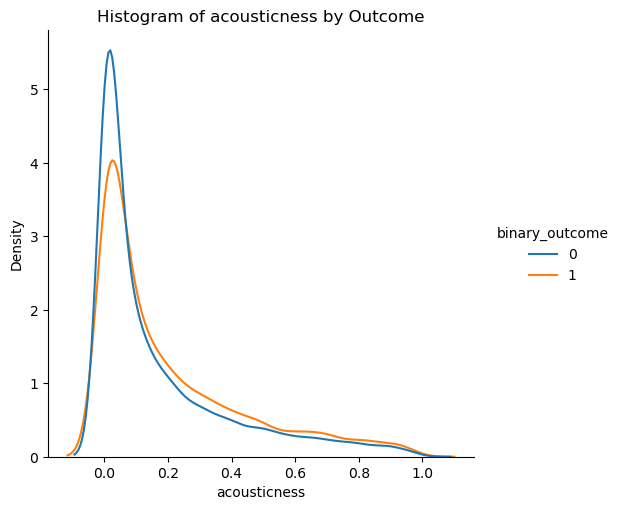

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


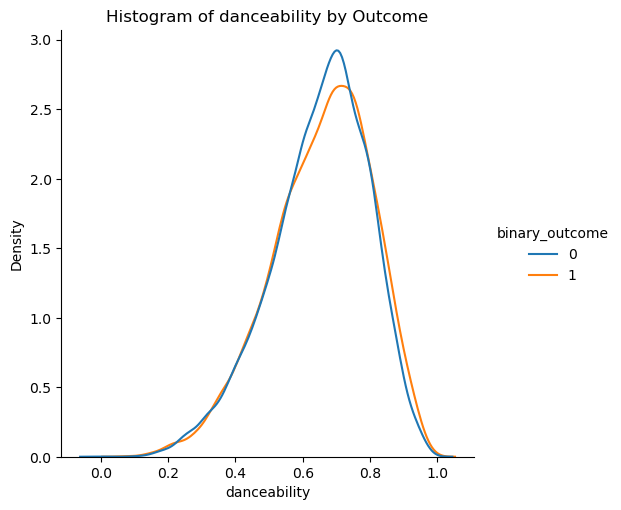

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


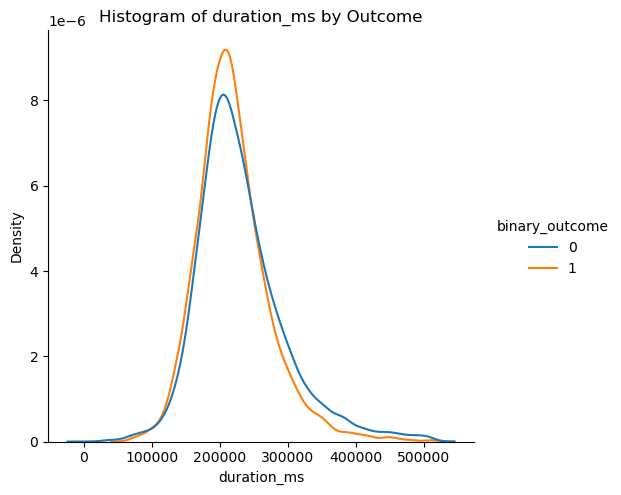

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


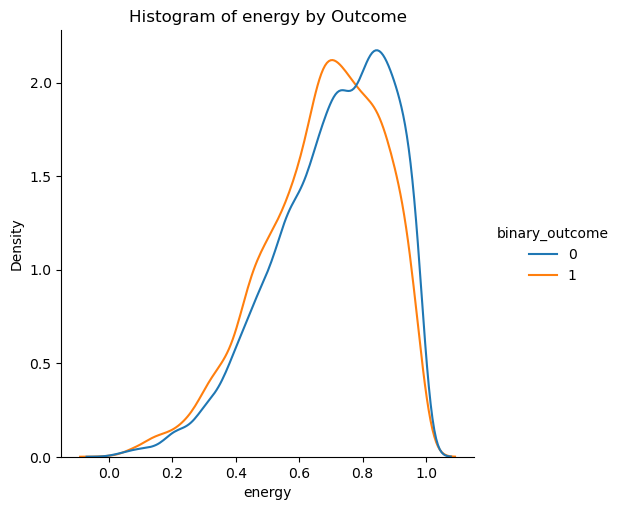

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


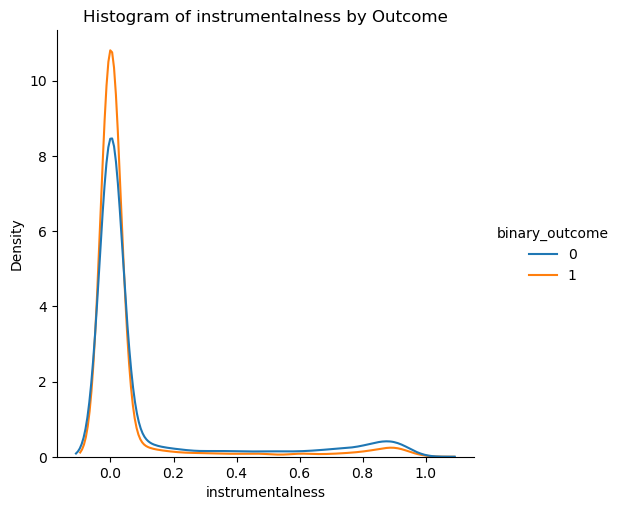

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


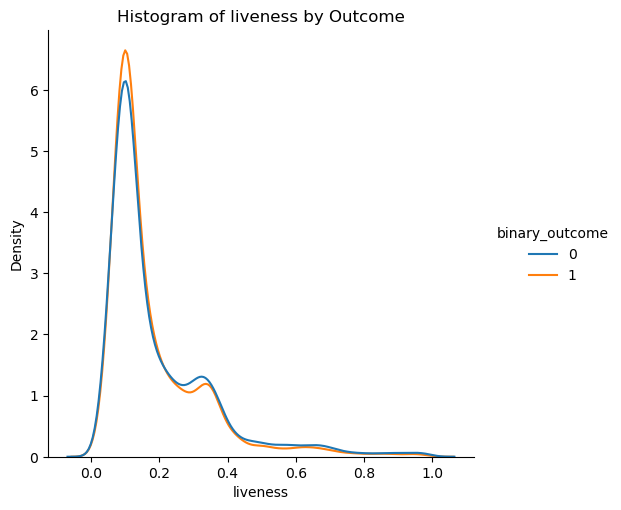

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


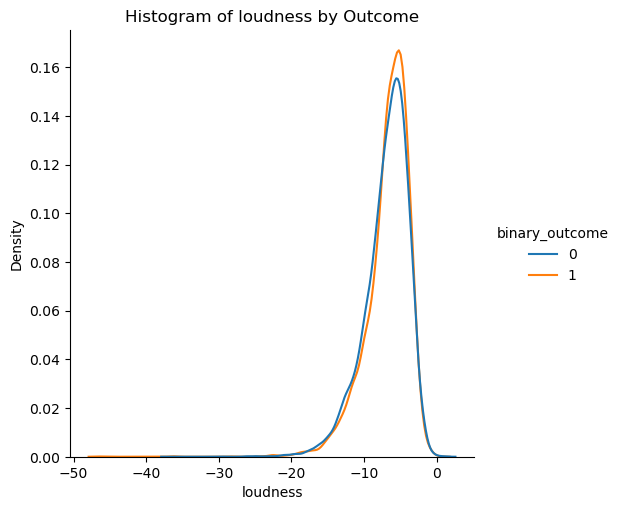

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


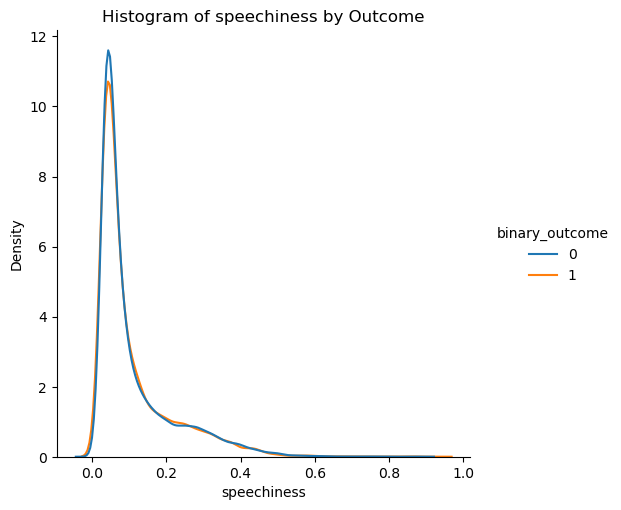

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


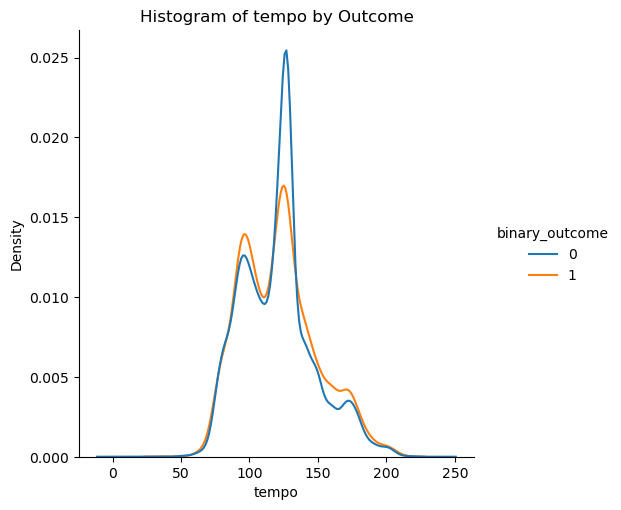

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


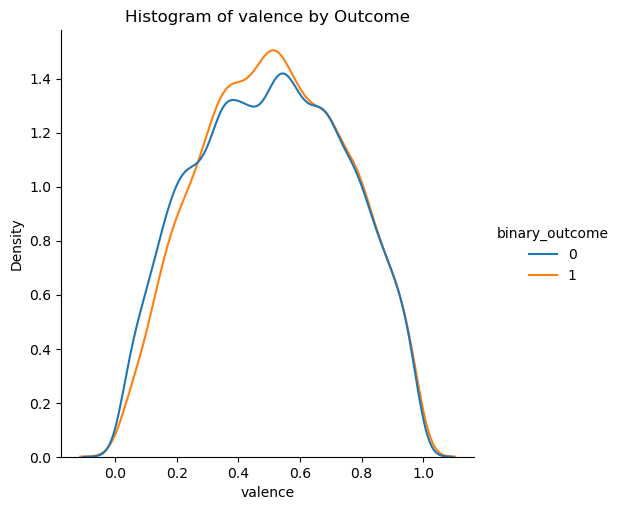

In [38]:
for var in x_nums:
    sns.displot(data=spotify_new, x=var, hue='binary_outcome', kind="kde", common_norm=False)
    plt.title("Histogram of "+ var + " by Outcome")
    plt.show()

Pairs Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


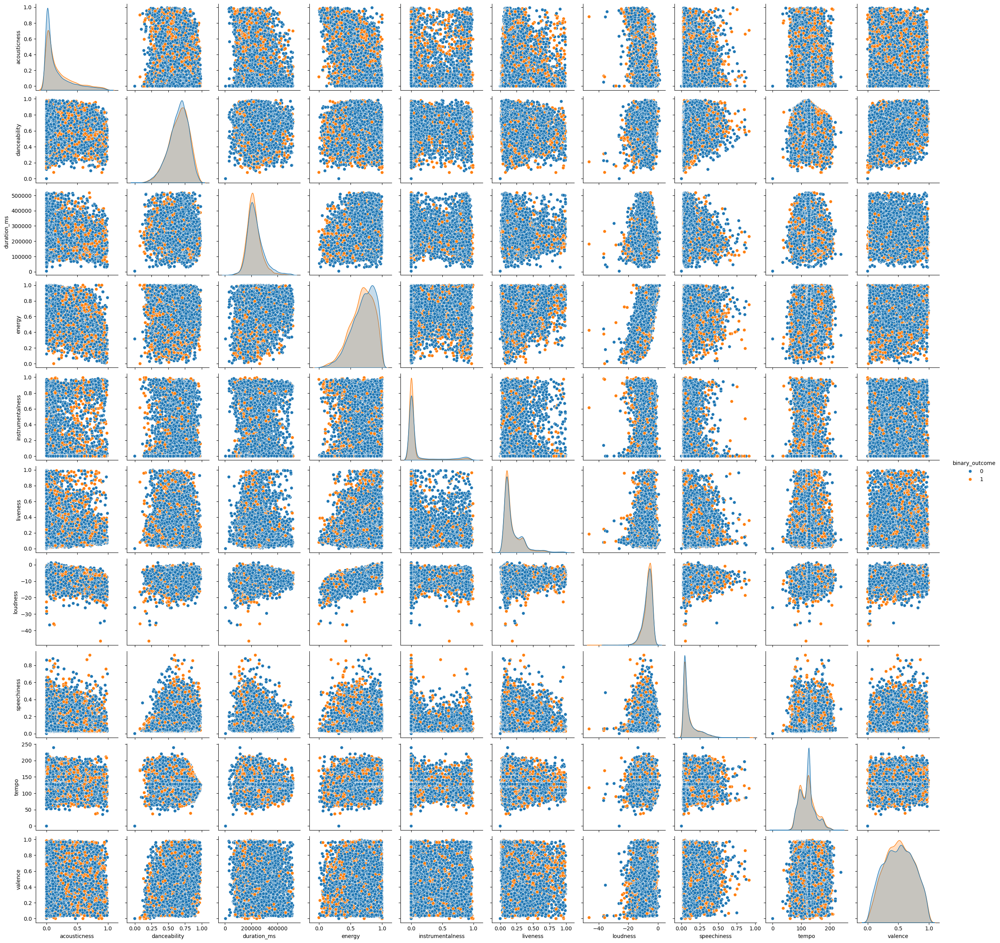

In [39]:
sns.pairplot(data=spotify_new.loc[:, ["binary_outcome"] + x_nums], 
             hue="binary_outcome", 
             diag_kind="kde", 
             diag_kws={"common_norm": False})

plt.show()

Boxplots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


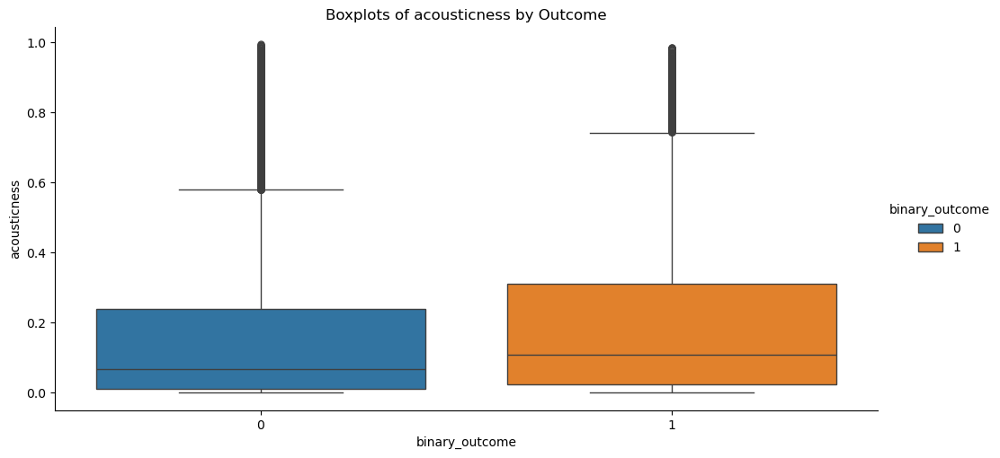

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


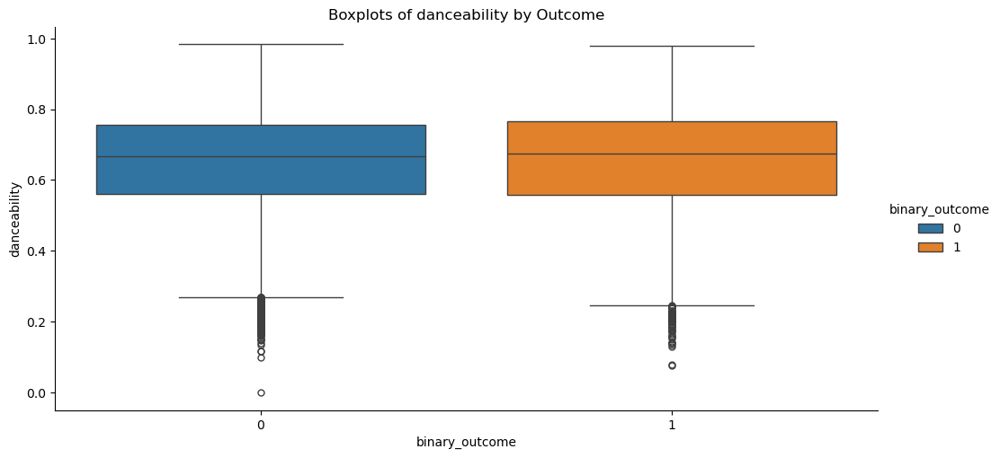

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


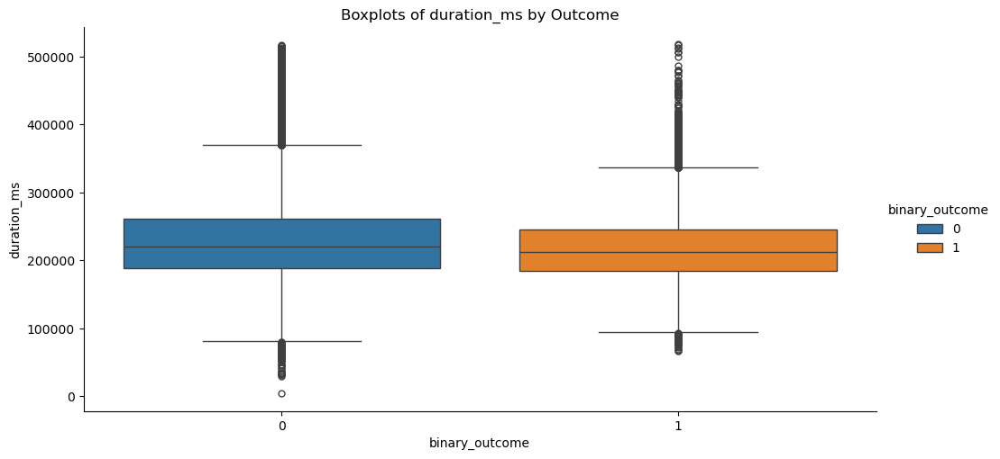

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


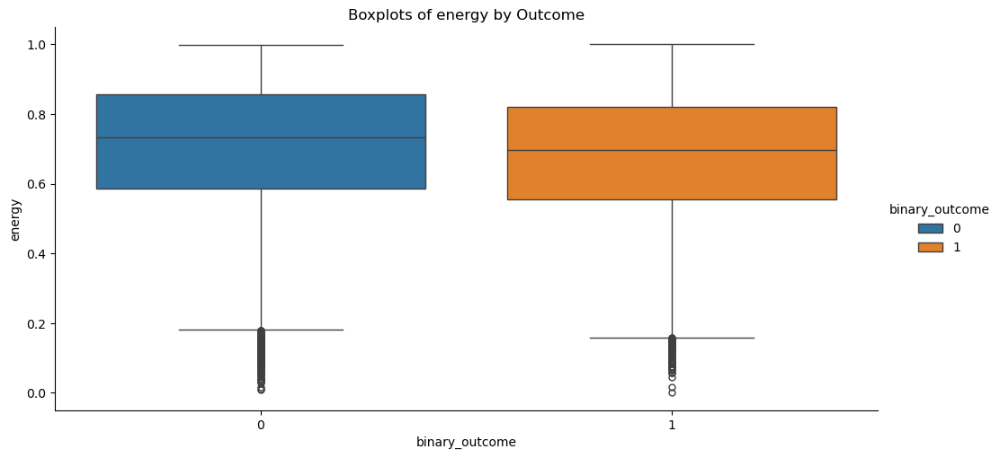

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


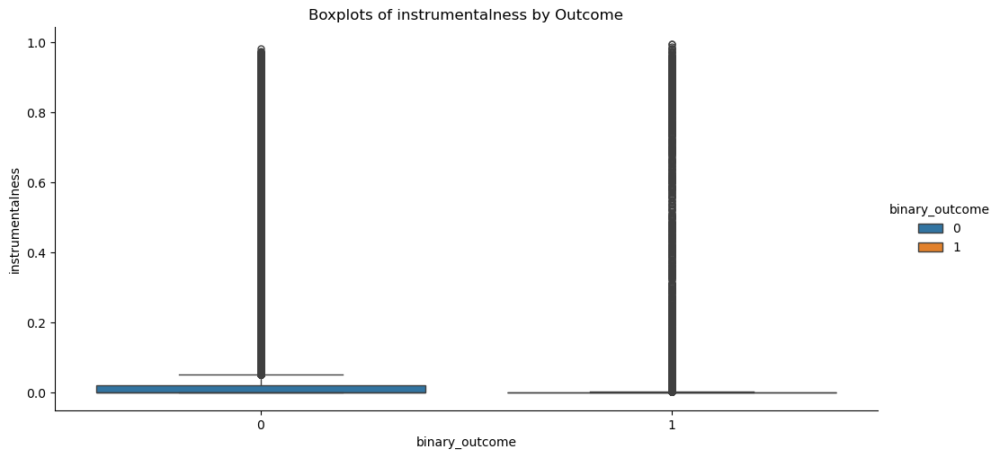

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


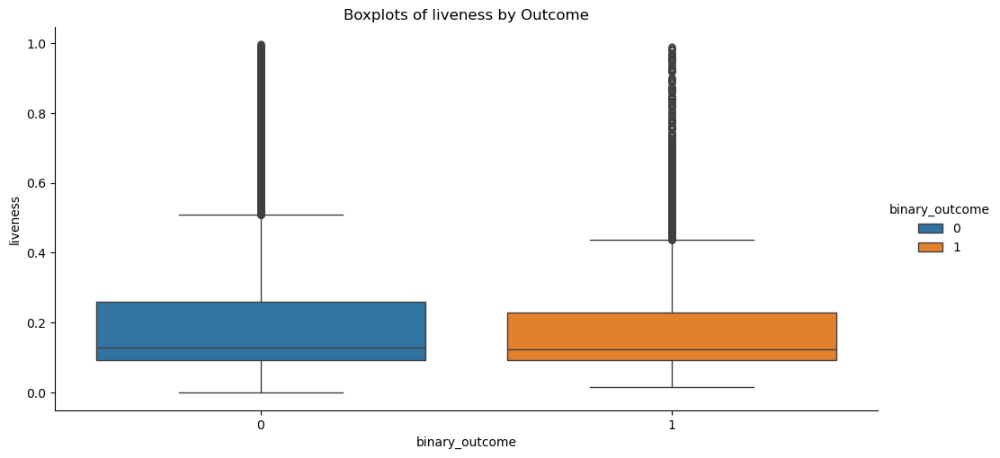

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


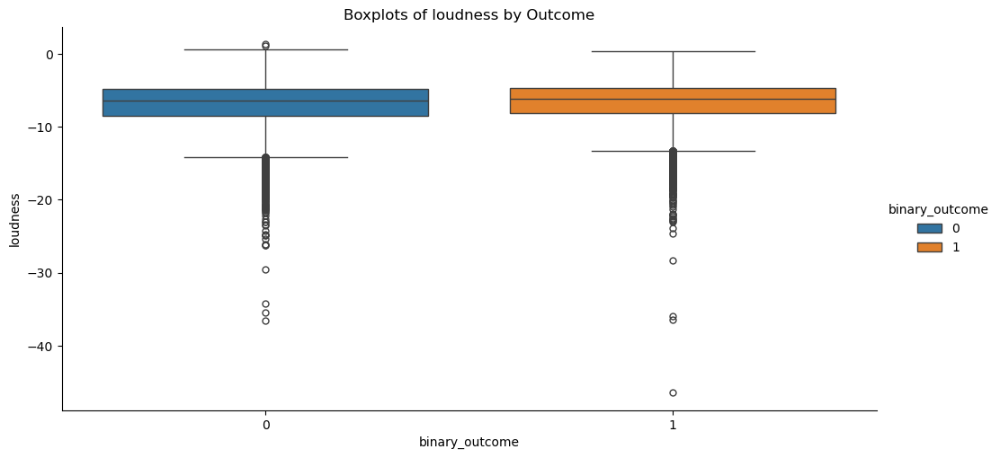

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


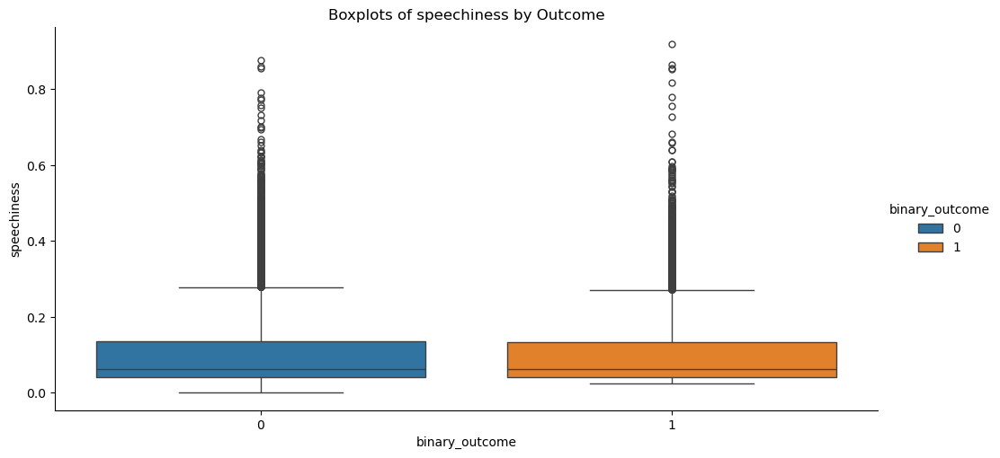

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


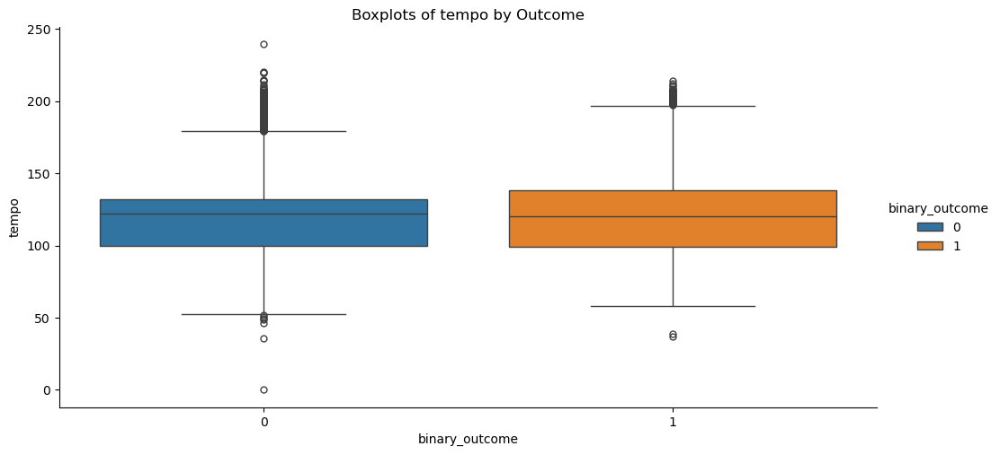

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


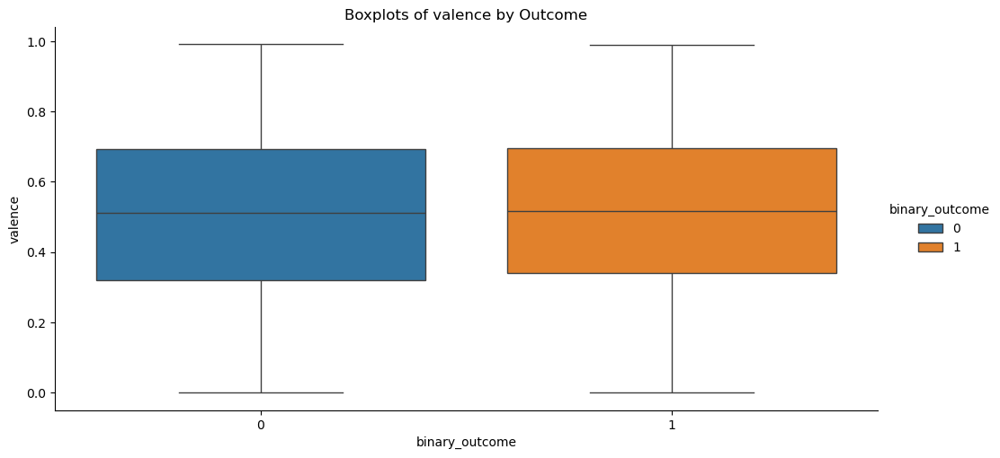

In [40]:
for var in x_nums:
    sns.catplot(data=spotify_new, y=var, x="binary_outcome", hue='binary_outcome', kind="box", aspect=2)
    plt.title("Boxplots of "+ var + " by Outcome")
    plt.show()

Point Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


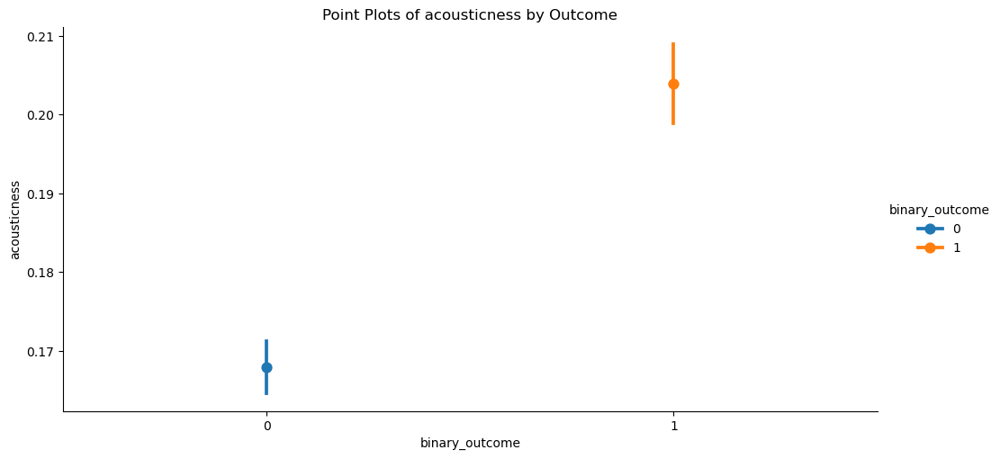

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


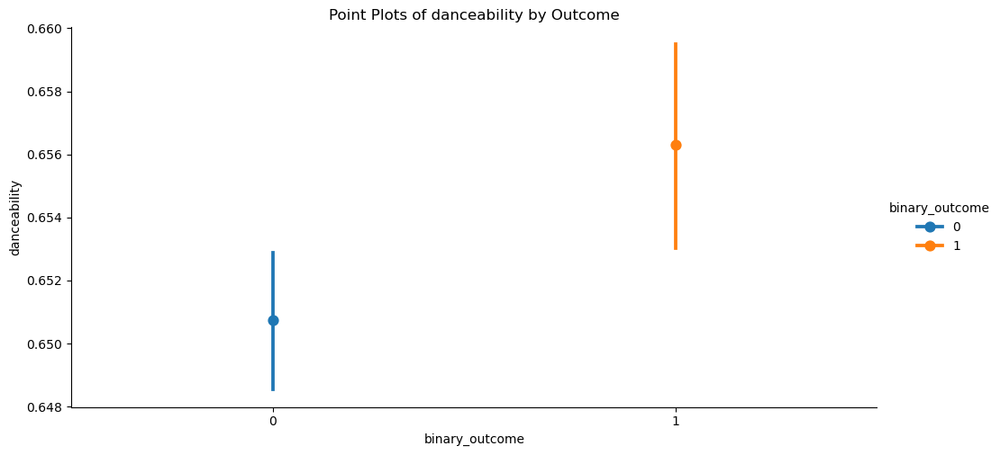

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


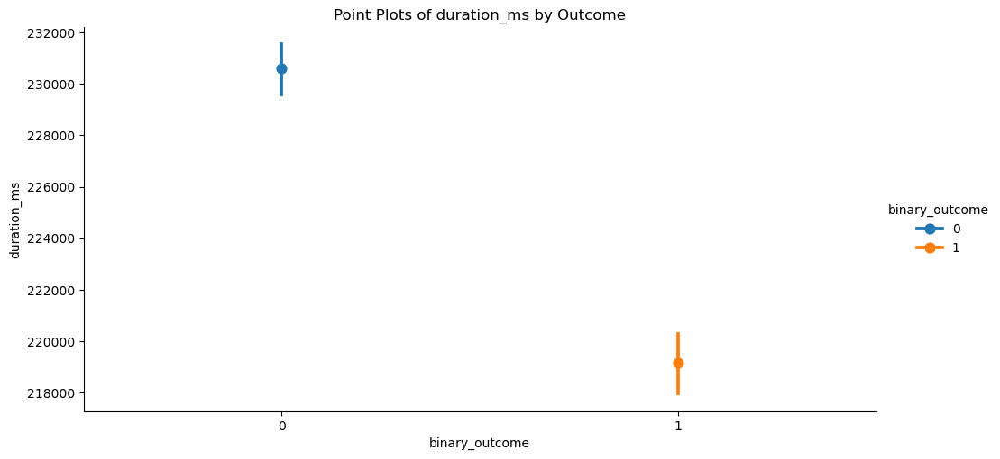

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


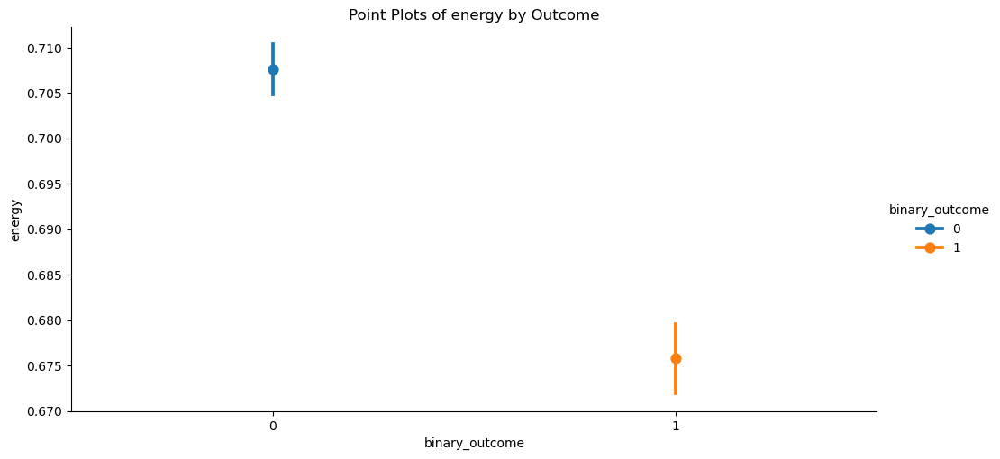

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


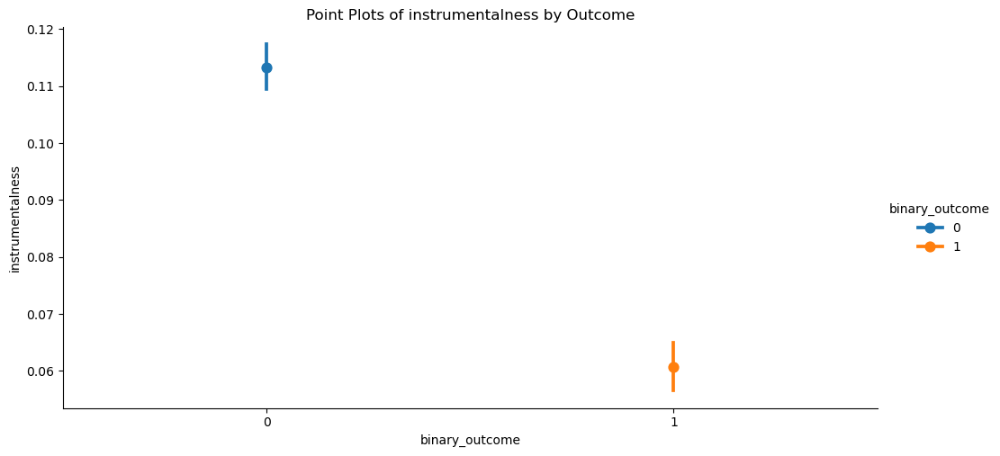

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


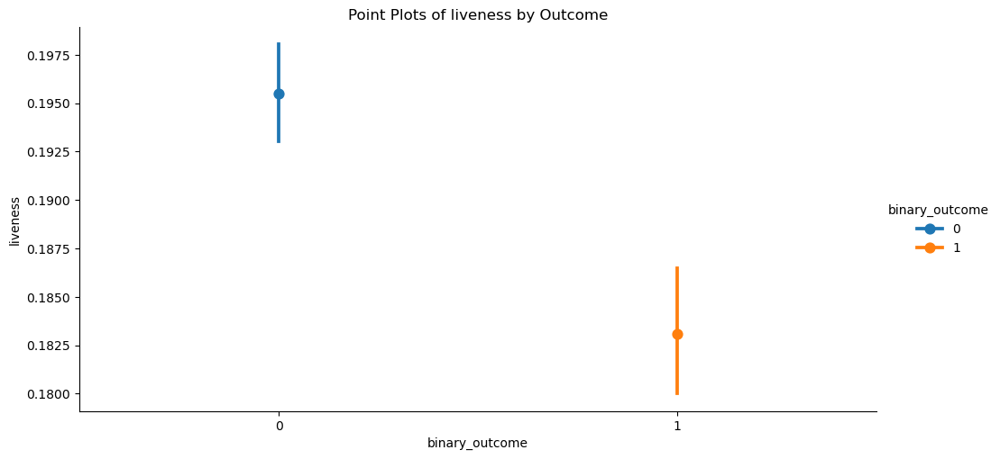

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


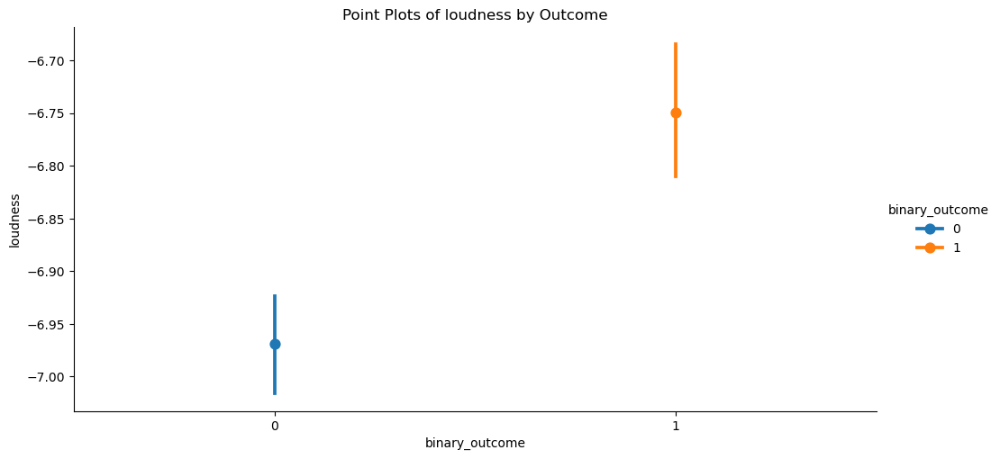

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


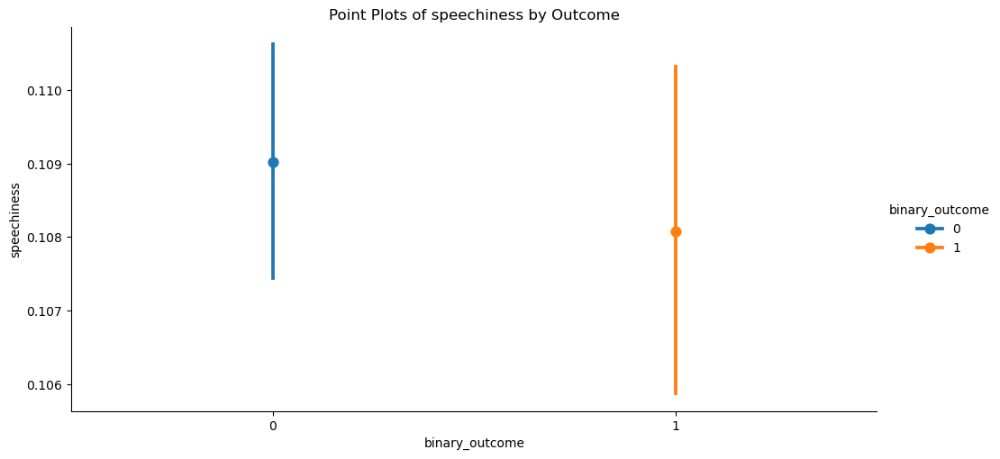

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


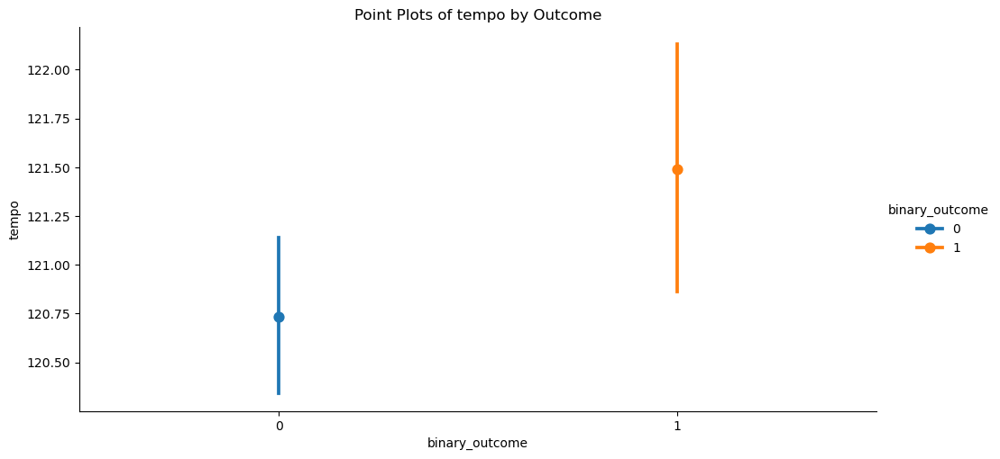

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


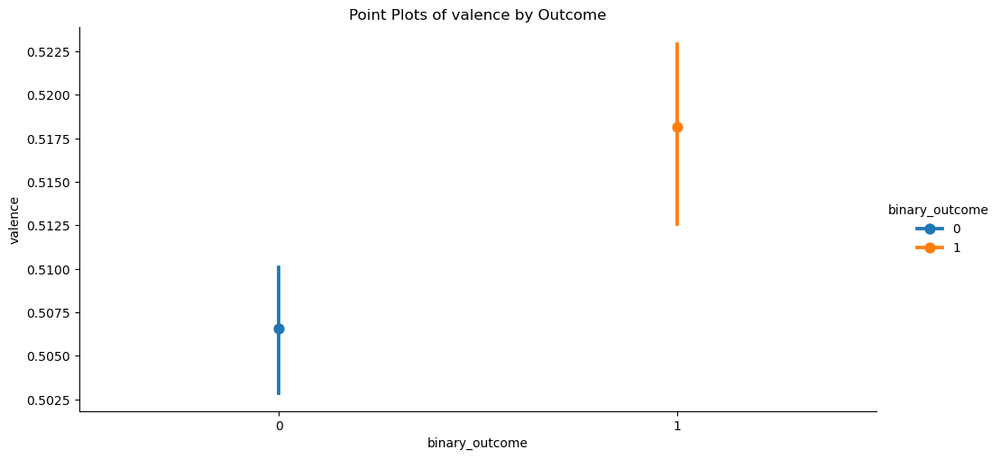

In [41]:
for var in x_nums:
    sns.catplot(data=spotify_new, y=var, x="binary_outcome", hue='binary_outcome', kind="point", aspect=2)
    plt.title("Point Plots of "+ var + " by Outcome")
    plt.show()

Trend Plots looking at Logistic Regressions

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


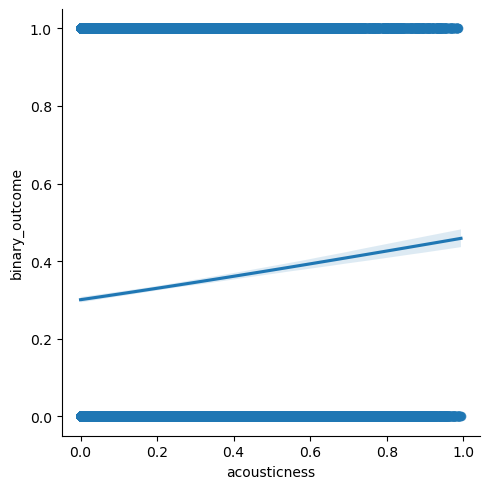

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


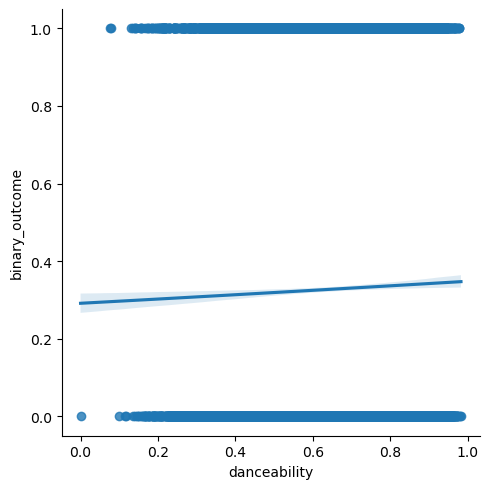

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


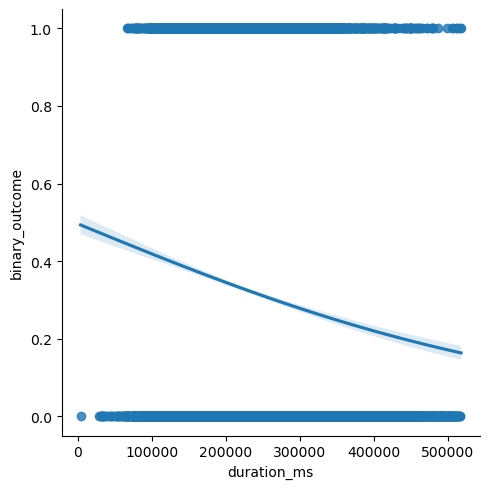

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


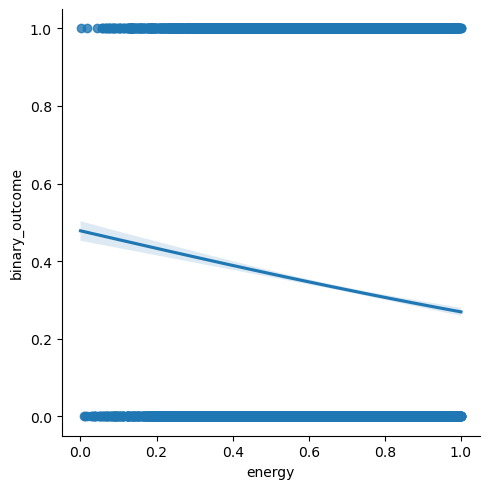

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


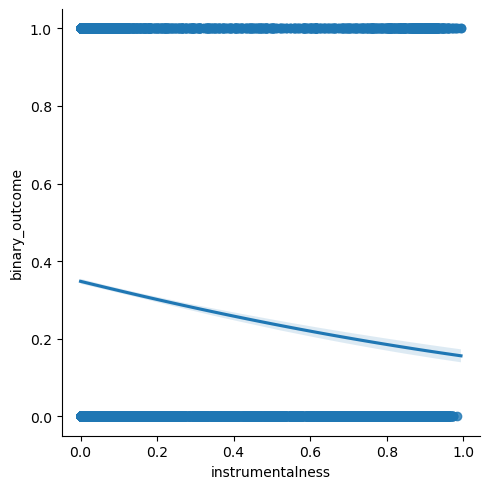

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


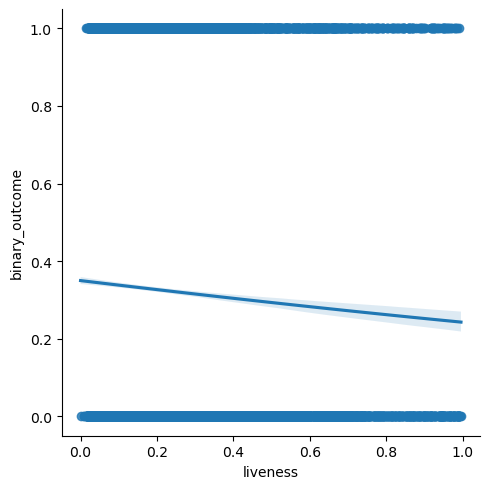

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


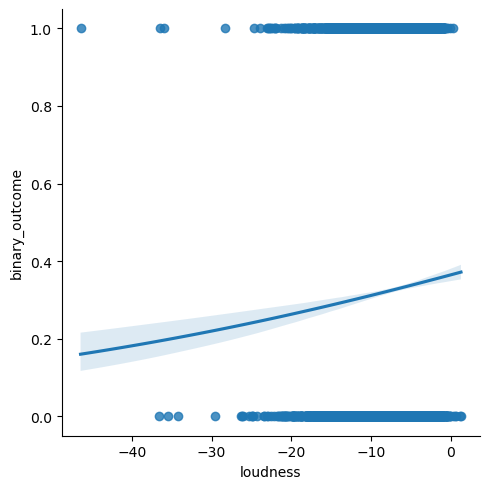

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


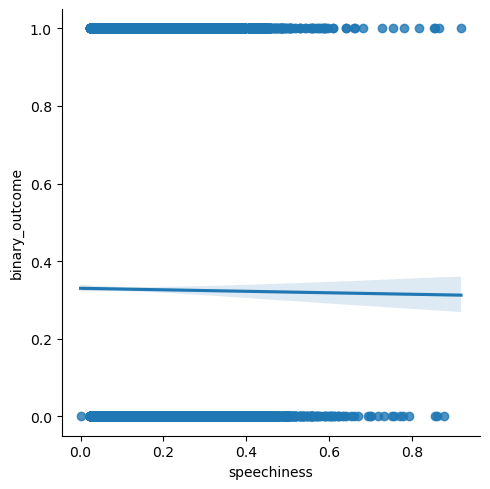

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


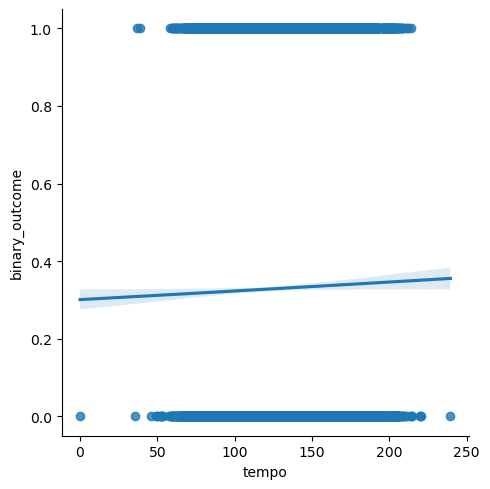

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


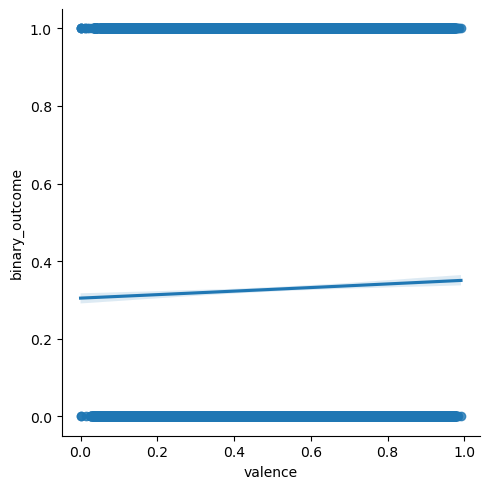

In [42]:
for var in x_nums:
    sns.lmplot(data=spotify_new, x=var, y="binary_outcome", logistic=True)
    plt.show()

### **TRANSFORMATION:** I want to transform these variables and replot the histograms!

The following are showing skewness:
* Left:
    * Danceability
    * Energy
    * Loudness
* Right:
    *  Speechiness
    *  Acousticness
    *  Instrumentalness
    *  Liveness

In [47]:
from scipy.stats import boxcox

In [43]:
spotify_transf = spotify_new.copy()

In [45]:
spotify_transf.loc[:, x_nums].describe()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000,25190.000000
mean,0.179709,0.652559,226843.724732,0.697178,0.095998,0.191432,-6.896591,0.108713,120.981311,0.510365
std,0.225940,0.146274,61983.810649,0.185624,0.238703,0.157258,3.068494,0.103691,26.994157,0.235183
min,0.000000,0.000000,4000.000000,0.000175,0.000000,0.000000,-46.448000,0.000000,0.000000,0.000000
25%,0.014100,0.560000,187539.500000,0.577000,0.000000,0.092500,-8.412000,0.041000,99.976000,0.328000
50%,0.080200,0.669000,217200.000000,0.721000,0.000025,0.127000,-6.345500,0.062700,121.994000,0.512000
75%,0.265000,0.760000,255413.000000,0.844000,0.008108,0.249000,-4.764000,0.135000,134.057000,0.695000
max,0.994000,0.983000,517810.000000,1.000000,0.994000,0.996000,1.275000,0.918000,239.440000,0.991000


For variables that are bounded between 0 and 1.

In [48]:
logtf_list = ["acousticness", "danceability", "energy", "speechiness", "instrumentalness", "liveness"]

for var in logtf_list:
    spotify_transf[var+"_shift"] = np.where(spotify_transf[var] == 1.0, spotify_transf[var] - 0.01, spotify_transf[var])
    spotify_transf[var+"_shift"] = np.where(spotify_transf[var] == 0.0, spotify_transf[var] + 0.01, spotify_transf[var+"_shift"])
    spotify_transf[var+'_logit'] = np.log( spotify_transf[var+"_shift"] / (1 - spotify_transf[var+"_shift"]) )
    spotify_transf[var+'_log'] = np.log( spotify_transf[var+"_shift"] )
    transformed_data, lambda_value = boxcox(spotify_transf[var+"_shift"])
    spotify_transf[var+'_boxcox'] = transformed_data 

In [50]:
extra_list = ["loudness"]

for var in extra_list:
    spotify_transf[var+'_sqrd'] = ( spotify_transf[var] )**2
    spotify_transf[var+'_cubed'] = ( spotify_transf[var] )**3
    
    lower_threshold = np.percentile(spotify_transf[var], 5)
    upper_threshold = np.percentile(spotify_transf[var], 95)

    # Winsorize the data
    spotify_transf[var+'_wins'] = np.clip(spotify_transf[var], lower_threshold, upper_threshold)

In [51]:
x_nums_std = [var  + "_logit" for var in logtf_list ] + [var  + "_log" for var in logtf_list] + [var  + "_boxcox" for var in logtf_list] + ["loudness_sqrd", "loudness_cubed", "loudness_wins"]

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


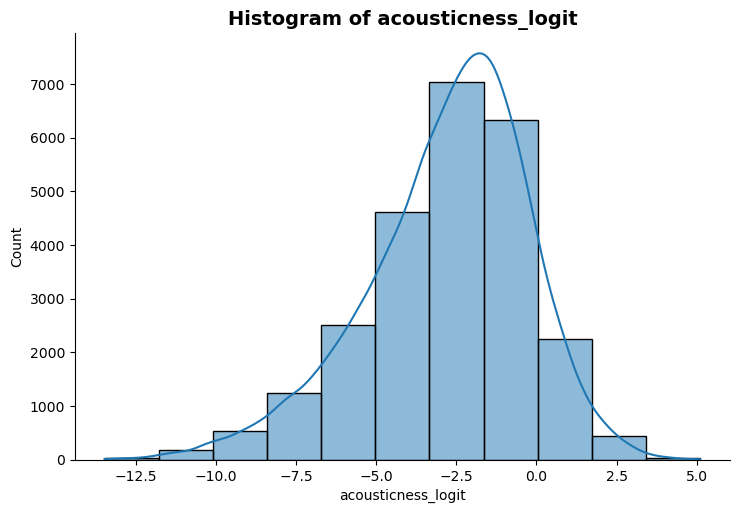

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


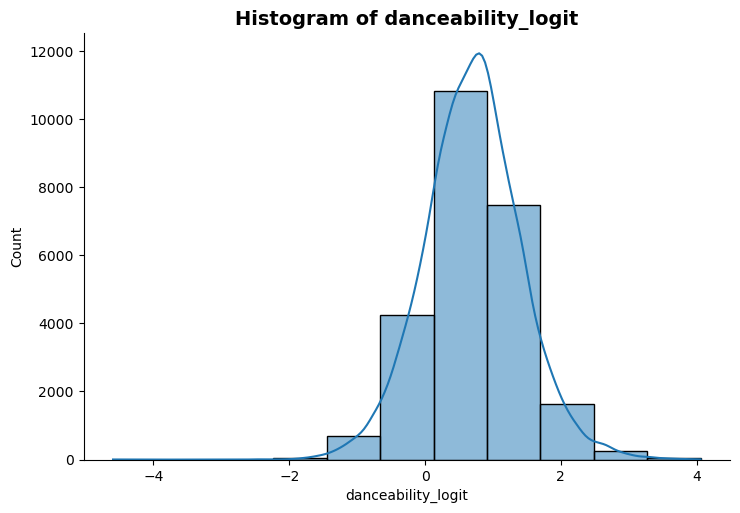

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


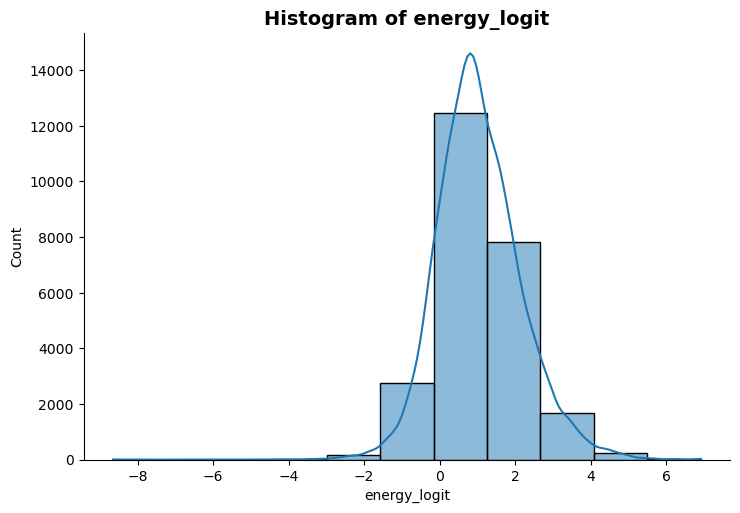

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


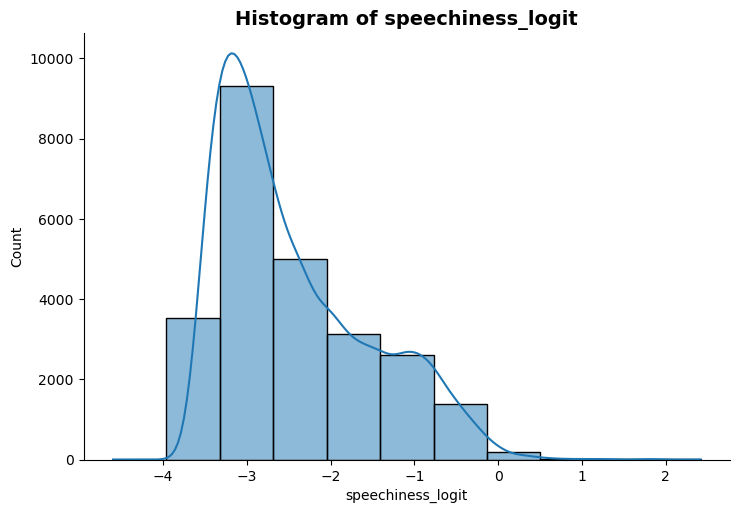

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


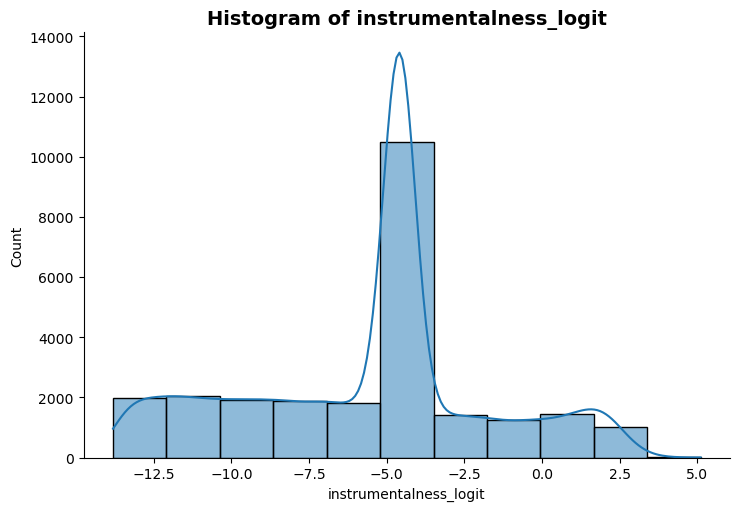

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


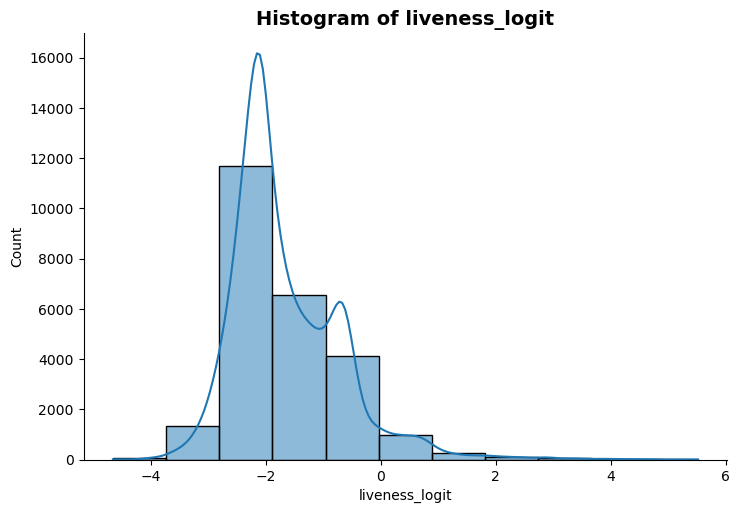

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


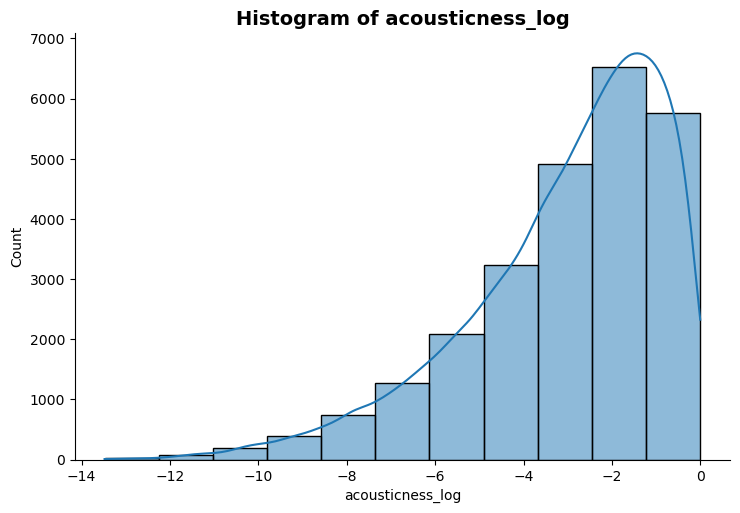

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


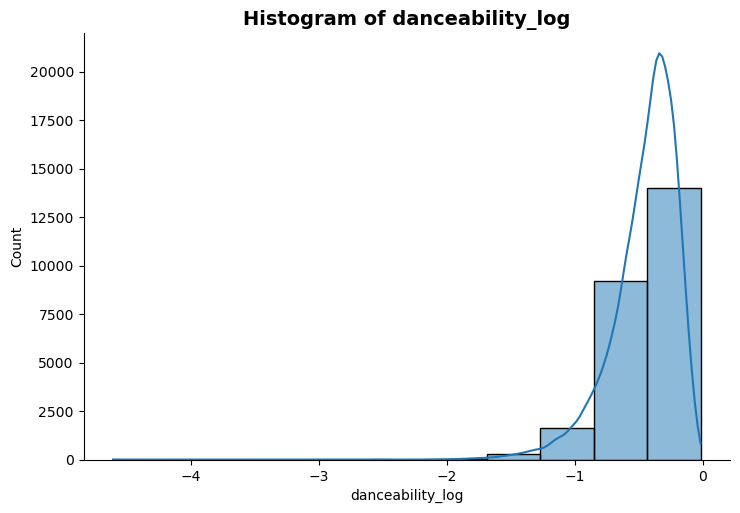

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


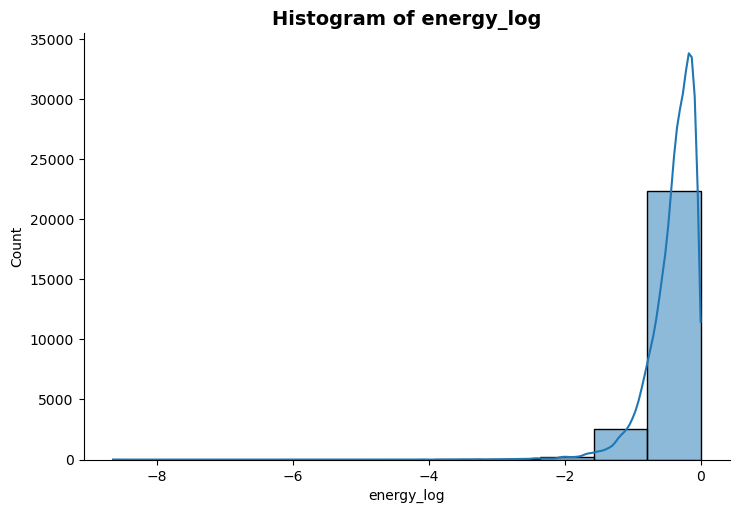

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


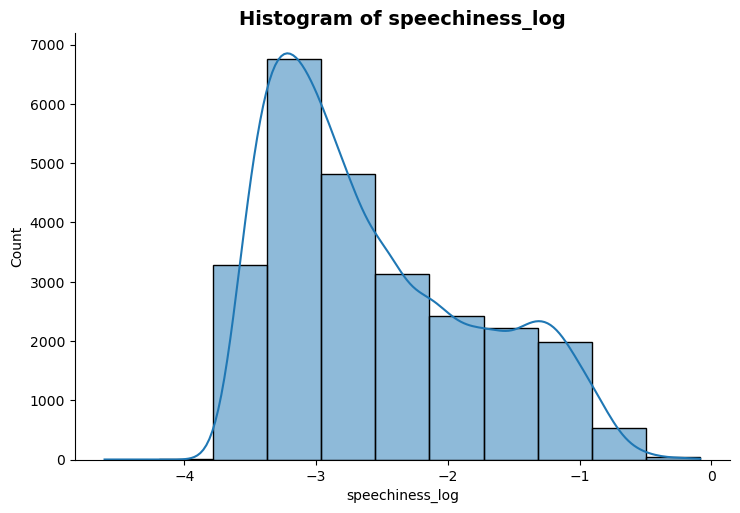

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


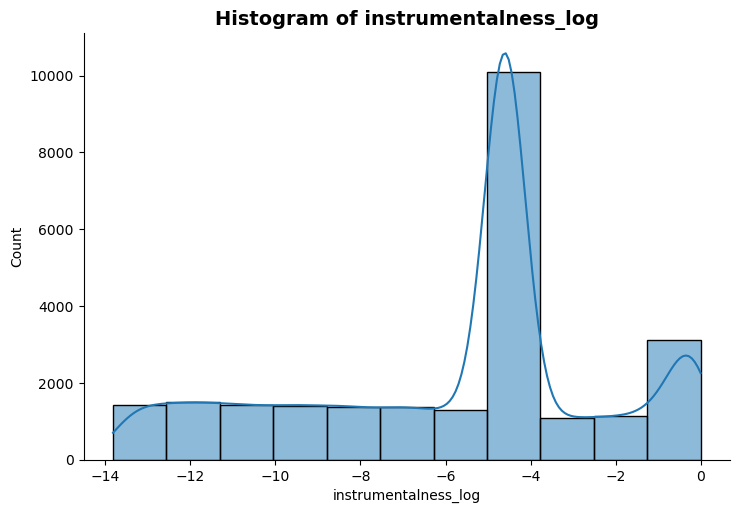

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


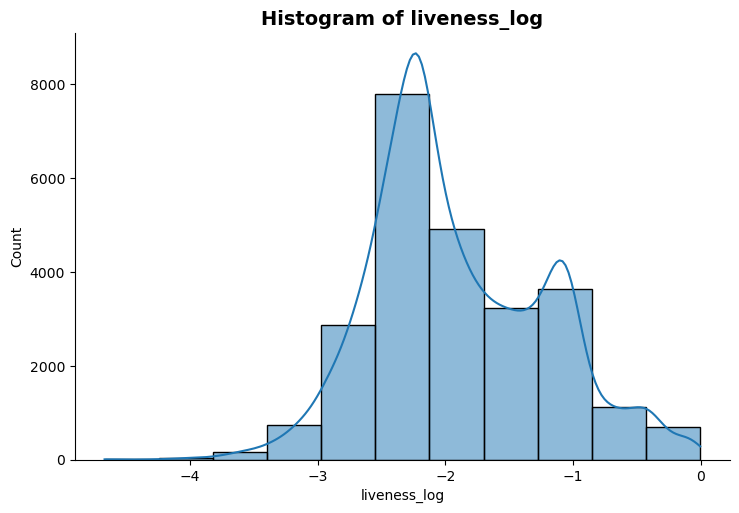

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


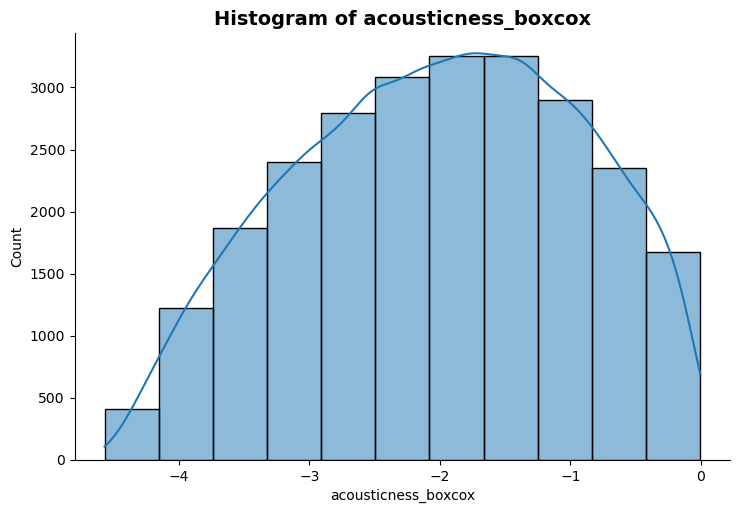

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


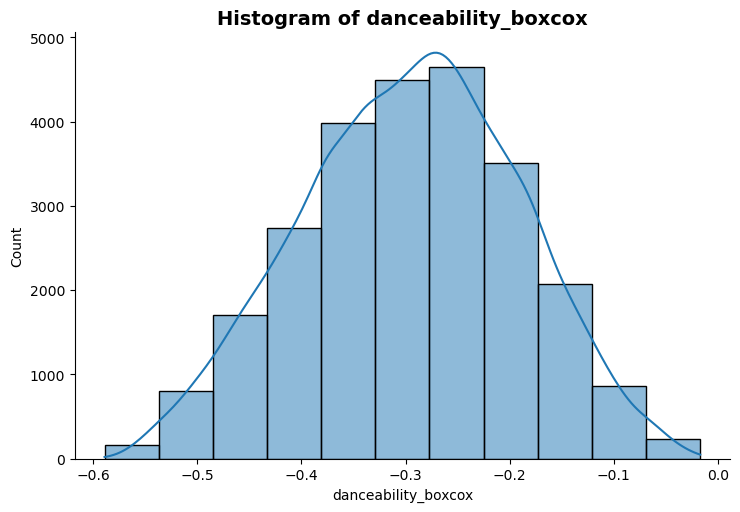

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


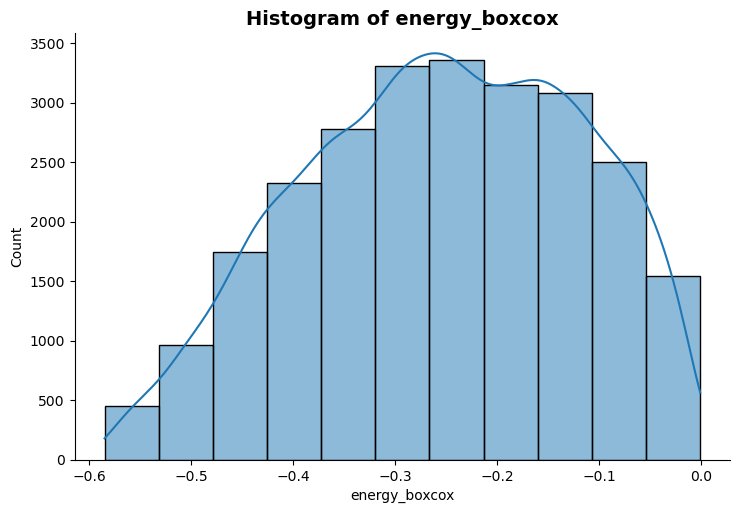

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


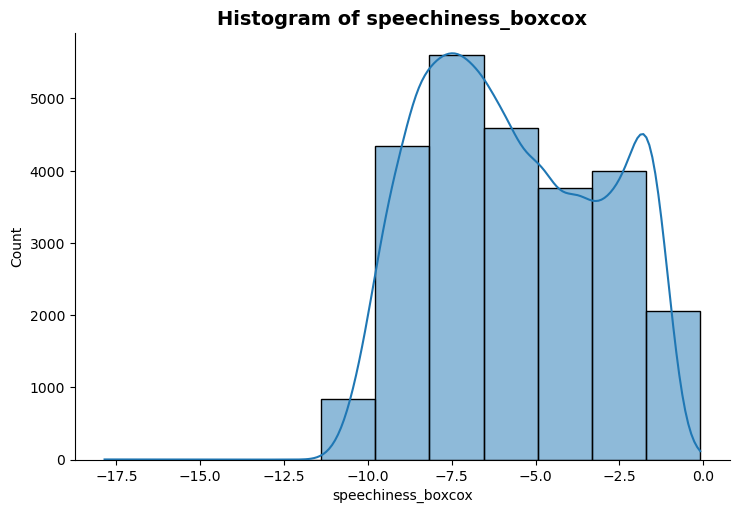

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


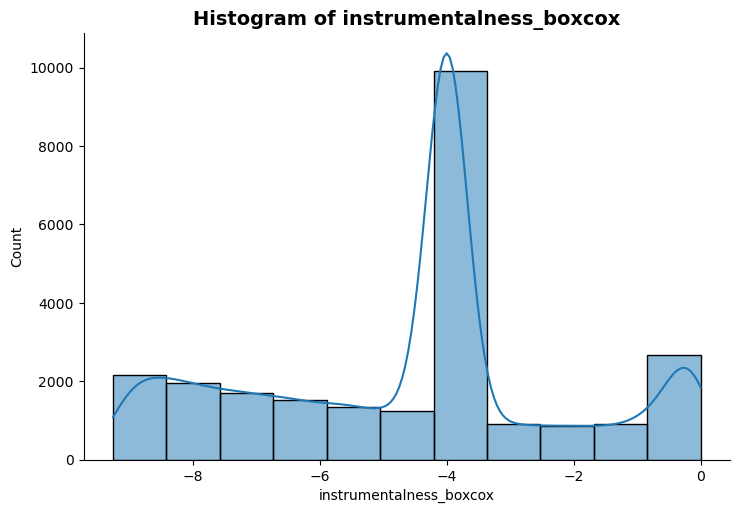

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


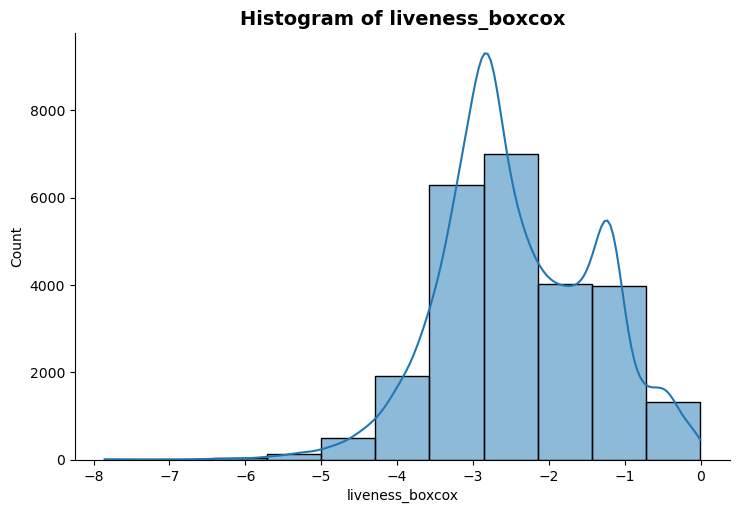

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


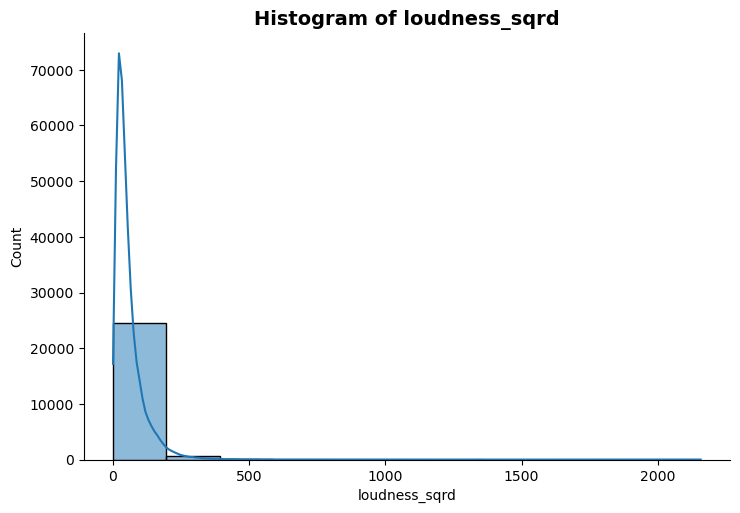

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


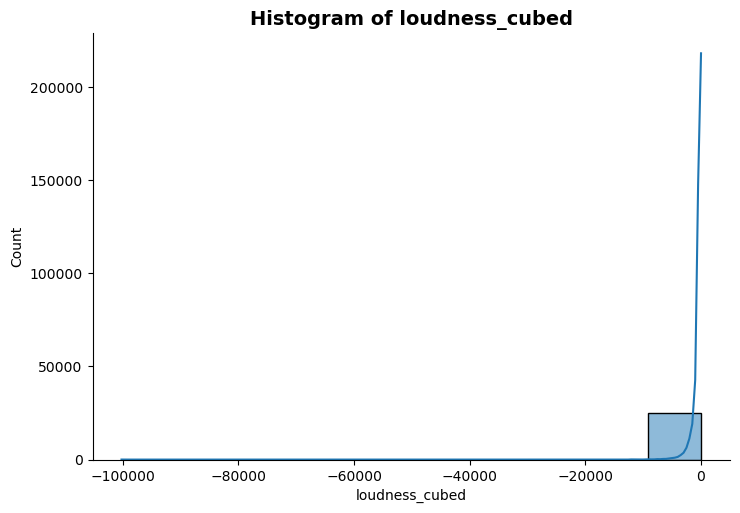

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


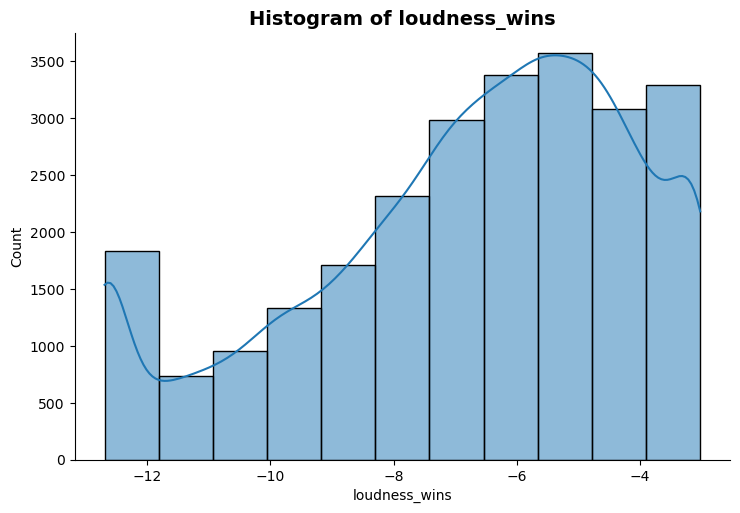

In [52]:
for varn in x_nums_std:
    sns.displot(data=spotify_transf, 
                x=varn, 
                kind="hist", 
                common_norm=False, 
                bins=11, 
                kde=True, 
                aspect=1.5)
    plt.title("Histogram of %s" % varn, fontsize=14, fontweight="bold")
    plt.show()

In [53]:
x_nums_with_std = ['acousticness_logit', 'danceability_boxcox', 'duration_ms',
              'energy_logit', 'speechiness_log',  'liveness_log', 
              'loudness',  'instrumentalness_logit', 'valence', 'tempo']

In [55]:
x_nums_with_std

['acousticness_logit',
 'danceability_boxcox',
 'duration_ms',
 'energy_logit',
 'speechiness_log',
 'liveness_log',
 'loudness',
 'instrumentalness_logit',
 'valence',
 'tempo']

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


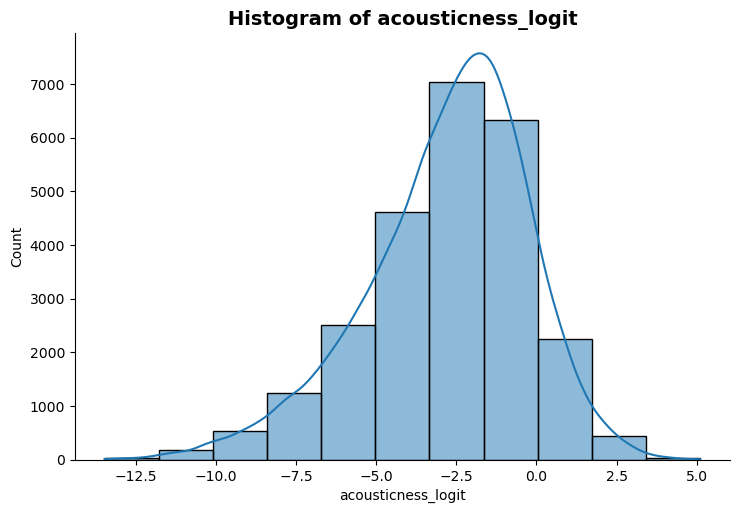

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


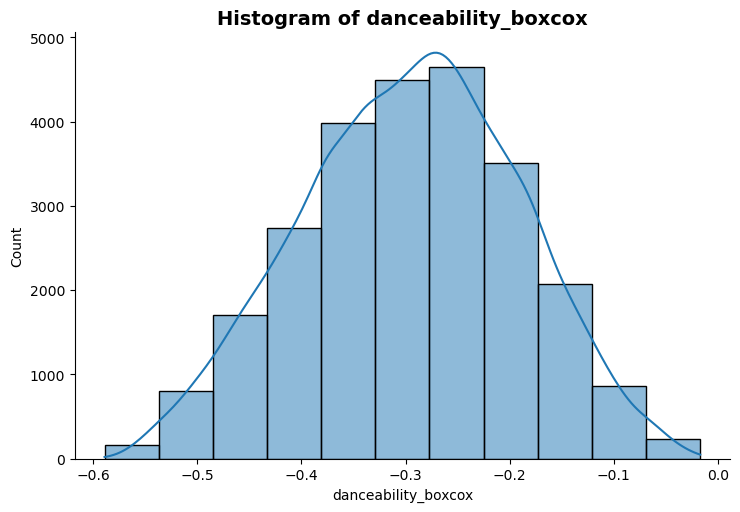

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


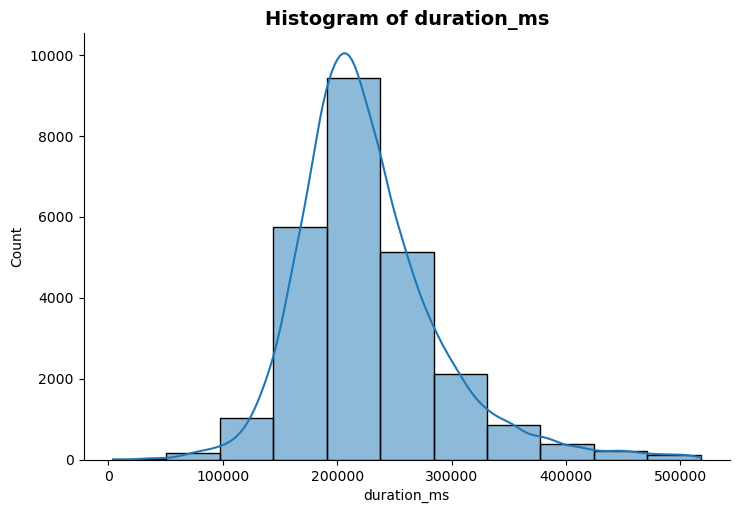

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


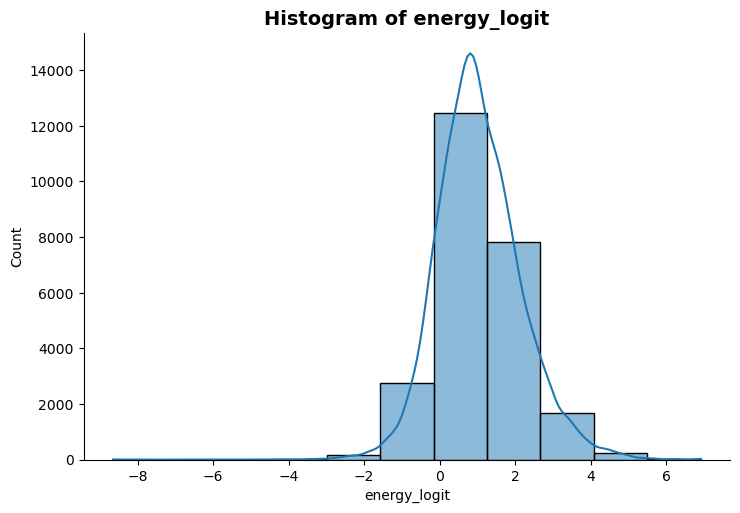

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


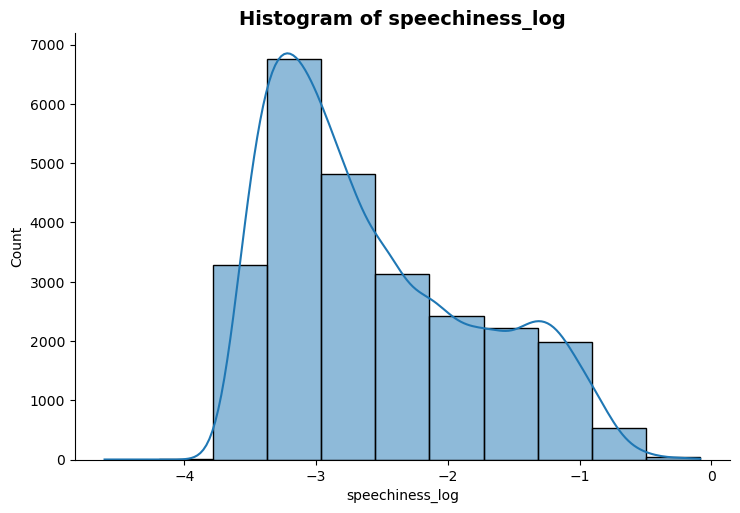

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


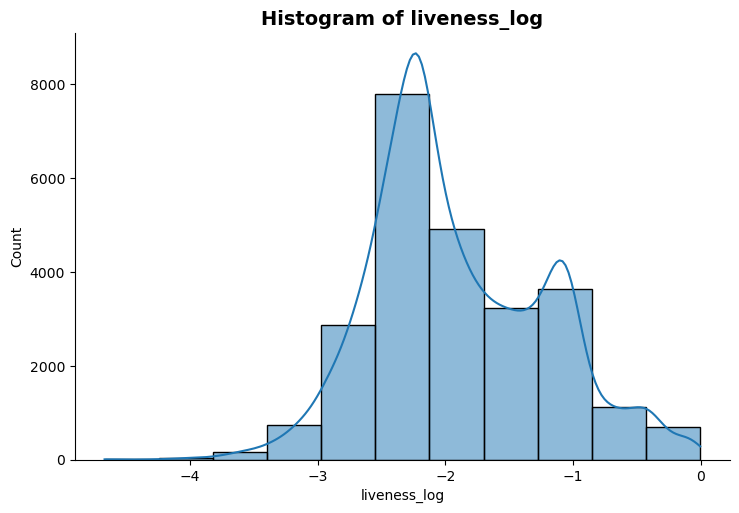

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


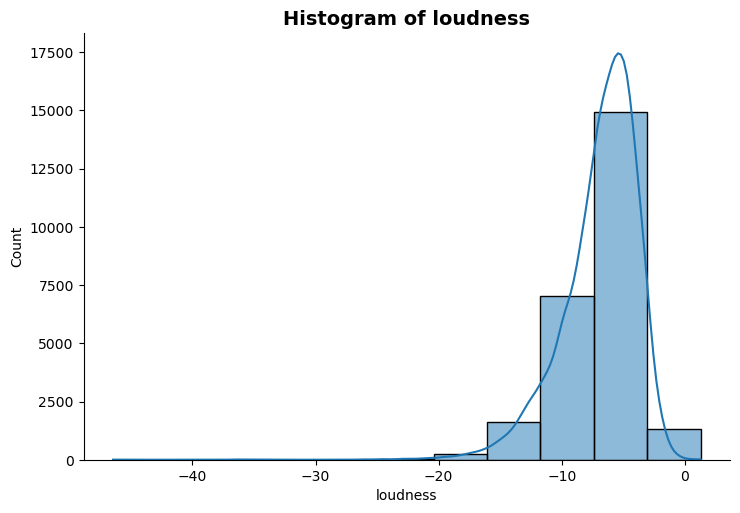

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


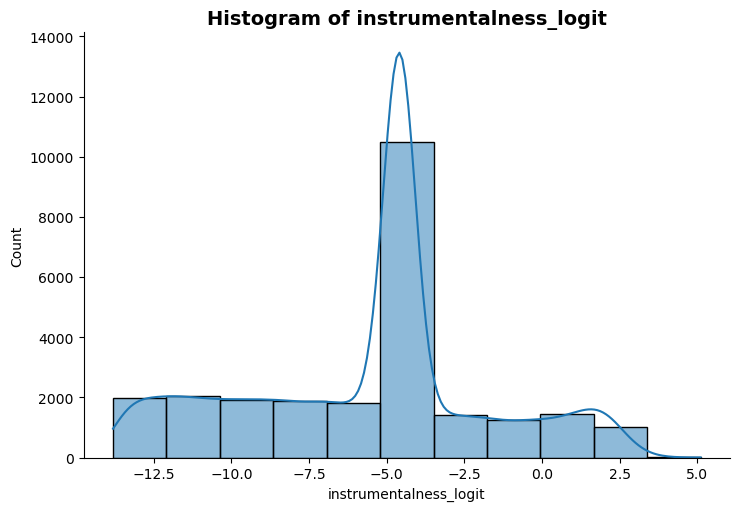

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


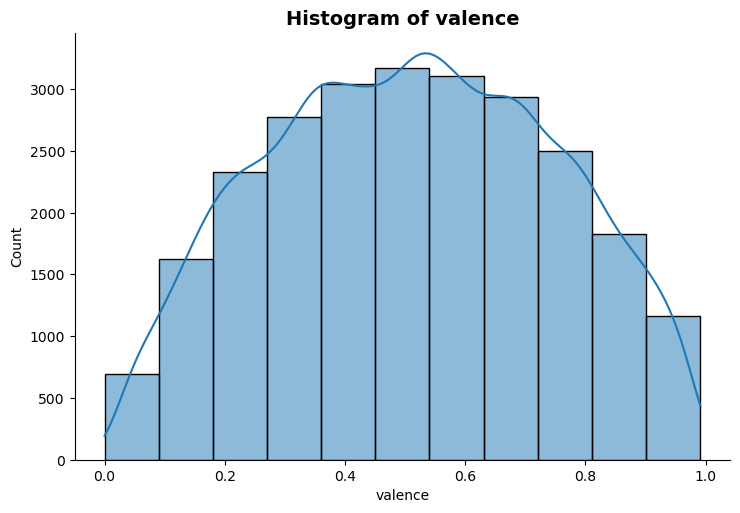

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


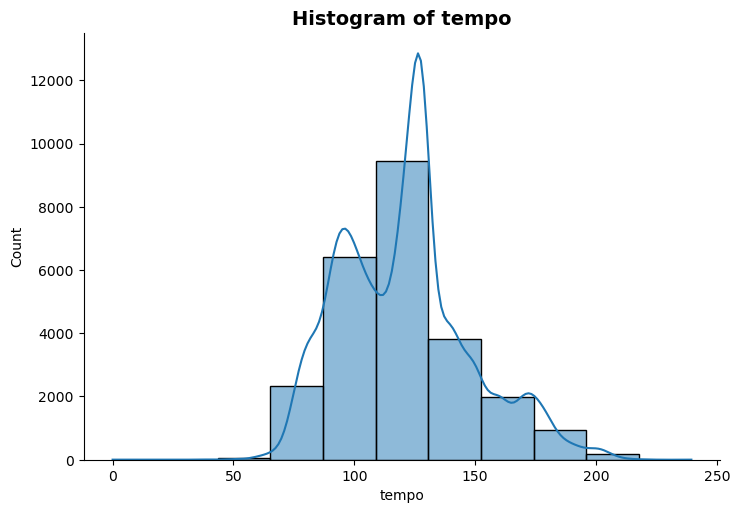

In [56]:
for varn in x_nums_with_std:
    sns.displot(data=spotify_transf, 
                x=varn, 
                kind="hist", 
                common_norm=False, 
                bins=11, 
                kde=True, 
                aspect=1.5)
    plt.title("Histogram of %s" % varn, fontsize=14, fontweight="bold")
    plt.show()

In [57]:
from scipy import stats

Var: acousticness_logit, Shapiro-Wilk p-value: 0.000000


/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/scipy/stats/_morestats.py:1800: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


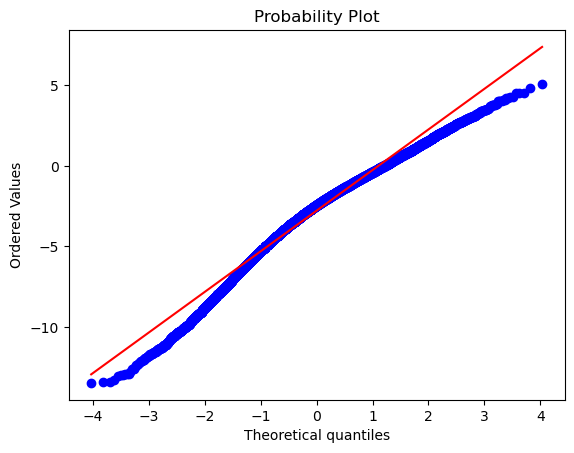

Var: danceability_boxcox, Shapiro-Wilk p-value: 0.000000


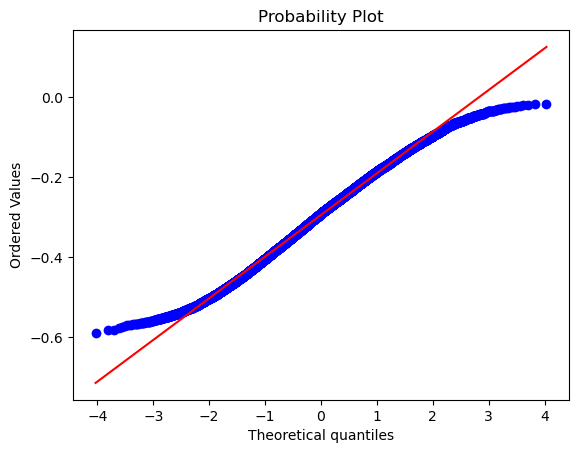

Var: duration_ms, Shapiro-Wilk p-value: 0.000000


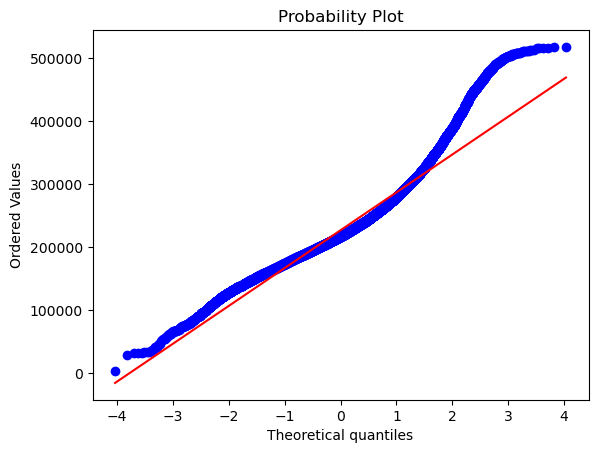

Var: energy_logit, Shapiro-Wilk p-value: 0.000000


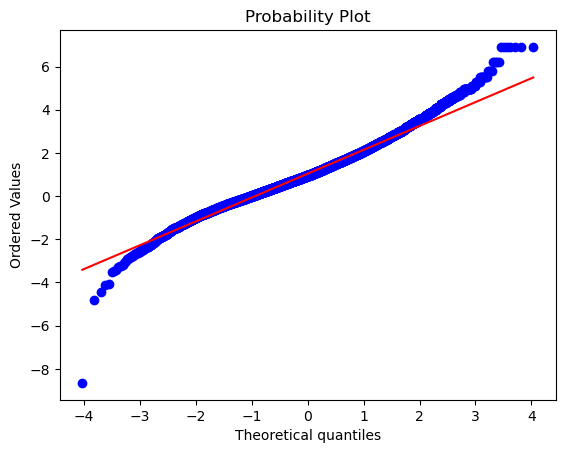

Var: speechiness_log, Shapiro-Wilk p-value: 0.000000


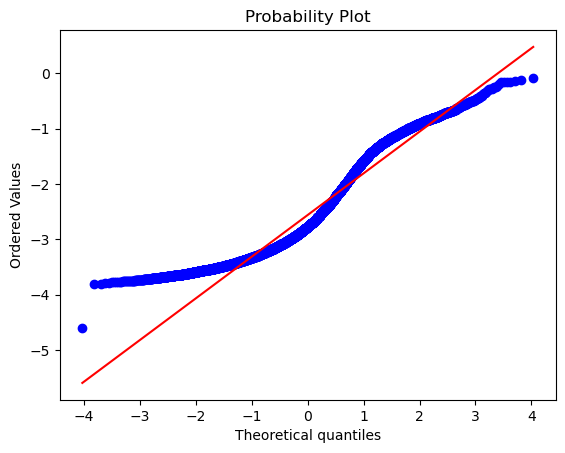

Var: liveness_log, Shapiro-Wilk p-value: 0.000000


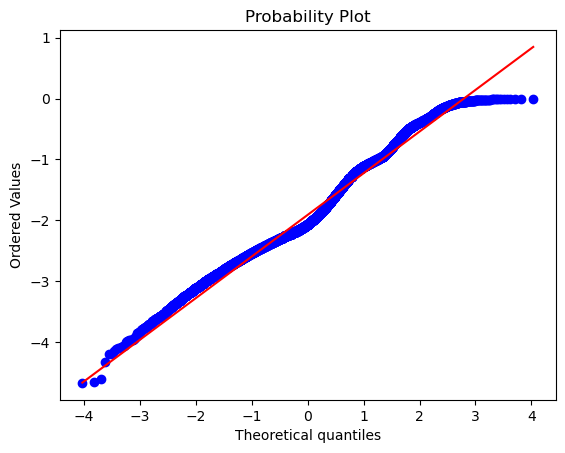

Var: loudness, Shapiro-Wilk p-value: 0.000000


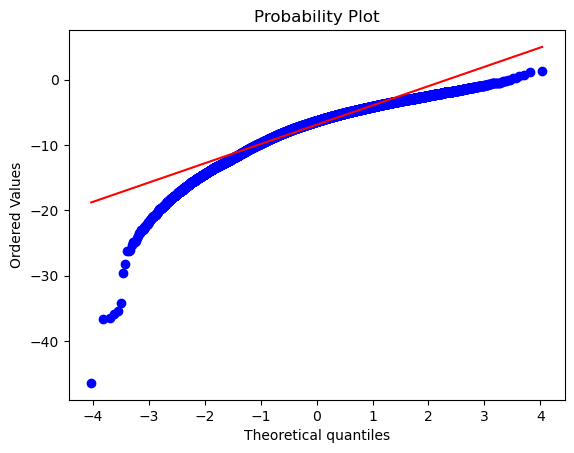

Var: instrumentalness_logit, Shapiro-Wilk p-value: 0.000000


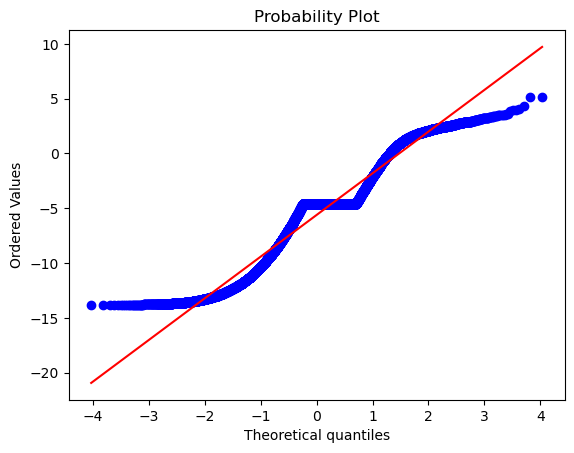

Var: valence, Shapiro-Wilk p-value: 0.000000


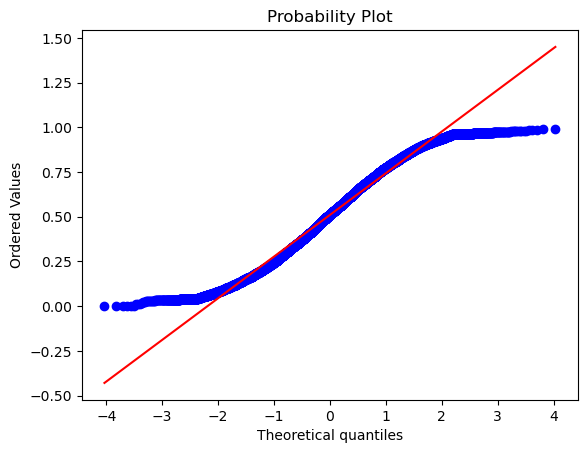

Var: tempo, Shapiro-Wilk p-value: 0.000000


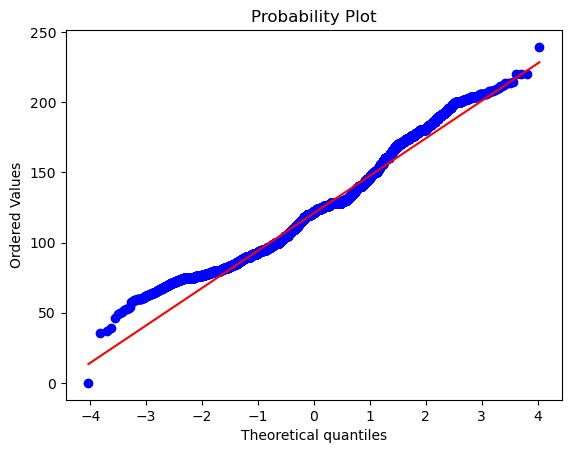

In [58]:
for var in x_nums_with_std:
    data = spotify_transf.loc[:, var]
    stat, p_value = stats.shapiro(data)
    print("Var: %s, Shapiro-Wilk p-value: %f" % (var, p_value))
    stats.probplot(data, dist="norm", plot=plt)
    plt.show()

### **Plotting Transformed Data**

In [81]:
spotify_df_t = spotify_transf.loc[:, x_cats+ y_cats + x_nums_with_std].copy()

In [82]:
spotify_df_t.columns

Index(['key', 'mode', 'playlist_genre', 'binary_outcome', 'binary_outcome_60',
       'binary_outcome_70', 'acousticness_logit', 'danceability_boxcox',
       'duration_ms', 'energy_logit', 'speechiness_log', 'liveness_log',
       'loudness', 'instrumentalness_logit', 'valence', 'tempo'],
      dtype='object')

**3 - Relationships between continuous variables**

Heatmaps - Correlation Plots

In [83]:
corr_matrix = spotify_df_t.loc[:, x_nums_with_std].corr()

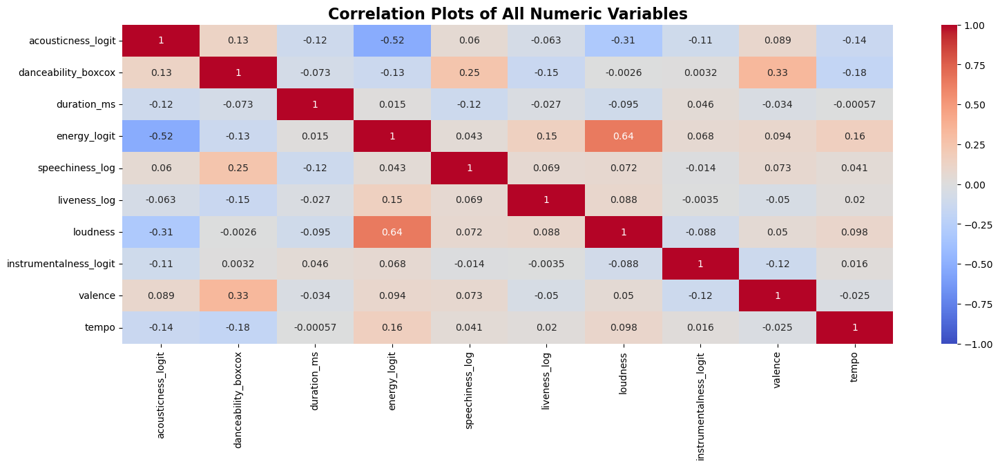

In [84]:
fig, ax = plt.subplots(figsize=(18,6))

sns.heatmap(data=corr_matrix, 
            vmin=-1,
            vmax=1,
            center=0,
            annot=True,
            annot_kws={"fontsize": 10},
            cmap="coolwarm",
            ax=ax)

ax.set_title("Correlation Plots of All Numeric Variables", fontsize=16, fontweight="bold")
plt.show()

Correlations higher than abs(.30) are:
* Valence with Danceability (0.32)
* Acousticness with Energy (-0.52)
* Loudness with Energy (0.64)
* Loudness with Acousticness (-0.30)

Seeing if Correlation changes between numeric variables by categorical inputs

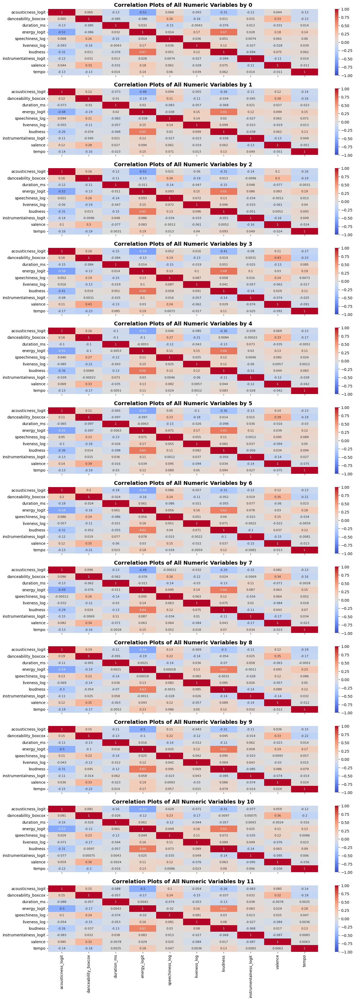

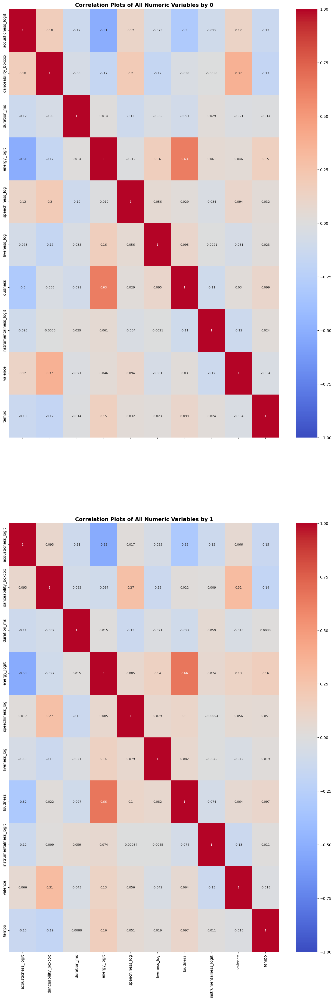

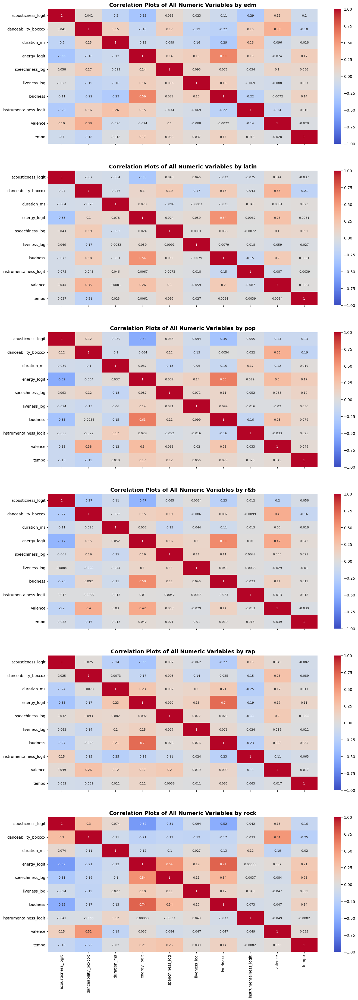

In [86]:
for var in x_cats:
    var_groups = np.sort(spotify_df_t[var].unique()).tolist()
    corr_groups = spotify_df_t.loc[:, [var] + x_nums_with_std].groupby(var).corr()
    
    fig, axs = plt.subplots(len(var_groups), 1, figsize=(16,45), sharex=True, sharey=True)
    for ix in range(len(var_groups)):
        sns.heatmap(data=(corr_groups.loc[var_groups[ix]]), 
                    vmin=-1,
                    vmax=1,
                    center=0,
                    annot=True,
                    annot_kws={"fontsize": 8},
                    cmap="coolwarm",
                    ax=axs[ix])
        
        axs[ix].set_title("Correlation Plots of All Numeric Variables by %s" % (var_groups[ix]), fontsize=14, fontweight="bold")
    plt.show()

The correlations seem very similar between groups of `key` and `mode`, but are different with `playlist_genre`. This is what we saw with the raw data.

Pairs Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


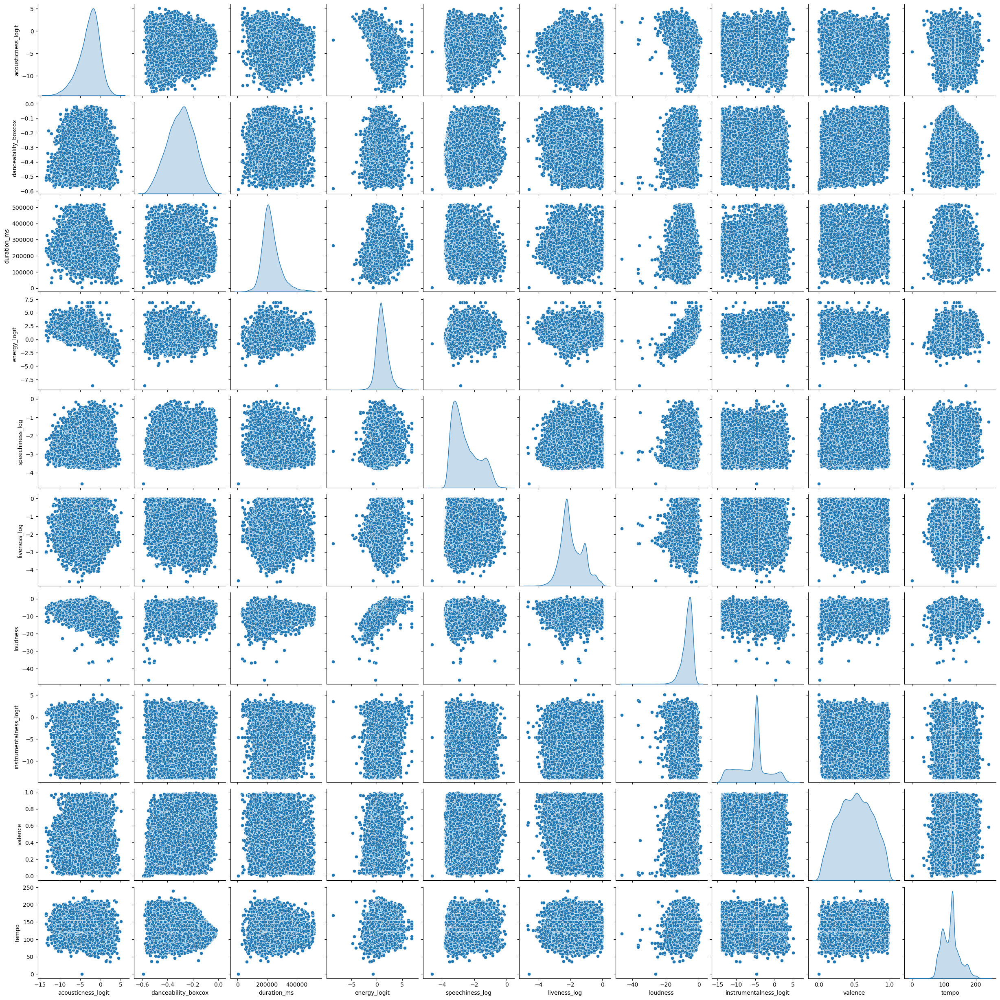

In [87]:
sns.pairplot(data=spotify_df_t.loc[:, x_nums_with_std], 
             diag_kind="kde", 
             diag_kws={"common_norm": False})

plt.show()

**4 - Summaries of the continuous variables grouped by categorical variables**

Point Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


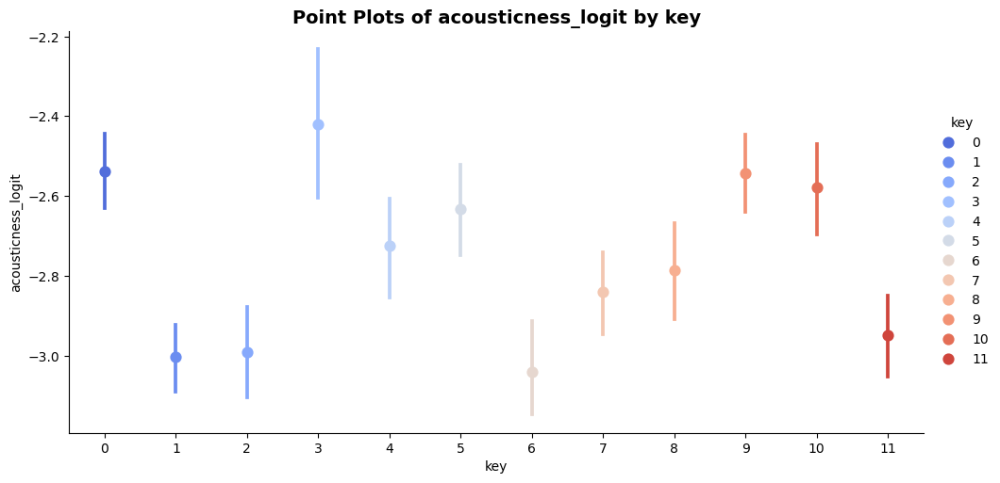

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


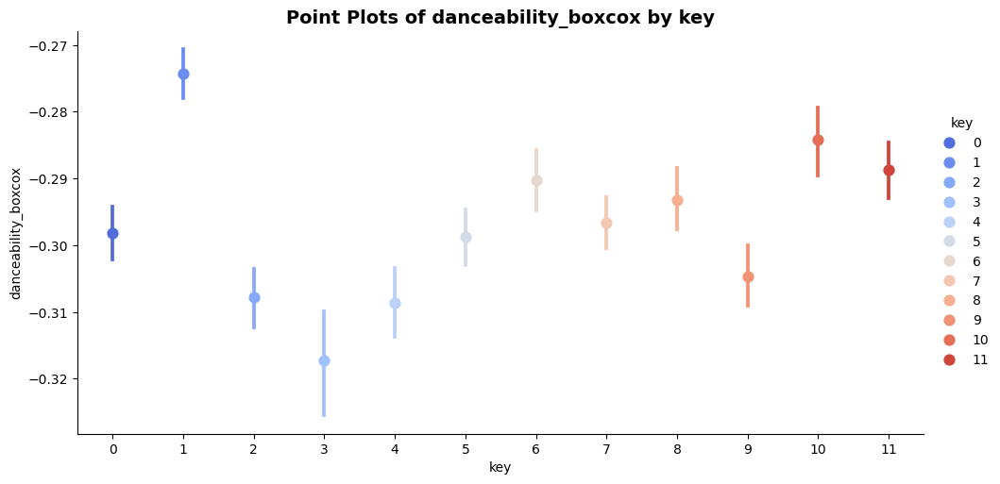

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


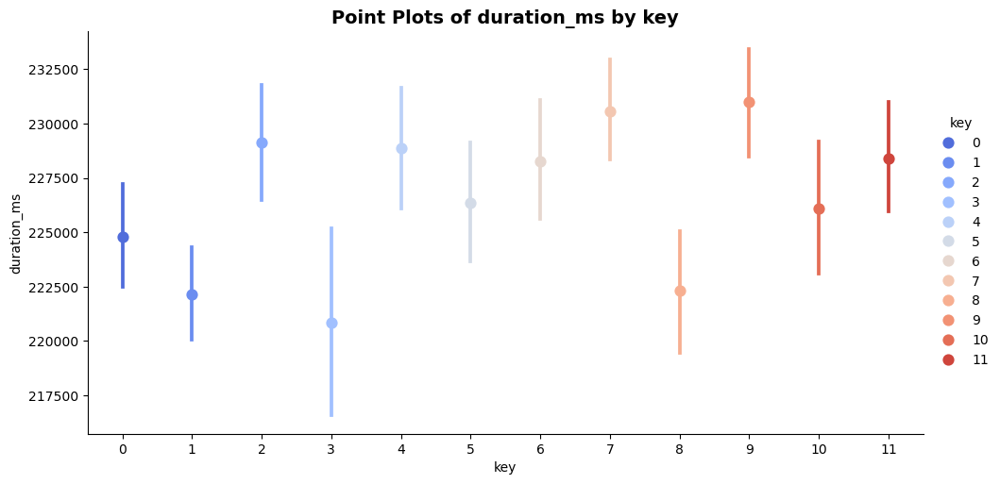

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


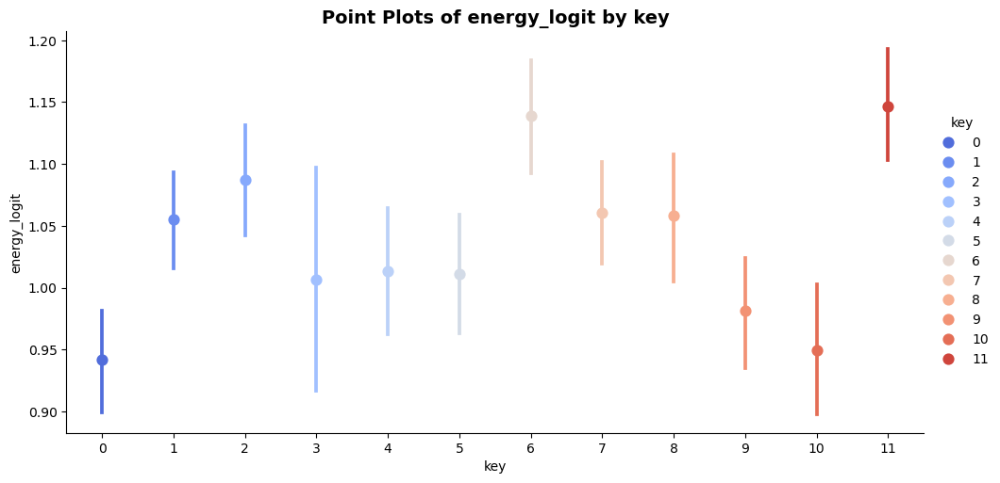

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


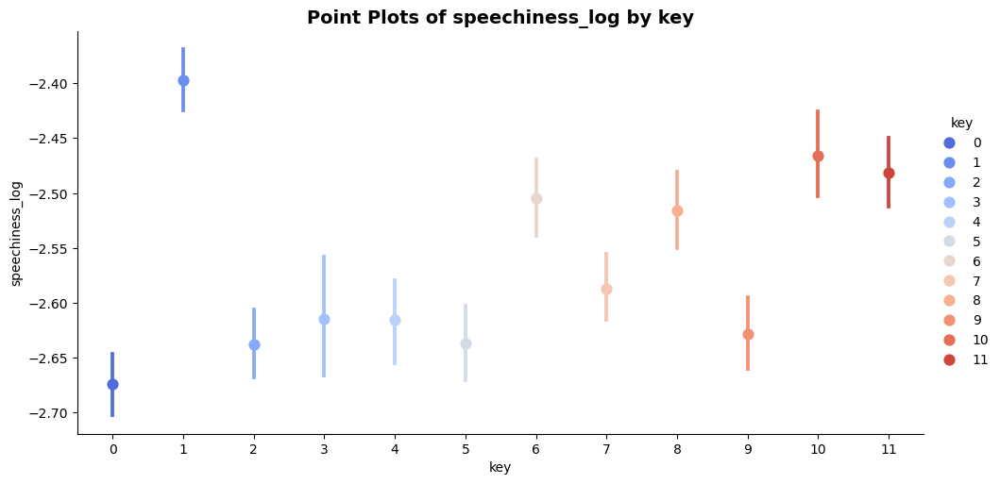

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


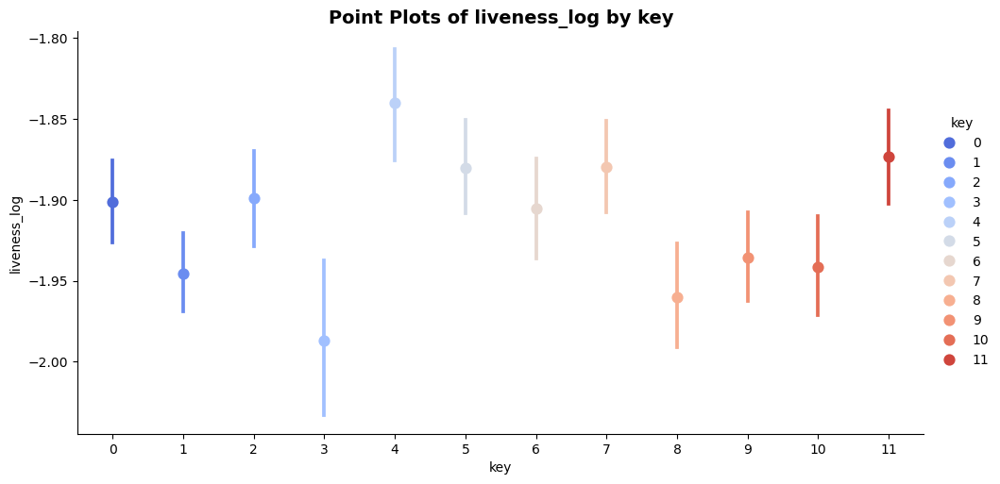

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


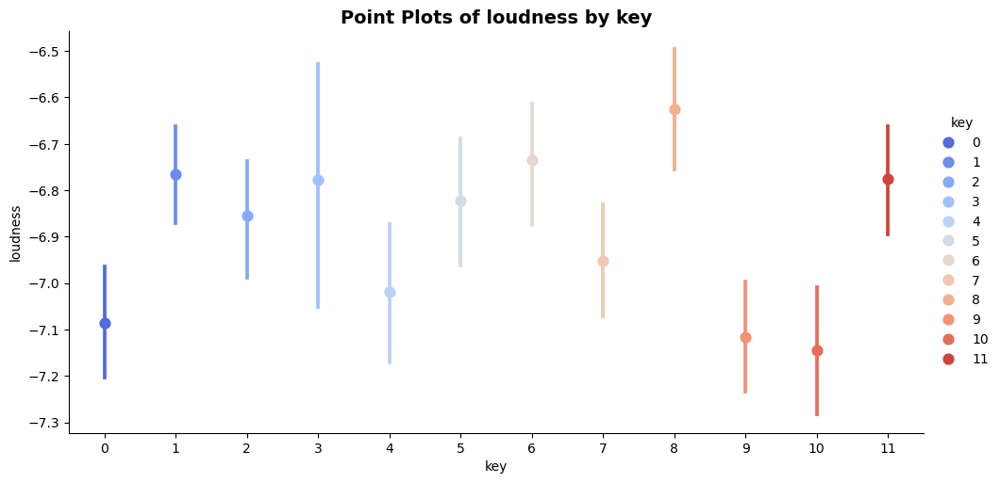

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


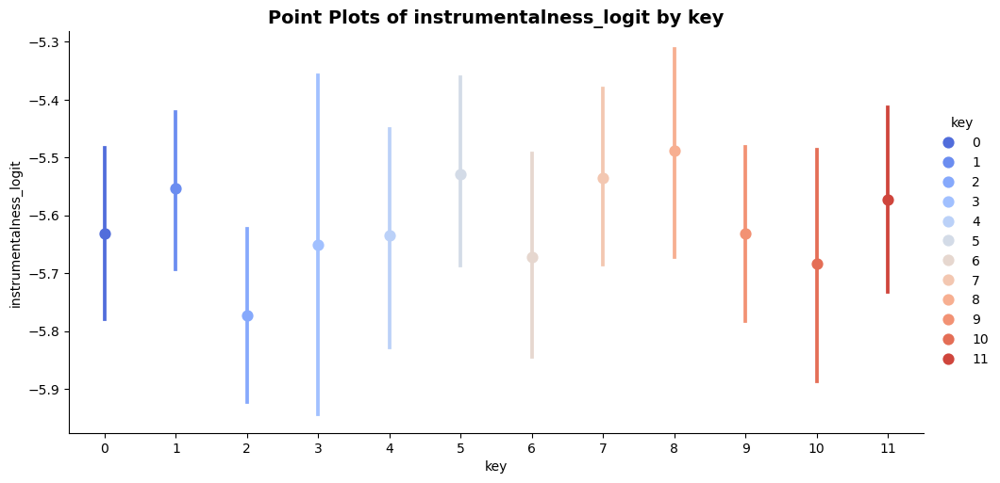

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


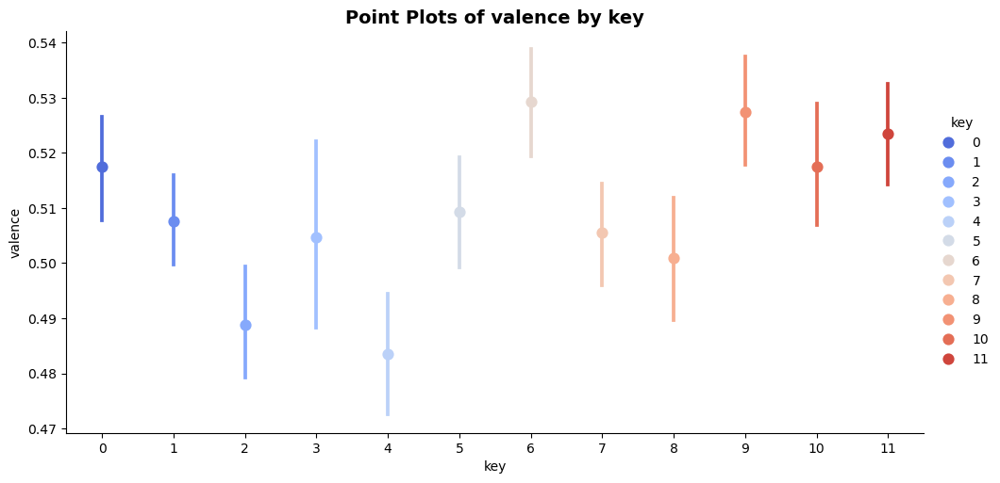

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


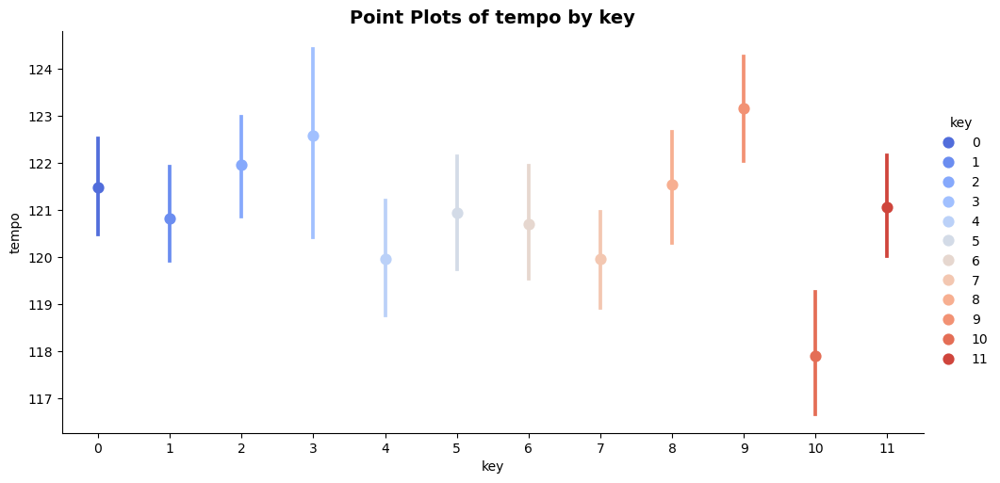

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


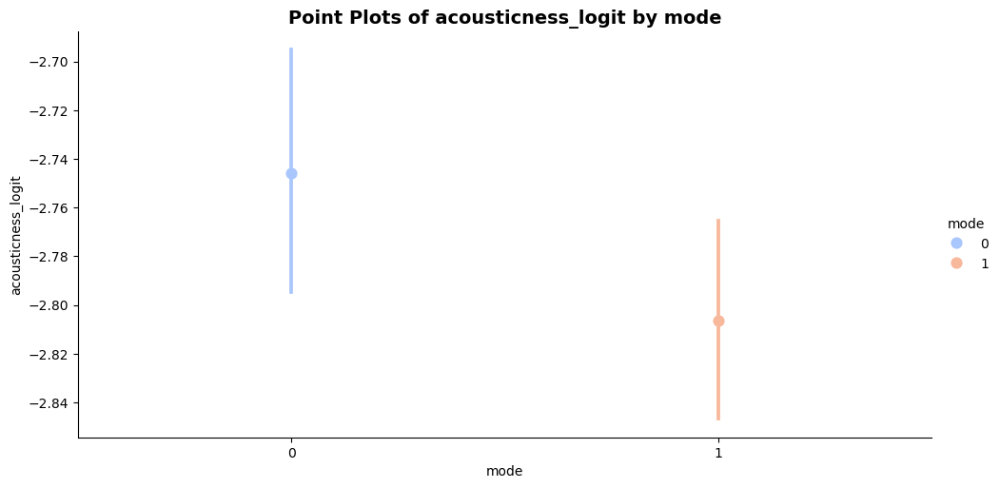

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


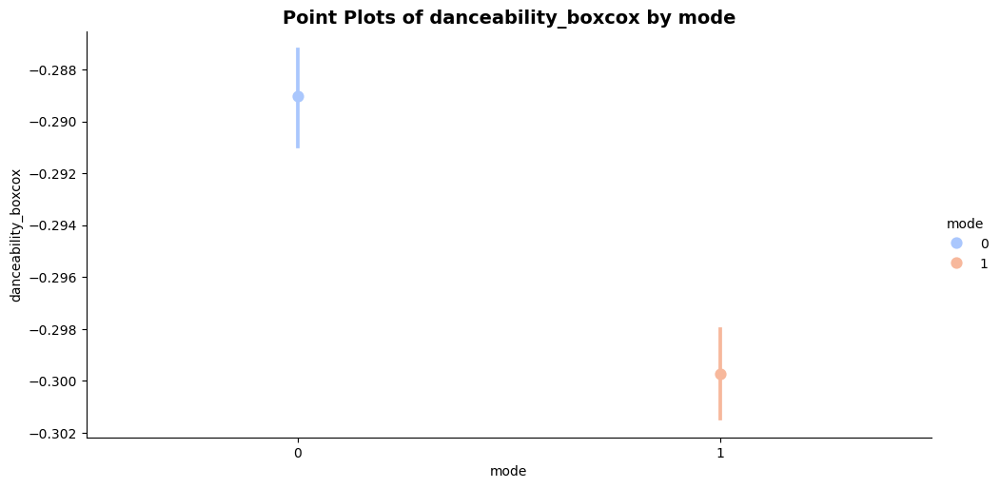

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


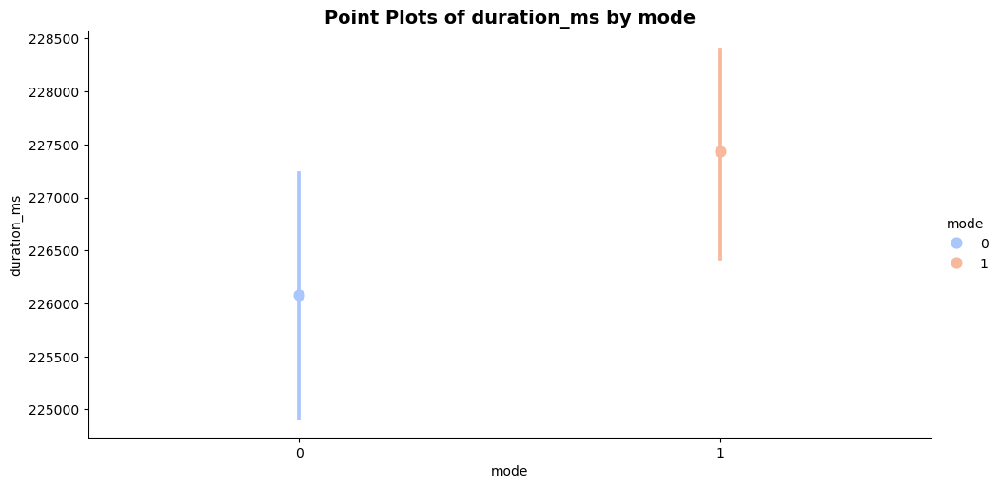

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


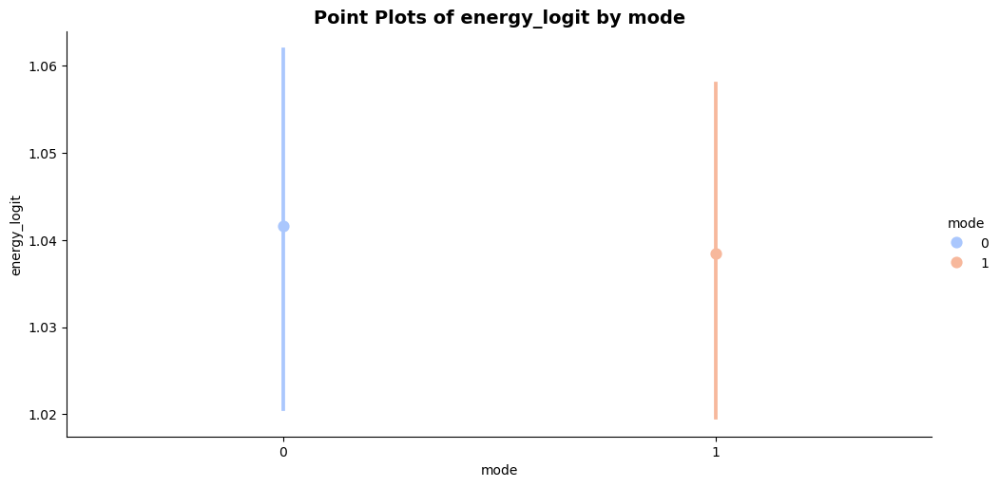

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


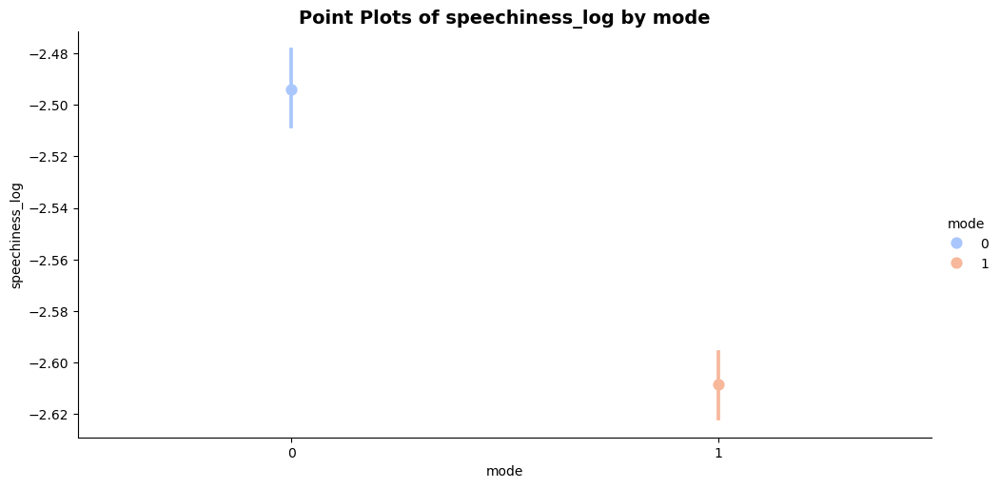

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


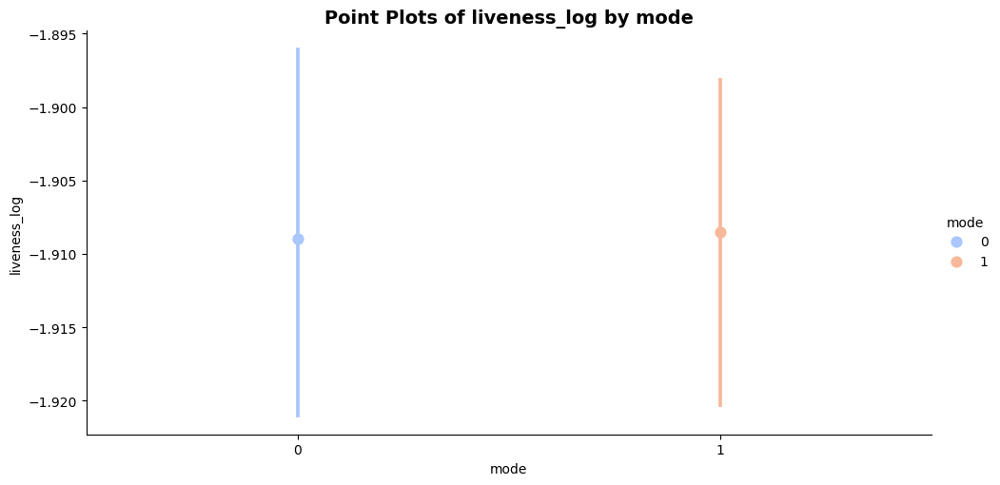

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


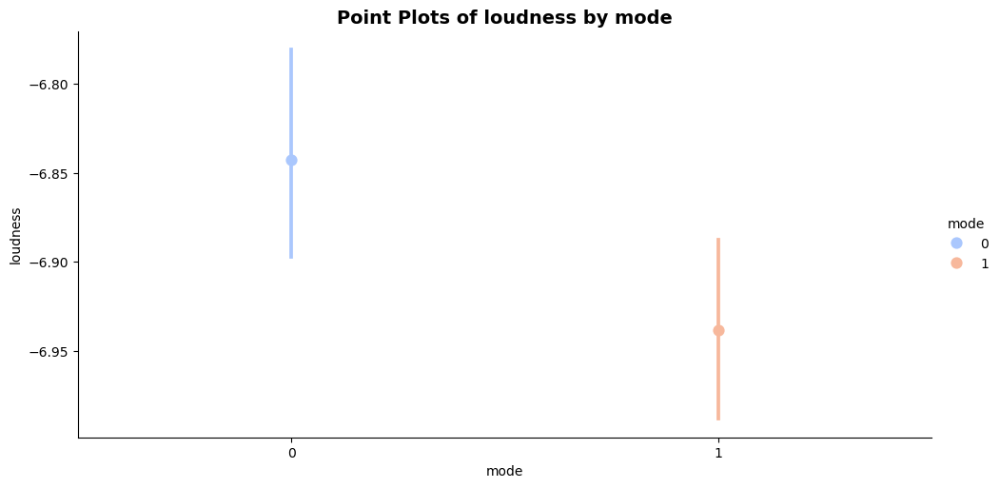

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


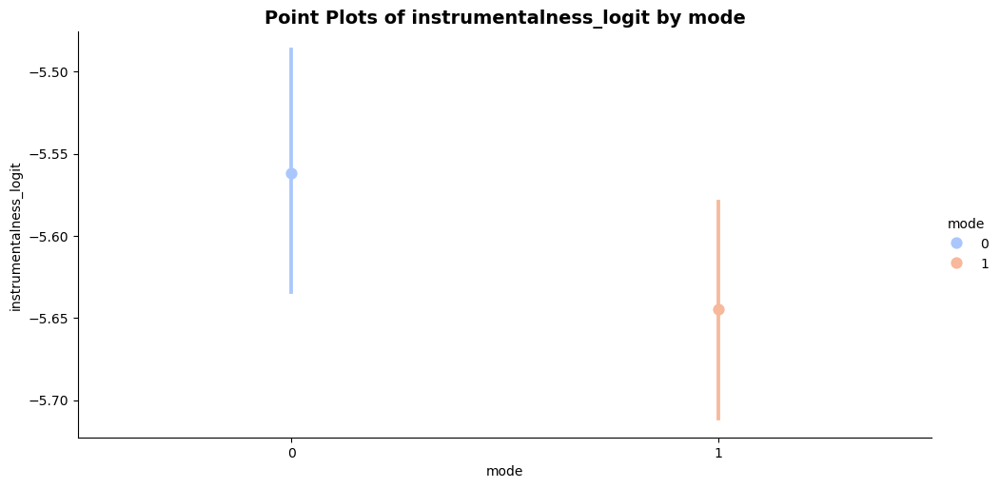

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


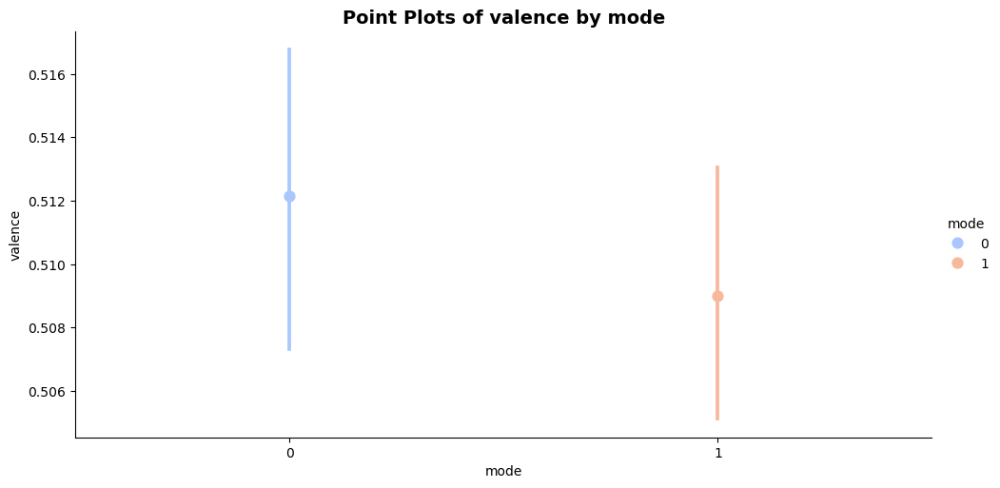

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


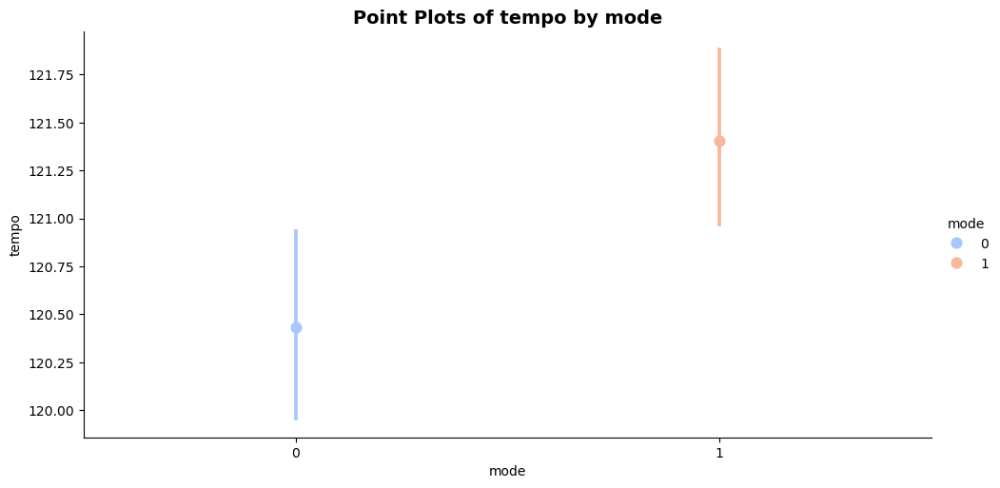

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


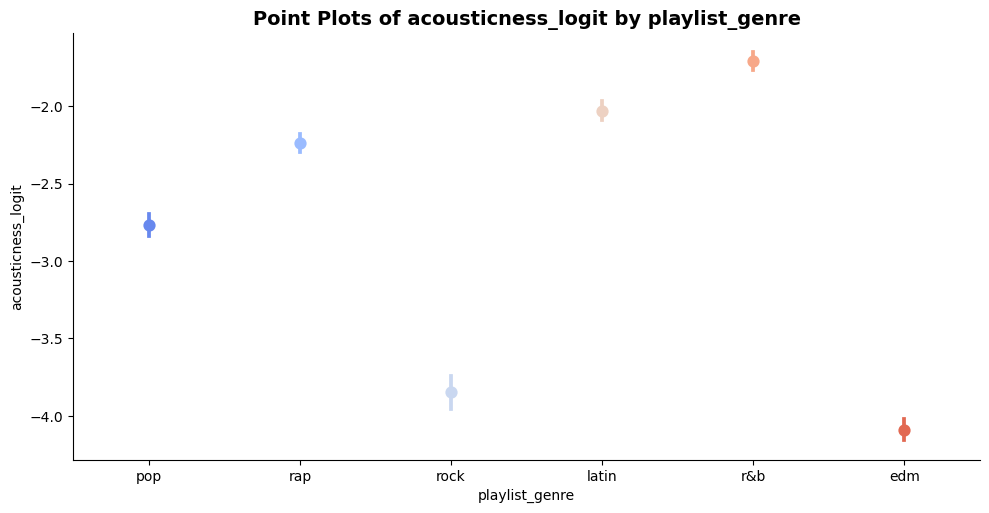

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


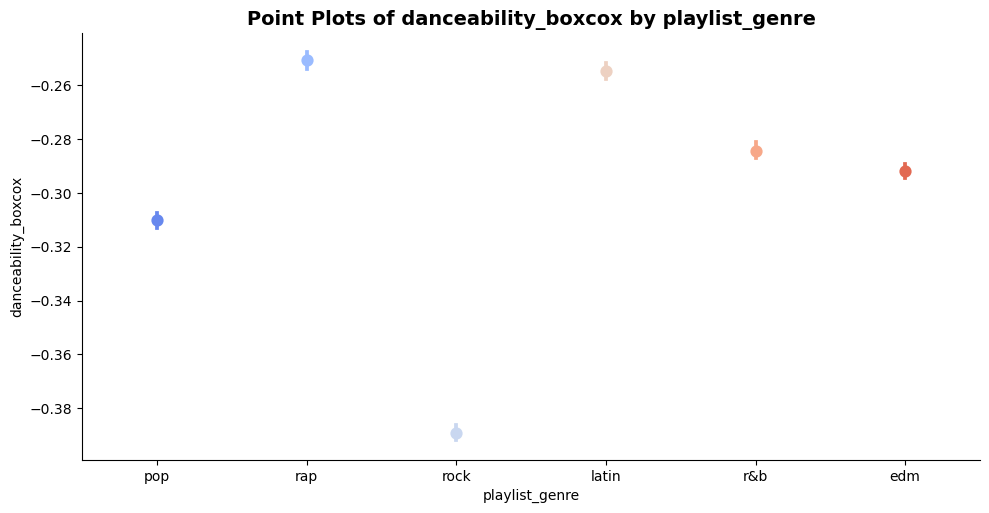

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


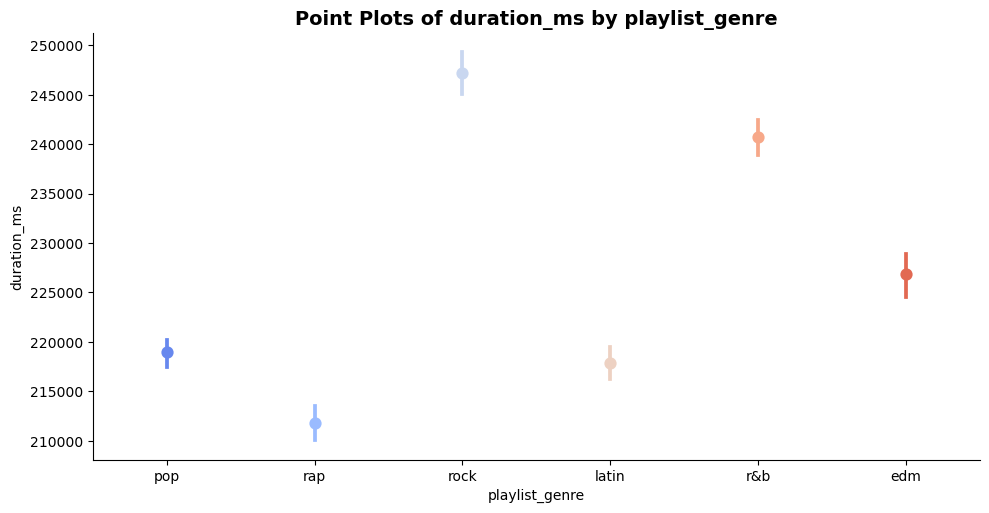

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


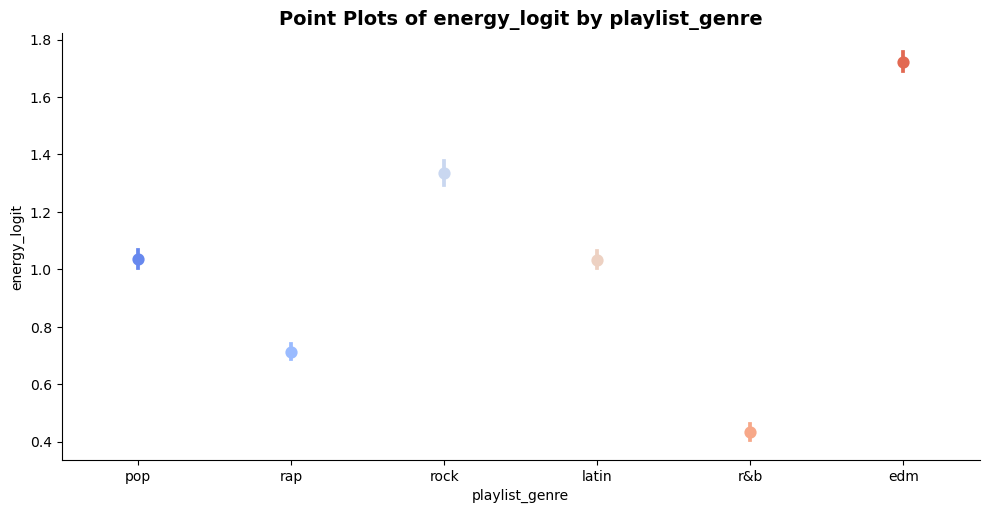

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


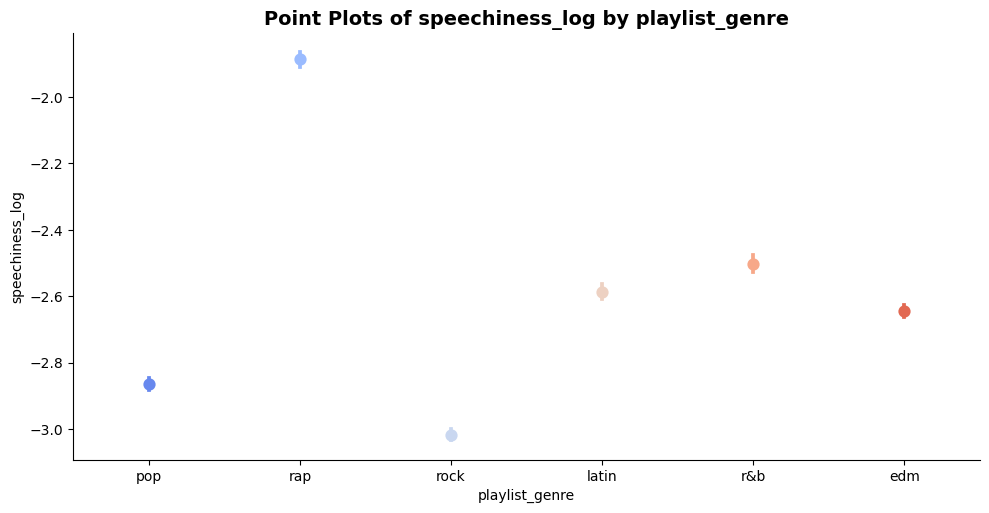

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


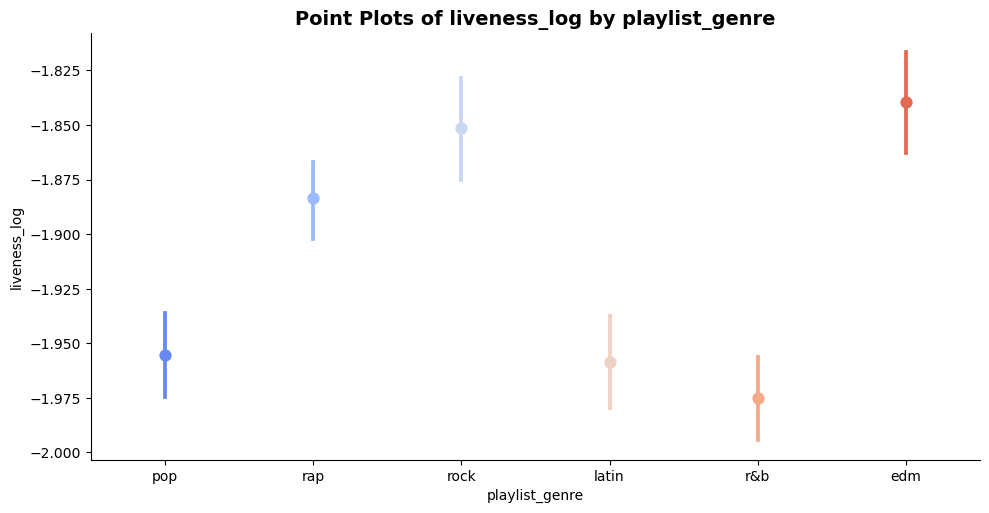

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


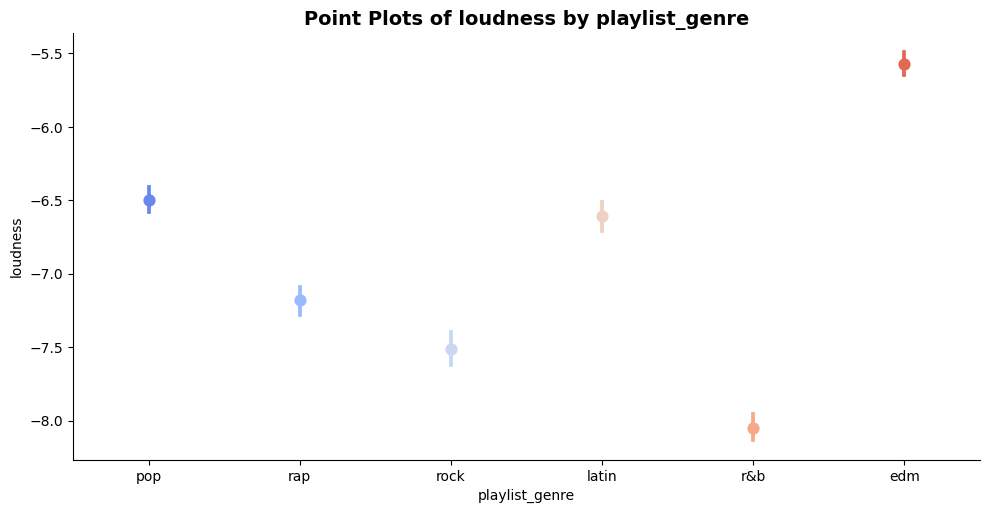

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


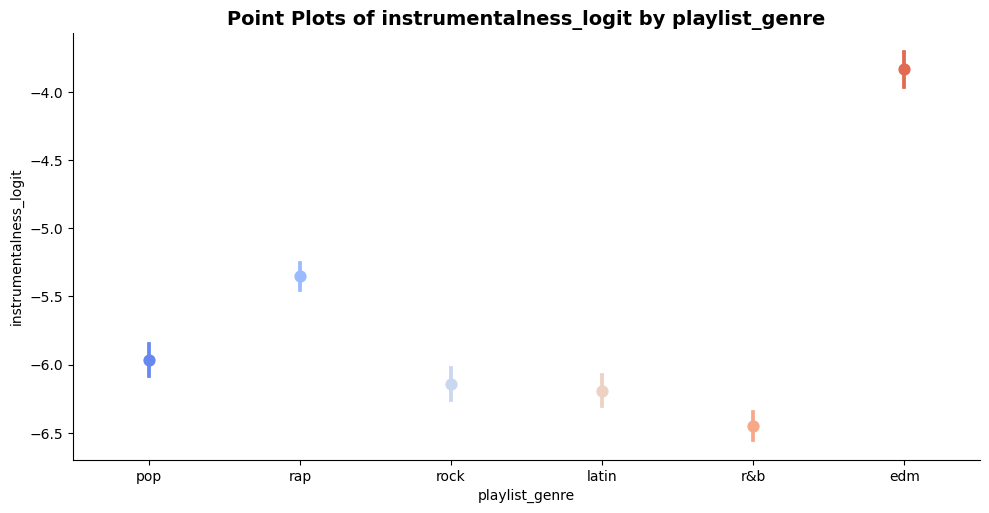

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


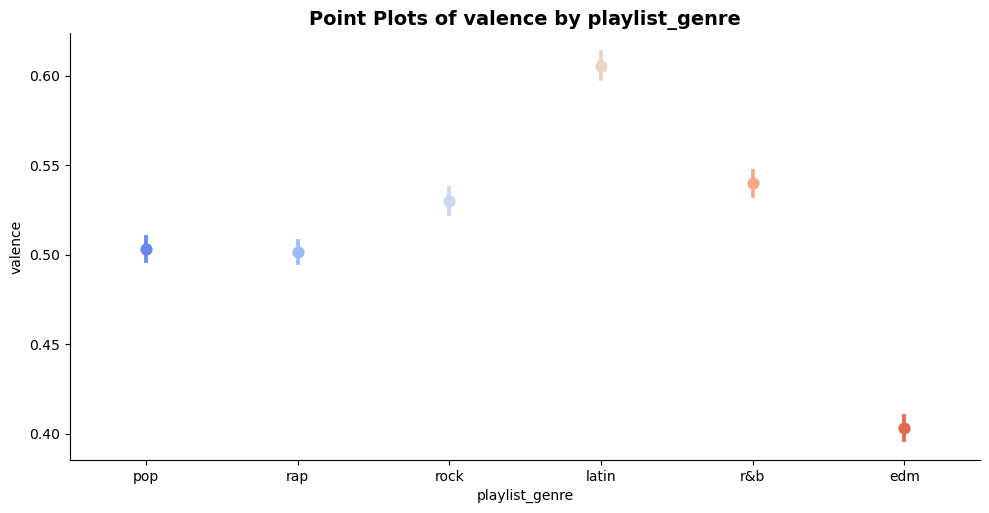

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


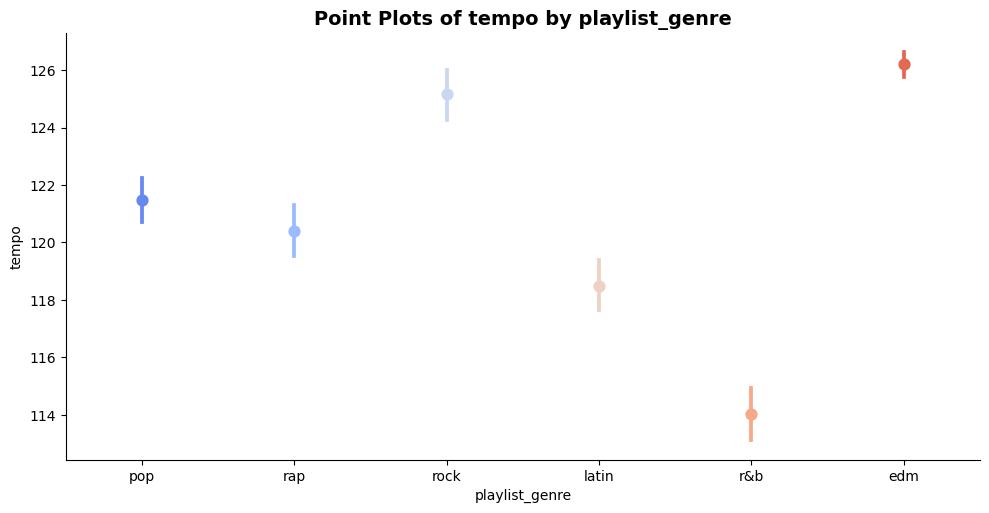

In [88]:
for var2 in x_cats:
    for var in x_nums_with_std:
        sns.catplot(data=spotify_df_t, x=var2, y=var, hue=var2, kind="point", palette="coolwarm", linestyle="none", aspect=2)
        plt.title("Point Plots of %s by %s" % (var, var2), fontsize=14, fontweight="bold")
        plt.show()

Box Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


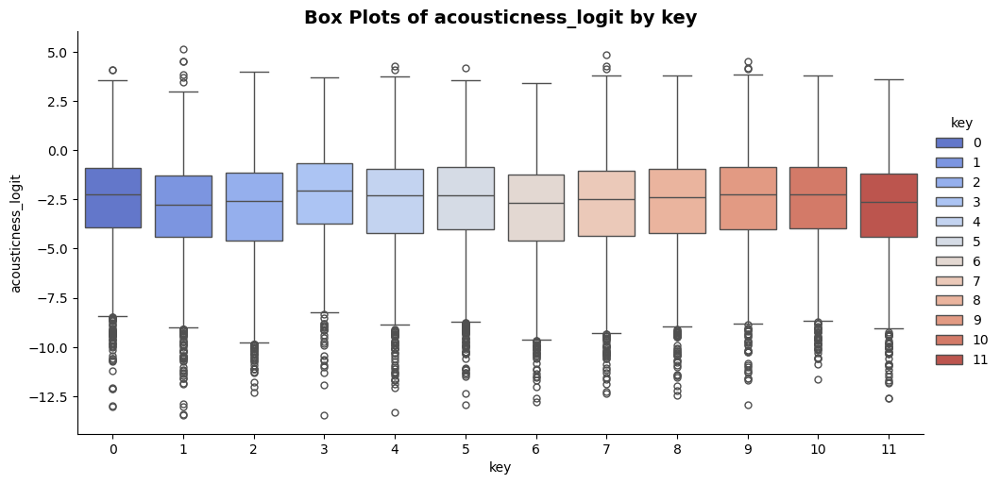

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


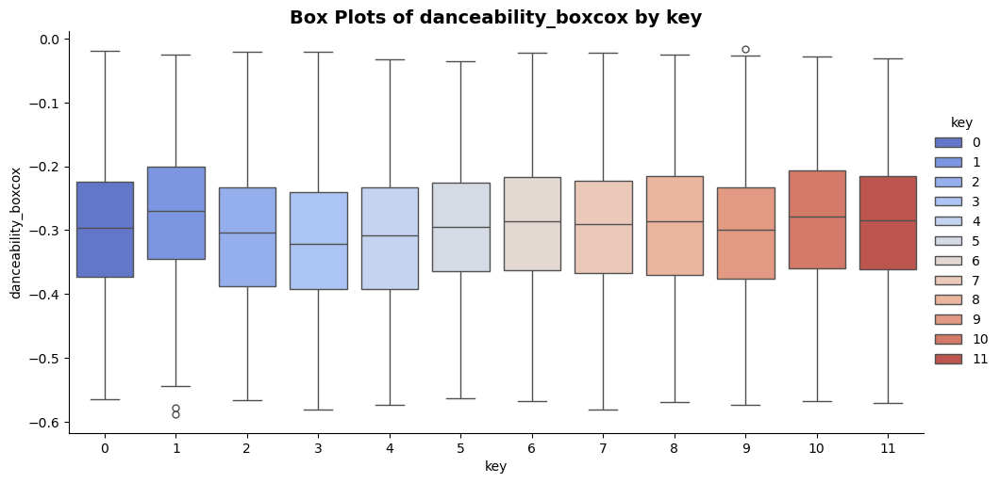

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


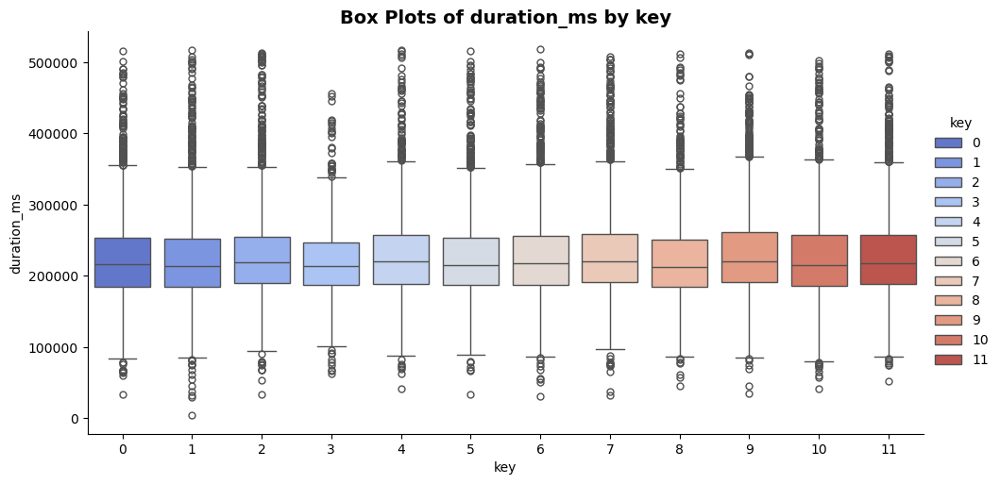

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


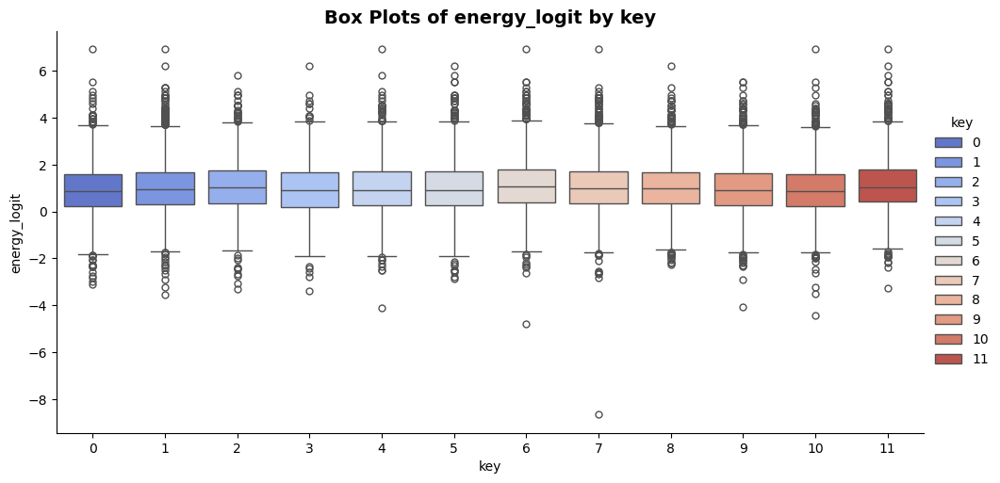

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


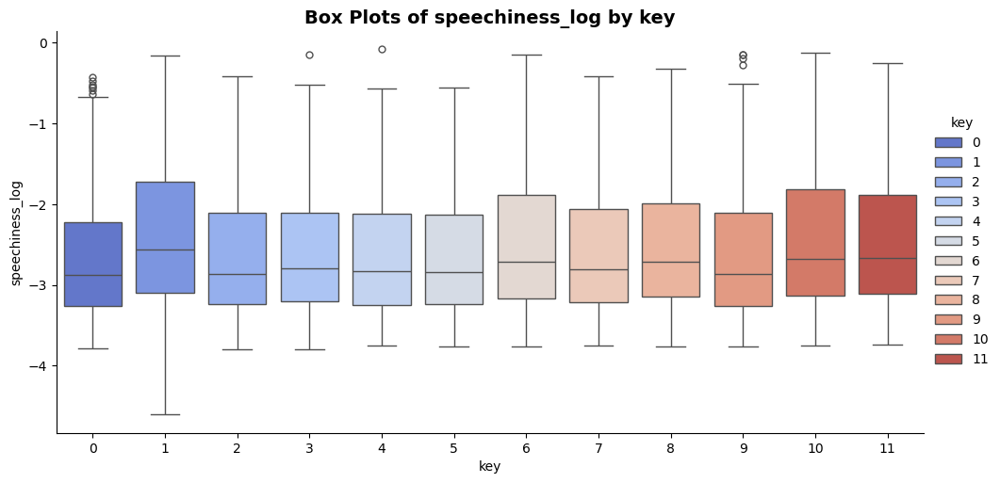

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


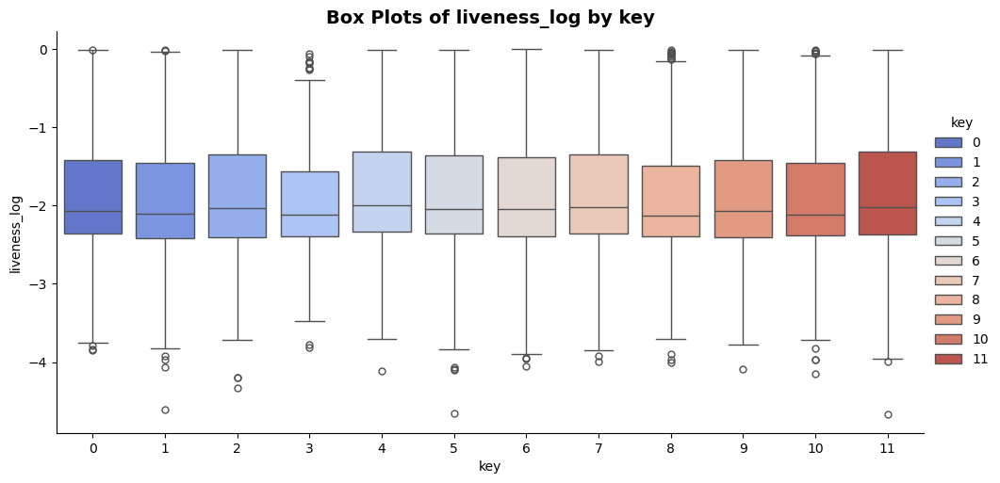

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


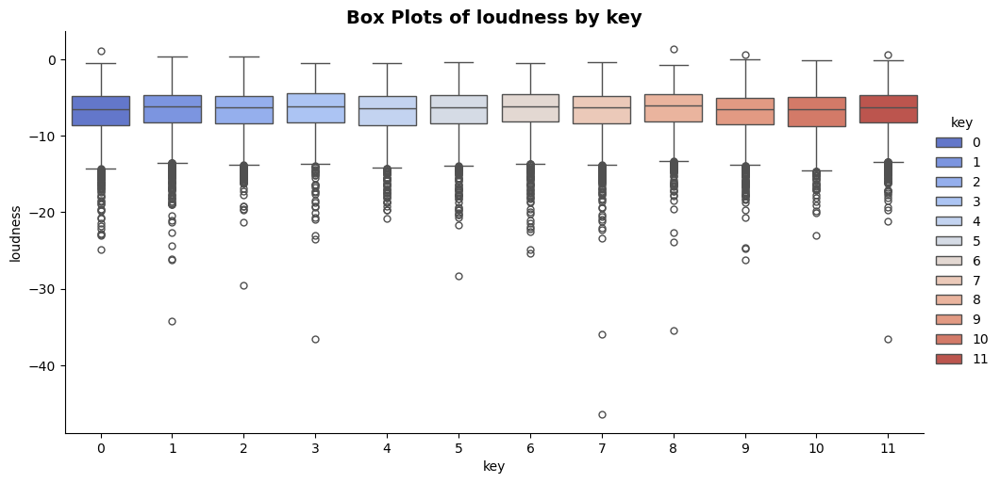

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


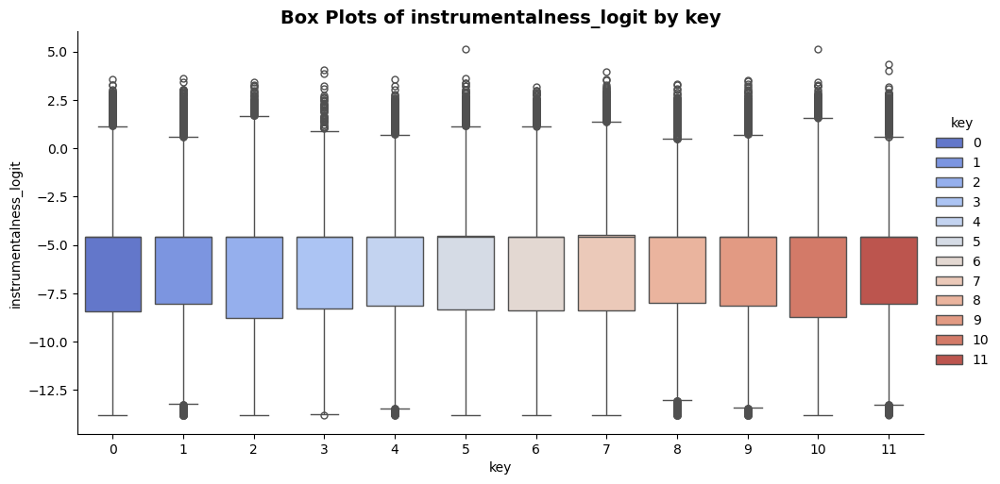

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


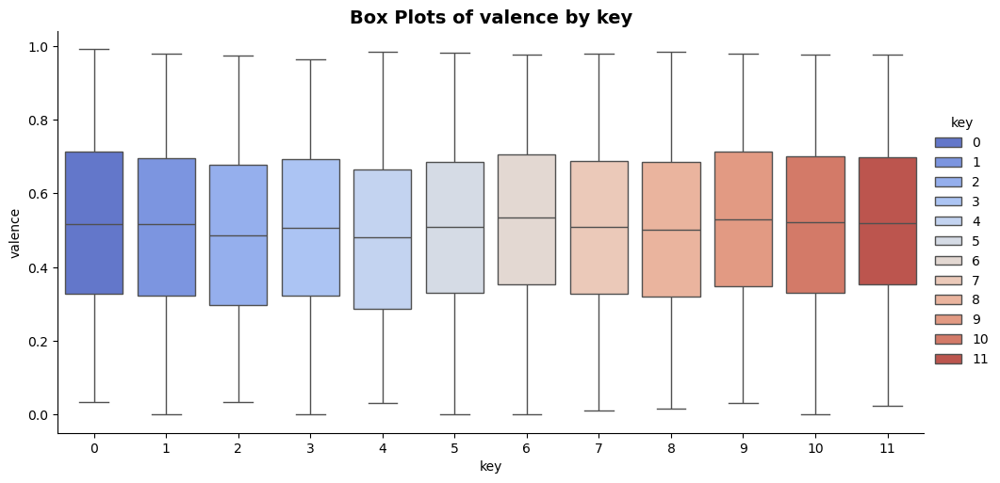

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


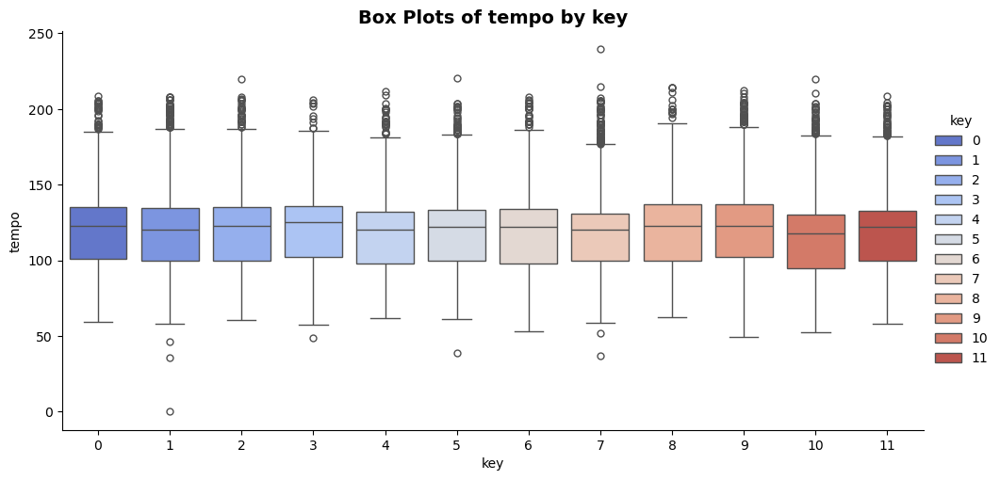

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


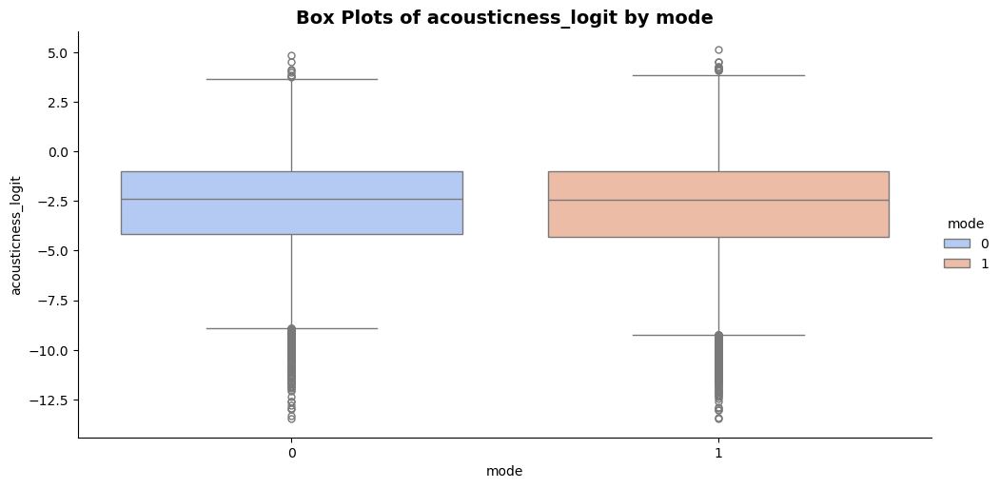

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


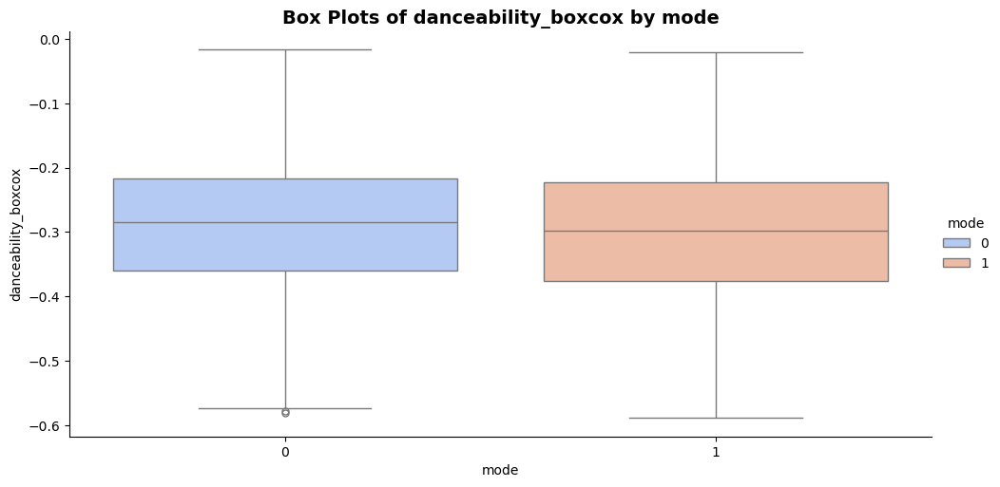

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


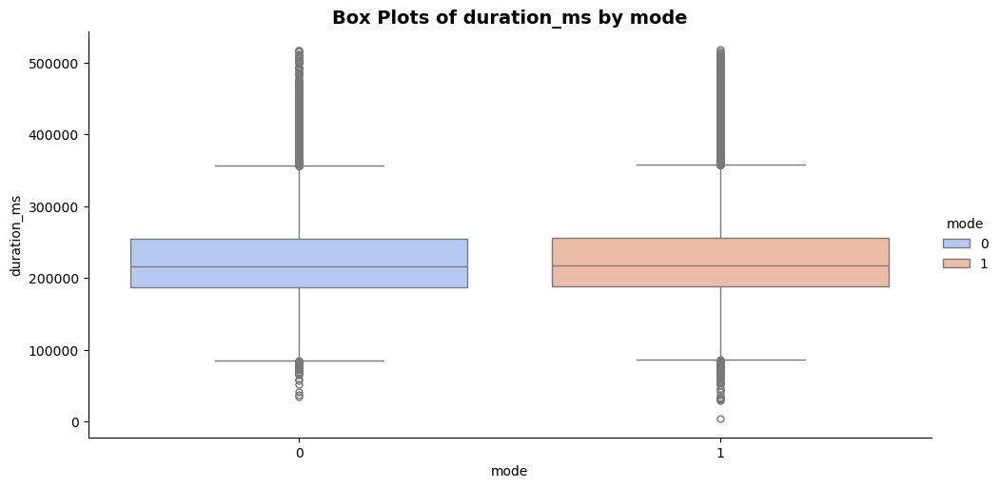

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


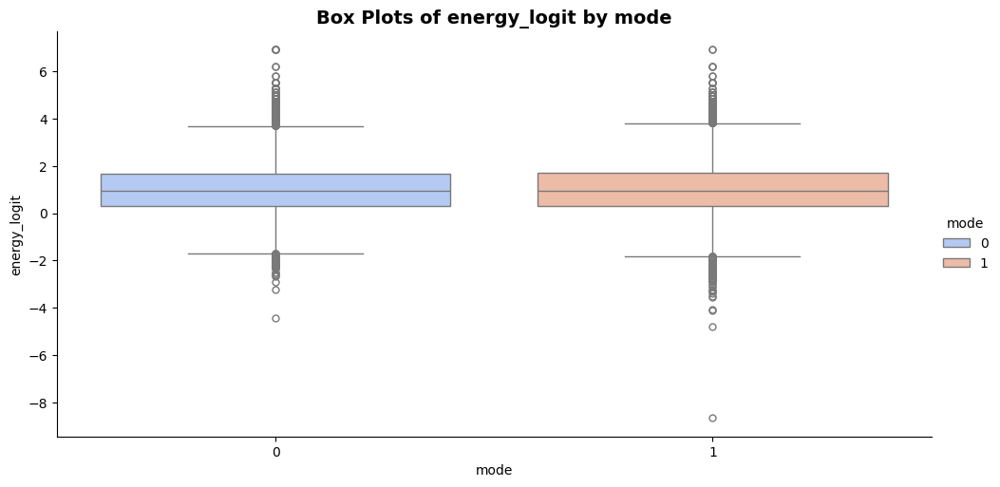

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


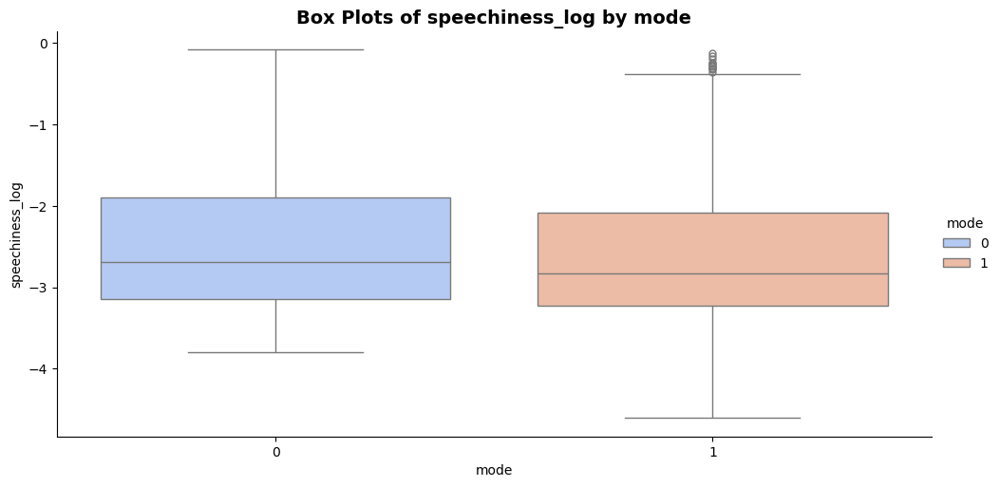

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


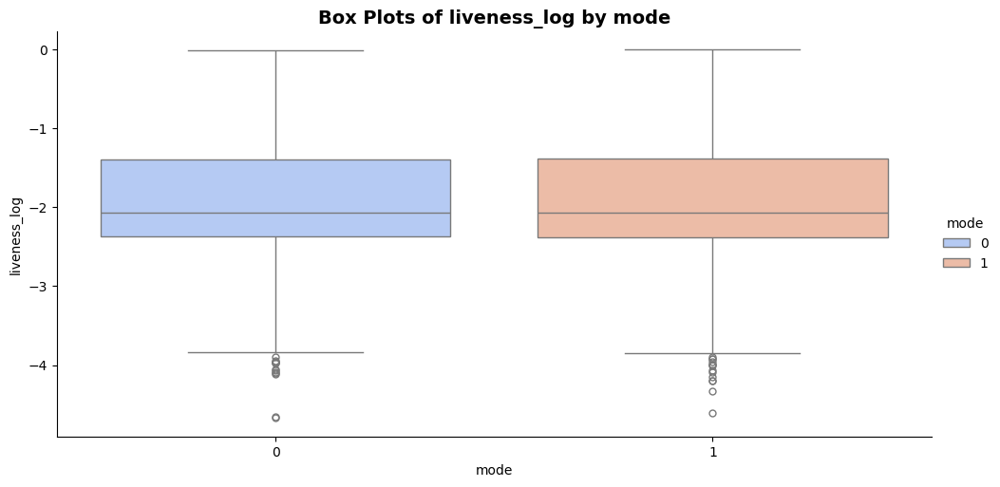

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


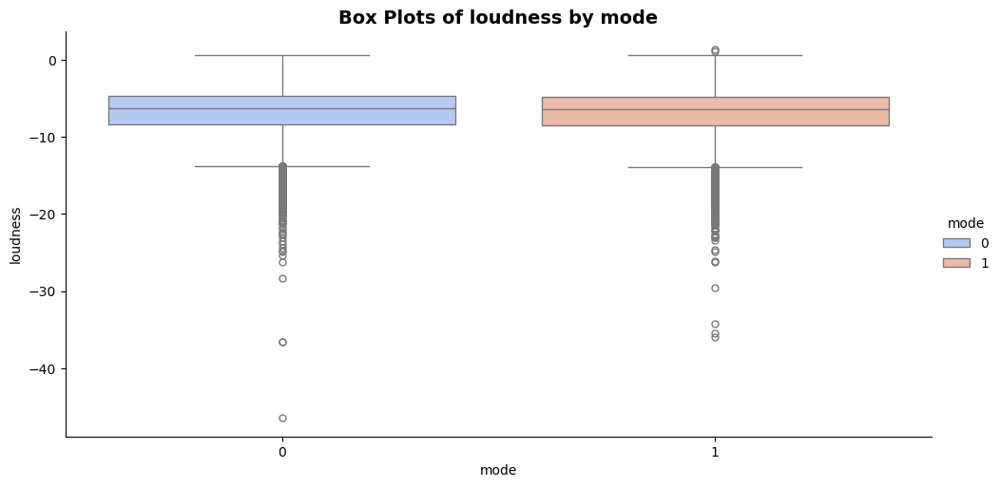

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


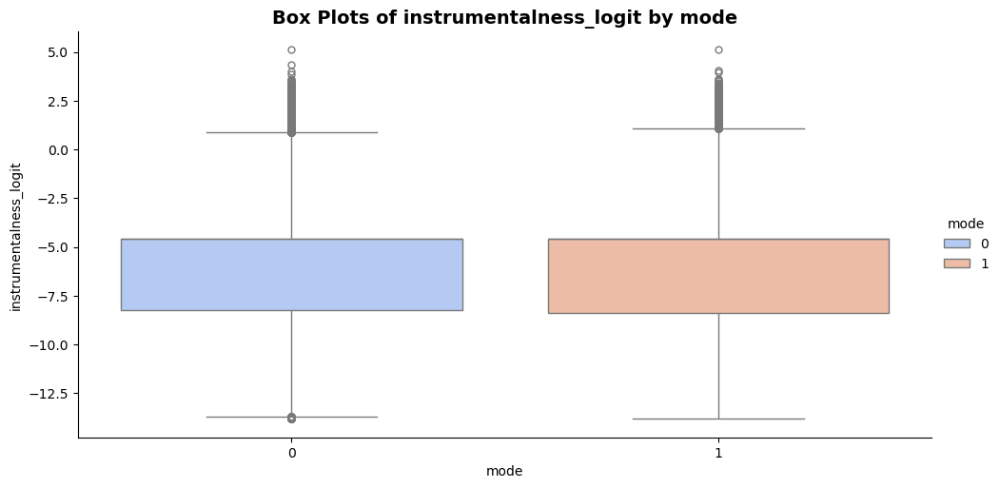

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


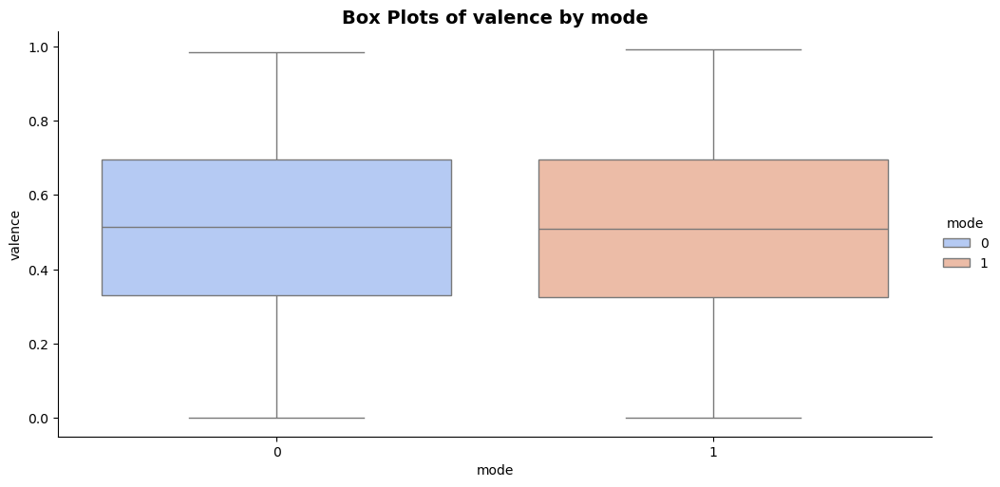

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


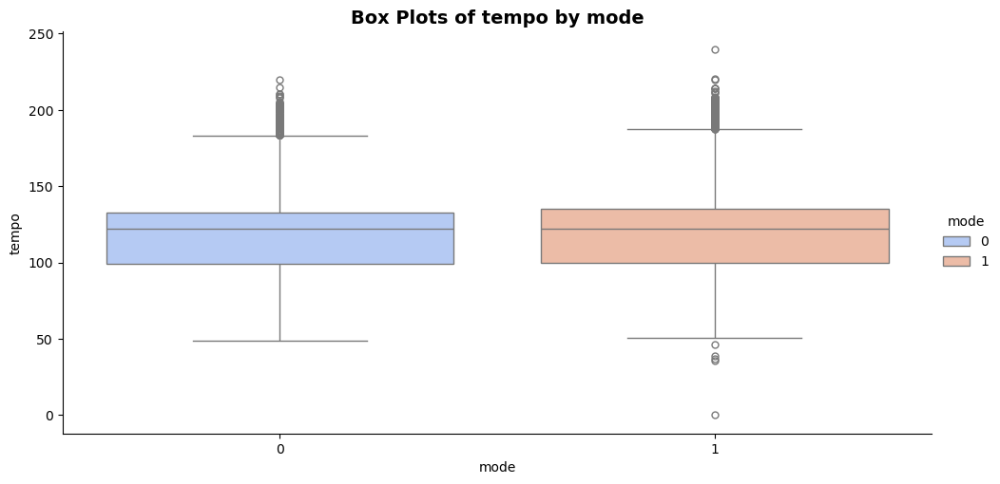

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


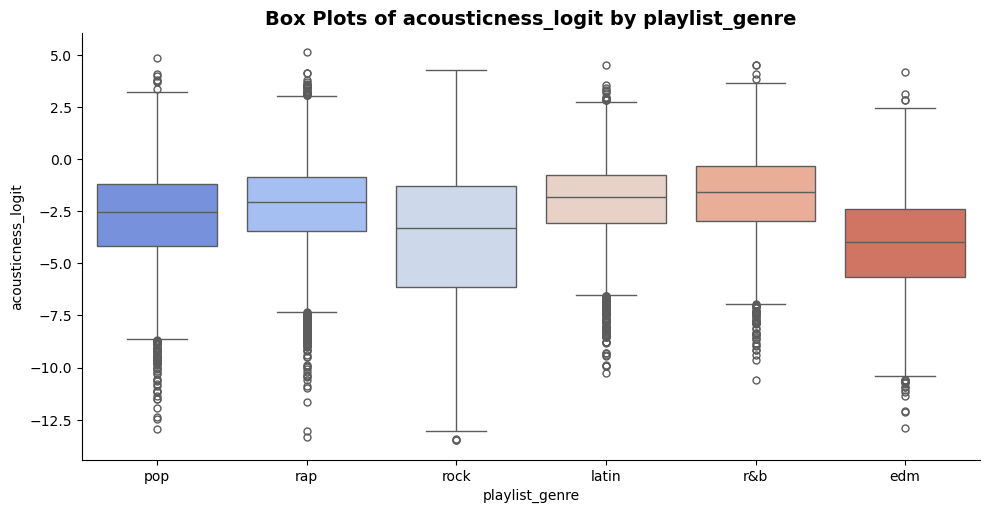

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


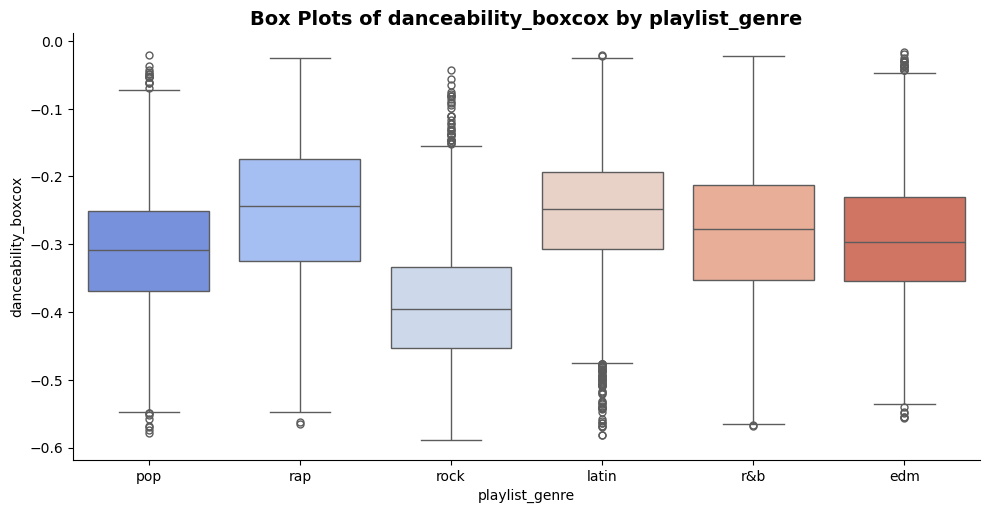

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


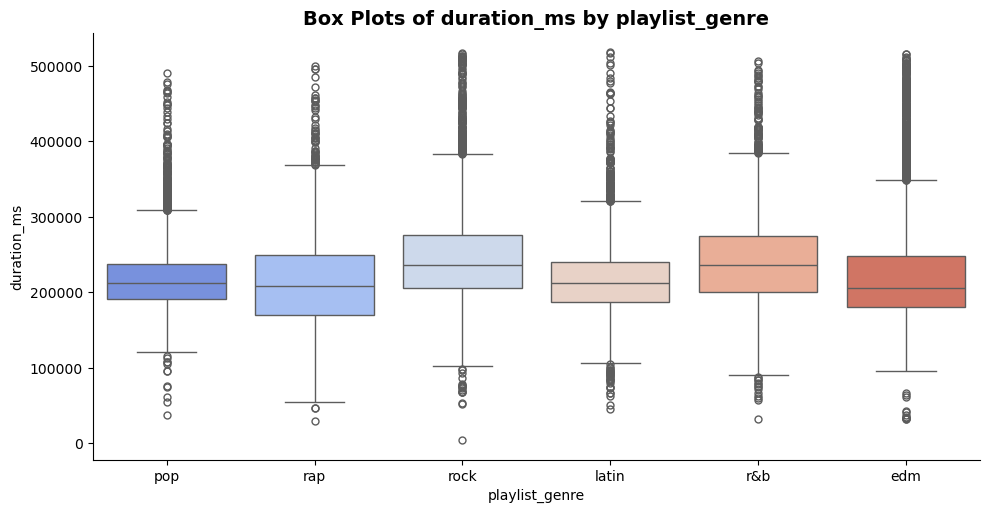

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


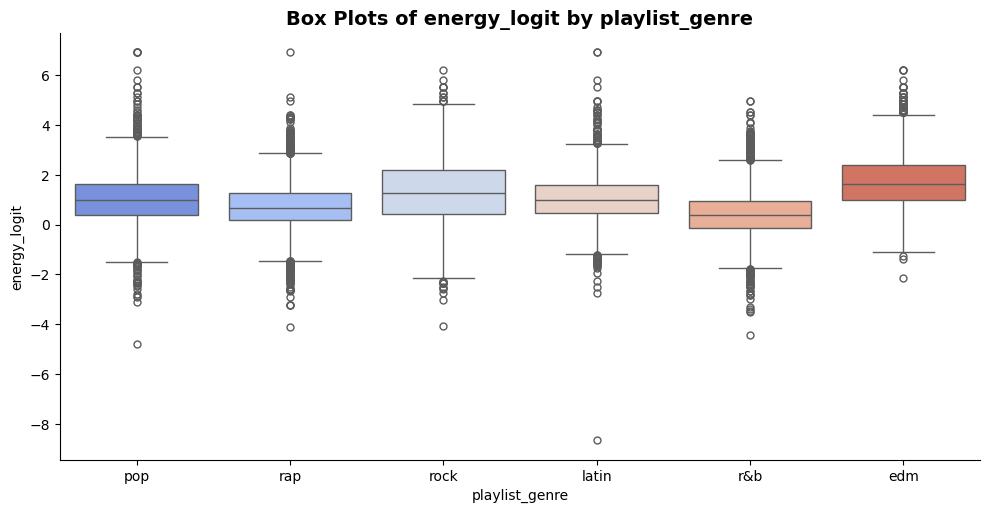

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


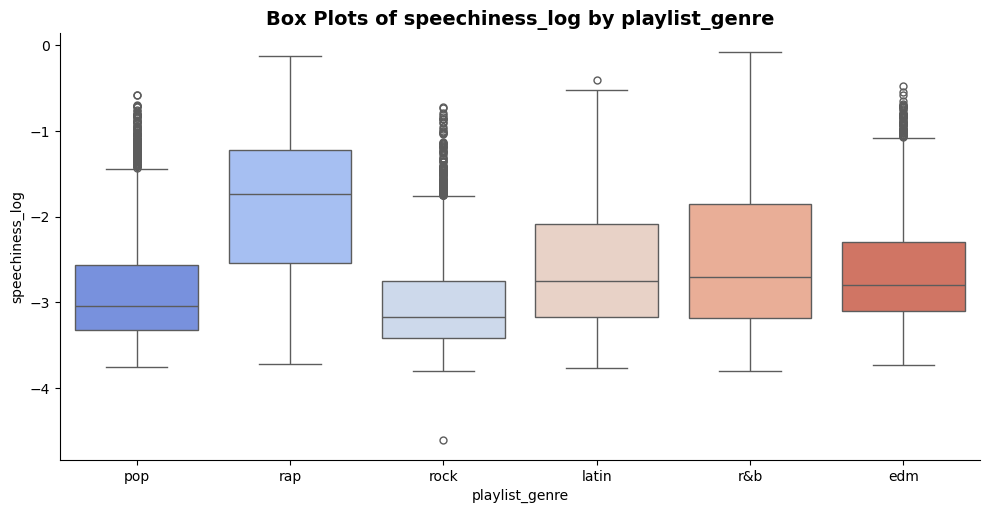

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


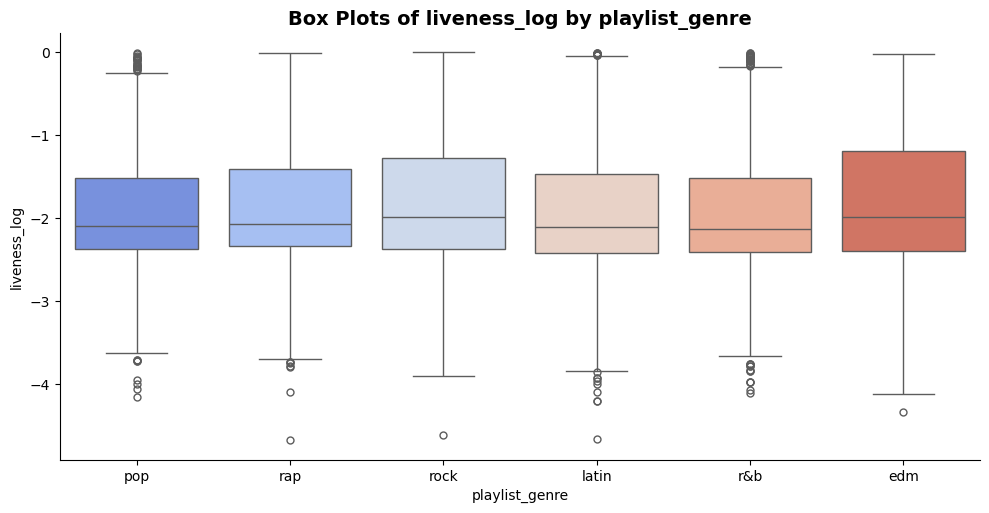

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


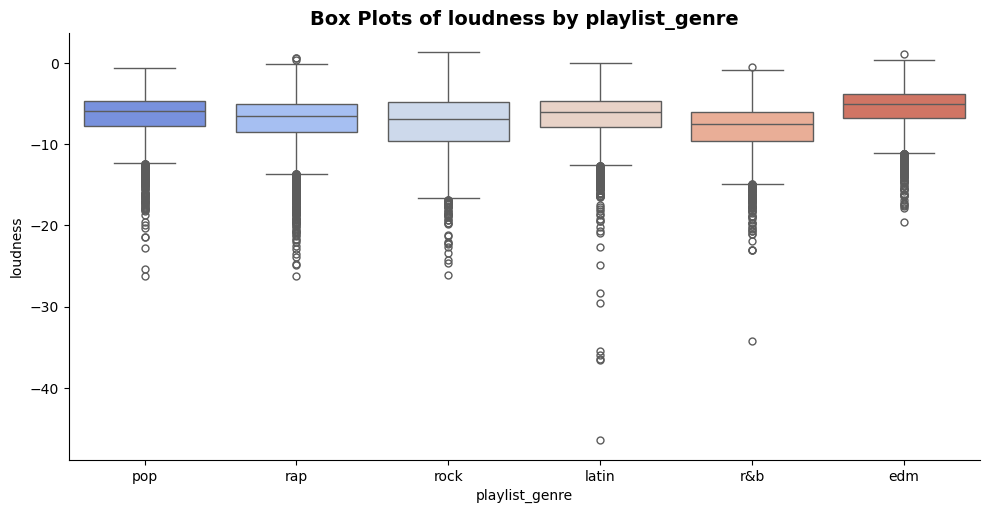

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


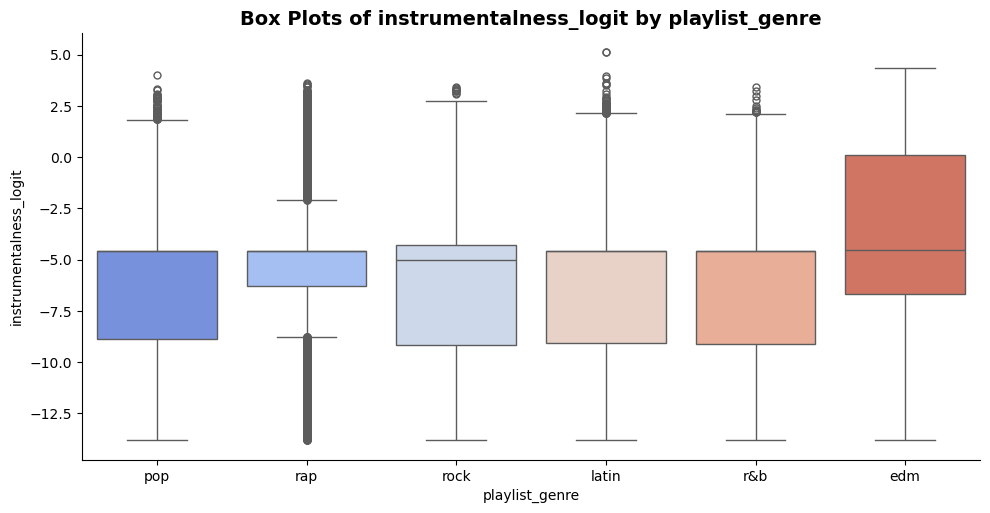

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


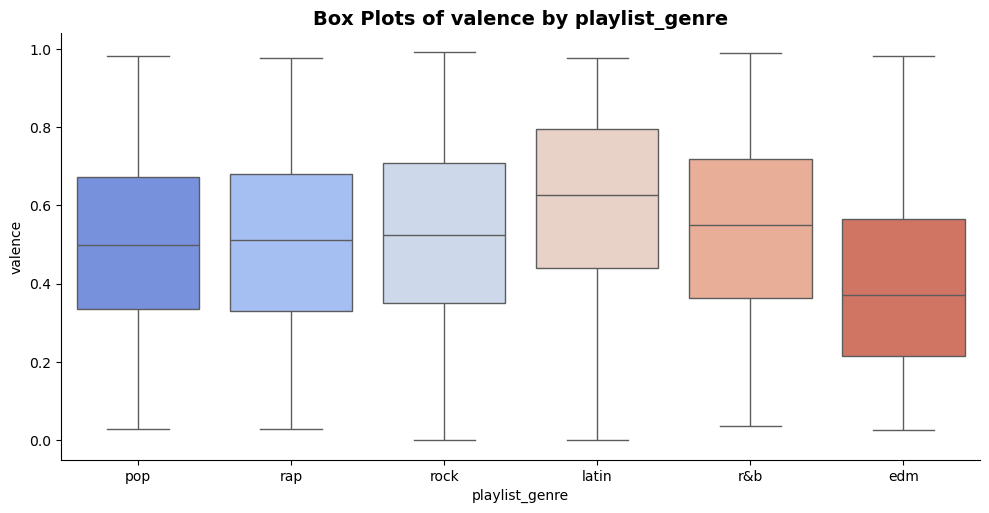

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


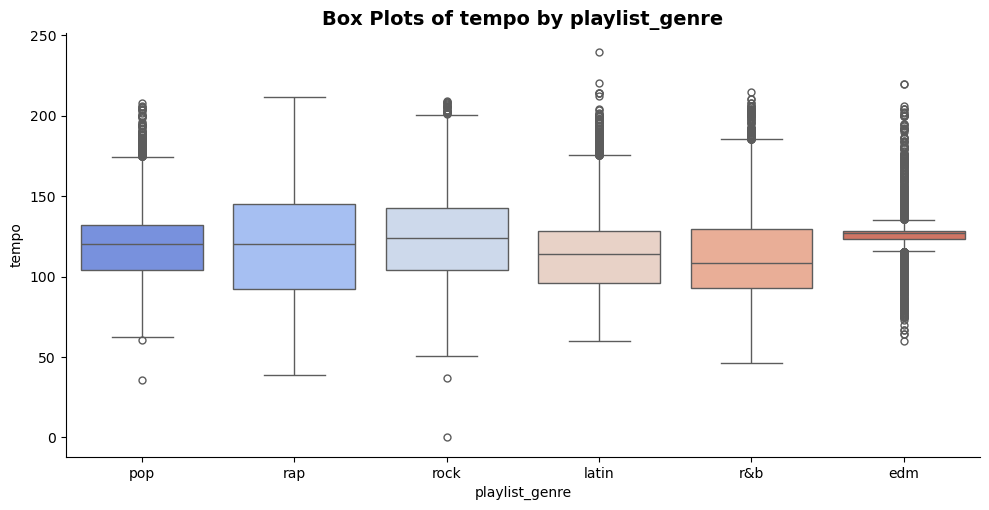

In [89]:
for var2 in x_cats:
    for var in x_nums_with_std:
        sns.catplot(data=spotify_df_t, x=var2, y=var, kind="box", hue=var2, palette="coolwarm", aspect=2)
        if var2 == "mostcom_playlistsubgenre":
            # Set x-axis labels to be horizontal
            plt.xticks(rotation=45)
        plt.title("Box Plots of %s by %s" % (var, var2), fontsize=14, fontweight="bold")
        plt.show()

Violin Plots

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


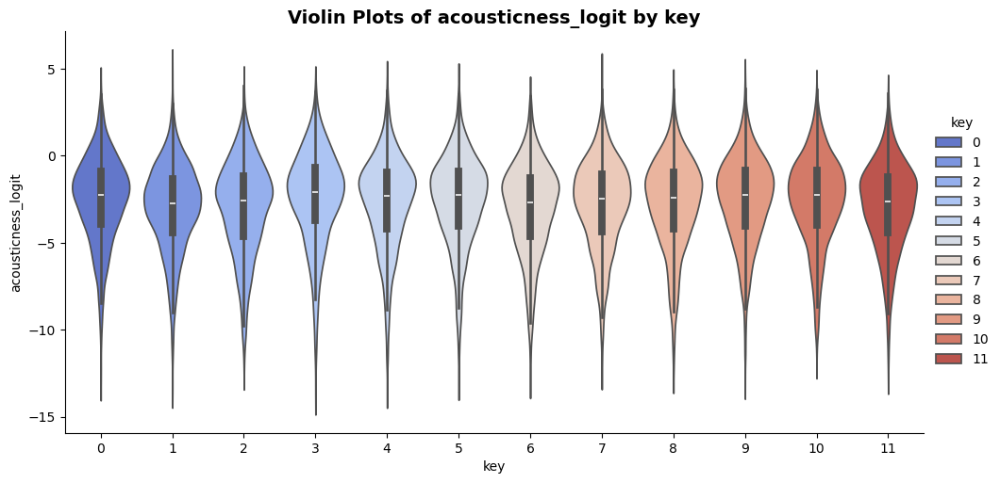

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


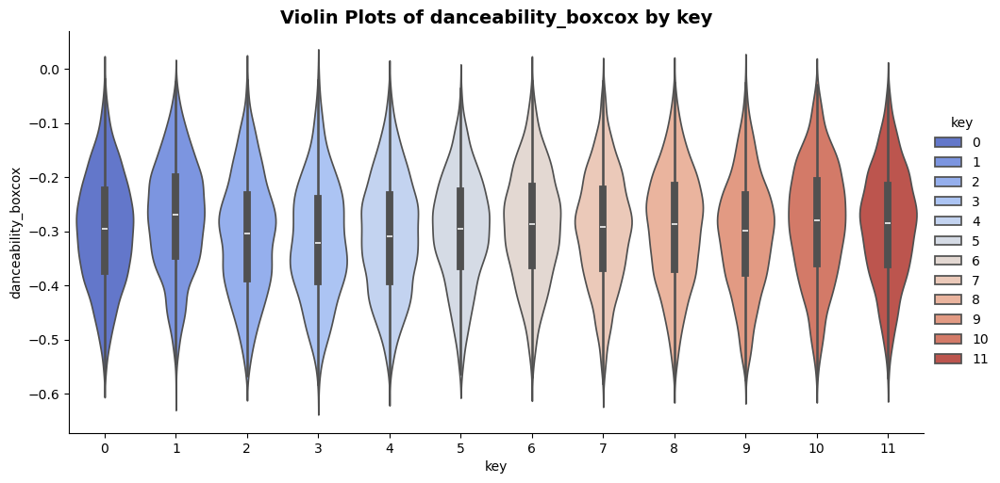

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


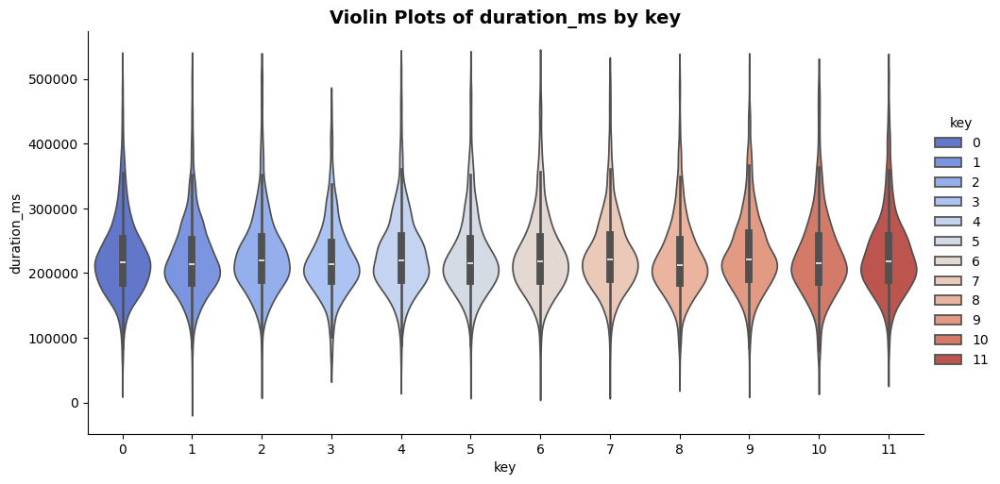

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


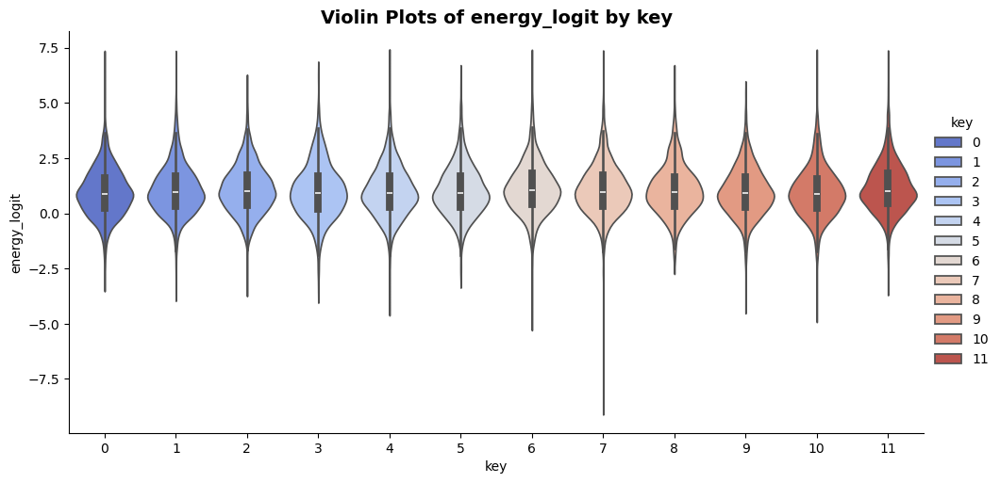

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


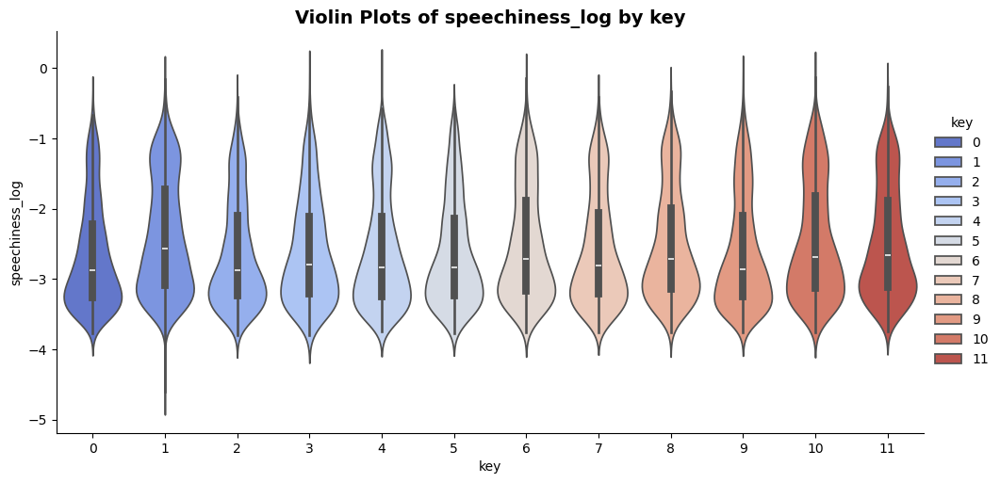

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


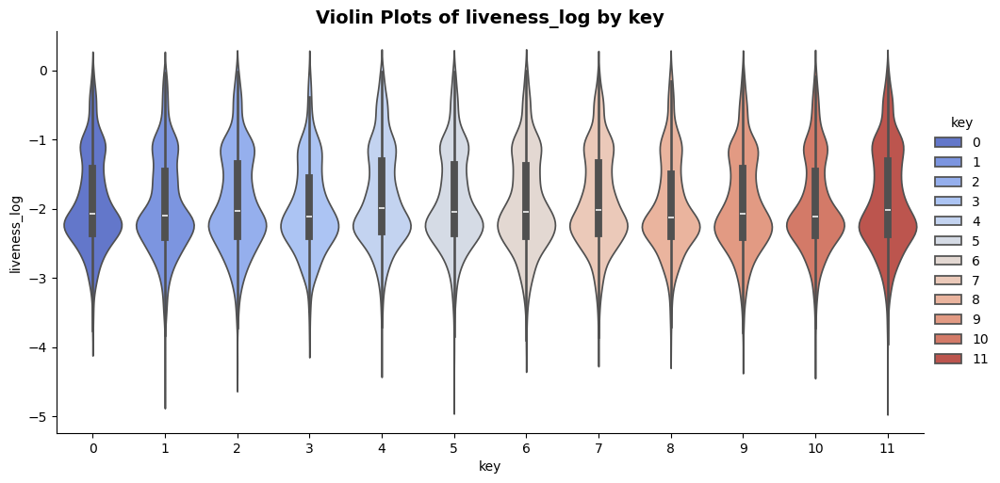

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


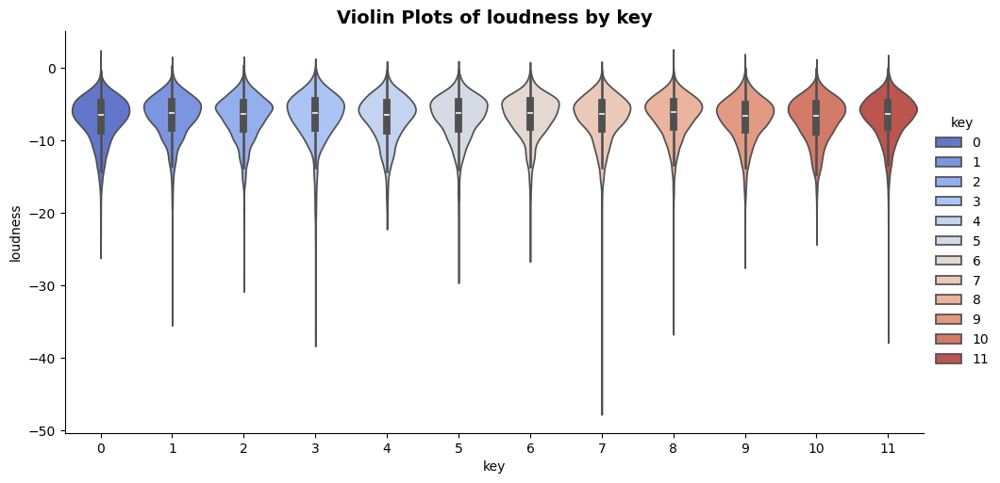

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


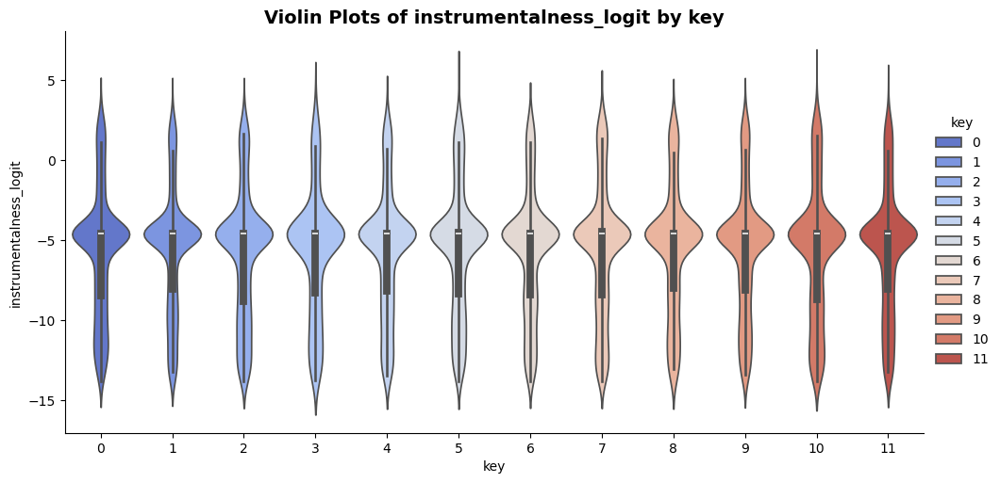

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


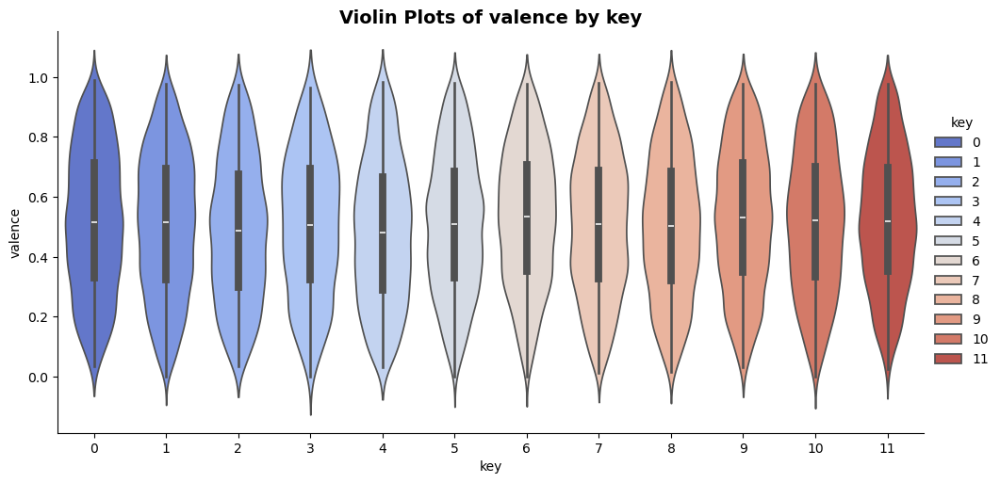

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


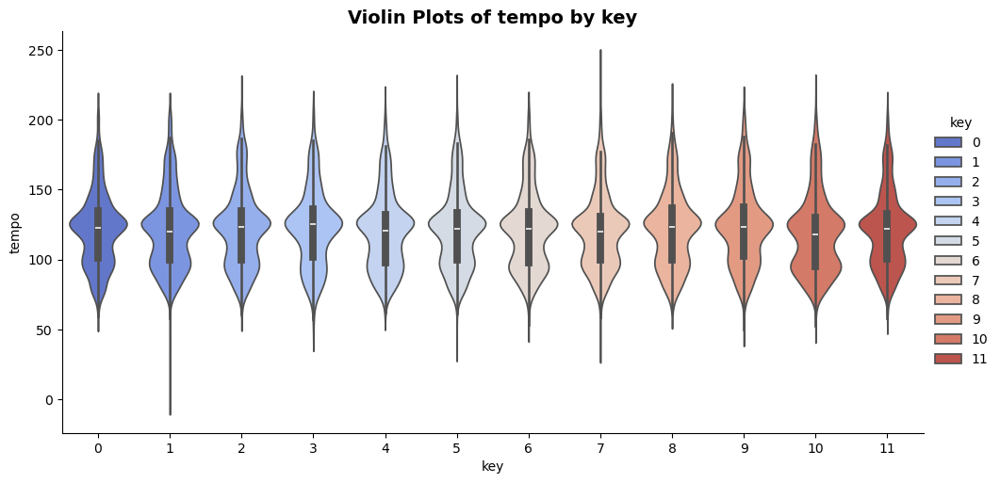

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


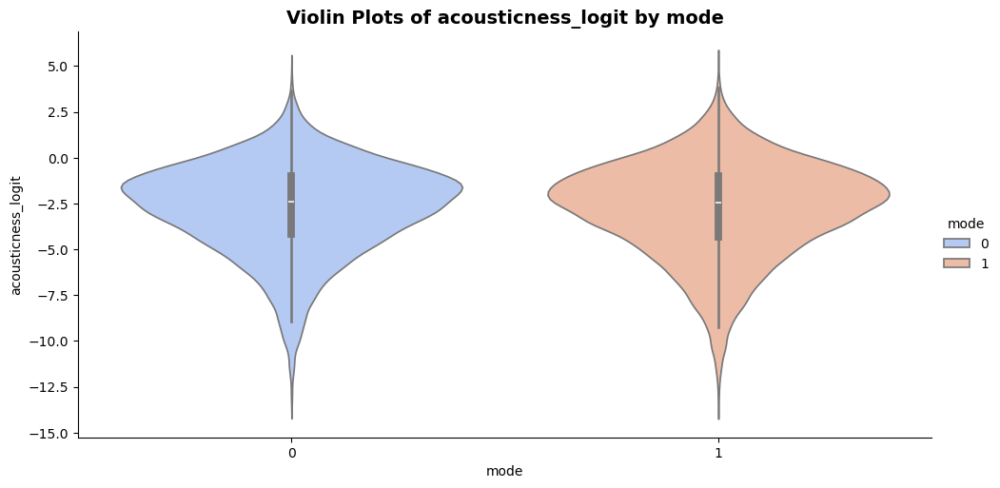

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


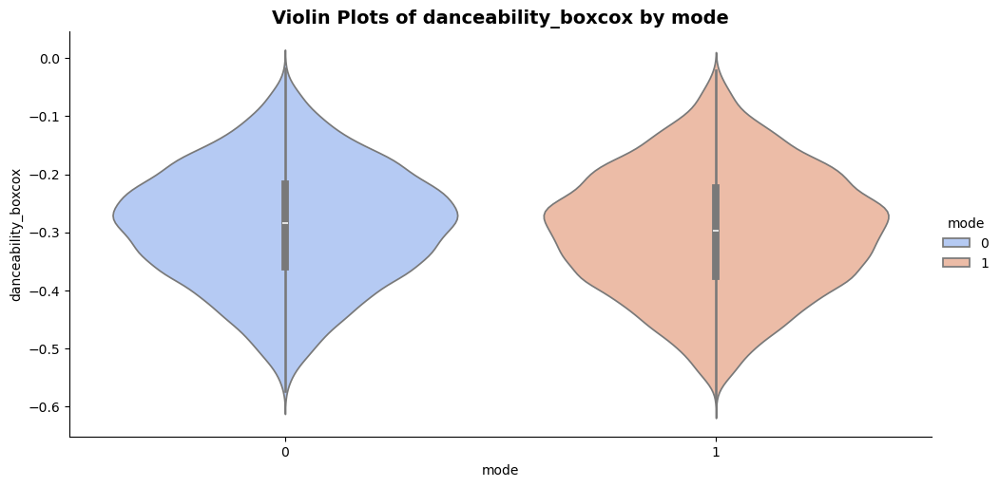

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


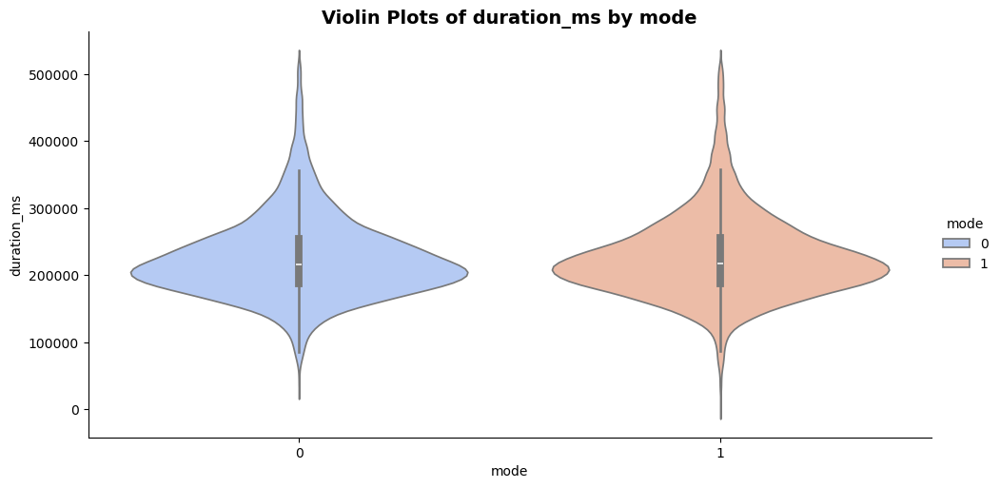

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


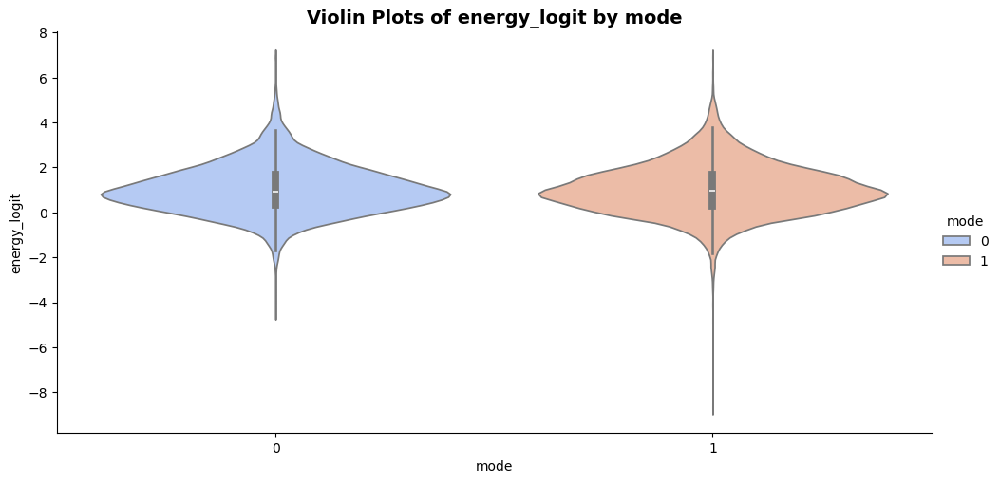

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


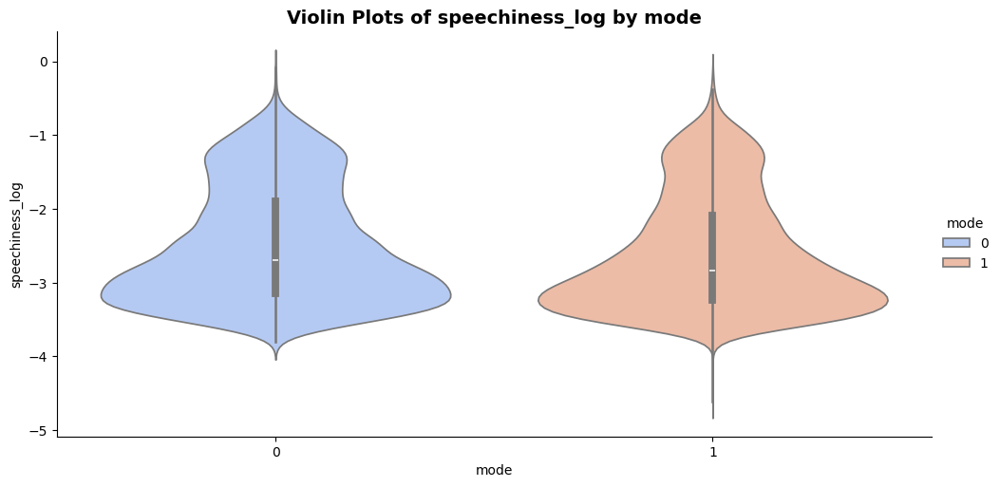

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


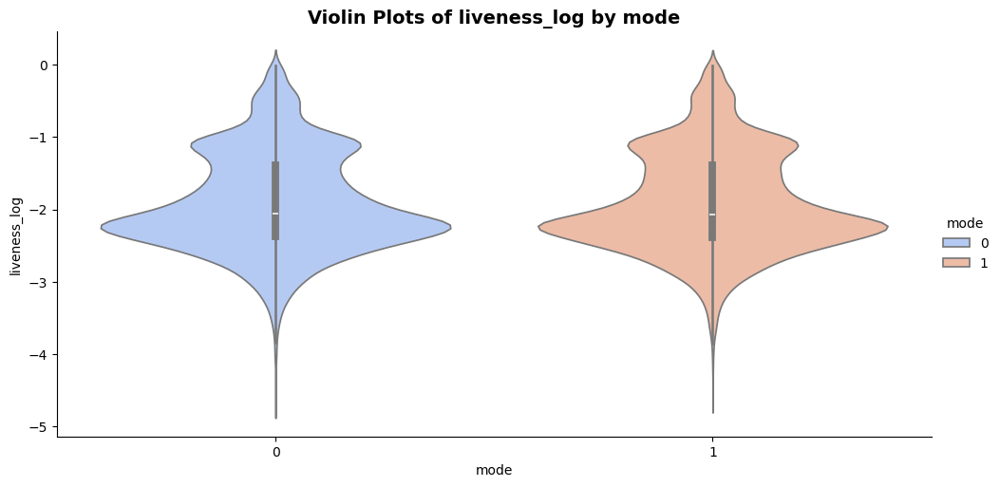

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


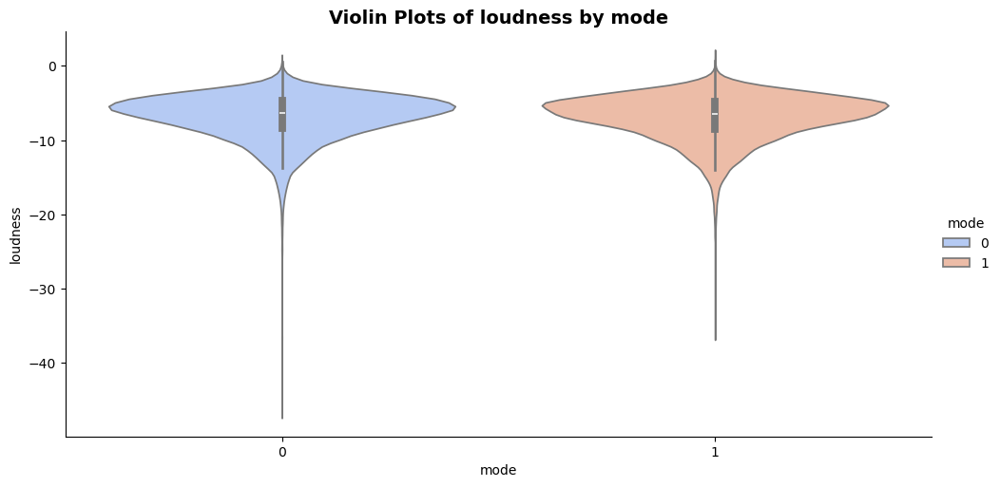

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


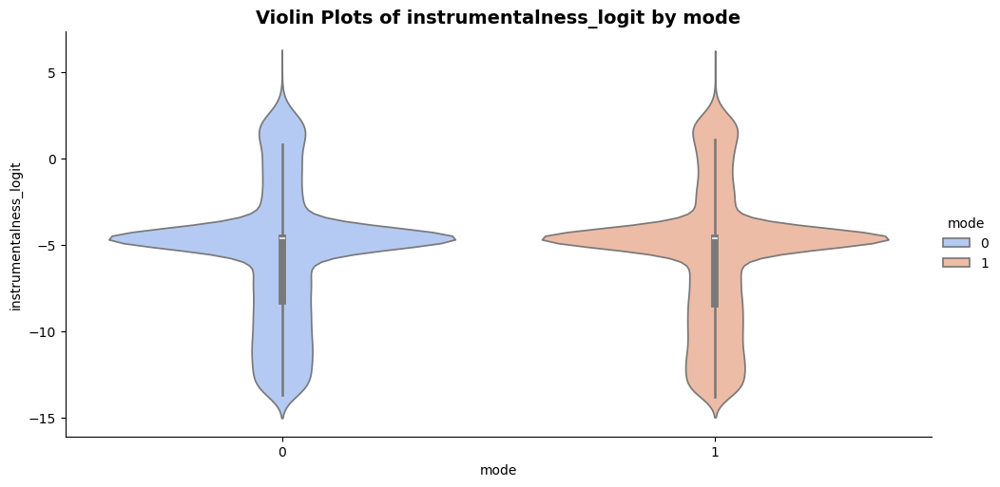

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


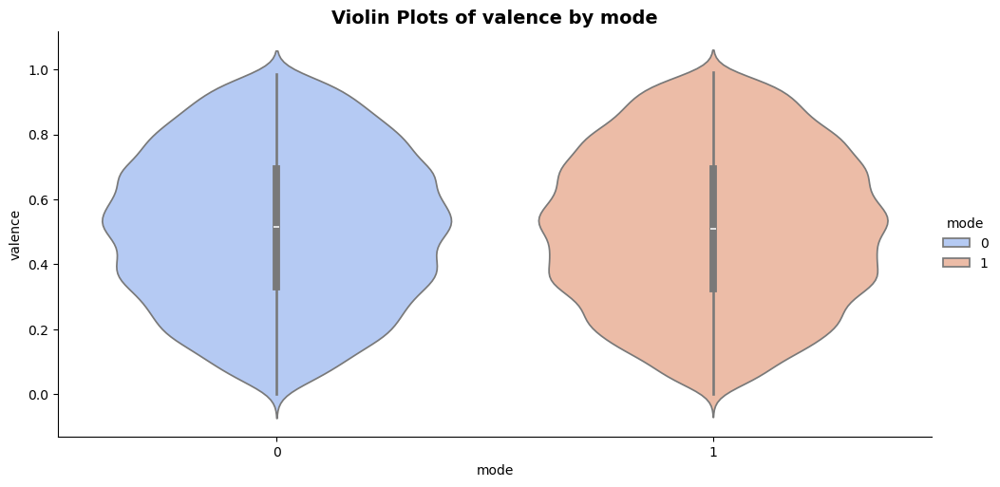

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


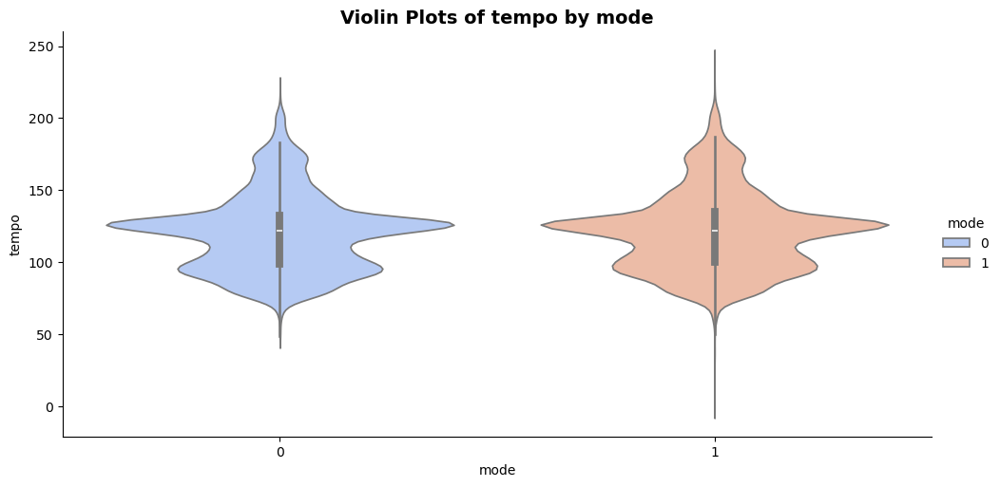

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


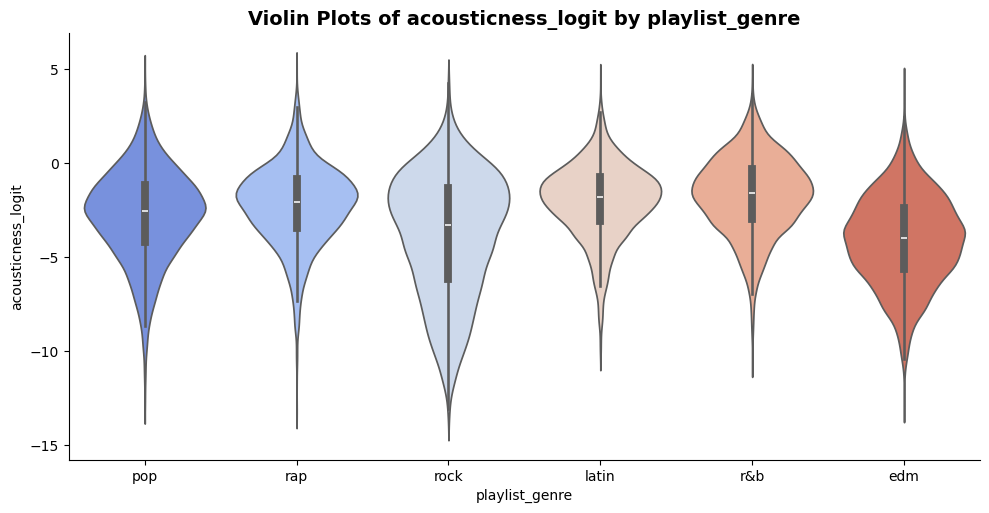

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


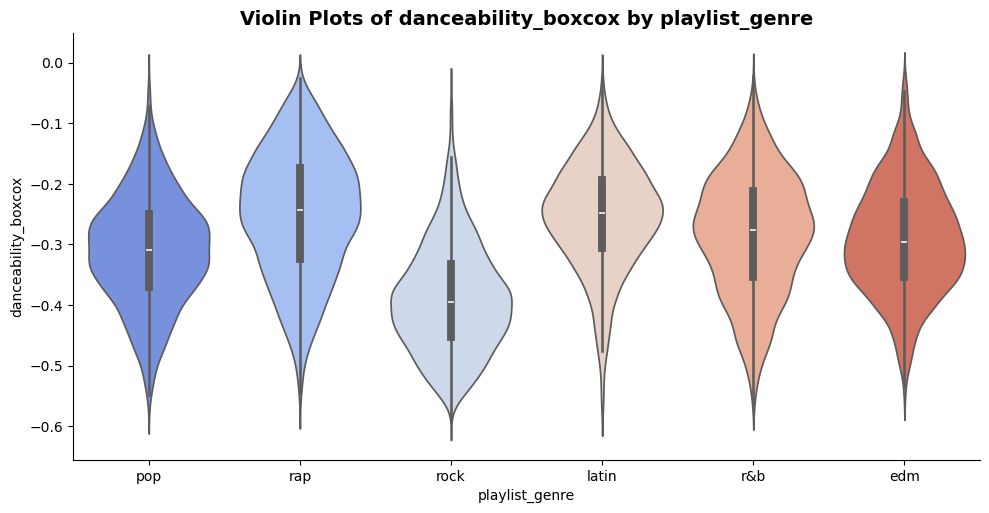

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


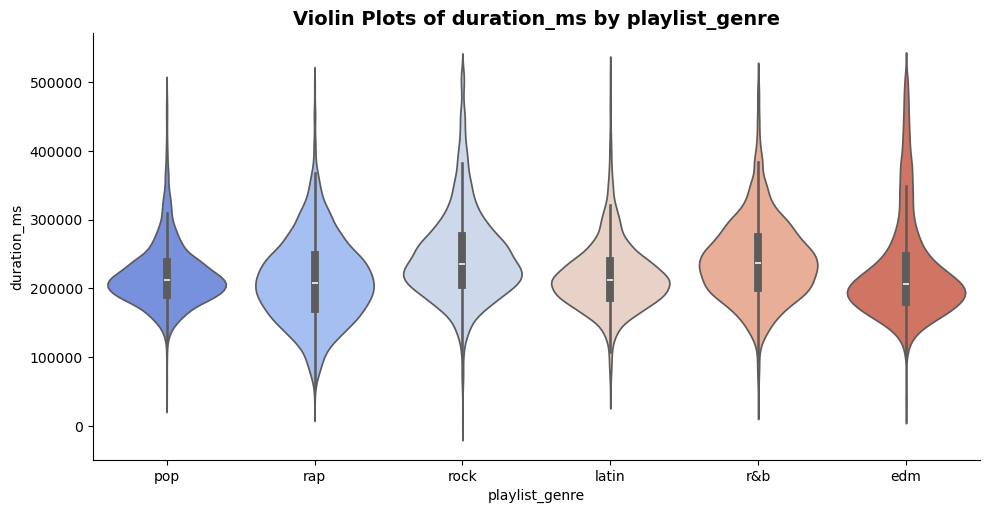

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


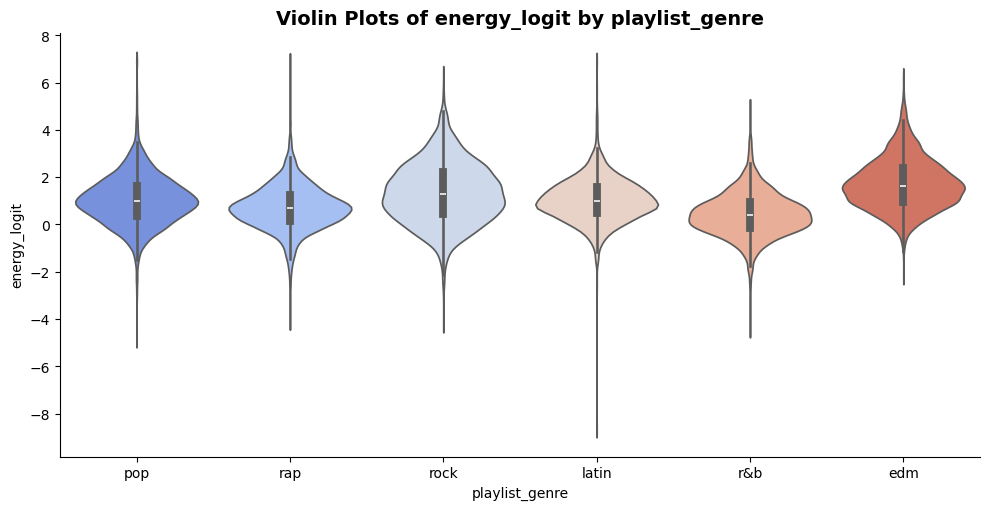

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


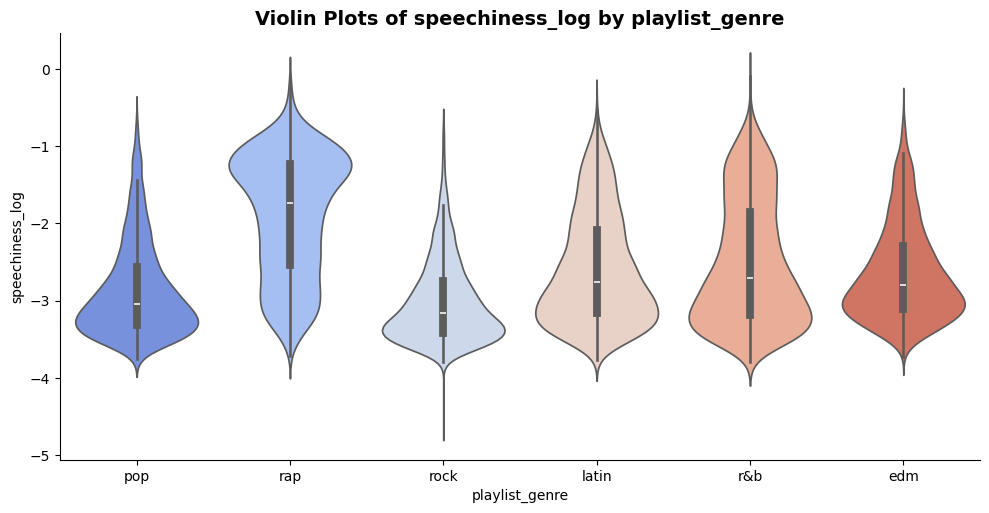

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


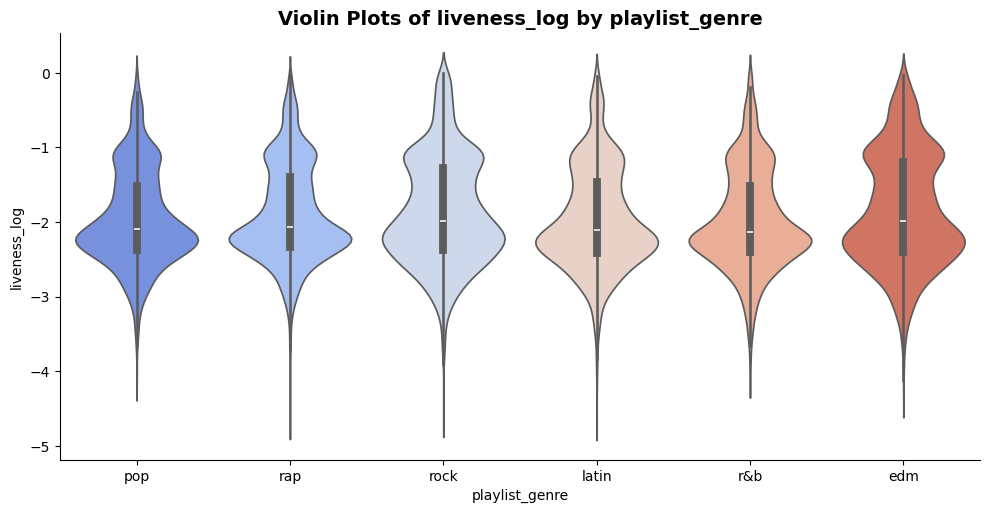

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


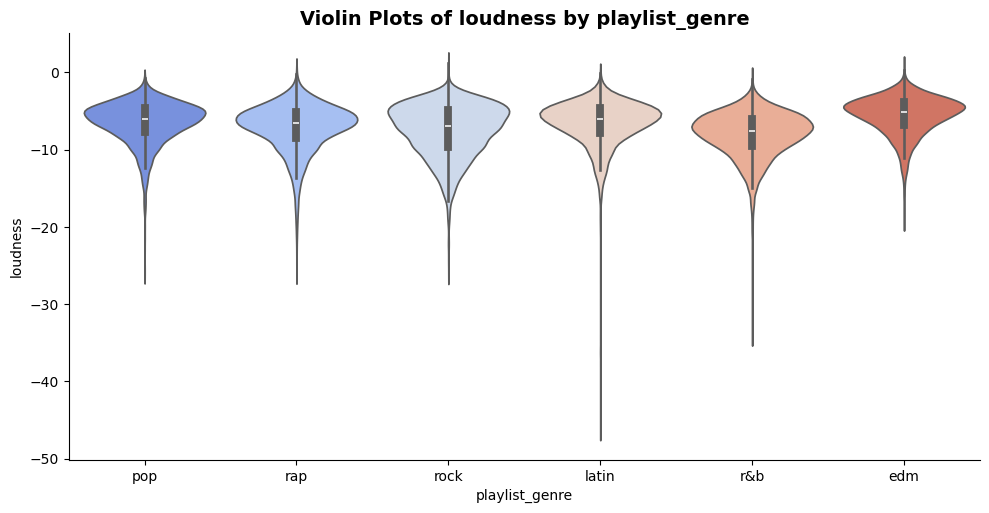

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


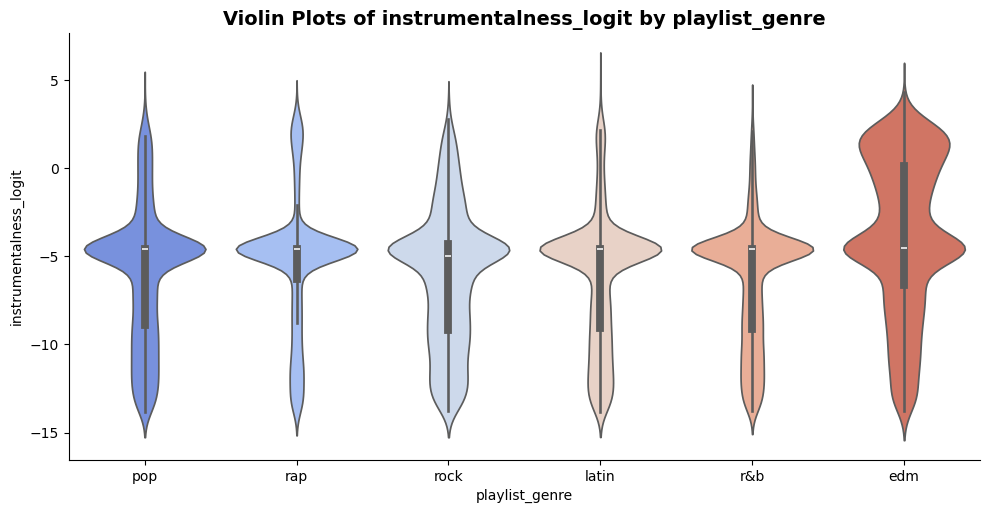

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


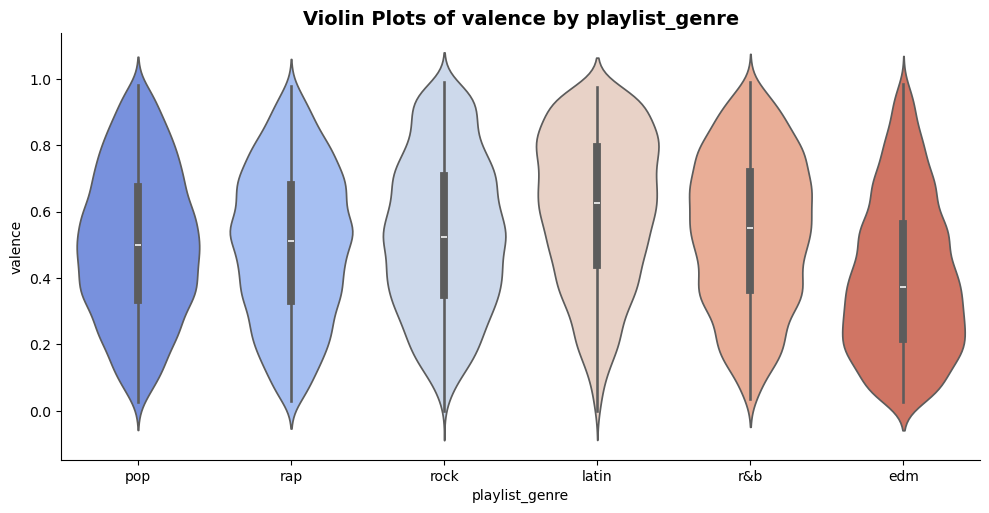

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


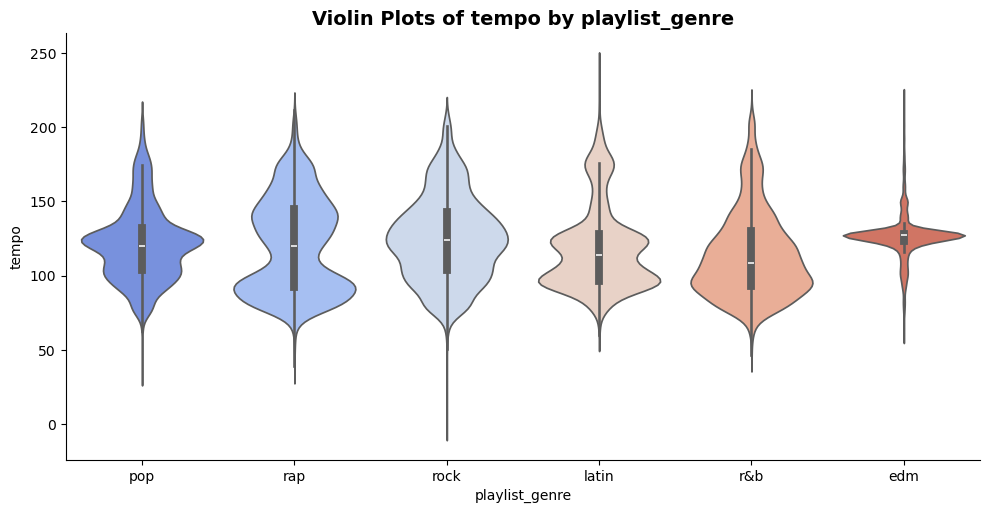

In [90]:
for var2 in x_cats:
    for var in x_nums_with_std:
        sns.catplot(data=spotify_df_t, x=var2, y=var, kind="violin", hue=var2, palette="coolwarm", aspect=2)
        if var2 == "mostcom_playlistsubgenre":
            # Set x-axis labels to be horizontal
            plt.xticks(rotation=45)
        plt.title("Violin Plots of %s by %s" % (var, var2), fontsize=14, fontweight="bold")
        plt.show()

**7 - Visualize histograms and relationships between continuous inputs broken up by the outcome unique values.\
7 - Count the Number of Observations for Each Combination of Outcome and Categorical Variables**

KDE Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


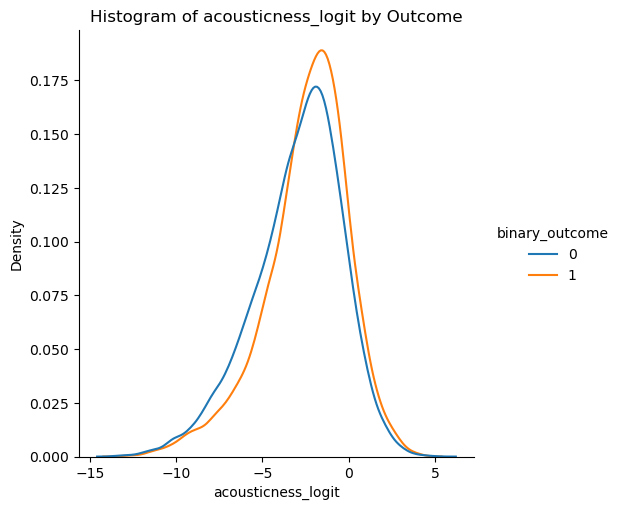

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


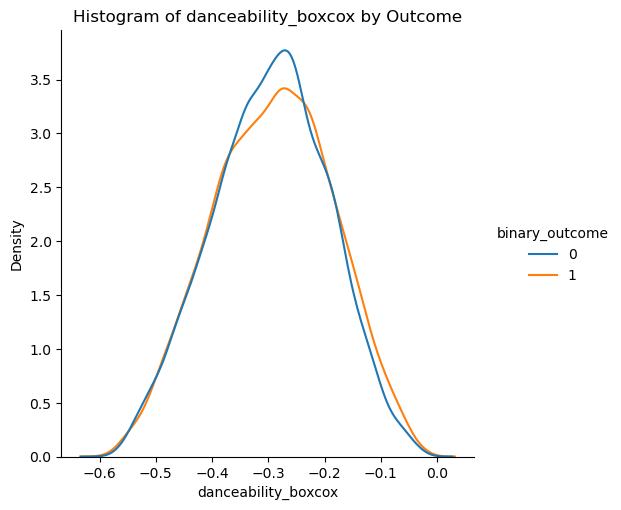

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


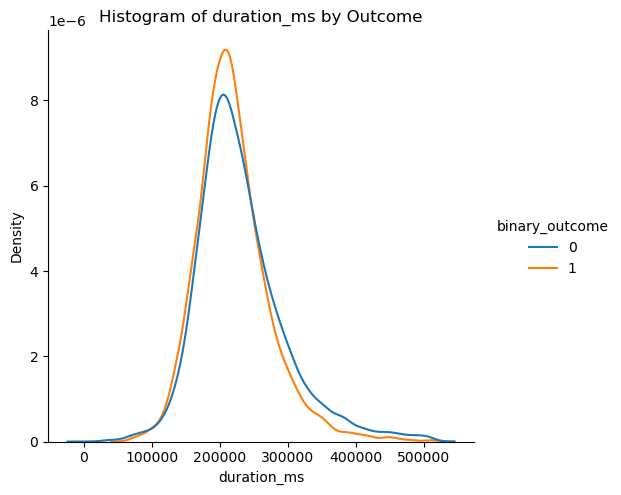

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


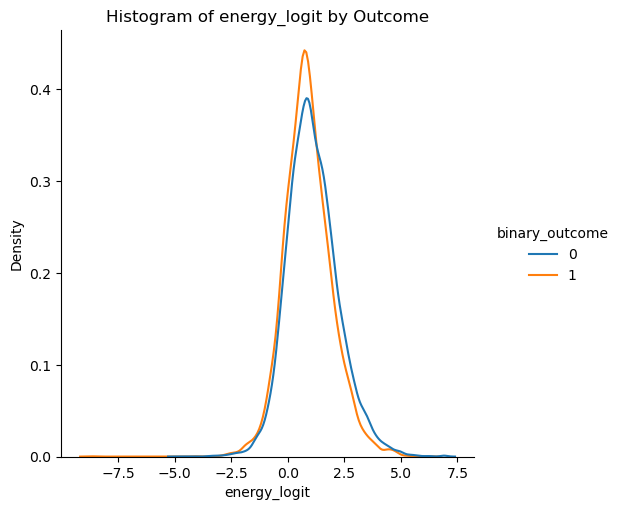

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


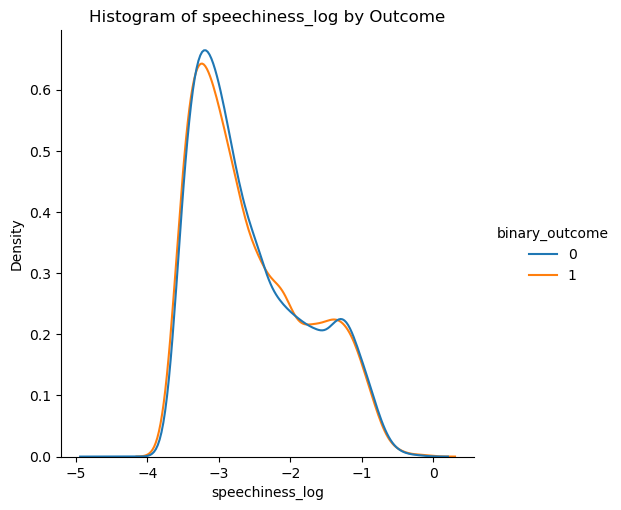

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


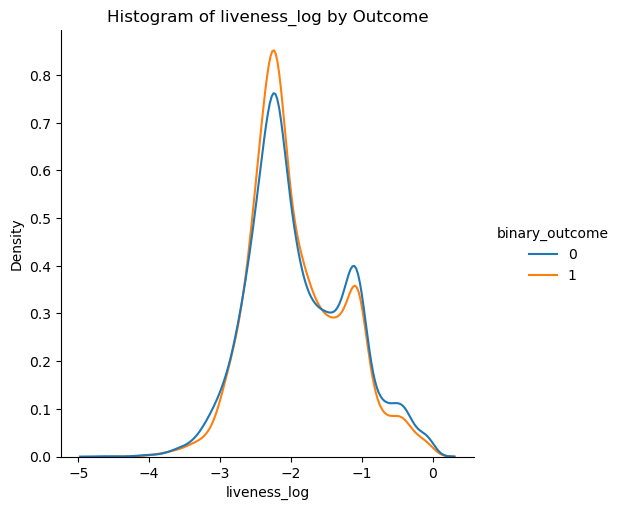

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


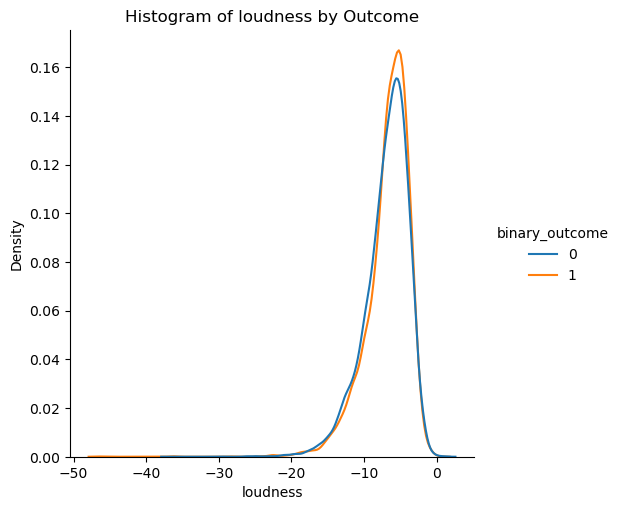

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


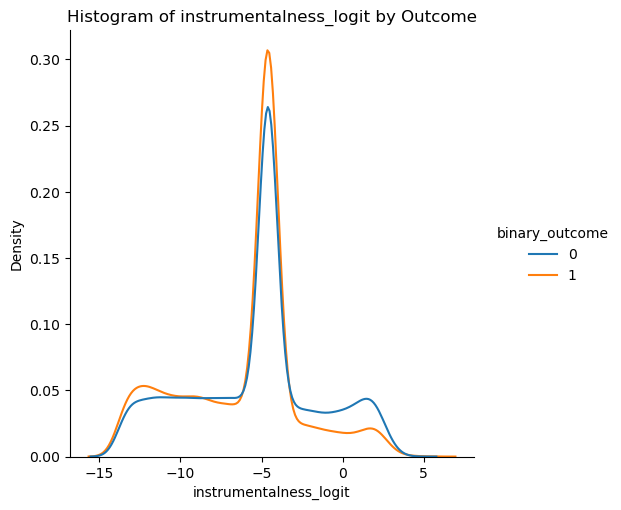

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


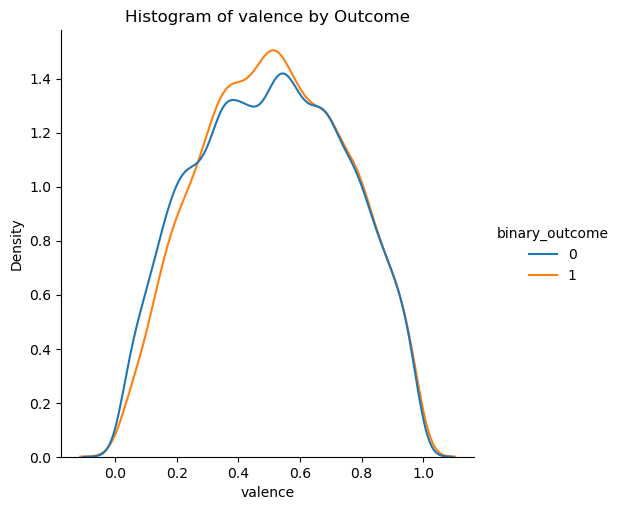

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


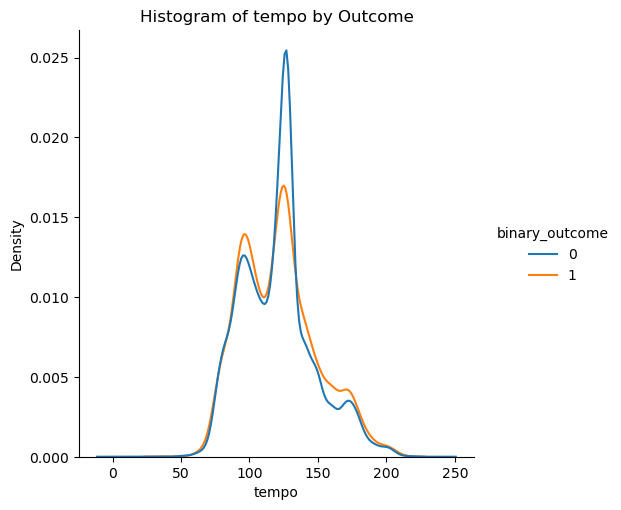

In [95]:
for var in x_nums_with_std:
    sns.displot(data=spotify_df_t, x=var, hue='binary_outcome', kind="kde", common_norm=False)
    plt.title("Histogram of "+ var + " by Outcome")
    plt.show()

Pairs Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


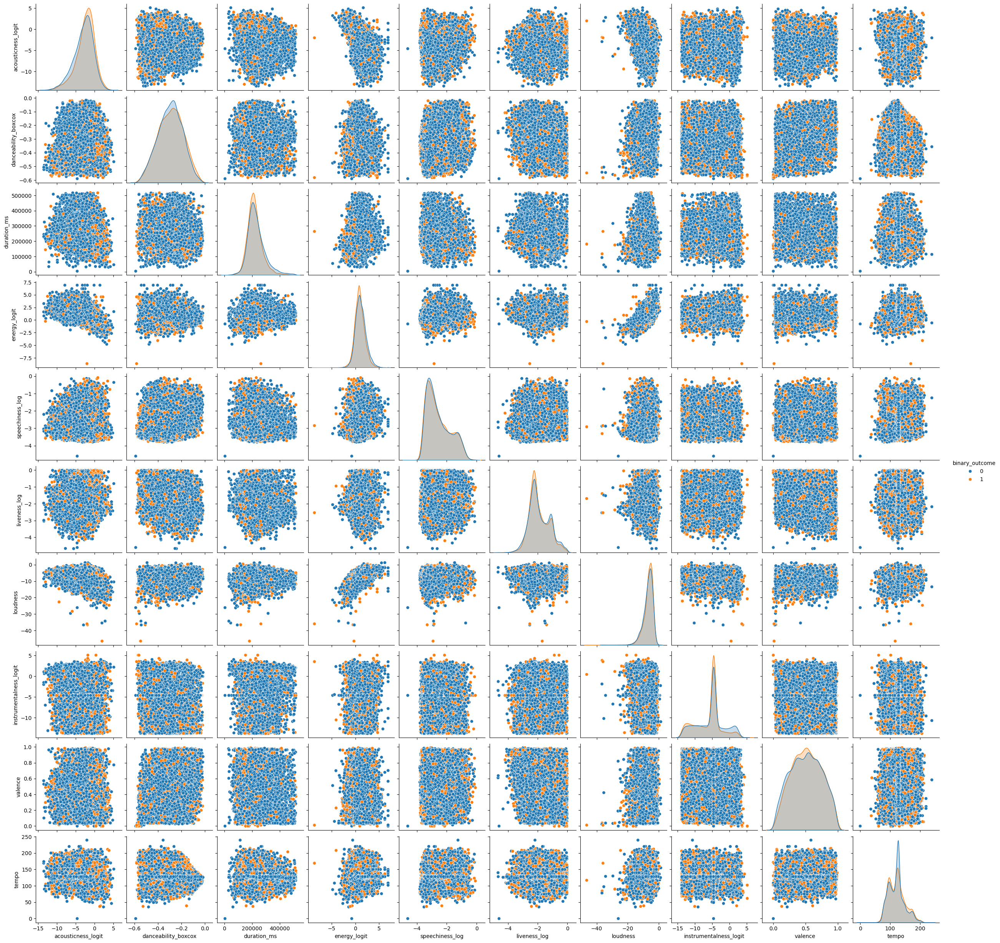

In [96]:
sns.pairplot(data=spotify_df_t.loc[:, ["binary_outcome"]+ x_nums_with_std], hue="binary_outcome", diag_kind="kde", diag_kws={"common_norm": False})

plt.show()

Boxplots of Continous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


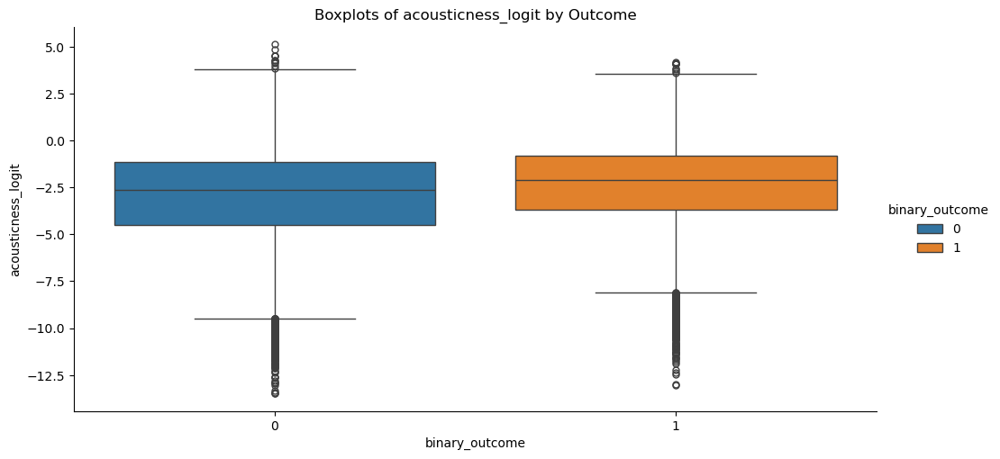

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


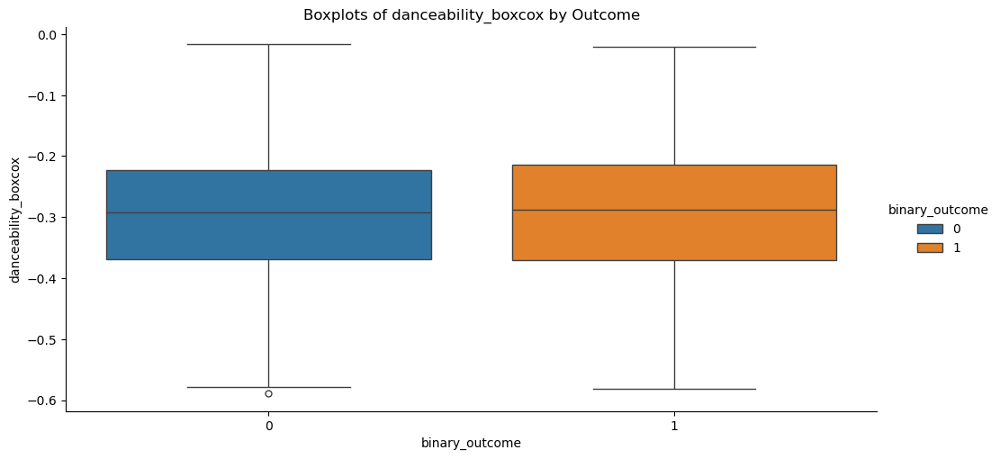

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


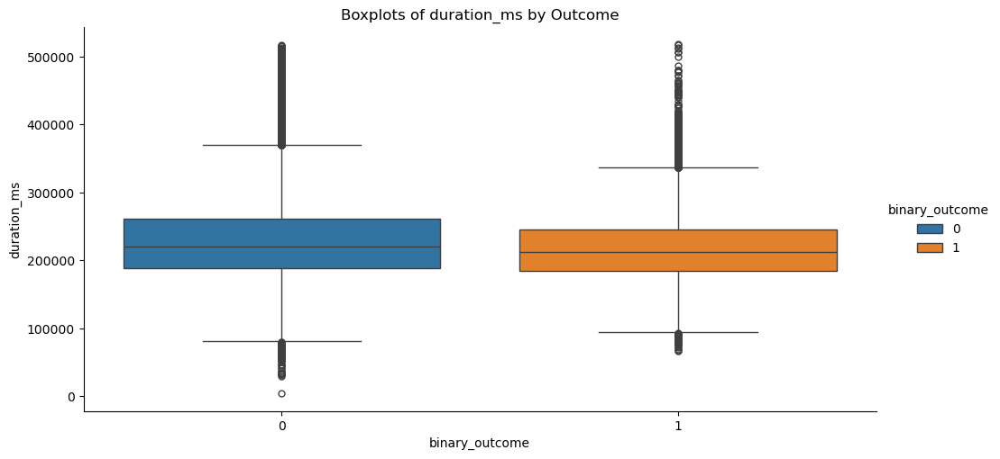

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


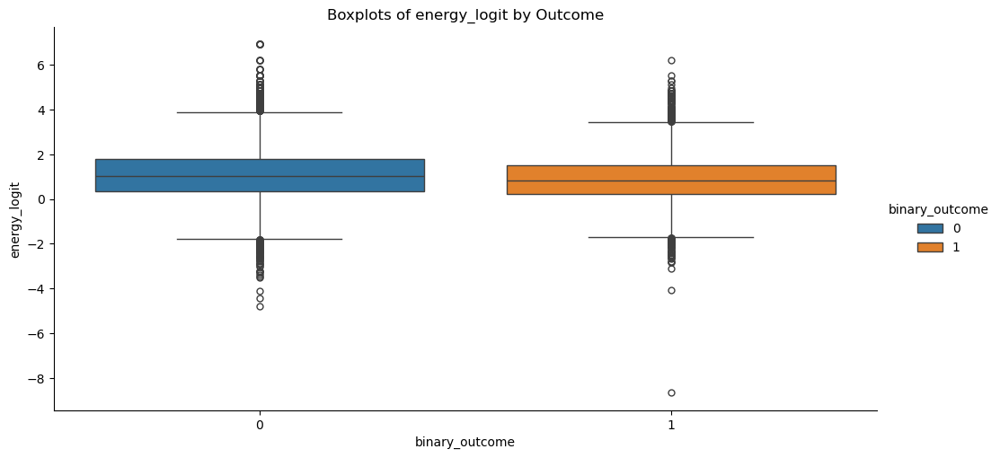

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


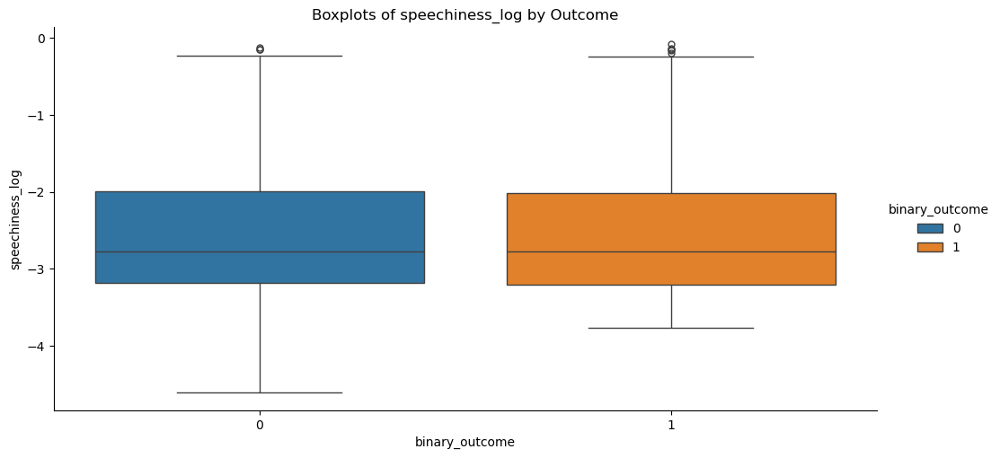

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


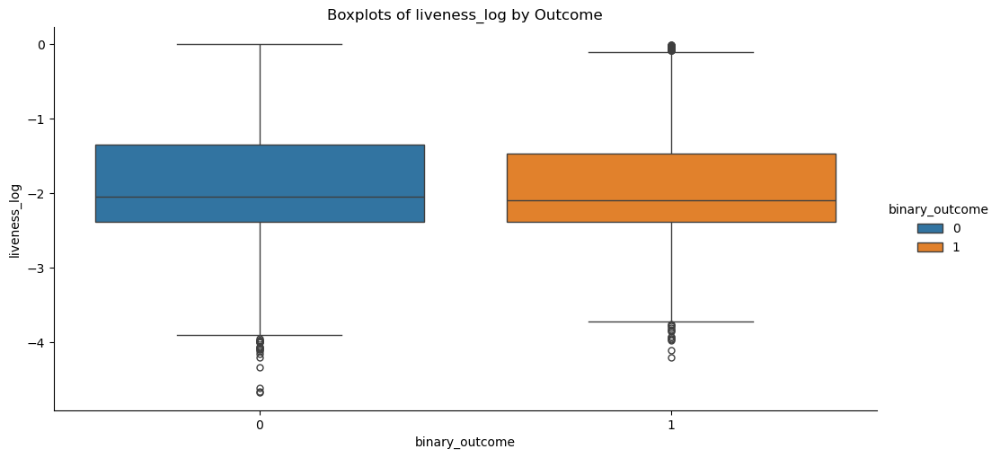

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


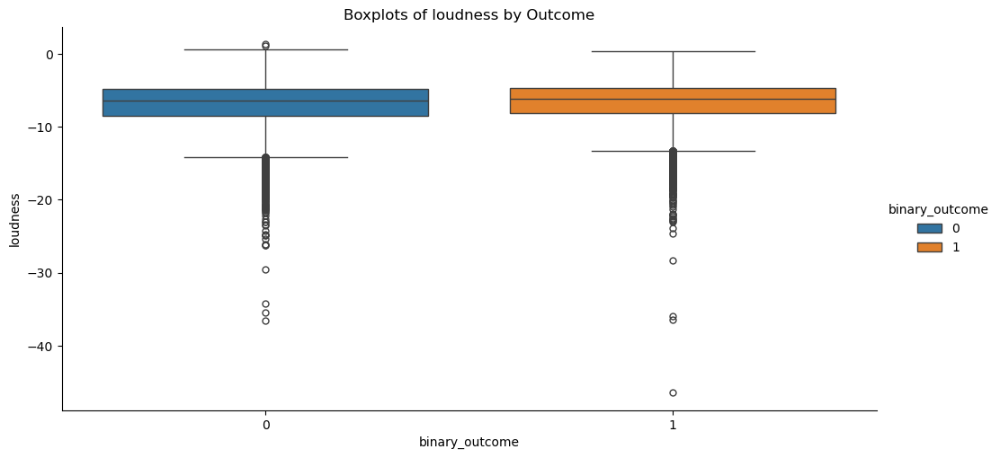

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


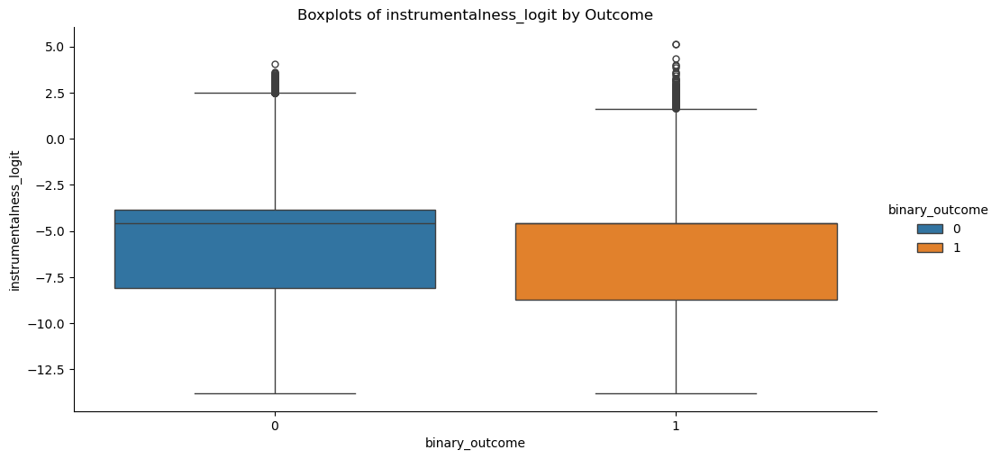

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


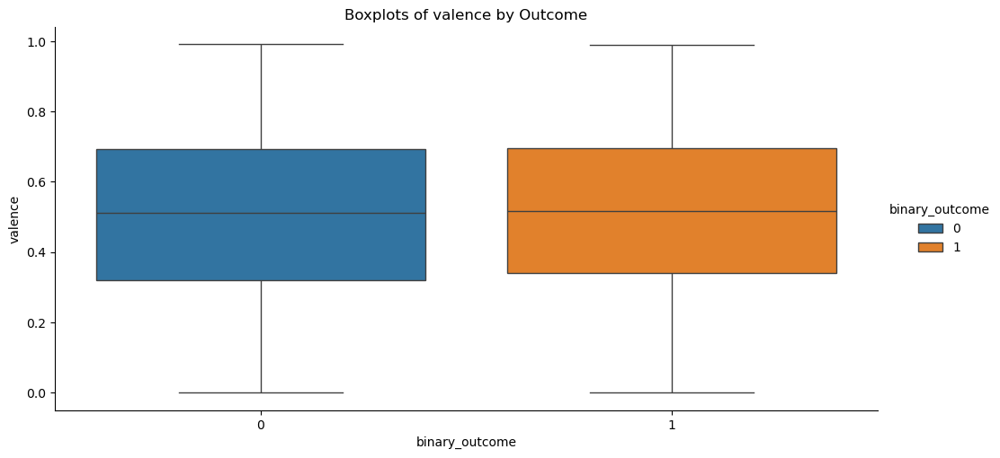

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


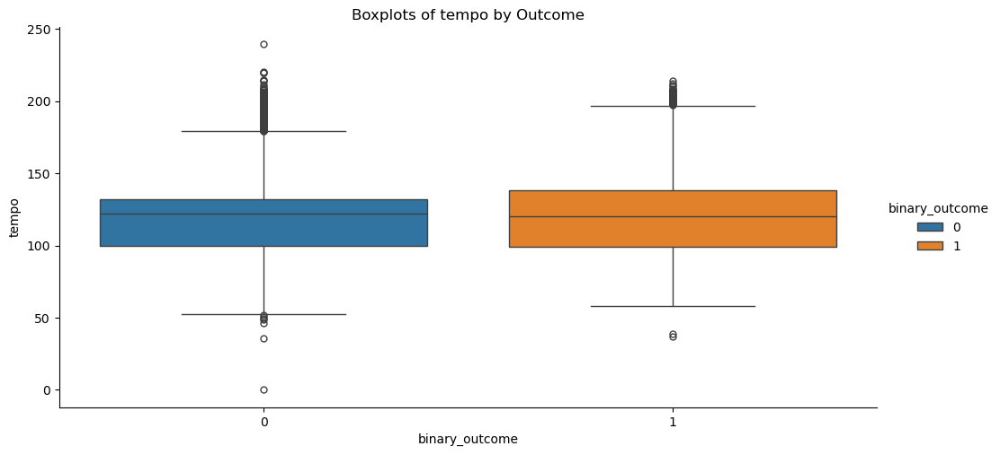

In [97]:
for var in x_nums_with_std:
    sns.catplot(data=spotify_df_t, y=var, x="binary_outcome", hue='binary_outcome', kind="box", aspect=2)
    plt.title("Boxplots of "+ var + " by Outcome")
    plt.show()

Point Plots of Continuous Vars by Outcome

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


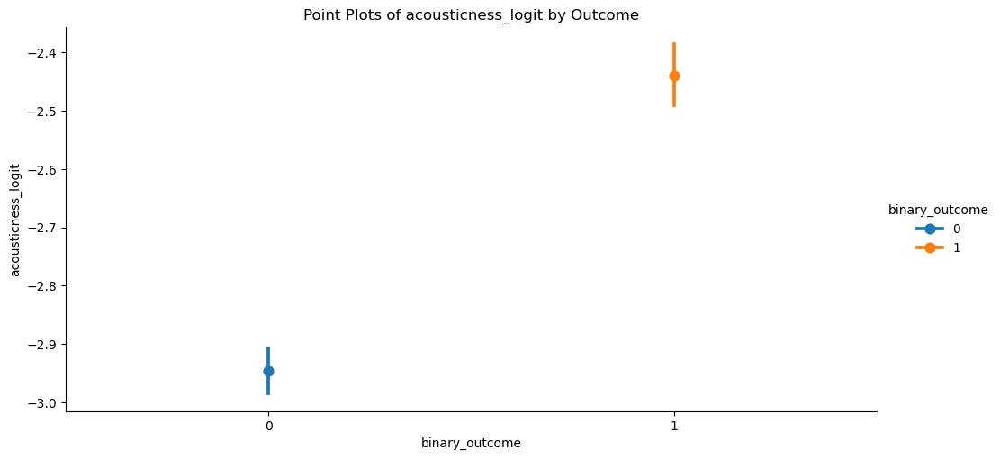

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


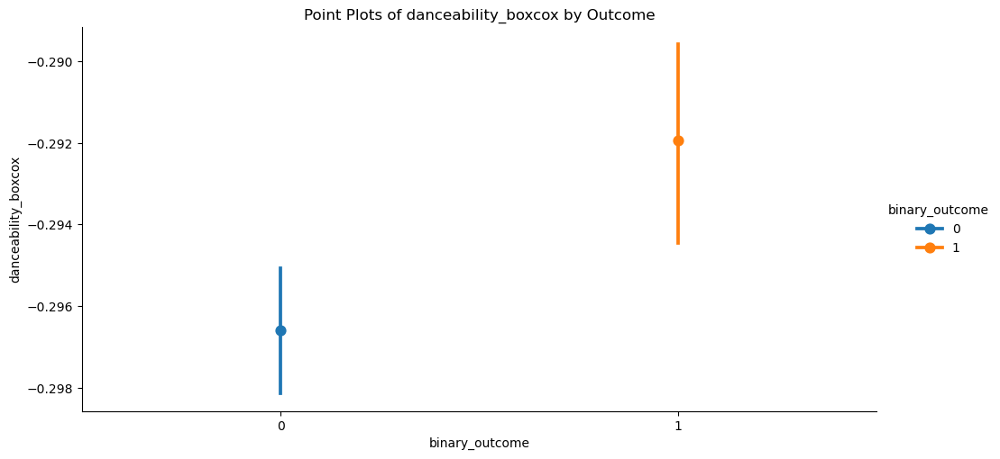

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


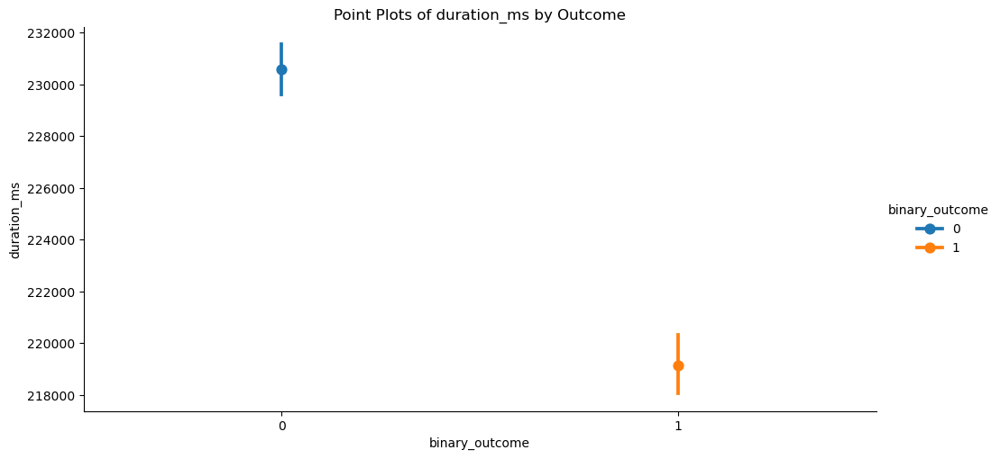

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


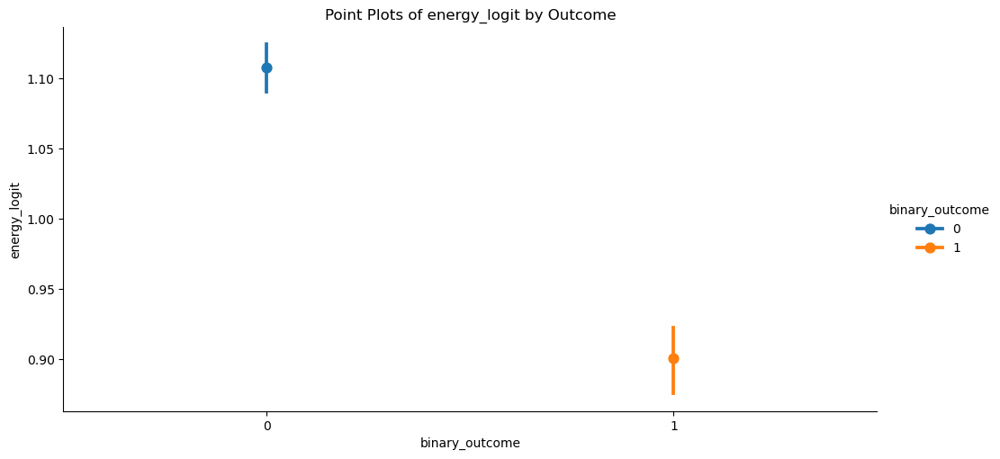

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


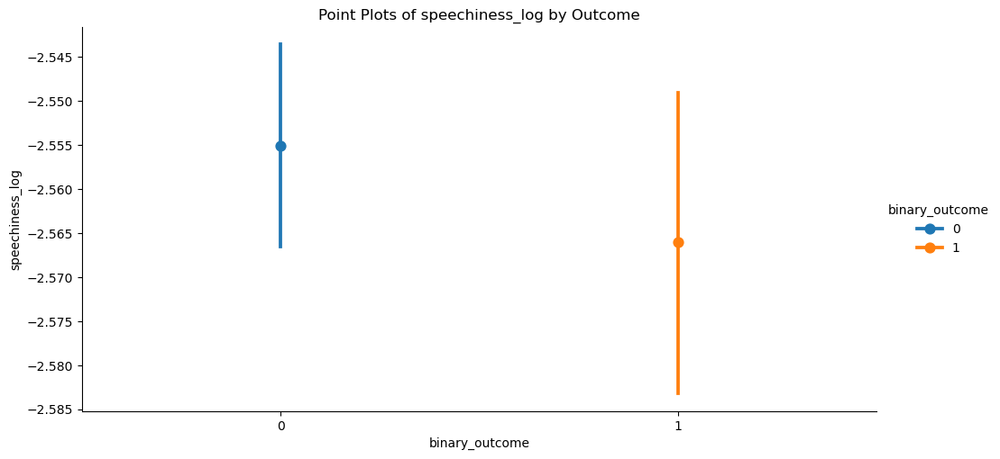

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


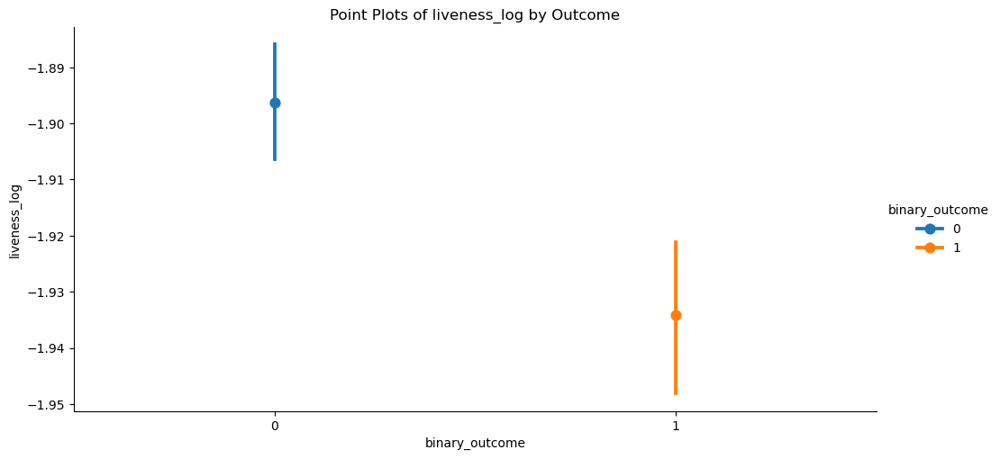

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


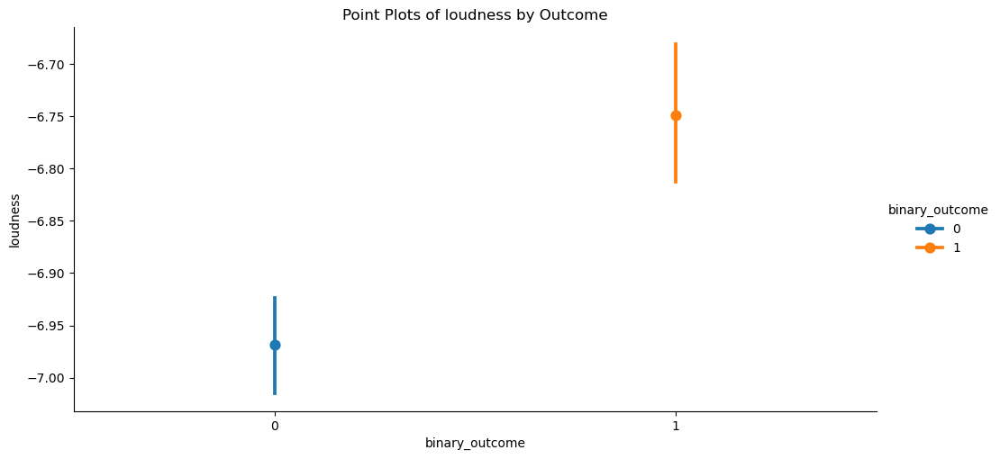

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


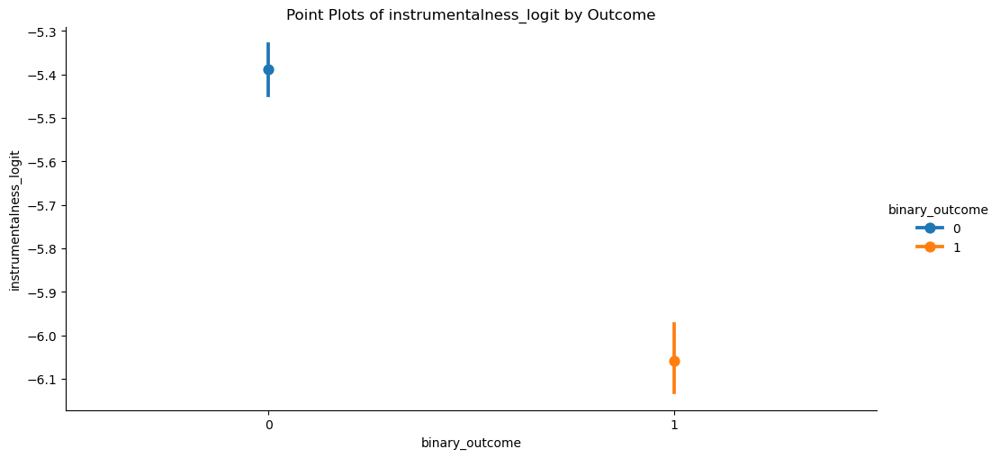

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


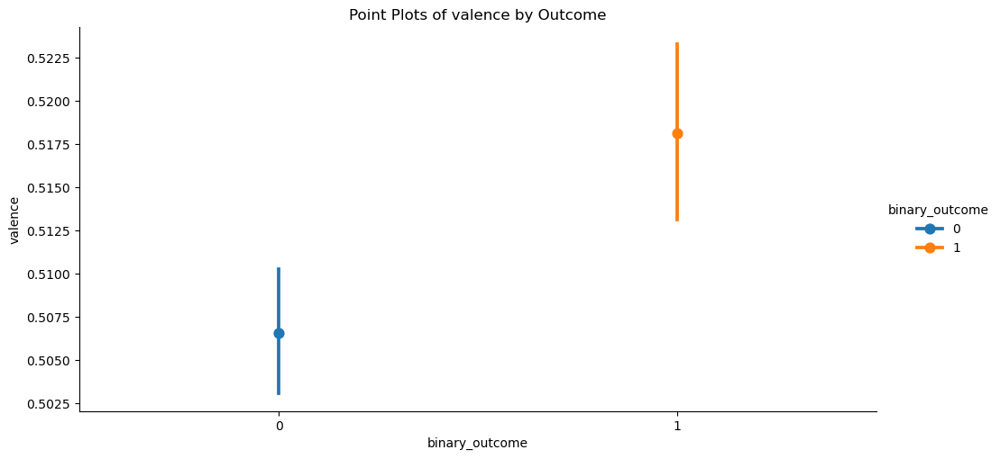

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


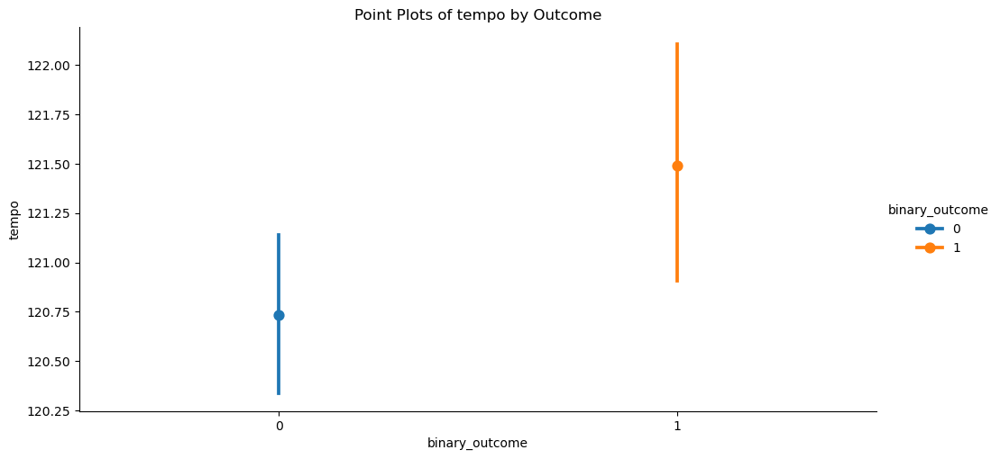

In [98]:
for var in x_nums_with_std:
    sns.catplot(data=spotify_df_t, y=var, x="binary_outcome", hue='binary_outcome', kind="point", aspect=2)
    plt.title("Point Plots of "+ var + " by Outcome")
    plt.show()

Count the Number of Observations for Each Combination of Outcome and Categorical Variables

Variable: key, Chi-Square Value: 18.430080, P-value: 0.072123


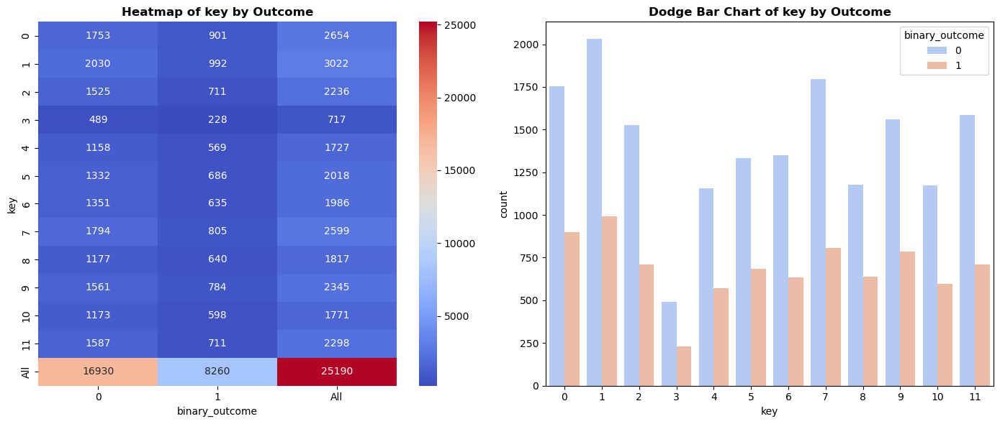

Variable: mode, Chi-Square Value: 9.177710, P-value: 0.002450


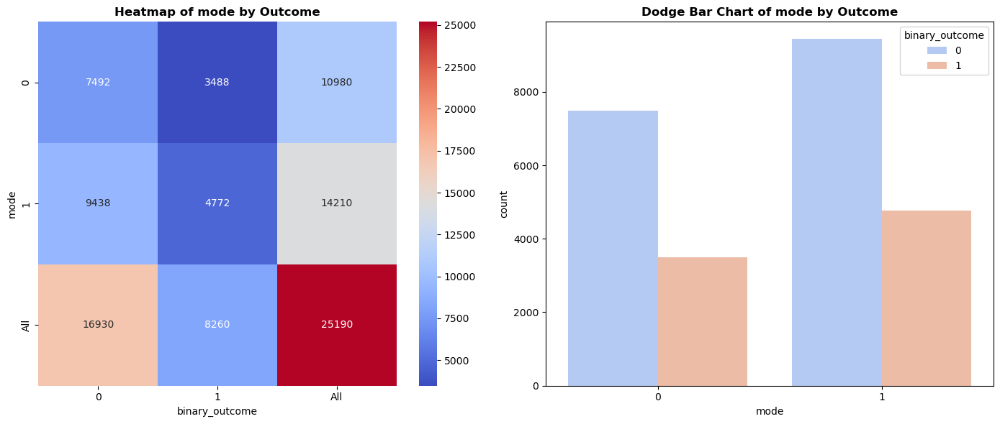

Variable: playlist_genre, Chi-Square Value: 795.811420, P-value: 0.000000


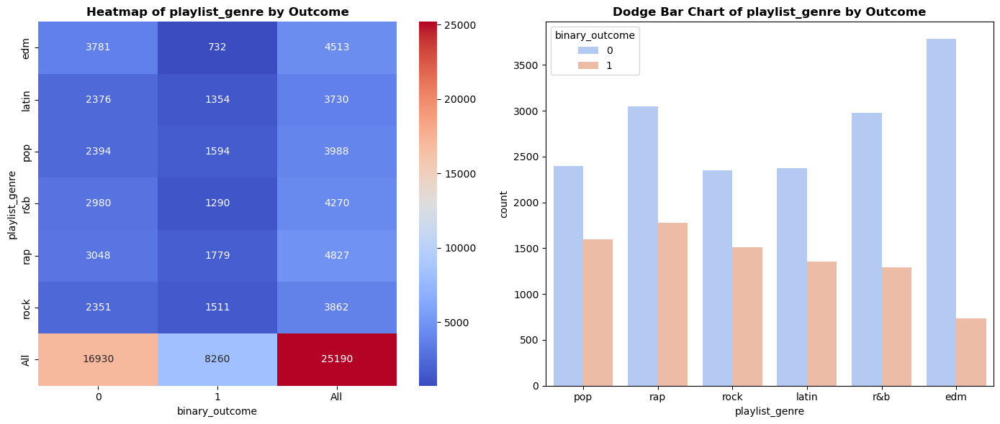

In [99]:
for var in x_cats:
    # Drop rows with missing values for the current variable and binary outcome
    df_clean = spotify_df_t.dropna(subset=[var, 'binary_outcome'])
    chi2, p_value, dof, expected = stats.chi2_contingency(pd.crosstab(df_clean['binary_outcome'], df_clean[var]))
    print("Variable: %s, Chi-Square Value: %f, P-value: %f" % (var, chi2, p_value))
    
    # Create subplots for heatmap and count plot
    fig, ax = plt.subplots(1, 2, figsize=(14, 6))
    
    # Heatmap of the contingency table
    sns.heatmap(data=pd.crosstab(df_clean[var], df_clean['binary_outcome'], margins=True), 
                ax=ax[0], annot=True, cmap='coolwarm', fmt='d')
    ax[0].set_title(f"Heatmap of {var} by Outcome", fontsize=12, fontweight="bold")
    
    # Count plot (Dodge Bar Chart)
    sns.countplot(data=df_clean, x=var, hue='binary_outcome', palette="coolwarm", dodge=True, ax=ax[1])
    ax[1].set_title(f"Dodge Bar Chart of {var} by Outcome", fontsize=12, fontweight="bold")
    if var == "mostcom_playlistsubgenre":
        # Set x-axis labels to be horizontal
        plt.xticks(rotation=45)
    
    plt.tight_layout()
    plt.show()

**8 - Additional Plots**

Comparing Categorical Inputs

In [100]:
import itertools

In [101]:
var_pairs = list(itertools.combinations(x_cats, 2))

Variables: key, Chi-Square Value: 2489.469803, P-value: 0.000000


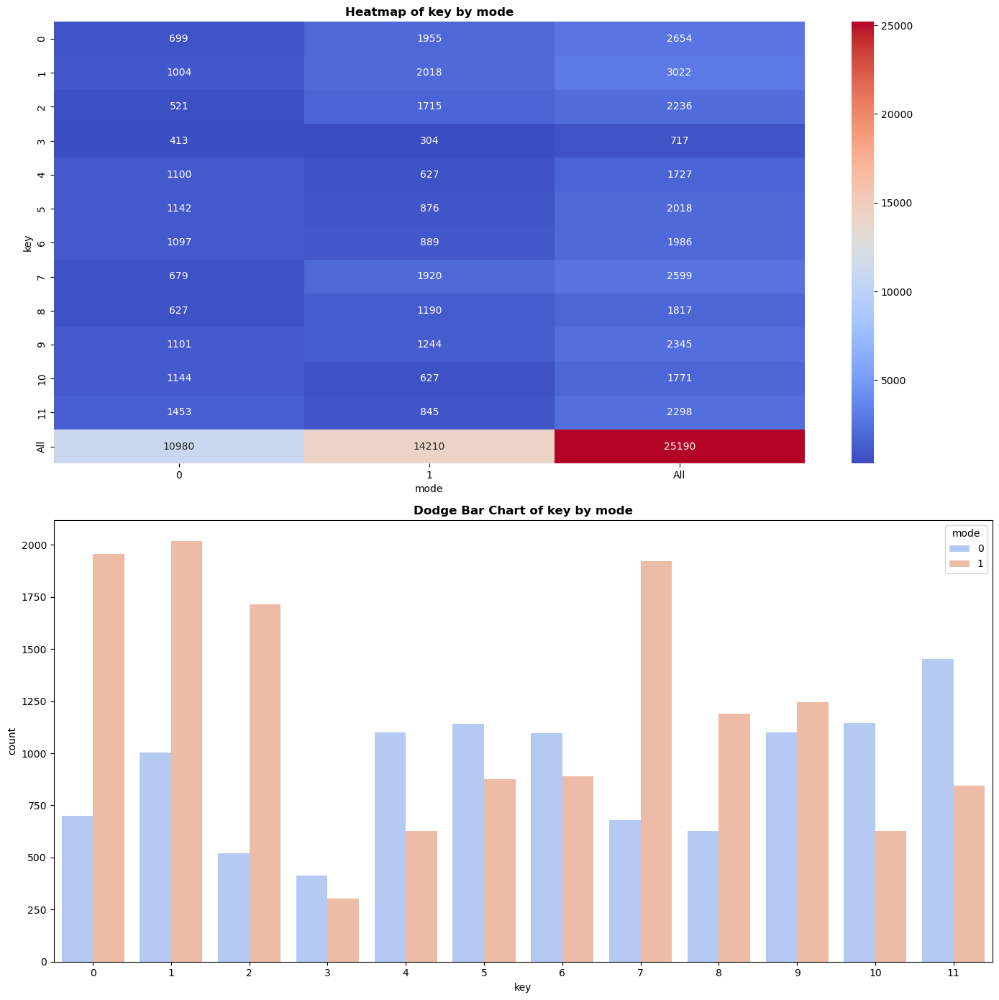

Variables: key, Chi-Square Value: 681.146955, P-value: 0.000000


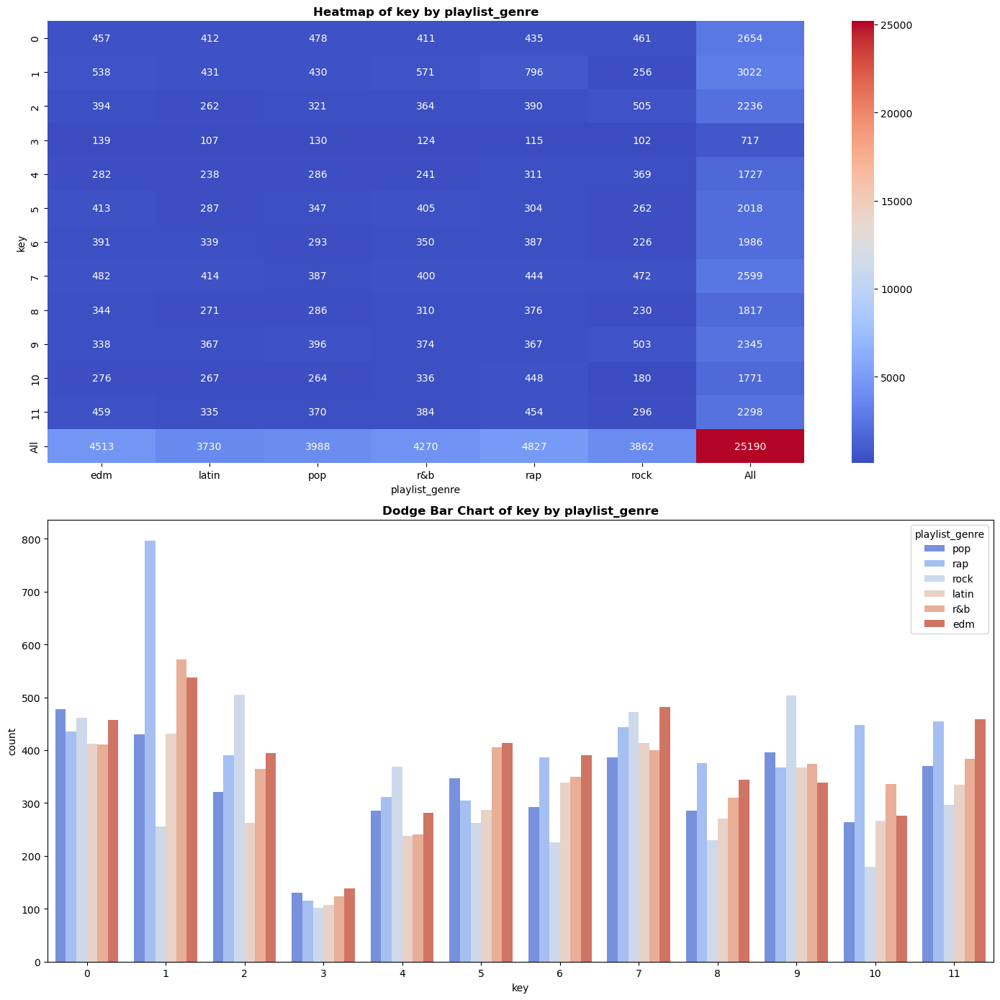

Variables: mode, Chi-Square Value: 353.380928, P-value: 0.000000


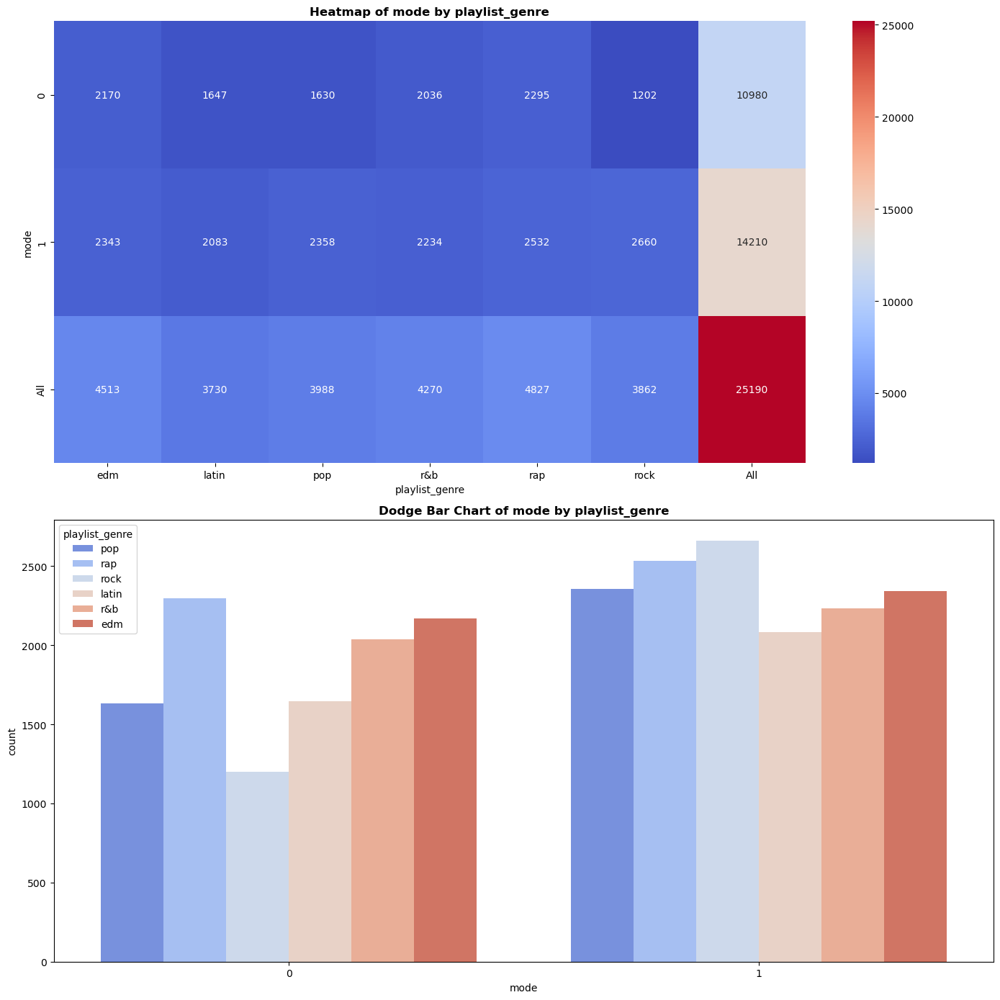

In [102]:
for var, var2 in var_pairs:
    # Drop rows with missing values for the current variable pair and binary outcome
    df_clean = spotify_df_t.dropna(subset=[var, var2])

    # Perform Chi-square test
    chi2, p_value, dof, expected = stats.chi2_contingency(pd.crosstab(df_clean[var2], df_clean[var]))
    print("Variables: %s, Chi-Square Value: %f, P-value: %f" % (var, chi2, p_value))

    # Create subplots for heatmap and count plot
    fig, ax = plt.subplots(2, 1, figsize=(14, 14))

    # Heatmap of the contingency table
    sns.heatmap(data=pd.crosstab(df_clean[var], df_clean[var2], margins=True),
                ax=ax[0], annot=True, cmap='coolwarm', fmt='d')
    ax[0].set_title(f"Heatmap of {var} by {var2}", fontsize=12, fontweight="bold")

    # Count plot (Dodge Bar Chart)
    sns.countplot(data=df_clean, x=var, hue=var2, palette="coolwarm", dodge=True, ax=ax[1])
    ax[1].set_title(f"Dodge Bar Chart of {var} by {var2}", fontsize=12, fontweight="bold")

    if var == "mostcom_playlistsubgenre":
        # Set x-axis labels to be horizontal for better readability
        plt.xticks(rotation=45)

    # Adjust layout and display the plots
    plt.tight_layout()
    plt.show()

Plotting Trend Plots for Logistic Regressions

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


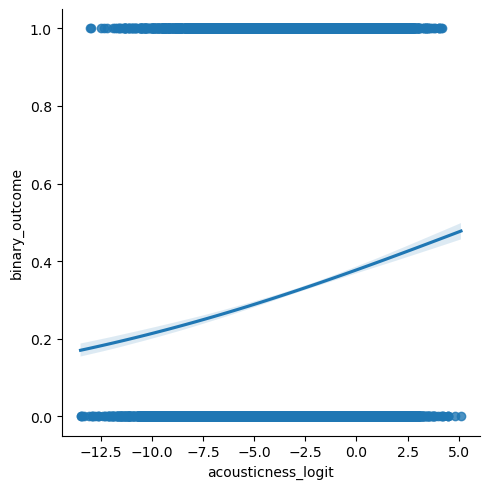

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


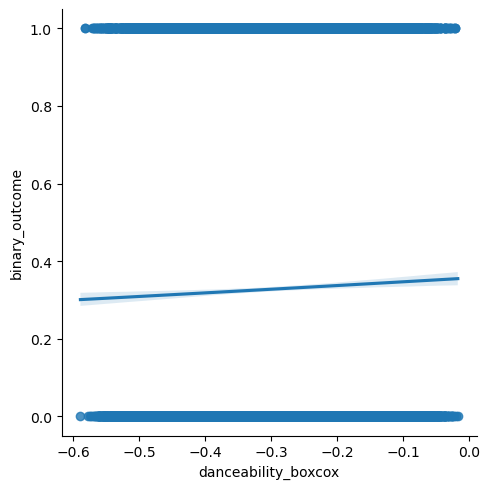

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


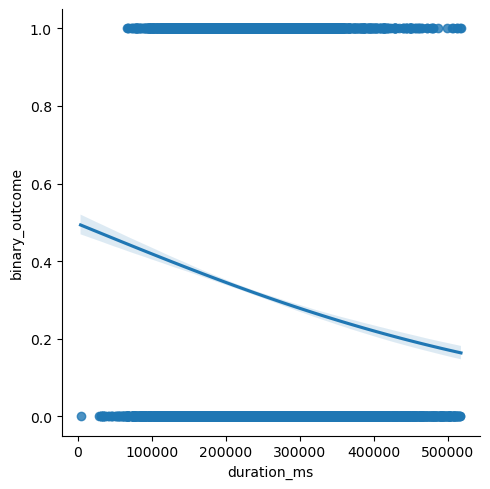

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


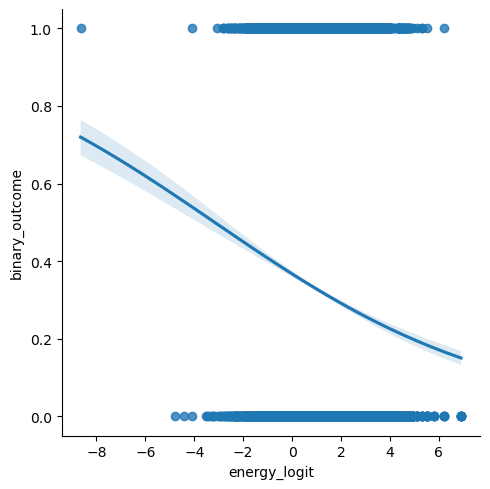

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


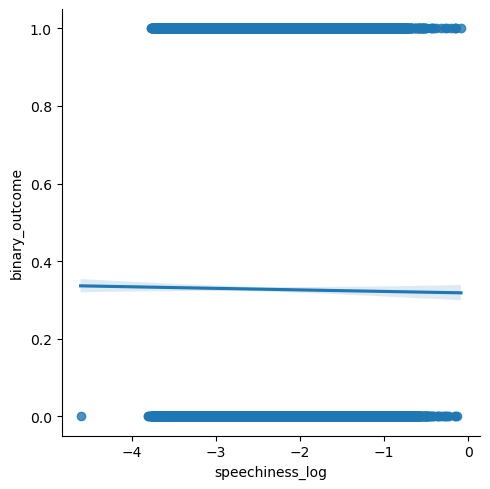

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


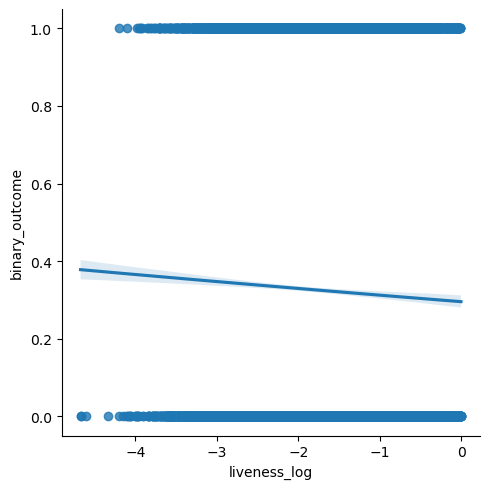

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


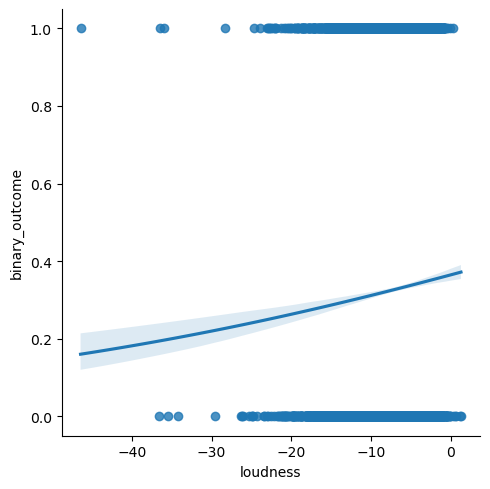

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


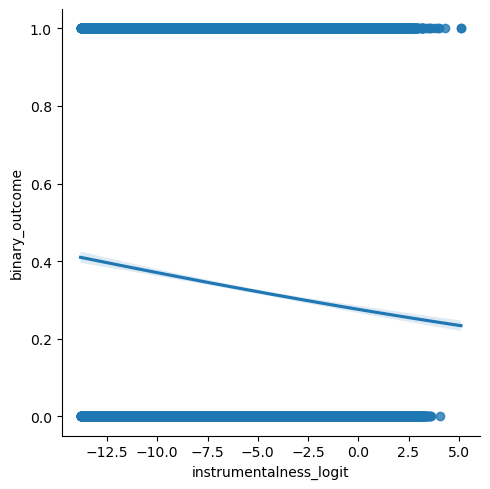

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


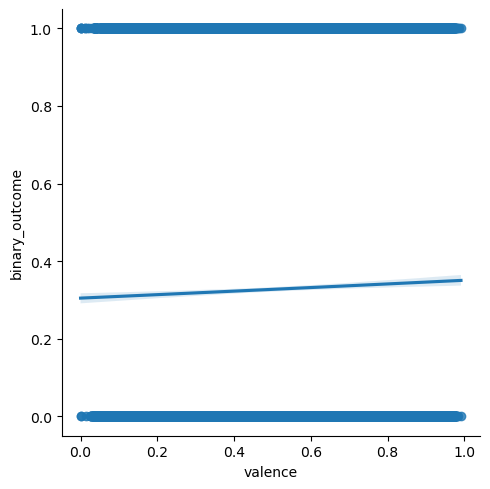

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


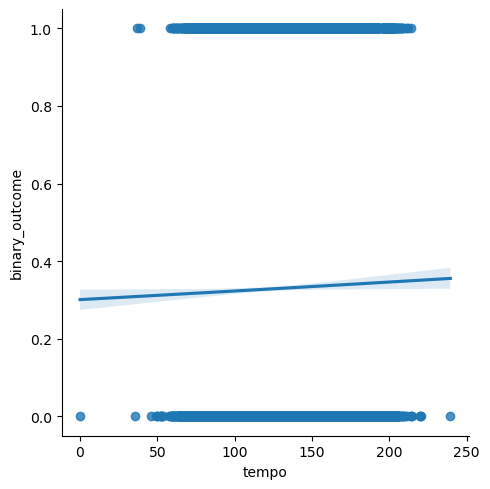

In [103]:
for var in x_nums_with_std:
    sns.lmplot(data=spotify_df_t, x=var, y="binary_outcome", logistic=True)
    plt.show()

Variables that are potential inputs:
1) Continuous:
    * Accousticness (accousticness_logit)
    * Danceability (danceability_logit)
    * Duration (duration_ms)
    * Energy (energy_logit)
    * Instrumentalness (instrumentalness_logit)
    * Liveness (liveness_lg)
    * Valence

Tempo, speechiness and loudness might be out!!
   
I included these specific variables because they had trends with the track popularity variable, and the averages differed between binary outcome groups on the point plots. 

2) Categorical:
    * Key
    * Playlist genre (mostcom_playlistgenre)
  
I included these variables because there seem to be more non-events (63%) than events (37%) overall in each of these variables. I choose `key` because it seems to have differences in averages of the continuous inputs. The `playlist_genre` variable seems to also show differences in the continuous inputs on both boxplots and point plots and when looking at the average of the `track_popularity_tf`. 

In [104]:
x_nums_with_std

['acousticness_logit',
 'danceability_boxcox',
 'duration_ms',
 'energy_logit',
 'speechiness_log',
 'liveness_log',
 'loudness',
 'instrumentalness_logit',
 'valence',
 'tempo']

**PRE-PROCESSING BEFORE STANDARDIZING**

In [105]:
spotify_stan = spotify_transf.loc[:, x_nums_with_std].dropna().copy()

In [107]:
spotify_stan

,acousticness_logit,danceability_boxcox,duration_ms,energy_logit,speechiness_log,liveness_log,loudness,instrumentalness_logit,valence,tempo
3,-3.521738,-0.253422,169093,2.586689,-2.282782,-1.589635,-3.778,-11.571605,0.2770,121.956
4,-2.438278,-0.305607,189052,1.607040,-3.327018,-2.485307,-4.672,-4.595120,0.7250,123.976
6,-1.469622,-0.437889,187675,1.782457,-2.775794,-1.737271,-4.788,-4.595120,0.1520,112.648
10,-1.766325,-0.283794,207894,2.483824,-1.709258,-2.087474,-6.500,-12.222197,0.7520,121.984
12,-3.180661,-0.232522,192507,0.974422,-3.072613,-0.983499,-4.675,-4.595120,0.6870,121.985
...,...,...,...,...,...,...,...,...,...,...
32828,-2.489465,-0.449713,204375,2.469836,-2.368725,-2.706052,-1.814,-4.595120,0.2100,128.170
32829,-6.369550,-0.393774,353120,1.300981,-3.170086,-0.980829,-4.462,-5.451862,0.4000,128.041
32830,-2.111335,-0.389303,210112,1.523137,-3.034473,-1.897120,-4.899,-13.711149,0.4360,127.989
32831,-4.830413,-0.323154,367432,2.070473,-2.216407,-1.070025,-3.361,-1.927748,0.3080,128.008


/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


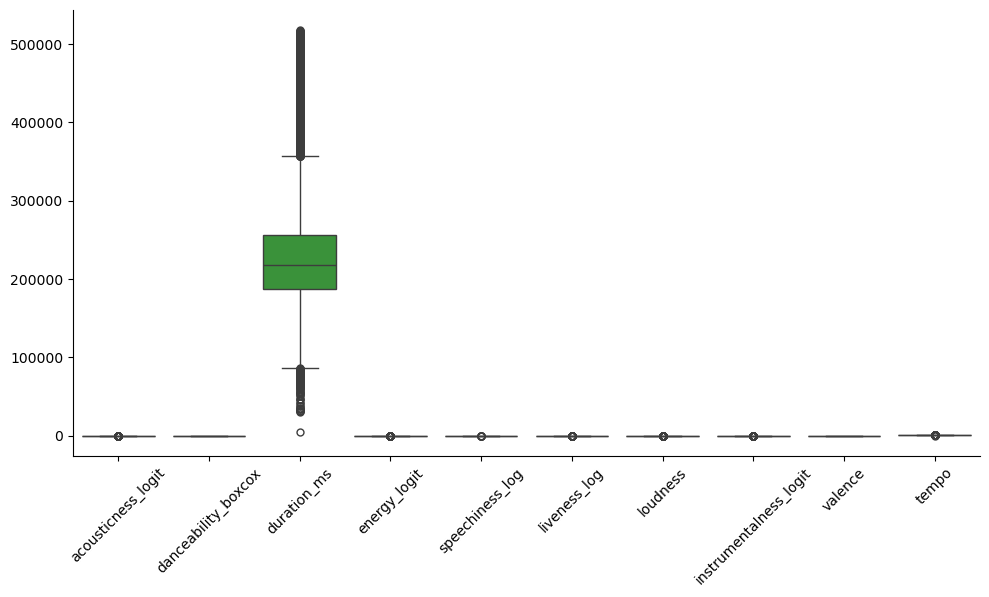

In [108]:
sns.catplot(data=pd.DataFrame(spotify_stan, columns=spotify_stan.columns), kind="box", aspect=2)
plt.xticks(rotation=45)
plt.show()

In [109]:
from sklearn.preprocessing import StandardScaler

In [110]:
Xspot = StandardScaler().fit_transform(spotify_stan)

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


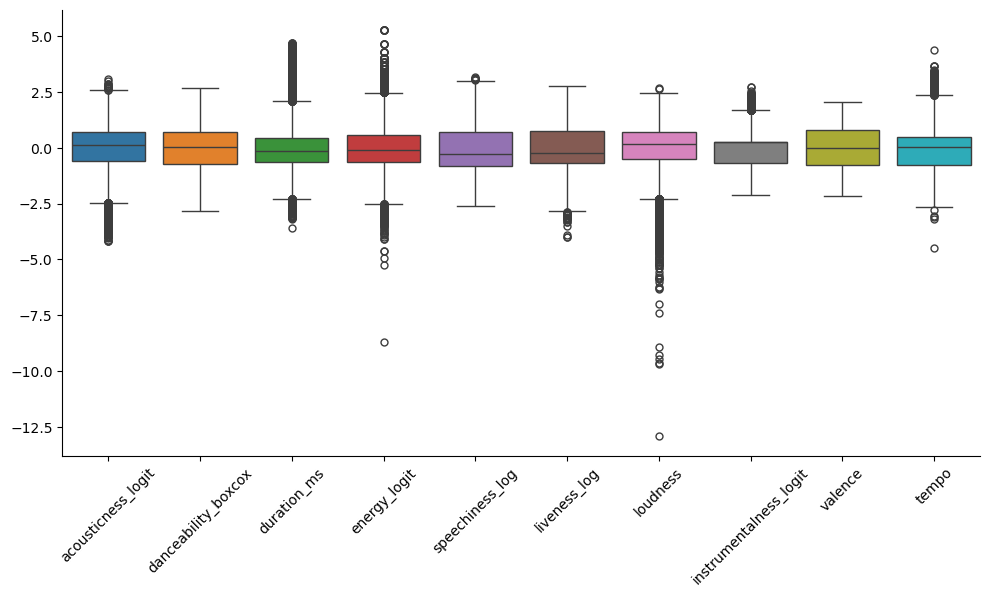

In [111]:
sns.catplot(data=pd.DataFrame(Xspot, columns=spotify_stan.columns), kind="box", aspect=2)
plt.xticks(rotation=45)
plt.show()

In [112]:
spotify_stan_clean = pd.DataFrame(Xspot, columns=spotify_stan.columns, index=spotify_stan.index)

In [113]:
spotify_stan_clean.describe()

,acousticness_logit,danceability_boxcox,duration_ms,energy_logit,speechiness_log,liveness_log,loudness,instrumentalness_logit,valence,tempo
count,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04,2.519000e+04
mean,2.391982e-16,-2.183248e-16,-8.123712e-17,-1.579611e-17,-1.681157e-16,-1.308820e-16,1.669874e-16,3.610539e-16,1.083162e-16,3.430012e-16
std,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00,1.000020e+00
min,-4.196641e+00,-2.819555e+00,-3.595264e+00,-8.718676e+00,-2.623323e+00,-3.995493e+00,-1.288977e+01,-2.092166e+00,-2.170119e+00,-4.481848e+00
25%,-5.755489e-01,-7.089355e-01,-6.341173e-01,-6.562079e-01,-8.146377e-01,-6.824039e-01,-4.938706e-01,-6.917839e-01,-7.754340e-01,-7.781583e-01
50%,1.335352e-01,3.531710e-02,-1.555877e-01,-8.132107e-02,-2.701178e-01,-2.239638e-01,1.796001e-01,2.583447e-01,6.950478e-03,3.751588e-02
75%,6.903271e-01,7.255849e-01,4.609243e-01,5.834592e-01,7.129566e-01,7.497682e-01,6.950097e-01,2.583447e-01,7.850829e-01,4.843992e-01
max,3.094850e+00,2.667356e+00,4.694323e+00,5.278645e+00,3.170180e+00,2.754740e+00,2.663115e+00,2.732420e+00,2.043701e+00,4.388396e+00


#### PCA Analysis

In [114]:
from sklearn.decomposition import PCA

In [115]:
pca = PCA().fit(Xspot)

In [116]:
pca_spot = pca.transform(Xspot)

In [117]:
explained_variance_ratio = pca.explained_variance_ratio_

In [118]:
print(explained_variance_ratio)

[0.2120477  0.15604658 0.11289585 0.10538904 0.09742137 0.09243995
 0.08168602 0.06013526 0.05511222 0.02682601]


In [119]:
cumulative_variance = pca.explained_variance_ratio_.cumsum()

In [120]:
cumulative_variance

array([0.2120477 , 0.36809428, 0.48099013, 0.58637917, 0.68380054,
       0.77624049, 0.85792651, 0.91806177, 0.97317399, 1.        ])

In [121]:
loadings = pca.components_

In [122]:
loadings_df = pd.DataFrame(loadings, columns=spotify_stan_clean.columns, index=[f'PC{i+1}' for i in range(loadings.shape[0])])

In [123]:
loadings_df

,acousticness_logit,danceability_boxcox,duration_ms,energy_logit,speechiness_log,liveness_log,loudness,instrumentalness_logit,valence,tempo
PC1,0.494917,0.203675,-0.028674,-0.602317,0.002886,-0.180865,-0.509204,-0.053325,0.047277,-0.229953
PC2,-0.084832,-0.562977,0.269984,-0.156395,-0.420650,0.056301,-0.278041,0.189907,-0.522543,0.109414
PC3,-0.266361,0.279719,0.544776,0.099209,-0.313210,-0.514555,-0.027728,0.269150,0.261073,-0.199873
PC4,-0.097426,0.213955,-0.086404,-0.006351,0.455012,0.094584,-0.138370,0.800580,-0.247177,0.008484
PC5,0.024405,-0.044341,-0.121132,-0.070864,0.122485,-0.544957,-0.070001,-0.009696,0.048740,0.811414
PC6,-0.031942,-0.027635,-0.664532,0.045550,-0.302634,-0.469365,0.217542,0.116989,-0.271066,-0.328877
PC7,0.111566,-0.033938,-0.306478,0.038331,-0.512590,0.328550,-0.136773,0.387660,0.554293,0.209958
PC8,-0.749280,0.248212,-0.249888,-0.168463,-0.048108,0.121740,-0.448820,-0.257089,-0.020429,0.032542
PC9,-0.136979,-0.648609,-0.089833,0.126240,0.377851,-0.220743,-0.291345,0.041192,0.418410,-0.288777
PC10,0.270506,0.177114,-0.036362,0.741614,-0.059030,-0.040372,-0.535011,-0.125969,-0.192048,0.006554


Looking at the LOADINGS and CUMULATIVE VARIANCE from the PCA analysis, it seems that the:

PC1 and PC2 explain 58% of the variance
Certain variables have higher loadings within those two components:
* Acousticness (0.49) in PC1
* Energy (-0.60) in PC1
* Danceability (0.20) in PC1, (-0.56) in PC2
* Valence (-0.52) in PC1

I think these variables can explain a lot of variability and could be perfect for a predictor???? I didn't choose loudness because this variable is highly correlated with energy.

In [124]:
x_cluster = [ 'acousticness_logit', 'danceability_boxcox',  'energy_logit', 'valence']

## 3. Clustering

In [128]:
from sklearn.cluster import KMeans

In [129]:
from scipy.cluster import hierarchy

In [125]:
clust_spot = spotify_stan_clean.loc[:, x_cluster].dropna().copy()

In [126]:
clust_spot

,acousticness_logit,danceability_boxcox,energy_logit,valence
3,-0.290918,0.399390,1.391767,-0.992291
4,0.134067,-0.101000,0.510350,0.912646
6,0.514019,-1.369427,0.668178,-1.523802
10,0.397638,0.108159,1.299216,1.027452
12,-0.157131,0.599798,-0.058833,0.751066
...,...,...,...,...
32828,0.113988,-1.482801,1.286631,-1.277181
32829,-1.407964,-0.946418,0.234981,-0.469284
32830,0.262309,-0.903546,0.434861,-0.316208
32831,-0.804242,-0.269258,0.927313,-0.860476


Plotting the Total Within Sum of Squares vs Number of Clusters to see whats the best clusters

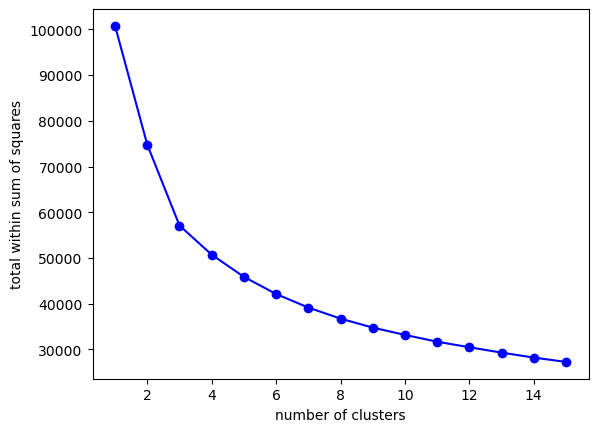

In [136]:
tots_within = []

K = range(1, 16)

for k in K:
    km = KMeans(n_clusters=k, random_state=2100, n_init=25, max_iter=500).fit(clust_spot)
    tots_within.append(km.inertia_)
    
Fig, ax = plt.subplots()
ax.plot(K, tots_within, "bo-")
ax.set_xlabel("number of clusters")
ax.set_ylabel("total within sum of squares")
plt.show()

Hierarchical Clustering

In [137]:
hclust_ward = hierarchy.ward(clust_spot)

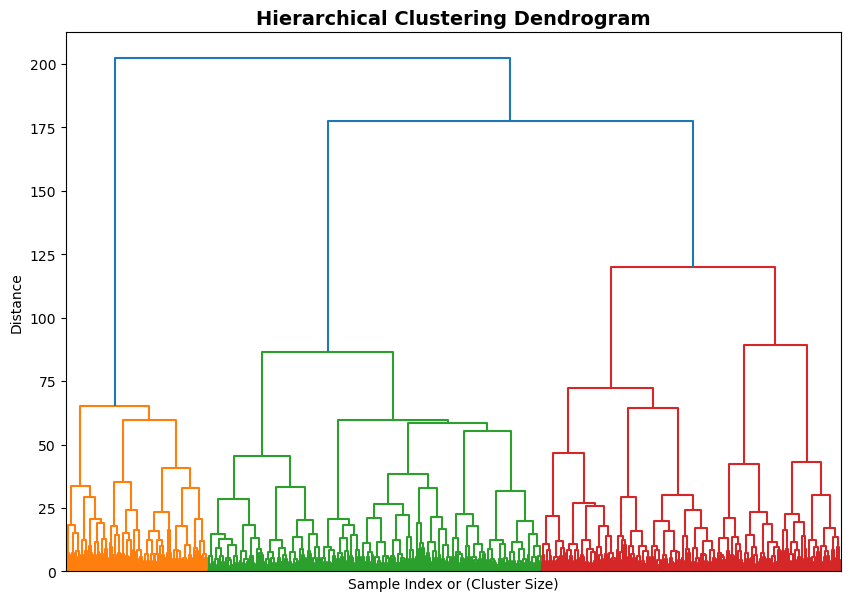

In [138]:
plt.figure(figsize=(10, 7))
dn = hierarchy.dendrogram(hclust_ward, no_labels=True)
plt.title("Hierarchical Clustering Dendrogram", fontsize=14, fontweight="bold")
plt.xlabel("Sample Index or (Cluster Size)")
plt.ylabel("Distance")
plt.show()

Based on both the plots, the best number of clusters is 3.

In [140]:
# hclust_group = hierarchy.cut_tree(hclust_ward, n_clusters=4).ravel()
hclust_group = hierarchy.cut_tree(hclust_ward, height=150).ravel()

In [141]:
spotify_cluster = spotify_transf.dropna().copy()

In [142]:
spotify_cluster["hclustgroup"] = pd.Series(hclust_group, index=spotify_cluster.index).astype("category")

In [143]:
spotify_cluster.hclustgroup.value_counts(normalize=True)

hclustgroup
1    0.430687
2    0.385312
0    0.184002
Name: proportion, dtype: float64

**1 - After identifying the optimal number of clusters, compare the cluster assignments to unique values of several of the categorical inputs**

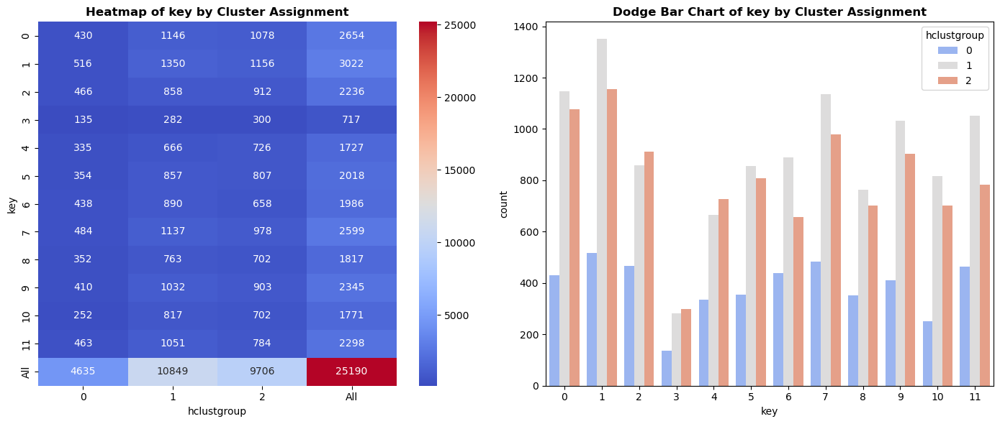

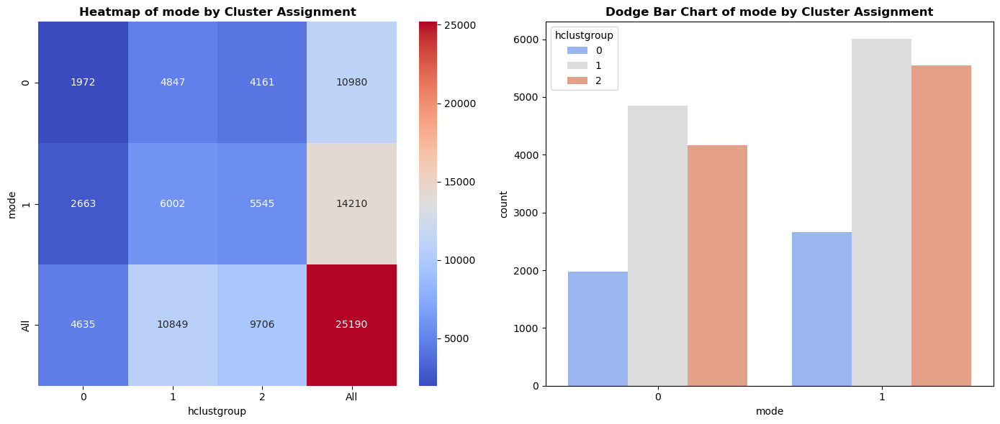

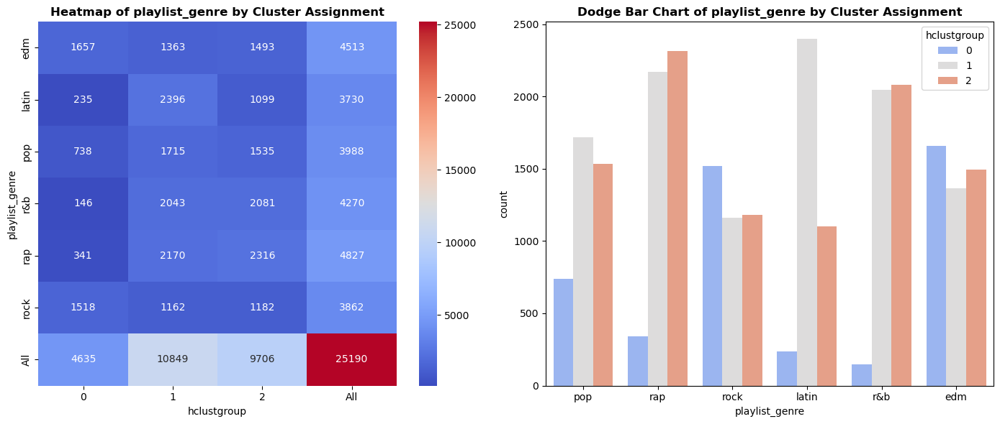

In [144]:
for var in x_cats:
    # Create subplots for heatmap and count plot
    fig, ax = plt.subplots(1, 2, figsize=(14, 6))
    
    # Heatmap of the contingency table
    sns.heatmap(data=pd.crosstab(spotify_cluster[var], spotify_cluster['hclustgroup'], margins=True), 
                ax=ax[0], annot=True, cmap='coolwarm', fmt='d')
    ax[0].set_title(f"Heatmap of {var} by Cluster Assignment", fontsize=12, fontweight="bold")
    
    # Count plot (Dodge Bar Chart)
    sns.countplot(data=spotify_cluster, x=var, hue='hclustgroup', palette="coolwarm", dodge=True, ax=ax[1])
    ax[1].set_title(f"Dodge Bar Chart of {var} by Cluster Assignment", fontsize=12, fontweight="bold")
    
    plt.tight_layout()
    plt.show()

**2/3 - Summarize the continuous inputs associated with each of the cluster assignments**

Box Plots comparing the Cluster groups with each variable of interest

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


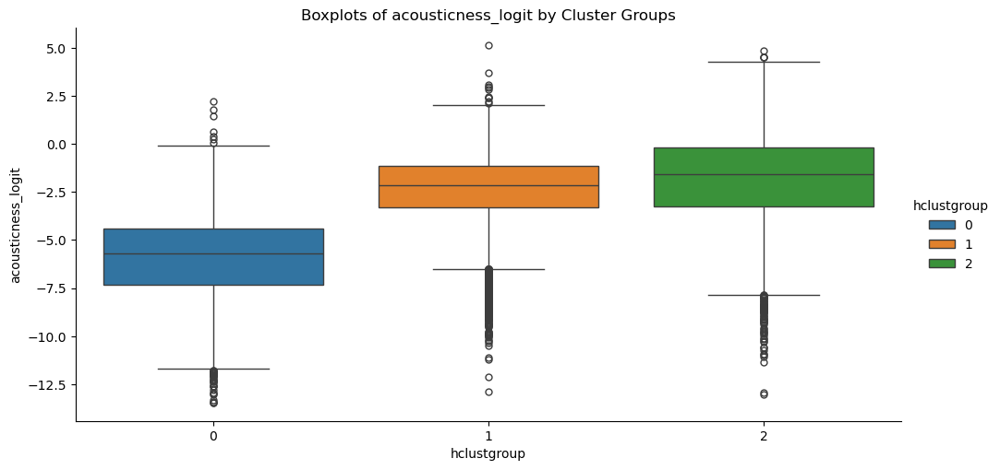

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


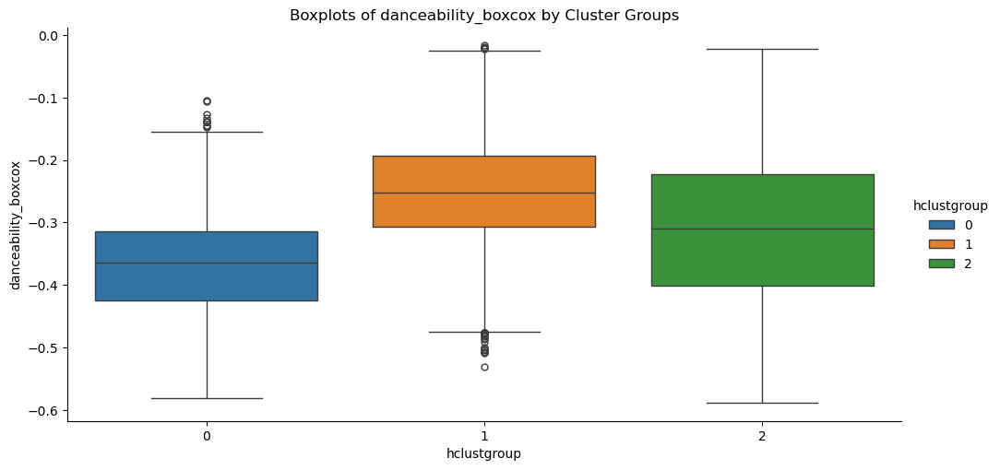

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


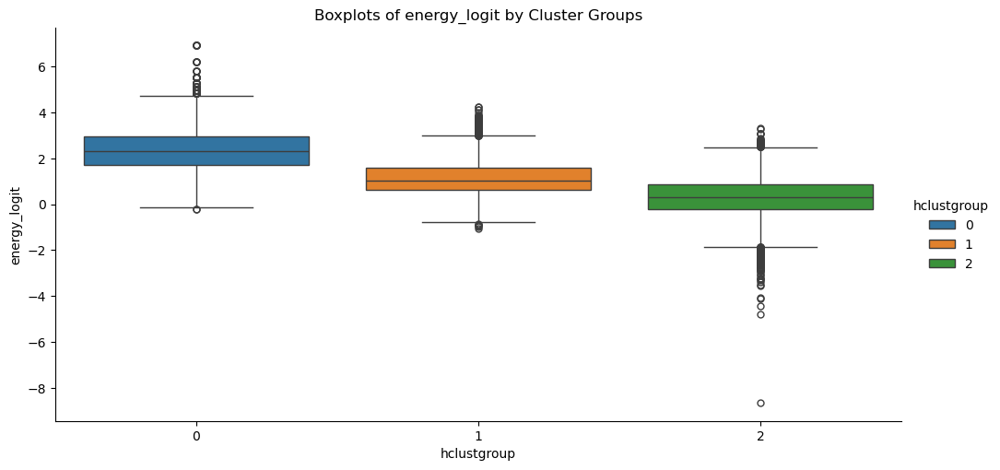

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


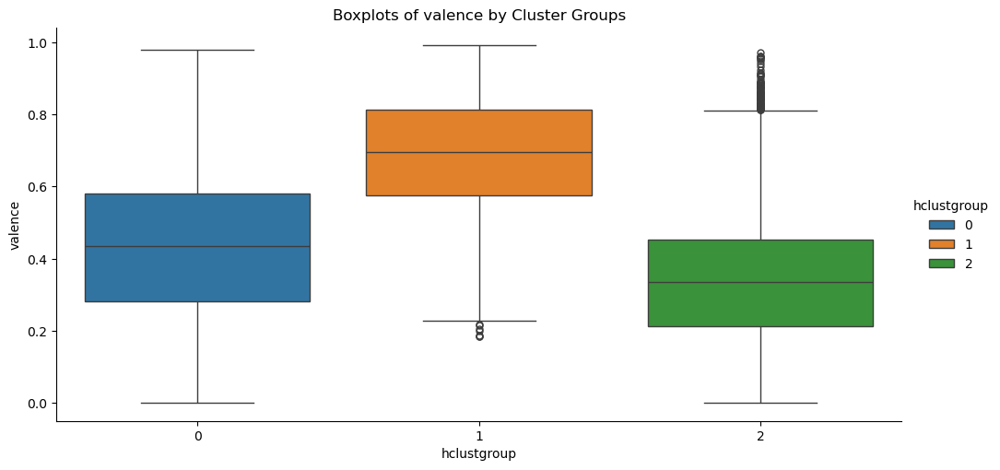

In [145]:
for var in x_cluster:
    sns.catplot(data=spotify_cluster, x="hclustgroup", hue="hclustgroup", y=var, kind="box", aspect=2)
    plt.title("Boxplots of "+ var + " by Cluster Groups")
    plt.show()

Point Plots comparing the Cluster groups with each variable of interest

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


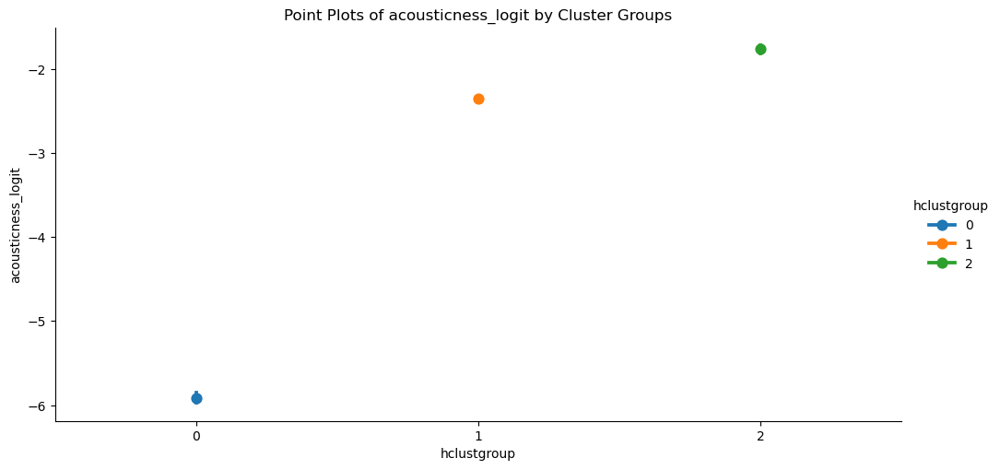

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


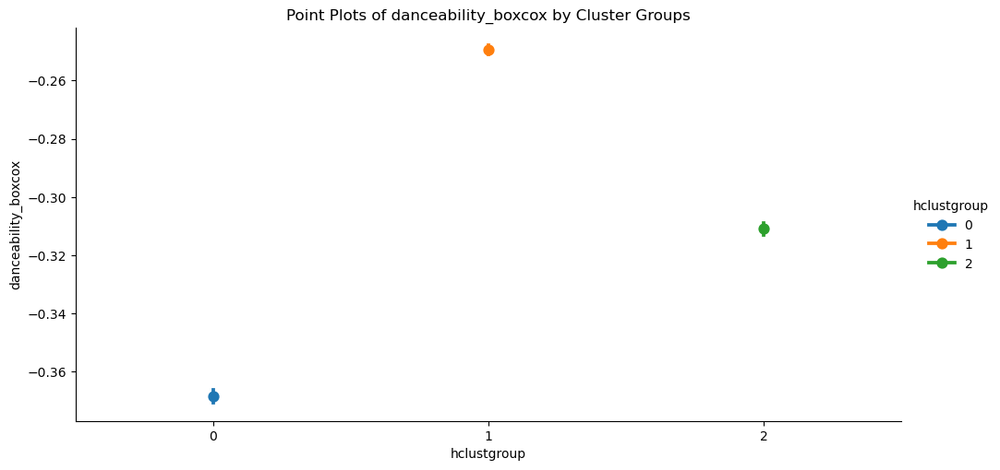

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


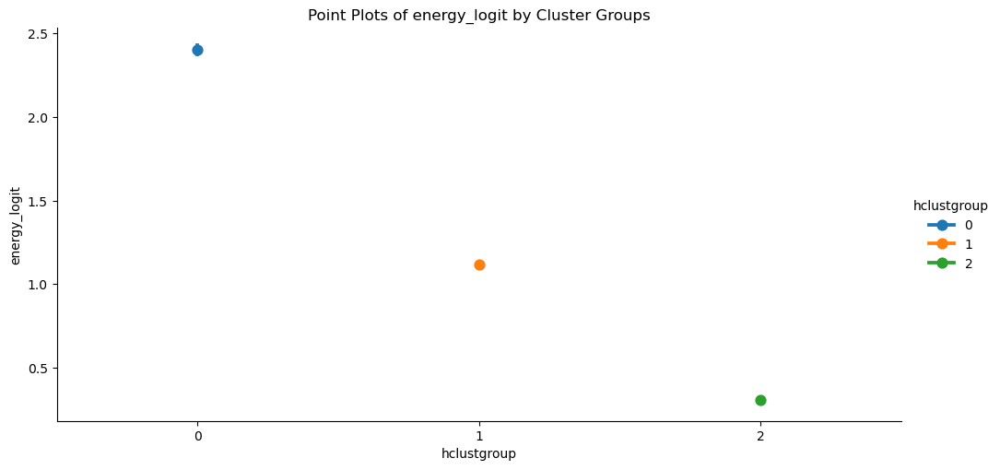

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


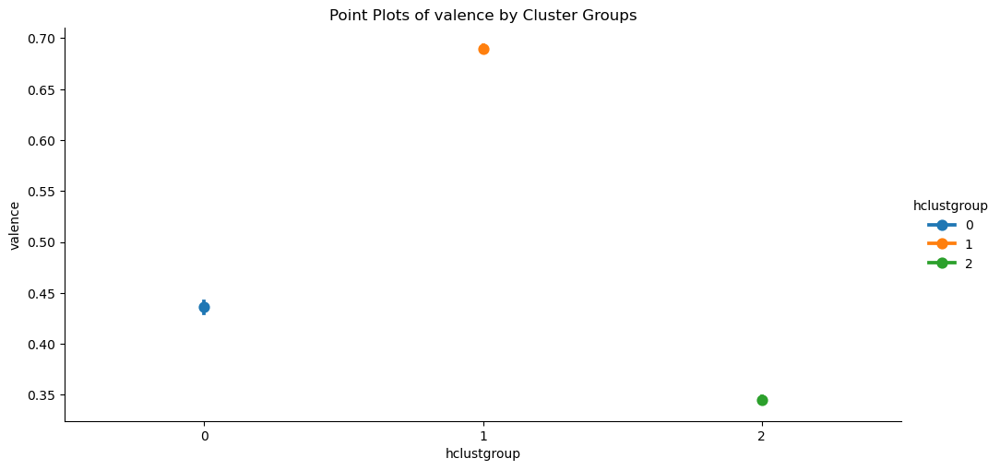

In [146]:
for var in x_cluster:
    sns.catplot(data=spotify_cluster, x="hclustgroup", hue="hclustgroup", y=var, kind="point", aspect=2)
    plt.title("Point Plots of "+ var + " by Cluster Groups")
    plt.show()

Pair Plots comparing the Cluser groups for all the variables

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


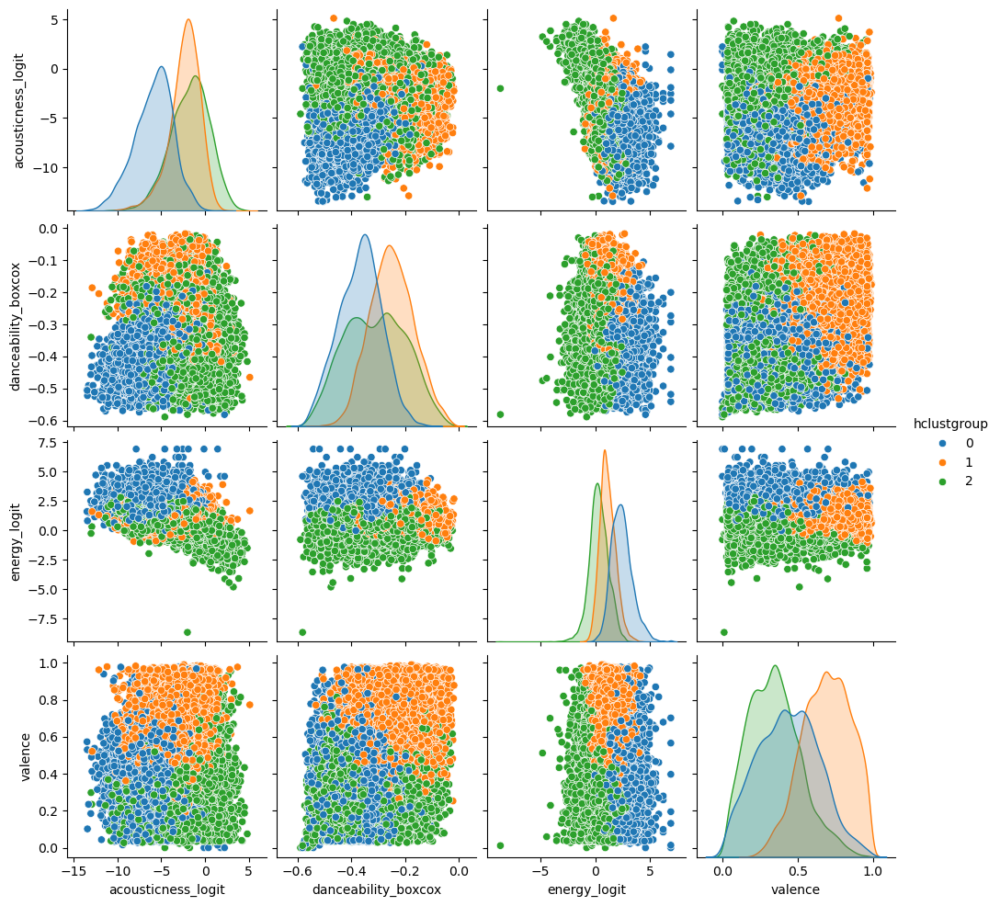

In [147]:
sns.pairplot(data=spotify_cluster.loc[:, ["hclustgroup"] + x_cluster], 
             hue="hclustgroup", 
             diag_kws={"common_norm":False})

plt.show()

Trend Plots for Logistic Regressions stratified by categorical inputs

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


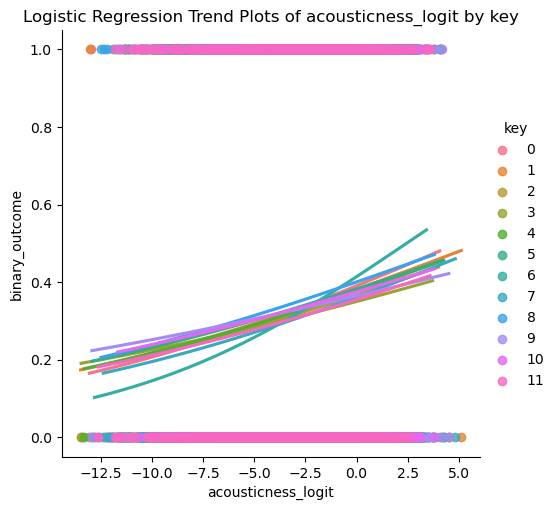

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


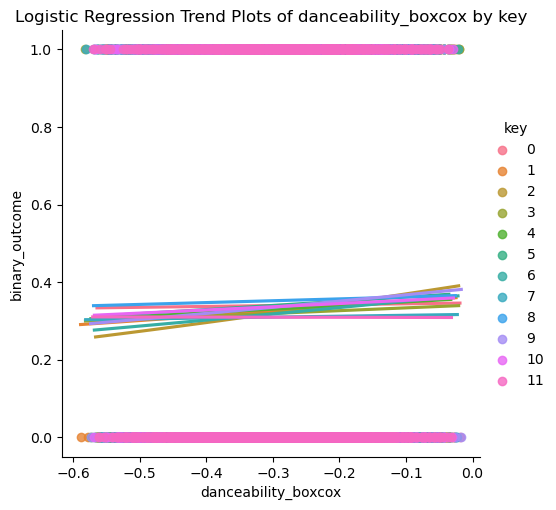

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


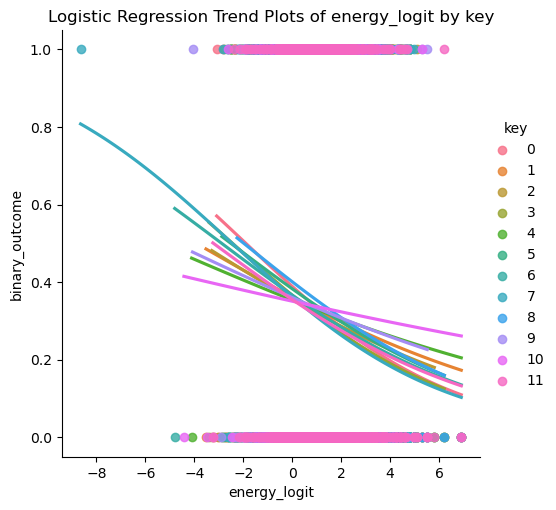

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


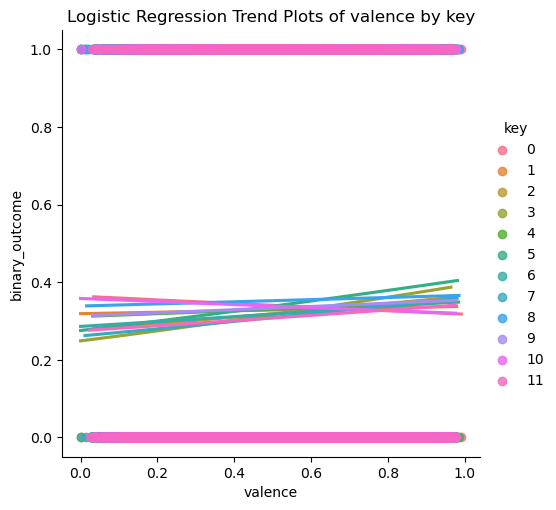

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


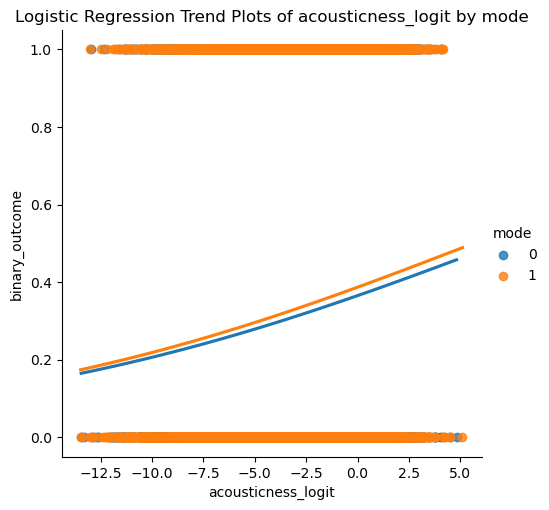

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


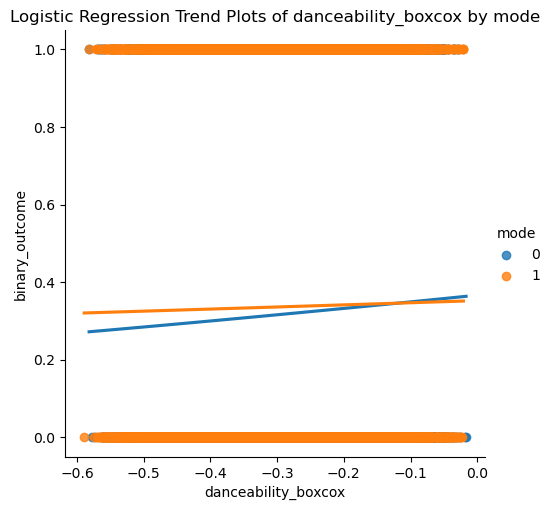

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


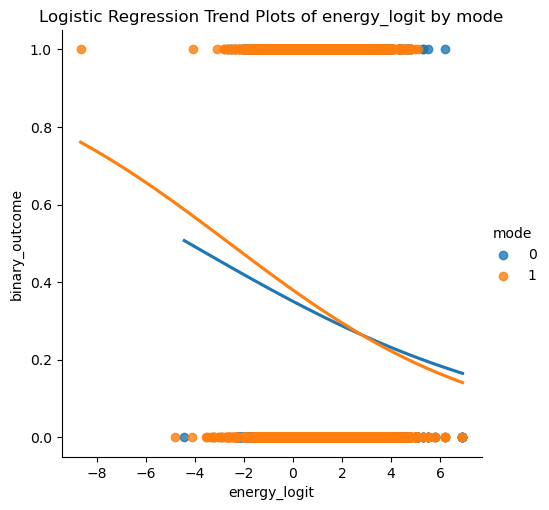

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


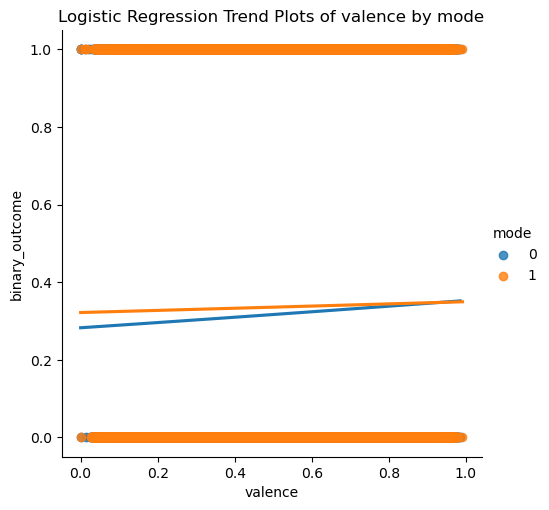

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


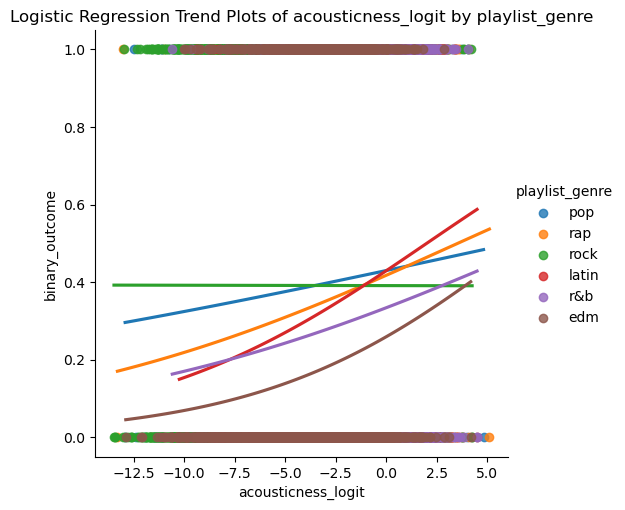

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


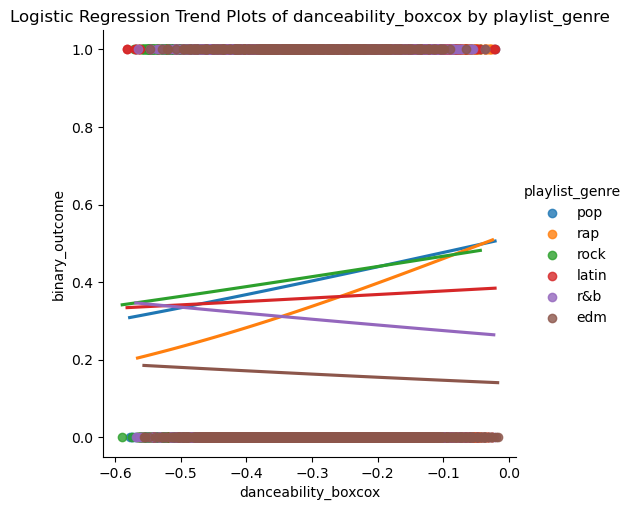

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


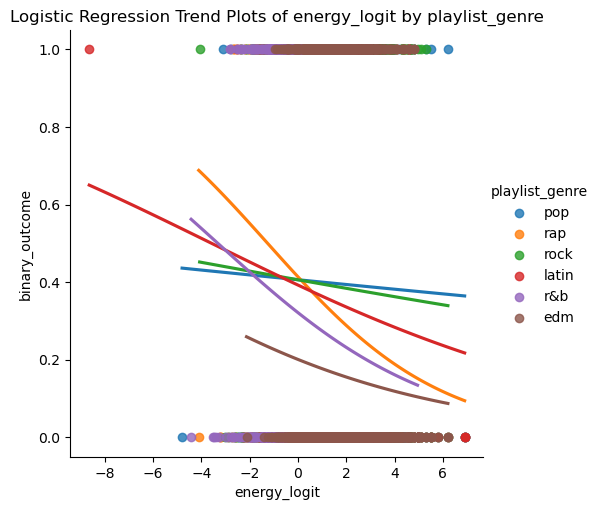

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


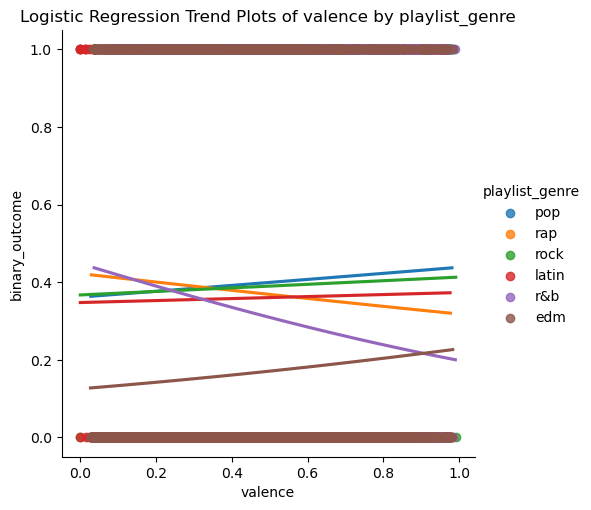

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


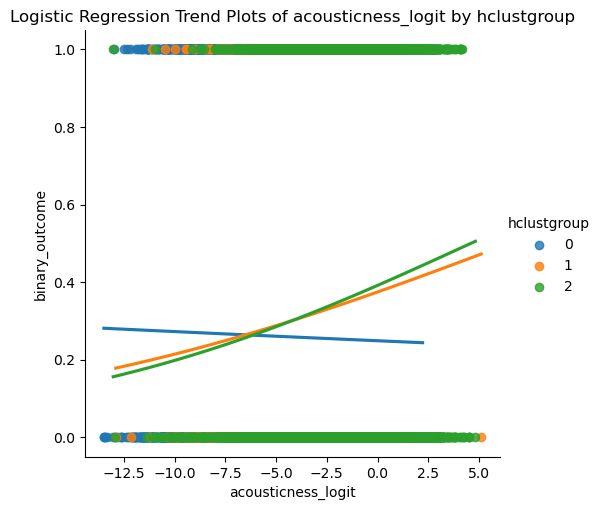

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


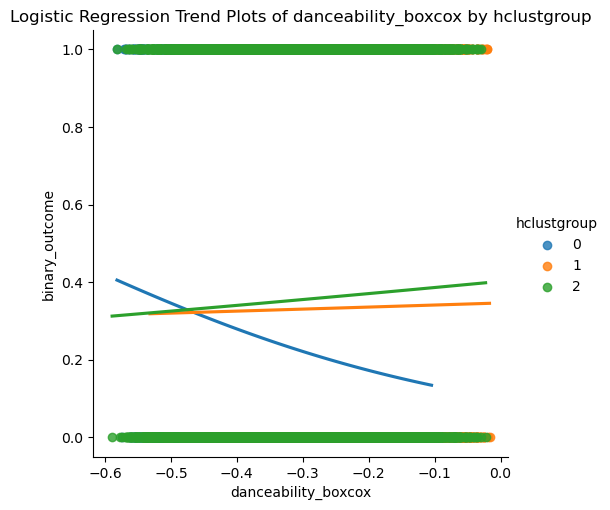

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


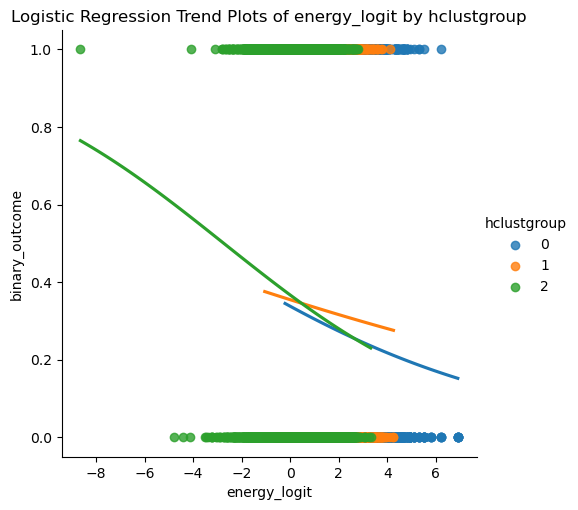

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


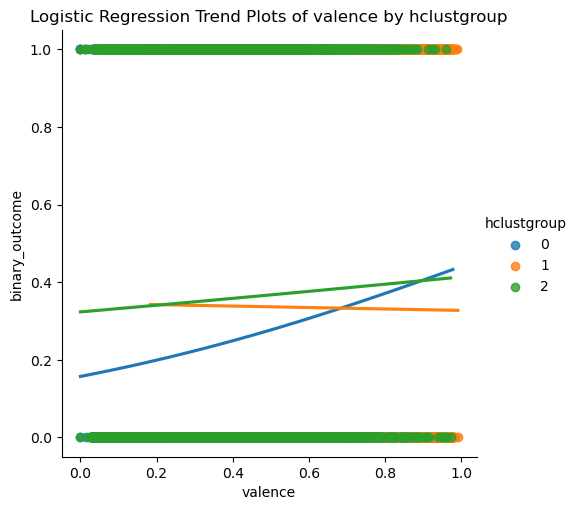

In [148]:
for var2 in ["key", "mode", "playlist_genre", "hclustgroup"]:
    for var in x_cluster:
        sns.lmplot(data=spotify_cluster, x=var, y="binary_outcome", hue=var2, logistic=True, ci=None)
        plt.title("Logistic Regression Trend Plots of "+ var + " by " + var2)
        plt.show()

**4 - Compare your cluster assignments to the outcome unique values**

Heatmap Comparing Cluster Assignments with Binary Outcome

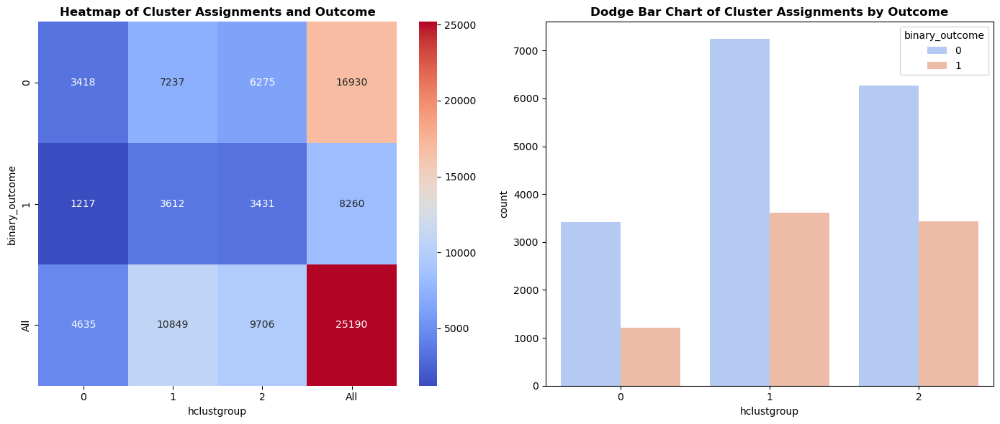

In [149]:
fig, ax = plt.subplots(1, 2, figsize=(14, 6))
sns.heatmap(data=pd.crosstab(spotify_cluster.binary_outcome, spotify_cluster.hclustgroup, margins=True), 
            annot=True,
            annot_kws={"fontsize": 10},
            cmap="coolwarm",
            fmt="d",
            ax=ax[0])
ax[0].set_title(f"Heatmap of Cluster Assignments and Outcome", fontsize=12, fontweight="bold")

# Count plot (Dodge Bar Chart)
sns.countplot(data=spotify_cluster, x="hclustgroup", hue='binary_outcome', palette="coolwarm", dodge=True, ax=ax[1])
ax[1].set_title(f"Dodge Bar Chart of Cluster Assignments by Outcome", fontsize=12, fontweight="bold")

plt.tight_layout()
plt.show()

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


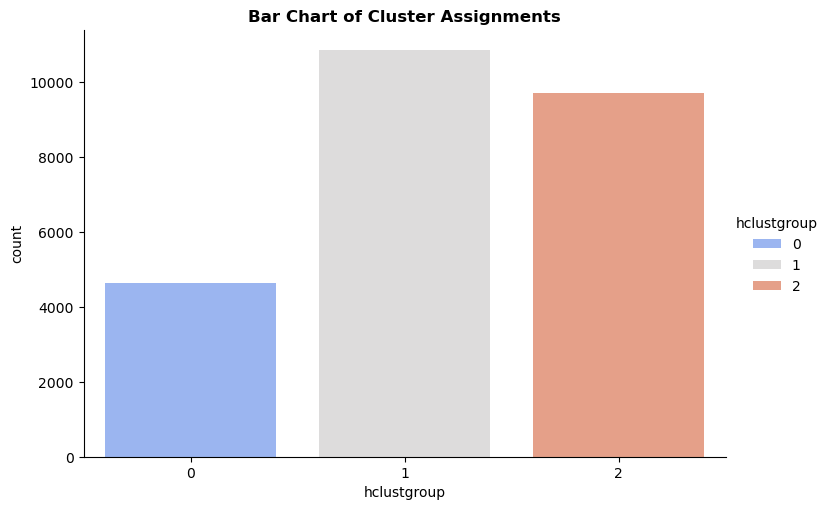

In [150]:
sns.catplot(data=spotify_cluster, x="hclustgroup", hue="hclustgroup", kind="count", palette="coolwarm", aspect=1.5)
plt.title(f"Bar Chart of Cluster Assignments", fontsize=12, fontweight="bold")

plt.show()

In [151]:
spotify_cluster.hclustgroup.value_counts(normalize=True)

hclustgroup
1    0.430687
2    0.385312
0    0.184002
Name: proportion, dtype: float64

After the Cluster Analysis, I think I want to keep the following as inputs:
1. Continuous:
    * Danceability
    * Energy
    * Acousticness
    * Tempo (unsure)
    * Valence (unsure)
3. Categorical
    * Key (unsure)
    * Playlist genre

## 4. Models: Fitting and Interpretation

In [152]:
import statsmodels.formula.api as smf

In [154]:
from sklearn.model_selection import StratifiedKFold

In [155]:
from patsy import dmatrices, dmatrix

In [156]:
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV

In [157]:
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve

In [158]:
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=2100)

In [159]:
spotify_cluster

,track_id,playlist_genre,key,mode,track_popularity,danceability,energy,loudness,speechiness,acousticness,...,instrumentalness_log,instrumentalness_boxcox,liveness_shift,liveness_logit,liveness_log,liveness_boxcox,loudness_sqrd,loudness_cubed,loudness_wins,hclustgroup
3,75FpbthrwQmzHlBJLuGdC7,pop,7,1,60,0.718,0.930,-3.778,0.1020,0.028700,...,-11.571614,-8.242266,0.2040,-1.361479,-1.589635,-1.880980,14.273284,-53.924467,-3.77800,0
4,1e8PAfcKUYoKkxPhrHqw4x,pop,1,1,69,0.650,0.833,-4.672,0.0359,0.080300,...,-4.605170,-4.002784,0.0833,-2.398332,-2.485307,-3.246014,21.827584,-101.978472,-4.67200,1
6,2OAylPUDDfwRGfe0lYqlCQ,pop,5,0,62,0.449,0.856,-4.788,0.0623,0.187000,...,-4.605170,-4.002784,0.1760,-1.543687,-1.737271,-2.089001,22.924944,-109.764632,-4.78800,2
10,3eFJI470ALf1EYjywPRsJy,pop,6,1,58,0.679,0.923,-6.500,0.1810,0.146000,...,-12.222202,-8.552048,0.1240,-1.955085,-2.087474,-2.608511,42.250000,-274.625000,-6.50000,1
12,6e0CvGZf7CouOpYF8toXHC,pop,1,1,67,0.744,0.726,-4.675,0.0463,0.039900,...,-4.605170,-4.002784,0.3740,-0.515095,-0.983499,-1.090272,21.855625,-102.175047,-4.67500,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32828,7bxnKAamR3snQ1VGLuVfC1,edm,2,1,42,0.428,0.922,-1.814,0.0936,0.076600,...,-4.605170,-4.002784,0.0668,-2.636916,-2.706052,-3.622956,3.290596,-5.969141,-3.02245,2
32829,5Aevni09Em4575077nkWHz,edm,0,1,20,0.522,0.786,-4.462,0.0420,0.001710,...,-5.456141,-4.624637,0.3750,-0.510826,-0.980829,-1.087003,19.909444,-88.835939,-4.46200,0
32830,7ImMqPP3Q1yfUHvsdn7wEo,edm,6,0,14,0.529,0.821,-4.899,0.0481,0.108000,...,-13.711151,-9.215449,0.1500,-1.734601,-1.897120,-2.321483,24.000201,-117.576985,-4.89900,2
32831,2m69mhnfQ1Oq6lGtXuYhgX,edm,2,1,15,0.626,0.888,-3.361,0.1090,0.007920,...,-2.063568,-1.936280,0.3430,-0.649954,-1.070025,-1.197192,11.296321,-37.966935,-3.36100,0


In [160]:
formula_list = ["binary_outcome ~ 1", # intercept only
                "binary_outcome ~ playlist_genre + key", #categorical inputs with linear additive features
                "binary_outcome ~ acousticness_logit + danceability_boxcox + energy_logit + valence", # continuous inputs with linear additive features
                "binary_outcome ~ acousticness_logit + danceability_boxcox + energy_logit + valence +  playlist_genre + key", # cat and continuous with linear additive features
                "binary_outcome ~ (acousticness_logit + danceability_boxcox + energy_logit + valence)**2",
                "binary_outcome ~ (acousticness_logit + danceability_boxcox + energy_logit + valence) * (playlist_genre)",
                "binary_outcome ~ (playlist_genre + key) * (acousticness_logit + danceability_boxcox + energy_logit + valence)**2 + I(acousticness_logit**2) + I(danceability_boxcox**2) + I(energy_logit**2) + I(valence**2)",
                "binary_outcome ~ (playlist_genre + key) * (acousticness_logit + danceability_boxcox + energy_logit + np.power(acousticness_logit,2) + np.power(danceability_boxcox, 2) + np.power(energy_logit, 2) + np.power(acousticness_logit, 3) + np.power(danceability_boxcox, 3) + np.power(energy_logit, 3))"
               ]

In [161]:
formula_list[3]

'binary_outcome ~ acousticness_logit + danceability_boxcox + energy_logit + valence +  playlist_genre + key'

In [162]:
formula_list[7]

'binary_outcome ~ (playlist_genre + key) * (acousticness_logit + danceability_boxcox + energy_logit + np.power(acousticness_logit,2) + np.power(danceability_boxcox, 2) + np.power(energy_logit, 2) + np.power(acousticness_logit, 3) + np.power(danceability_boxcox, 3) + np.power(energy_logit, 3))'

In [163]:
len(formula_list)

8

In [164]:
def my_coefplot(mod, figsize_use=(10,4)):
    fig, ax = plt.subplots(figsize=figsize_use)

    ax.errorbar(y=mod.params.index,
               x=mod.params,
               xerr=2*mod.bse, fmt="o", color="k", ecolor="k", elinewidth=2, ms=10)

    ax.axvline(x=0, linestyle="--", linewidth=3.5, color="grey")

    ax.set_xlabel("coefficient value")

    plt.show()

Function to fit and assess logistic regressions!

In [165]:
def fit_and_assess_logistic(mod_name, a_formula, train_data,  threshold):
    a_mod = smf.logit(formula=a_formula, 
                      data=train_data).fit()
    my_coefplot(a_mod)
    train_copy = train_data.copy()
    
    train_copy["pred_probability"] = a_mod.predict(train_data)
    
    train_copy["pred_class"] = np.where(train_copy["pred_probability"] > threshold, 1, 0)

    TN, FP, FN, TP = confusion_matrix(train_copy.binary_outcome.to_numpy(), train_copy.pred_class.to_numpy()).ravel()

    Accuracy = (TN + TP)/(TN + TP + FN + FP)

    Sensitivity = TP/(TP + FN)

    Specificity = TN/(TN + FP)

    FPR = 1 - Specificity

    ROC_AUC = roc_auc_score(train_copy.binary_outcome.to_numpy(), train_copy.pred_probability.to_numpy())
    
    res_dict = {"model_name": mod_name,
               "model_formula": a_formula,
               "num_coefs": len(a_mod.params),
               "threshold": threshold,
               "Accuracy": Accuracy,
                "TN": TN,
                "FP": FP,
                "FN": FN,
                "TP": TP,
               "Sensitivity": Sensitivity,
               "Specificity": Specificity,
               "FPR": FPR,
               "ROC_AUC": ROC_AUC}
    
    return pd.DataFrame(res_dict, index=[0])

In [166]:
def fit_and_coefs(mod_name, a_formula, train_data, threshold):
    a_mod = smf.logit(formula=a_formula, 
                      data=train_data).fit()
    
    coef_df = pd.DataFrame({
        'variable': a_mod.params.index,
        'coefficient': a_mod.params.values,
        'pvalue': a_mod.pvalues.values
    })
    
    coef_df['Model'] = mod_name  # Add model name for reference
    return coef_df

Optimization terminated successfully.
         Current function value: 0.632687
         Iterations 4


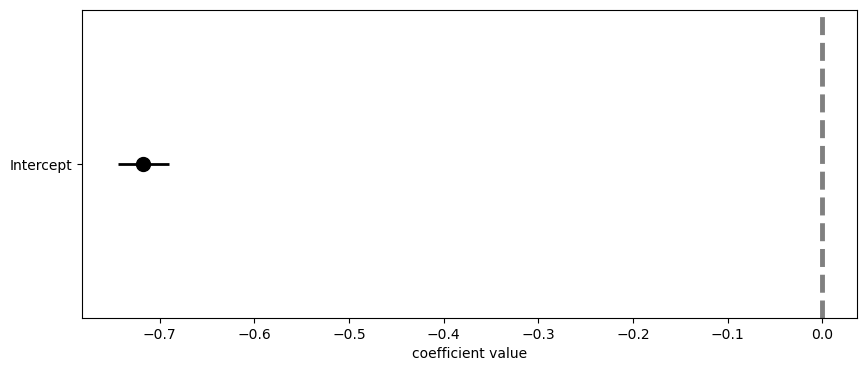

Optimization terminated successfully.
         Current function value: 0.632687
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.615152
         Iterations 6


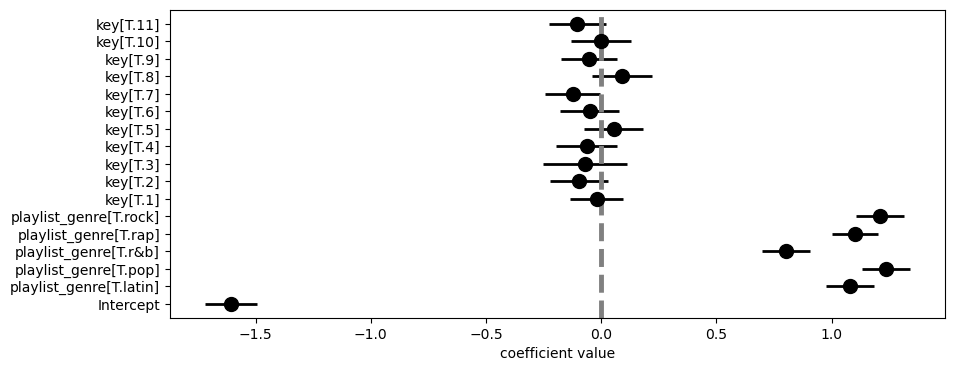

Optimization terminated successfully.
         Current function value: 0.615152
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.626910
         Iterations 5


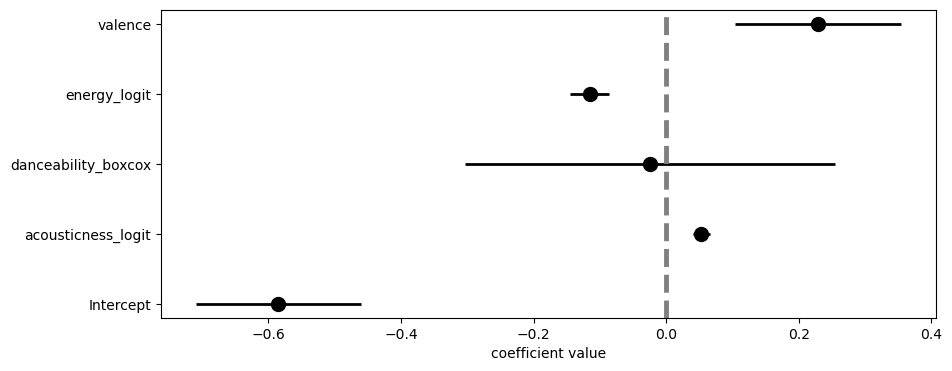

Optimization terminated successfully.
         Current function value: 0.626910
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.611321
         Iterations 6


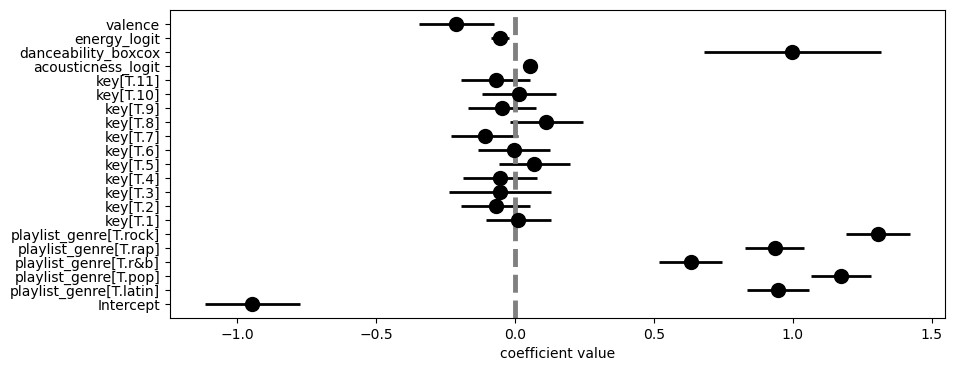

Optimization terminated successfully.
         Current function value: 0.611321
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.623238
         Iterations 5


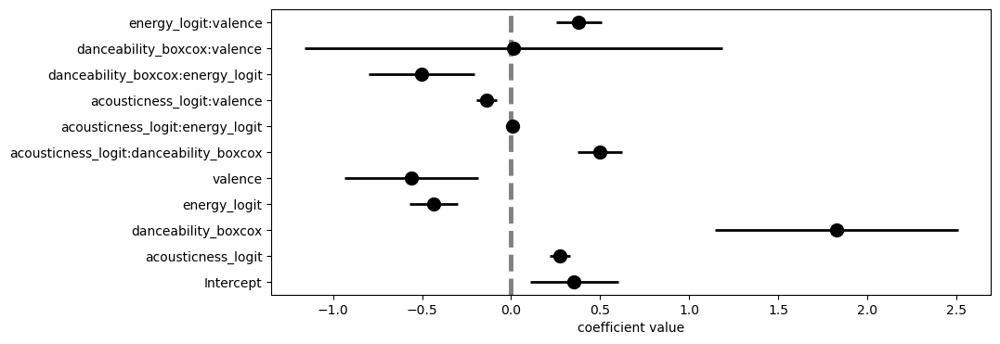

Optimization terminated successfully.
         Current function value: 0.623238
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.606362
         Iterations 6


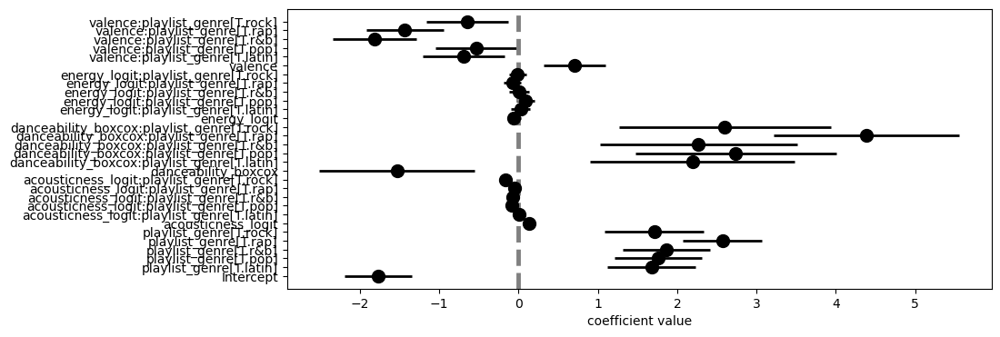

Optimization terminated successfully.
         Current function value: 0.606362
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.600537
         Iterations 6


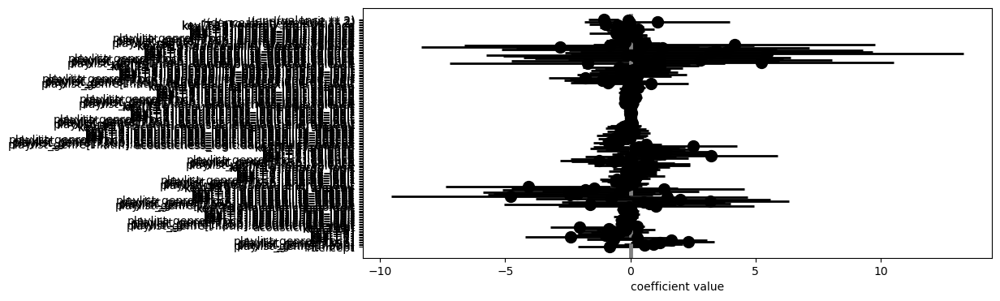

Optimization terminated successfully.
         Current function value: 0.600537
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.603203
         Iterations 9


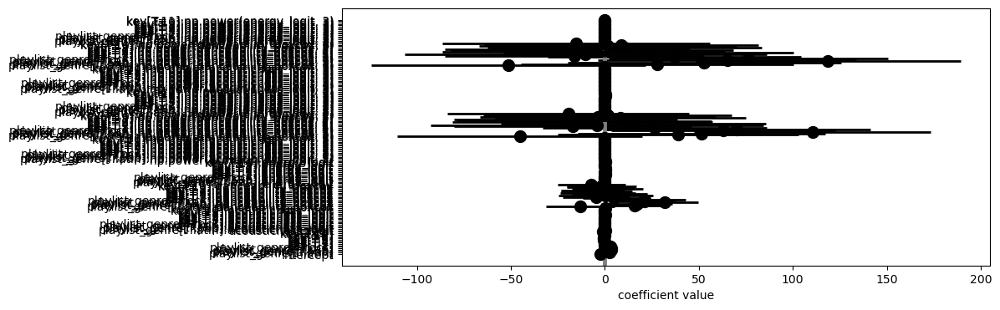

Optimization terminated successfully.
         Current function value: 0.603203
         Iterations 9


In [167]:
results_list = []
coefs_list = []

for m in range(len(formula_list)):
    results_list.append(fit_and_assess_logistic(m, formula_list[m], train_data=spotify_cluster, threshold=0.5))
    coefs_list.append(fit_and_coefs(m, formula_list[m], train_data=spotify_cluster, threshold=0.5))

In [168]:
coefs_df = pd.concat(coefs_list, ignore_index=True)

In [169]:
pvalsig = coefs_df.loc[(coefs_df.pvalue < 0.05)]

In [170]:
pvalsig.loc[pvalsig.Model == 0]

,variable,coefficient,pvalue,Model
0,Intercept,-0.717663,0.0,0


In [171]:
pvalsig.groupby("Model").aggregate(coefficient = ("coefficient", "max")).merge(coefs_df, on=["coefficient"], how="inner")

,coefficient,variable,pvalue,Model
0,-0.717663,Intercept,0.000000e+00,0
1,1.235155,playlist_genre[T.pop],8.819051e-126,1
2,0.228683,valence,2.549064e-04,2
3,1.305793,playlist_genre[T.rock],2.085415e-115,3
4,1.828310,danceability_boxcox,9.155752e-08,4
5,4.385575,danceability_boxcox:playlist_genre[T.rap],7.663546e-14,5
6,5.240482,playlist_genre[T.latin]:danceability_boxcox:va...,4.698342e-02,6
7,118.722708,playlist_genre[T.r&b]:np.power(danceability_bo...,7.677885e-04,7


In [172]:
results_df = pd.concat(results_list, ignore_index=True)

In [173]:
results_df.sort_values(by=["Accuracy"], ascending=False)

,model_name,model_formula,num_coefs,threshold,Accuracy,TN,FP,FN,TP,Sensitivity,Specificity,FPR,ROC_AUC
6,6,binary_outcome ~ (playlist_genre + key) * (aco...,191,0.5,0.674276,16551,379,7826,434,0.052542,0.977614,0.022386,0.647708
7,7,binary_outcome ~ (playlist_genre + key) * (aco...,170,0.5,0.673601,16650,280,7942,318,0.038499,0.983461,0.016539,0.639657
5,5,binary_outcome ~ (acousticness_logit + danceab...,30,0.5,0.672171,16716,214,8044,216,0.026150,0.987360,0.012640,0.630264
0,0,binary_outcome ~ 1,1,0.5,0.672092,16930,0,8260,0,0.000000,1.000000,0.000000,0.500000
1,1,binary_outcome ~ playlist_genre + key,17,0.5,0.672092,16930,0,8260,0,0.000000,1.000000,0.000000,0.598879
2,2,binary_outcome ~ acousticness_logit + danceabi...,5,0.5,0.671894,16920,10,8255,5,0.000605,0.999409,0.000591,0.565470
3,3,binary_outcome ~ acousticness_logit + danceabi...,21,0.5,0.671497,16816,114,8161,99,0.011985,0.993266,0.006734,0.618954
4,4,binary_outcome ~ (acousticness_logit + danceab...,11,0.5,0.670187,16775,155,8153,107,0.012954,0.990845,0.009155,0.576344


In [174]:
def fit_logistic_make_roc(mod_name, a_formula, train_data):
    a_mod = smf.logit(formula=a_formula, data=train_data).fit()

    train_copy = train_data.copy()

    train_copy["pred_probability"] = a_mod.predict(train_data)

    fpr, tpr, threshold = roc_curve(train_copy.binary_outcome.to_numpy(), train_copy.pred_probability.to_numpy())

    res_df = pd.DataFrame({"tpr": tpr,
                          "fpr": fpr,
                          "threshold": threshold})
    res_df["model_name"] = str(mod_name)
    res_df["model_formula"] = a_formula

    return res_df

In [175]:
roc_list = []

for m in range(len(formula_list)):
    roc_list.append(fit_logistic_make_roc(m, formula_list[m], train_data=spotify_cluster))

Optimization terminated successfully.
         Current function value: 0.632687
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.615152
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.626910
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.611321
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.623238
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.606362
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.600537
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.603203
         Iterations 9


In [176]:
roc_df = pd.concat(roc_list, ignore_index=True)

In [177]:
roc_df

,tpr,fpr,threshold,model_name,model_formula
0,0.000000,0.000000,inf,0,binary_outcome ~ 1
1,1.000000,1.000000,0.327908,0,binary_outcome ~ 1
2,0.000000,0.000000,inf,1,binary_outcome ~ playlist_genre + key
3,0.014891,0.009628,0.429886,1,binary_outcome ~ playlist_genre + key
4,0.026392,0.017602,0.423555,1,binary_outcome ~ playlist_genre + key
...,...,...,...,...,...
65364,1.000000,0.994979,0.053303,7,binary_outcome ~ (playlist_genre + key) * (aco...
65365,1.000000,0.995097,0.053195,7,binary_outcome ~ (playlist_genre + key) * (aco...
65366,1.000000,0.997519,0.037032,7,binary_outcome ~ (playlist_genre + key) * (aco...
65367,1.000000,0.997637,0.036295,7,binary_outcome ~ (playlist_genre + key) * (aco...


/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


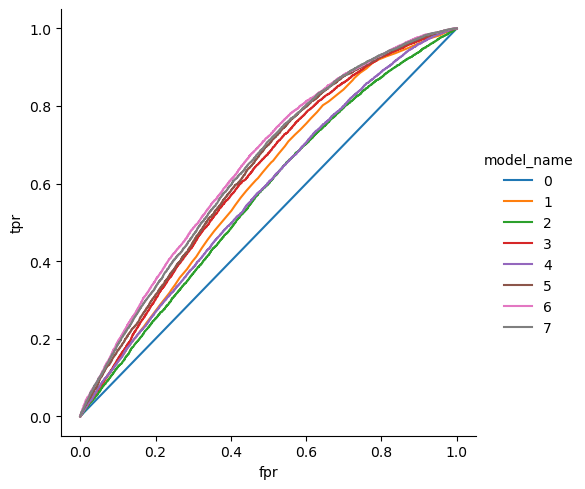

In [178]:
sns.relplot(data=roc_df, x="fpr", y="tpr", hue="model_name",
            kind="line", estimator=None, units="model_name")

plt.show()

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


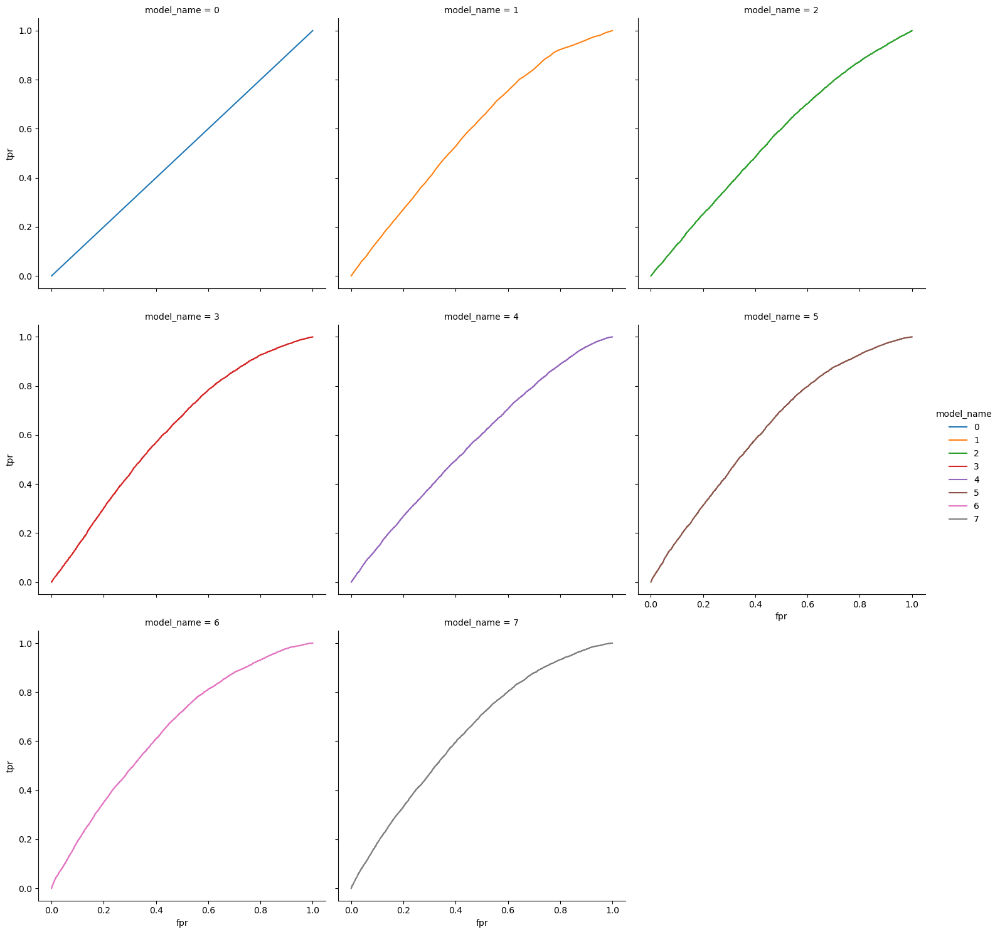

In [179]:
sns.relplot(data=roc_df, x="fpr", y="tpr", col="model_name", col_wrap=3, hue="model_name",
            kind="line", estimator=None, units="model_name")

plt.show()

### E. Models: Predictions

In [180]:
input_grid = pd.DataFrame([(x1, x2, x3, x5, x6, x7) for x1 in np.linspace(spotify_cluster.danceability_boxcox.min(), spotify_cluster.danceability_boxcox.max(), num=101)
                                            for x2 in np.linspace(spotify_cluster.valence.min(), spotify_cluster.valence.max(), num=5)
                                            for x3 in [spotify_cluster.energy_logit.mean()]
                                            for x5 in [spotify_cluster.acousticness_logit.mean()] 
                                            for x6 in spotify_cluster.playlist_genre.unique()
                                            for x7 in spotify_cluster["key"].mode()],
                         columns=["danceability_boxcox", "valence", "energy_logit", "acousticness_logit", "playlist_genre", "key"])

In [181]:
dfviz = input_grid.copy()

In [182]:
mod_3 = smf.logit(formula=formula_list[3], data=spotify_cluster).fit()
mod_6 = smf.logit(formula=formula_list[6], data=spotify_cluster).fit()

Optimization terminated successfully.
         Current function value: 0.611321
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.600537
         Iterations 6


In [183]:
mod_3_predictions = mod_3.get_prediction(input_grid).summary_frame()
mod_6_predictions = mod_6.get_prediction(input_grid).summary_frame()
dfviz["predicted_6"] = mod_6_predictions["predicted"]
dfviz["predicted_3"] = mod_3_predictions["predicted"]

In [184]:
dfviz

,danceability_boxcox,valence,energy_logit,acousticness_logit,playlist_genre,key,predicted_6,predicted_3
0,-0.589121,0.000,1.039812,-2.780069,pop,1,0.296887,0.364728
1,-0.589121,0.000,1.039812,-2.780069,rap,1,0.200150,0.311140
2,-0.589121,0.000,1.039812,-2.780069,rock,1,0.331595,0.395789
3,-0.589121,0.000,1.039812,-2.780069,latin,1,0.448213,0.313781
4,-0.589121,0.000,1.039812,-2.780069,r&b,1,0.414726,0.250345
...,...,...,...,...,...,...,...,...
3025,-0.016899,0.991,1.039812,-2.780069,rap,1,0.391956,0.392971
3026,-0.016899,0.991,1.039812,-2.780069,rock,1,0.462950,0.484233
3027,-0.016899,0.991,1.039812,-2.780069,latin,1,0.439647,0.395907
3028,-0.016899,0.991,1.039812,-2.780069,r&b,1,0.216296,0.323699


Visualize the models!!!

Model 3

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


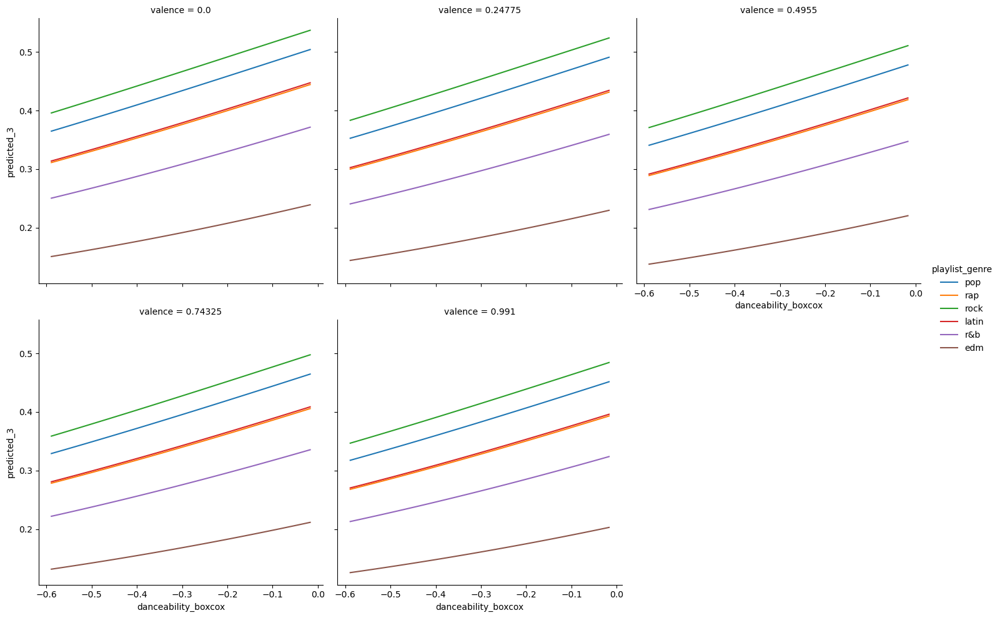

In [185]:
sns.relplot(data=dfviz,
    x="danceability_boxcox", y="predicted_3",
    hue="playlist_genre", 
    col="valence",  
    col_wrap=3,
    kind="line",
    palette="coolwarm" if input_grid["playlist_genre"].dtype != "object" else None 
)

plt.show()

Model 6

/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


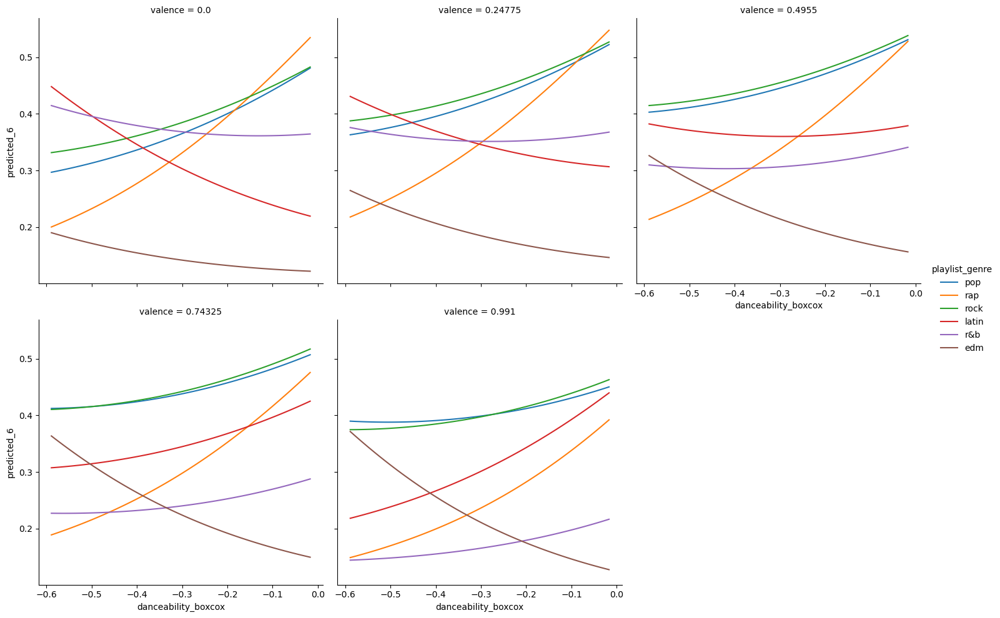

In [186]:
sns.relplot(data=dfviz,
    x="danceability_boxcox", y="predicted_6",
    hue="playlist_genre", 
    col="valence",  
    col_wrap=3,
    kind="line",
    palette="coolwarm" if input_grid["playlist_genre"].dtype != "object" else None 
)

plt.show()

### F. Models: Performance and Validation

In [192]:
from sklearn.pipeline import Pipeline

We will be looking at Models 2, 5, and 6.

Function from class to calculate performance metrics for a Logistic Regression.

In [187]:
def train_and_test_logistic_with_cv(mod_name, a_formula, init_mod, data_df, cv):
    # Create feature and output arrays based on provided formula
    y, X = dmatrices(a_formula, data=data_df)

    # Initialize the performance metric storage
    train_res = []
    test_res = []

    # Create a pipeline that standardizes the data and then fits the model
    pipeline = Pipeline([
        ('scaler', StandardScaler()),  # Step 1: Standardize the features
        ('model', init_mod)  # Step 2: Fit the model
    ])

    # Split the data and iterate over the folds
    for train_id, test_id in cv.split(X, y.ravel()):
        # Subset the training and testing features
        X_train = X[train_id]
        X_test = X[test_id]

        # Subset training and testing output
        y_train = y[train_id]
        y_test = y[test_id]

        # Fit the pipeline on the training set
        pipeline.fit(X_train, y_train.ravel())

        # Calculate the accuracy on the training set
        train_res.append(pipeline.score(X_train, y_train.ravel()))
        
        # Calculate the accuracy on the test set
        test_res.append(pipeline.score(X_test, y_test.ravel()))

    # Bookkeeping for the results
    train_df = pd.DataFrame({"Accuracy": train_res})
    train_df["from_set"] = "training" 
    train_df["fold_id"] = train_df.index + 1

    test_df = pd.DataFrame({"Accuracy": test_res})
    test_df["from_set"] = "testing" 
    test_df["fold_id"] = test_df.index + 1 

    # Combine the results together
    res_df = pd.concat([train_df, test_df], ignore_index=True)

    # Add additional information about the model
    res_df["model_name"] = mod_name
    res_df["model_formula"] = a_formula
    res_df["num_coefs"] = pipeline.named_steps['model'].coef_.ravel().size  # Get the number of coefficients

    return res_df

In [188]:
sk_min_loss = LogisticRegression(penalty=None, solver="lbfgs", fit_intercept=False, max_iter=25001)

In [189]:
spotify_cv = spotify_transf.loc[:, x_cluster + x_cats[0::2] + ["binary_outcome"]].copy()

In [190]:
spotify_cv

,acousticness_logit,danceability_boxcox,energy_logit,valence,key,playlist_genre,binary_outcome
3,-3.521738,-0.253422,2.586689,0.2770,7,pop,1
4,-2.438278,-0.305607,1.607040,0.7250,1,pop,1
6,-1.469622,-0.437889,1.782457,0.1520,5,pop,1
10,-1.766325,-0.283794,2.483824,0.7520,6,pop,1
12,-3.180661,-0.232522,0.974422,0.6870,1,pop,1
...,...,...,...,...,...,...,...
32828,-2.489465,-0.449713,2.469836,0.2100,2,edm,0
32829,-6.369550,-0.393774,1.300981,0.4000,0,edm,0
32830,-2.111335,-0.389303,1.523137,0.4360,6,edm,0
32831,-4.830413,-0.323154,2.070473,0.3080,2,edm,0


In [193]:
results_list = []

for m in [2, 5, 6]:
    results_list.append(train_and_test_logistic_with_cv(mod_name=str(m), 
                                                            a_formula=formula_list[m], 
                                                            init_mod=sk_min_loss,
                                                            data_df=spotify_cv, 
                                                            cv=kf))

In [194]:
cv_results = pd.concat(results_list, ignore_index=True)

In [198]:
cv_results

,Accuracy,from_set,fold_id,model_name,model_formula,num_coefs
0,0.527243,training,1,2,binary_outcome ~ acousticness_logit + danceabi...,5
1,0.526945,training,2,2,binary_outcome ~ acousticness_logit + danceabi...,5
2,0.530518,training,3,2,binary_outcome ~ acousticness_logit + danceabi...,5
3,0.528881,training,4,2,binary_outcome ~ acousticness_logit + danceabi...,5
4,0.530320,training,5,2,binary_outcome ~ acousticness_logit + danceabi...,5
5,0.534934,testing,1,2,binary_outcome ~ acousticness_logit + danceabi...,5
6,0.533942,testing,2,2,binary_outcome ~ acousticness_logit + danceabi...,5
7,0.520445,testing,3,2,binary_outcome ~ acousticness_logit + danceabi...,5
8,0.527789,testing,4,2,binary_outcome ~ acousticness_logit + danceabi...,5
9,0.522033,testing,5,2,binary_outcome ~ acousticness_logit + danceabi...,5


/Applications/anaconda3/envs/cmpinf2100/lib/python3.8/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


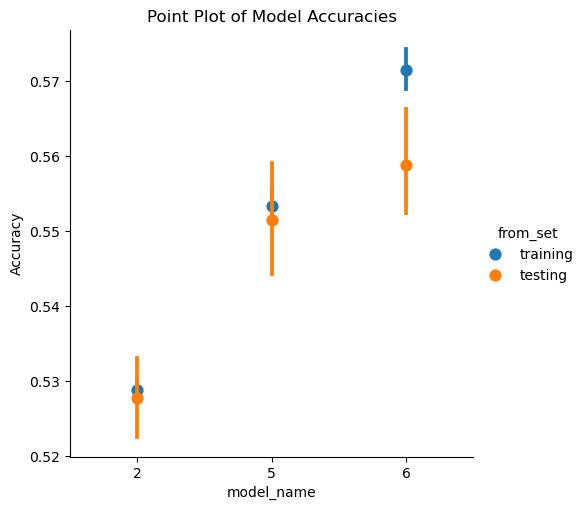

In [199]:
sns.catplot(data=cv_results, x="model_name", y="Accuracy", hue="from_set", kind="point", linestyle="None")
plt.title("Point Plot of Model Accuracies")
plt.show()

## Optional Project Inclusions

In [200]:
lasso_to_fit = LogisticRegression(penalty="l1", solver="saga", random_state=202, max_iter=25001, fit_intercept=False)

In [201]:
pc_lasso_grid = {"pca__n_components": [3,5,7,9,11,13,15,17],
            "lasso__C": np.exp(np.linspace(-10, 10, num=17))}

In [202]:
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from patsy import dmatrices
import numpy as np
import pandas as pd

def train_and_test_logistic_with_cv(mod_name, a_formula, init_mod, data_df, cv):
    # Create feature and output arrays based on the provided formula
    y, X = dmatrices(a_formula, data=data_df)

    # Initialize the performance metric storage
    train_res = []
    test_res = []

    # Create a pipeline that standardizes the data, applies PCA, and fits the model
    pipeline = Pipeline([
        ('scaler', StandardScaler()),  # Standardization
        ("pca", PCA()),  # PCA step
        ('model', init_mod)  # Model step (Logistic Regression, etc.)
    ])

    # Define the parameter grid for GridSearchCV
    pc_lasso_grid = {
        "pca__n_components": [1, 2, 3, 4],
        "model__C": np.exp(np.linspace(-10, 10, num=17))  # Regularization strength for Logistic Regression
    }

    # Create GridSearchCV object
    pc_lasso_search = GridSearchCV(pipeline, param_grid=pc_lasso_grid, cv=cv)

    # Split the data and iterate over the folds
    for train_id, test_id in cv.split(X, y.ravel()):
        # Subset the training and testing features
        X_train = X[train_id]
        X_test = X[test_id]

        # Subset training and testing output
        y_train = y[train_id]
        y_test = y[test_id]

        # Fit the model using GridSearchCV to find the best hyperparameters
        pc_lasso_search.fit(X_train, y_train.ravel())

        # Calculate accuracy on the training set
        train_res.append(pc_lasso_search.score(X_train, y_train.ravel()))
        
        # Calculate accuracy on the test set
        test_res.append(pc_lasso_search.score(X_test, y_test.ravel()))

    # Bookkeeping for the results
    train_df = pd.DataFrame({"Accuracy": train_res})
    train_df["from_set"] = "training" 
    train_df["fold_id"] = train_df.index + 1

    test_df = pd.DataFrame({"Accuracy": test_res})
    test_df["from_set"] = "testing" 
    test_df["fold_id"] = test_df.index + 1 

    # Combine the results together
    res_df = pd.concat([train_df, test_df], ignore_index=True)

    # Add additional information about the model
    res_df["model_name"] = mod_name
    res_df["model_formula"] = a_formula
    # Extract the best model from the GridSearchCV and get the number of coefficients
    best_model = pc_lasso_search.best_estimator_.named_steps['model']
    res_df["num_coefs"] = best_model.coef_.ravel().size  # Get the number of coefficients

    return res_df

In [203]:
results_list_cv = []

for m in [2, 5, 6]:
    results_list_cv.append(train_and_test_logistic_with_cv(mod_name=str(m), 
                                                            a_formula=formula_list[m], 
                                                            init_mod=lasso_to_fit,
                                                            data_df=spotify_df_t, 
                                                            cv=kf))

In [204]:
cv_results_lasso_df = pd.concat(results_list_cv, ignore_index=True)

In [205]:
cv_results_lasso_df

,Accuracy,from_set,fold_id,model_name,model_formula,num_coefs
0,0.672092,training,1,2,binary_outcome ~ acousticness_logit + danceabi...,1
1,0.672092,training,2,2,binary_outcome ~ acousticness_logit + danceabi...,1
2,0.672092,training,3,2,binary_outcome ~ acousticness_logit + danceabi...,1
3,0.672092,training,4,2,binary_outcome ~ acousticness_logit + danceabi...,1
4,0.672092,training,5,2,binary_outcome ~ acousticness_logit + danceabi...,1
5,0.672092,testing,1,2,binary_outcome ~ acousticness_logit + danceabi...,1
6,0.672092,testing,2,2,binary_outcome ~ acousticness_logit + danceabi...,1
7,0.672092,testing,3,2,binary_outcome ~ acousticness_logit + danceabi...,1
8,0.672092,testing,4,2,binary_outcome ~ acousticness_logit + danceabi...,1
9,0.672092,testing,5,2,binary_outcome ~ acousticness_logit + danceabi...,1
